<h1>Plan of attack</h1>
<li>- <strong>#01</strong> - Import modules and packages</li>
<li>- <strong>#02</strong> - Read datasets</li>
<li>--- <strong>#02-1</strong> - Reading metro stations</li>
<li>----- <strong>#02-1.1</strong> - Visualize metro stations</li>
<li>--- <strong>#02-2</strong> - Reading transaction data</li>
<li>----- <strong>#02-2.1</strong> - Remove noise data</li>
<li>----- <strong>#02-3.2</strong> - Visualize transactions</li>
<li>--- <strong>#02-3</strong> - Build a combined map</li>
<li>- <strong>#03</strong> - Geospatial Data Analysis</li>
<li>--- <strong>#03-1</strong> - Build Distance Matrix Structure</li>
<li>--- <strong>#03-2</strong> - Calculate distances between property and metro station</li>
<li>--- <strong>#03-3</strong> - Checking DM dataset</li>
<li>--- <strong>#03-4</strong> - Filtering values from DM</li>
<li>--- <strong>#03-5</strong> - Checking amounts of time series data</li>
<li>--- <strong>#03-6</strong> - Building Time-series data lines for each filtered property</li>

<h2>#01 Import modules and packages</h2>

In [39]:
# Import packages and modules
import numpy as np
import pandas as pd

<h2>#02 Read datasets</h2>

<h3>#02-1 Reading metro stations</h3>

In [40]:
# Read dataset
metro = pd.read_csv('MetroStations.csv')

In [41]:
metro.head(5)

,Station,Level,Commune,Zone,Opened,LAT,LON
0,Aksel Møllers Have,Under,Frederiksberg,1,Under construction,55.686469,12.533563
1,Amager Strand,Over,København,3,2007 09 28,55.656154,12.631881
2,Amagerbro,Under,København,1,2002 10 19,55.663550,12.602697
3,Bella Center,Over,København,3,2002 10 19,55.638085,12.582720
4,Christianshavn,Under,København,1,2002 10 19,55.672168,12.591404


<p>After <strong>MetroStation.csv</strong> dataset is imported we need to filter out active stations only.</p>

In [42]:
# Filter out the dataset by using SQL request
metro_active = metro.loc[metro['Opened'] != 'Under construction']
metro_active = metro_active.loc[metro_active['Opened'] != 'Planned']

In [43]:
metro_active

,Station,Level,Commune,Zone,Opened,LAT,LON
1,Amager Strand,Over,København,3,2007 09 28,55.656154,12.631881
2,Amagerbro,Under,København,1,2002 10 19,55.663550,12.602697
3,Bella Center,Over,København,3,2002 10 19,55.638085,12.582720
4,Christianshavn,Under,København,1,2002 10 19,55.672168,12.591404
5,DR Byen,Over,København,3,2002 10 19,55.655838,12.589002
7,Fasanvej,Under,Frederiksberg,2,2003 10 12,55.681686,12.523097
8,Femøren,Over,København,3,2007 09 28,55.645536,12.638335
9,Flintholm,Over,Frederiksberg,2,2004 01 24,55.685944,12.499505
10,Forum,Under,Frederiksberg,1,2003 05 29,55.681831,12.553098
11,Frederiksberg,Under,Frederiksberg,2,2003 05 29,55.681214,12.531878


In [44]:
print("We are analyzing {} metro stations.".format(len(metro_active)))

We are analyzing 22 metro stations.


<h3>#02-1.1 Visualize metro stations</h3>

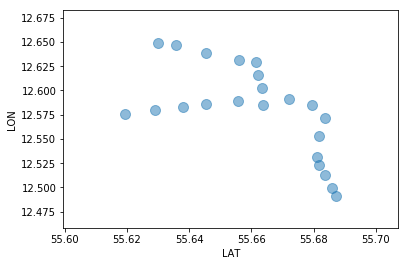

In [45]:
# Import neccesary modules for data visualization
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

# Exporting lat and lon
lat = metro_active['LAT'].values
lon = metro_active['LON'].values
stations = metro_active['Station'].values

metro_active.plot(kind = "scatter", x = "LAT", y = "LON", alpha=0.5, s=100)

<h3>#02-2 Reading transaction data</h3>

In [46]:
# Read dataset for transactions
ds = pd.read_csv('transaction_data_working_geo.csv', low_memory=False)

In [179]:
ds.head(500)

,residentialArea,address,postal,city,itemTypeName,saleDate,salePrice,saleTypeId,saleType,bbrLink,lat,lng,bbrkom,bbrejd
0,188,Gaunøvej 35,2700,Brønshøj,Villa,22-03-2006,4965000,1,Fri handel,~/boligen/101-176770/bbr,0.557,12.495536,101,176770
1,188,Gaunøvej 35,2700,Brønshøj,Villa,24-02-1992,1300000,2,Familiehandel,~/boligen/101-176770/bbr,0.557,12.495536,101,176770
2,96,Strandskolevej 215,2660,Brøndby Strand,Rækkehus,6/7/2016,2365000,1,Fri handel,~/boligen/153-47650/bbr,5.562,12.420115,153,47650
3,96,Strandskolevej 215,2660,Brøndby Strand,Rækkehus,9/11/2008,2185000,1,Fri handel,~/boligen/153-47650/bbr,5.562,12.420115,153,47650
4,96,Strandskolevej 215,2660,Brøndby Strand,Rækkehus,12/1/2006,2325000,1,Fri handel,~/boligen/153-47650/bbr,5.562,12.420115,153,47650
5,52,"Ellebjergvej 3, 1. th",2450,København SV,Ejerlejlighed,19-03-2009,480000,3,Auktion,~/boligen/101-114287/bbr,5.565,12.526854,101,114287
6,52,"Ellebjergvej 3, 1. th",2450,København SV,Ejerlejlighed,30-11-2007,1626903,1,Fri handel,~/boligen/101-114287/bbr,5.565,12.526854,101,114287
7,52,"Ellebjergvej 3, 1. th",2450,København SV,Ejerlejlighed,20-11-2006,1644000,1,Fri handel,~/boligen/101-114287/bbr,5.565,12.526854,101,114287
8,52,"Ellebjergvej 3, 1. th",2450,København SV,Ejerlejlighed,16-11-2005,1200000,1,Fri handel,~/boligen/101-114287/bbr,5.565,12.526854,101,114287
9,52,"Ellebjergvej 3, 1. tv",2450,København SV,Ejerlejlighed,3/5/2007,1270000,1,Fri handel,~/boligen/101-114295/bbr,5.565,12.526854,101,114295


In [48]:
print('The lenght of raw dataset is {}'.format(len(ds)))

The lenght of raw dataset is 652770


<h3>#02-2.1 Remove noise data</h3>

In [49]:
# Remove noise data
ds_w = ds.loc[ds['lng'] < 15]
ds_w = ds_w.loc[ds_w['lng'] > 12.47]
ds_w = ds_w.loc[ds_w['lat'] > 55.6]
ds_w = ds_w.loc[ds_w['lat'] < 55.7]

# Indexing transactions
ds_w.insert(0, "ID", 0)
for item in range(0, len(ds_w), 1):
    ds_w.iat[item, 0] = int(item)

print("After data preprocessing we have {} transactions.".format(len(ds_w)))

After data preprocessing we have 196659 transactions.


<h3>#02-2.2 Visualize transaction data on a map</h3>

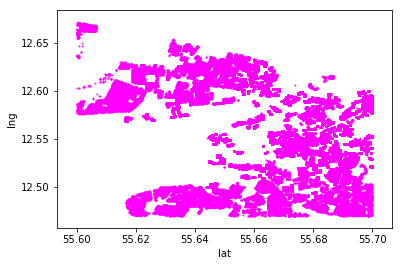

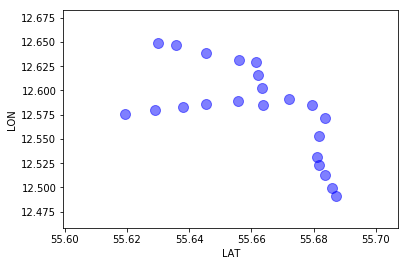

In [50]:
# Exporting lat and lon
lat = ds_w['lat'].values
lon = ds_w['lng'].values

ds_w.plot(kind = "scatter", x = "lat", y = "lng", alpha = 0.85, color = "magenta", s=1)
metro_active.plot(kind = "scatter", x = "LAT", y = "LON", alpha=0.5, s=100, color = "blue")

In [12]:
ds_w.head(2)

,ID,residentialArea,address,postal,city,itemTypeName,saleDate,salePrice,saleTypeId,saleType,bbrLink,lat,lng,bbrkom,bbrejd
92,0,128,Restrupvej 28,2770,Kastrup,Rækkehus,23-04-1996,905000,1,Fri handel,~/boligen/185-141527/bbr,55.609,12.580117,185,141527
93,1,96,Høgildvej 11,2770,Kastrup,Villa,3/2/2016,3020000,1,Fri handel,~/boligen/185-54845/bbr,55.612,12.600170,185,54845


<h2>#02-3 Build a combined map</h3>

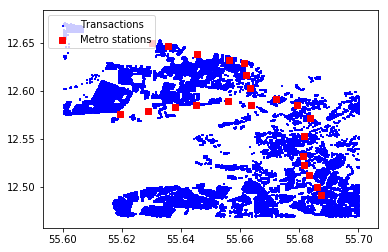

In [51]:
# Import extra packages
import matplotlib.pyplot as plt

# Build a combined scatter
fig = plt.figure()
ax1 = fig.add_subplot(111)

ax1.scatter(ds_w["lat"], ds_w["lng"], c='b', marker='s', label = "Transactions", s =1)
ax1.scatter(metro_active["LAT"], metro_active["LON"], c='red', marker='s', label = "Metro stations")

plt.legend(loc='upper left')
plt.show()

<h1>#03 Geospatial Data Analysis</h1>

<h2>#03-1 Build Distance Matrix structure</h2>

In [52]:
# Define Distance Matrix (DM)
# 
# ----------------------------------------------
# TRANSACTION    |  M1 |  M2 |  M3 | ... | M100|
# --------------- ---- ---- ---- ----- ---------
# transaction_01 | 0.5 | 1.5 | 4.5 | ... | 2.8 |
# transaction_02 | 1.5 | 2.4 | 7.2 | ... | 4.1 |
# transaction_N  | ... | ... | ... |.... | ... |
# ----------------------------------------------

print(ds_w.columns)
print("We have {} in our dataset.".format(len(metro_active)))

# Number of metro stations
m = len(metro_active)

# Distance Matrix (DM)
dm = pd.DataFrame()

# Build a structure for DM
d = {} # dictionary for transaction inline with metro stations
l = [] # list for a single transaction

#---------------------------------
def putZeroBefore(x):
    if int(x) < 10:
        new_x = "0" + str(x)
    return new_x
#---------------------------------
for transaction in range(0, len(ds_w), 1):
    d = {} # a new fresh empy dictionary for each transaction
    for metro_st in range(0, m, 1):
        if metro_st < 10:
            d["M" + putZeroBefore(str(metro_st))] = 0
        else:
            d["M" + str(metro_st)] = 0
    l.append(dict(d))
    
dm = pd.DataFrame(l)

Index(['ID', 'residentialArea', 'address', 'postal', 'city', 'itemTypeName',
       'saleDate', 'salePrice', 'saleTypeId', 'saleType', 'bbrLink', 'lat',
       'lng', 'bbrkom', 'bbrejd'],
      dtype='object')
We have 22 in our dataset.


In [53]:
dm.head(5)

,M00,M01,M02,M03,M04,M05,M06,M07,M08,M09,...,M12,M13,M14,M15,M16,M17,M18,M19,M20,M21
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<h2>#03-2 Calculate distances between metro stations and properties</h2>

In [61]:
# Calculate distances between metro stations and properites. Calculations based on geographical coordinates.
import math

index_lat_m = metro_active.columns.get_loc("LAT")
index_lng_m = metro_active.columns.get_loc("LON")
index_lat_t = ds_w.columns.get_loc("lat")
index_lng_t = ds_w.columns.get_loc("lng")

#Important! --> Define a coef that represent how many meters equals 1 degree in lat and lng
coef = 75000

# Calculate distance here
def euclideDistance(x1, y1, x2, y2):
    arg_1 = (x2 - x1)**2
    arg_2 = (y2 - y1)**2
    distance = math.sqrt((arg_1)+(arg_2))
    return distance
# --------------------------------------

for transaction in range(175000, len(ds_w), 1): #for transaction in range(175000, len(ds_w), 1):
    x2 = ds_w.iat[transaction, index_lat_t]
    y2 = ds_w.iat[transaction, index_lng_t]
    for station in range(0, m, 1):
        x1 = metro_active.iat[station, index_lat_m]
        y1 = metro_active.iat[station, index_lng_m]
        
        distance = euclideDistance(x1, y1, x2, y2) * coef
        
        print(transaction, ": x1= {} y1= {}; x2= {} y2= {} ---> {} m.".format(round(x1, 2), 
                                                                           round(y1, 2), 
                                                                           round(x2, 2), 
                                                                           round(y2, 2), 
                                                                           round(distance, 4)))
        
        dm.iat[transaction, station] = distance

175000 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10316.1289 m.
175000 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8058.7596 m.
175000 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7479.791 m.
175000 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7079.0419 m.
175000 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7275.2657 m.
175000 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 1968.3802 m.
175000 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11012.9687 m.
175000 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 507.658 m.
175000 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4118.0503 m.
175000 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2592.4733 m.
175000 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6810.9608 m.
175000 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11854.878 m.
175000 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6516.0928 m.
175000 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9080.597 m.
175000 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1230.2548 m.

175056 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5099.3189 m.
175056 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1060.1146 m.
175056 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8732.6217 m.
175056 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2482.5902 m.
175056 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1788.1966 m.
175056 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 864.8266 m.
175056 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4560.9197 m.
175056 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9614.3407 m.
175056 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4115.872 m.
175056 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6742.5925 m.
175056 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1586.3089 m.
175056 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9984.0271 m.
175056 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3053.2569 m.
175056 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5386.7428 m.
175056 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 -

175095 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12189.7871 m.
175095 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5457.1232 m.
175095 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7393.9822 m.
175095 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 712.0343 m.
175095 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7927.1594 m.
175095 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7669.7255 m.
175095 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 9989.1485 m.
175096 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10308.6526 m.
175096 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8051.3149 m.
175096 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7474.3037 m.
175096 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7071.3109 m.
175096 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7268.488 m.
175096 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 1961.8865 m.
175096 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11005.8144 m.
175096 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 510.5929 

175141 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3934.6466 m.
175141 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4415.3351 m.
175141 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.54 ---> 1718.9254 m.
175141 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.54 ---> 7969.0798 m.
175141 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.54 ---> 3313.6975 m.
175141 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.54 ---> 1108.6489 m.
175141 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.54 ---> 1211.1515 m.
175141 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3841.2322 m.
175141 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.54 ---> 8866.9716 m.
175141 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3303.7239 m.
175141 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 5956.4525 m.
175141 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2375.3402 m.
175141 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9248.451 m.
175141 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2238.6816 m.
175141 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 

175186 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5808.1134 m.
175186 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2529.9449 m.
175186 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9110.0168 m.
175186 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2085.766 m.
175186 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4681.3245 m.
175186 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4049.276 m.
175186 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5950.8344 m.
175186 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5419.9103 m.
175186 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6692.9535 m.
175187 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7050.0433 m.
175187 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4830.1701 m.
175187 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4969.5497 m.
175187 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3786.9805 m.
175187 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4291.0624 m.
175187 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 -

175232 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4830.1701 m.
175232 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4969.5497 m.
175232 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3786.9805 m.
175232 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4291.0624 m.
175232 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1861.6612 m.
175232 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7825.0683 m.
175232 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3473.0371 m.
175232 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1007.4059 m.
175232 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1328.7887 m.
175232 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3709.6422 m.
175232 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8726.1601 m.
175232 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3150.5084 m.
175232 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5808.1134 m.
175232 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2529.9449 m.
175232 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 

175277 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4559.1393 m.
175277 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9612.2751 m.
175277 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4112.2211 m.
175277 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6739.6775 m.
175277 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1593.6203 m.
175277 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9982.1832 m.
175277 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3049.4659 m.
175277 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5386.7264 m.
175277 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3056.3155 m.
175277 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6401.8379 m.
175277 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5960.4943 m.
175277 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7638.3663 m.
175278 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7982.0921 m.
175278 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5740.9429 m.
175278 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53

175322 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7711.8142 m.
175322 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10037.7518 m.
175323 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10357.0806 m.
175323 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8099.7046 m.
175323 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7518.4829 m.
175323 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7119.9937 m.
175323 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7315.7977 m.
175323 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2008.627 m.
175323 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11053.7926 m.
175323 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 520.3732 m.
175323 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4158.9741 m.
175323 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2633.2561 m.
175323 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6851.7926 m.
175323 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11895.5262 m.
175323 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6556.889

175368 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.57 ---> 1346.3718 m.
175368 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.57 ---> 2794.0127 m.
175368 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.57 ---> 2570.9577 m.
175368 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.57 ---> 7338.6442 m.
175368 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.57 ---> 1676.1751 m.
175368 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.57 ---> 4347.902 m.
175368 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.57 ---> 4139.5607 m.
175368 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.57 ---> 7749.294 m.
175368 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.57 ---> 760.6505 m.
175368 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.57 ---> 3830.1743 m.
175368 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.57 ---> 5690.7939 m.
175368 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.57 ---> 5544.1749 m.
175368 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.57 ---> 4870.9226 m.
175368 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.57 ---> 5186.9557 m.
175369 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.57 -

175413 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1390.5852 m.
175413 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7417.0638 m.
175413 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7109.8585 m.
175413 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9271.7053 m.
175414 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9597.7079 m.
175414 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7342.4112 m.
175414 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6870.8776 m.
175414 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6351.1466 m.
175414 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6591.8676 m.
175414 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1332.3448 m.
175414 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10308.7634 m.
175414 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51 ---> 898.8512 m.
175414 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3388.1975 m.
175414 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1906.1516 m.
175414 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 

175459 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2459.3459 m.
175459 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11515.5898 m.
175459 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 751.1723 m.
175459 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4636.4357 m.
175459 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3096.4087 m.
175459 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7314.5288 m.
175459 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12350.7466 m.
175459 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7037.5865 m.
175459 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9592.8852 m.
175459 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1696.379 m.
175459 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12687.7061 m.
175459 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 5988.4485 m.
175459 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7870.3723 m.
175459 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 417.6873 m.
175459 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49

175504 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12699.0733 m.
175504 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6000.3319 m.
175504 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7881.3762 m.
175504 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 417.3686 m.
175504 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8335.4907 m.
175504 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8109.9168 m.
175504 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10522.7279 m.
175505 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10838.4146 m.
175505 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8580.5309 m.
175505 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 7941.6521 m.
175505 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7607.0637 m.
175505 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7779.6532 m.
175505 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2470.8196 m.
175505 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11527.1635 m.
175505 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.

175550 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7149.75 m.
175550 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7344.8525 m.
175550 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2037.4009 m.
175550 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11083.2028 m.
175550 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 529.2011 m.
175550 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4188.7569 m.
175550 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2662.6165 m.
175550 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6881.2151 m.
175550 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11924.7121 m.
175550 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6586.6893 m.
175550 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9151.2375 m.
175550 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1296.084 m.
175550 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12266.0533 m.
175550 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5535.741 m.
175550 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7467.7895 m

175595 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 5968.5975 m.
175595 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2370.4193 m.
175595 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9261.417 m.
175595 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2250.1971 m.
175595 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4801.2946 m.
175595 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3881.6114 m.
175595 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6027.4543 m.
175595 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5511.5223 m.
175595 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 6855.8337 m.
175596 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7210.8442 m.
175596 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.54 ---> 4986.8397 m.
175596 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5076.1883 m.
175596 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3946.8452 m.
175596 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4428.911 m.
175596 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.54 -

175641 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10396.1964 m.
175641 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8138.7971 m.
175641 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7554.543 m.
175641 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7159.2594 m.
175641 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7354.1548 m.
175641 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2046.6218 m.
175641 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11092.6121 m.
175641 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 532.4302 m.
175641 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4198.2729 m.
175641 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2672.0124 m.
175641 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6890.6283 m.
175641 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11934.0538 m.
175641 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6596.2065 m.
175641 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9160.7256 m.
175641 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1304.8571

175686 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6116.4621 m.
175686 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11170.5147 m.
175686 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5784.7708 m.
175686 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8367.3993 m.
175686 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 757.9761 m.
175686 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11520.2355 m.
175686 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4730.2639 m.
175686 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6766.0996 m.
175686 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1385.8835 m.
175686 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7425.6552 m.
175686 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7118.5307 m.
175686 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9279.5758 m.
175687 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9605.6951 m.
175687 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7350.4425 m.
175687 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5

175731 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5895.8484 m.
175731 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7525.6976 m.
175732 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7871.2325 m.
175732 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5632.3097 m.
175732 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5522.9831 m.
175732 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4607.4721 m.
175732 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5001.485 m.
175732 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1153.9088 m.
175732 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8622.9679 m.
175732 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2609.5787 m.
175732 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1683.727 m.
175732 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 888.6888 m.
175732 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4457.1369 m.
175732 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9507.5931 m.
175732 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---

175777 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3359.1066 m.
175777 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1880.9399 m.
175777 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6080.9429 m.
175777 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11135.3904 m.
175777 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5747.2416 m.
175777 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8330.798 m.
175777 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 745.2628 m.
175777 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11485.53 m.
175777 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4692.5502 m.
175777 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6733.88 m.
175777 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1422.4039 m.
175777 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7400.3759 m.
175777 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7090.5475 m.
175777 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9242.7494 m.
175778 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 --

175822 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.56 ---> 4229.4114 m.
175822 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.56 ---> 4825.5257 m.
175822 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5713.1455 m.
175822 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5111.4923 m.
175822 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 5975.9619 m.
175823 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 6346.0943 m.
175823 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.56 ---> 4158.5255 m.
175823 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.56 ---> 4587.1805 m.
175823 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.56 ---> 3099.284 m.
175823 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.56 ---> 3740.3686 m.
175823 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.56 ---> 2585.9347 m.
175823 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.56 ---> 7146.2526 m.
175823 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.56 ---> 4246.1185 m.
175823 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.56 ---> 856.0528 m.
175823 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.56 --

175868 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1025.948 m.
175868 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8812.2064 m.
175868 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2408.1759 m.
175868 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1866.759 m.
175868 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 884.7765 m.
175868 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4638.9172 m.
175868 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9693.1115 m.
175868 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4197.2201 m.
175868 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6823.182 m.
175868 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1522.5719 m.
175868 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10062.1719 m.
175868 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3134.6548 m.
175868 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5457.6184 m.
175868 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 2973.614 m.
175868 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---

175913 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.56 ---> 8489.1006 m.
175913 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.56 ---> 1410.5075 m.
175913 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.56 ---> 4250.6427 m.
175913 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.56 ---> 4794.2836 m.
175913 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5726.2666 m.
175913 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5127.2731 m.
175913 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 6007.1211 m.
175914 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 6376.8897 m.
175914 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.56 ---> 4188.1315 m.
175914 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.56 ---> 4605.7522 m.
175914 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.56 ---> 3129.282 m.
175914 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.56 ---> 3765.3511 m.
175914 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.56 ---> 2557.5401 m.
175914 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.56 ---> 7176.3087 m.
175914 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.56 -

175959 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 1971.5161 m.
175959 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4613.5445 m.
175959 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4178.7421 m.
175959 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5920.5203 m.
175959 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5377.1269 m.
175959 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6579.7494 m.
175960 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6939.4645 m.
175960 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4724.8784 m.
175960 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4913.7994 m.
175960 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3678.1049 m.
175960 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4206.1903 m.
175960 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1985.1006 m.
175960 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7719.4622 m.
175960 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3602.6168 m.
175960 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 

176004 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5743.1726 m.
176004 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8327.6547 m.
176004 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 751.0066 m.
176004 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11483.7013 m.
176004 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4688.235 m.
176004 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6733.3658 m.
176004 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1430.0426 m.
176004 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7402.5523 m.
176004 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7091.785 m.
176004 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9239.4093 m.
176005 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9566.1819 m.
176005 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7311.2109 m.
176005 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6849.4678 m.
176005 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6318.614 m.
176005 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 --

176051 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1956.5007 m.
176051 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7750.2681 m.
176051 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3570.2789 m.
176051 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 973.9337 m.
176051 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1415.6465 m.
176051 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3646.0362 m.
176051 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8654.0567 m.
176051 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3067.5739 m.
176051 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5729.5743 m.
176051 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2627.3072 m.
176051 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9039.8829 m.
176051 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2003.5894 m.
176051 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4636.8301 m.
176051 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4146.0748 m.
176051 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 

176097 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1918.1833 m.
176097 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7788.7287 m.
176097 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3527.8832 m.
176097 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 996.7246 m.
176097 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1382.8355 m.
176097 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3680.7592 m.
176097 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8691.6807 m.
176097 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3108.3268 m.
176097 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5769.1386 m.
176097 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2586.1487 m.
176097 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9076.8782 m.
176097 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2044.091 m.
176097 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4664.6692 m.
176097 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4103.395 m.
176097 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 --

176146 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10005.6151 m.
176147 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10325.7783 m.
176147 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8068.5701 m.
176147 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7496.9674 m.
176147 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7087.4001 m.
176147 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7288.0061 m.
176147 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 1982.2931 m.
176147 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11024.1149 m.
176147 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 535.472 m.
176147 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4125.9135 m.
176147 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2604.0181 m.
176147 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6822.0674 m.
176147 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11867.072 m.
176147 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6522.6848 m.
176147 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9089.8918

176188 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.58 ---> 3847.3819 m.
176188 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.58 ---> 4753.1627 m.
176188 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.58 ---> 7278.2297 m.
176188 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.58 ---> 764.2446 m.
176188 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.58 ---> 3668.1791 m.
176188 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.58 ---> 6309.2837 m.
176188 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5526.8255 m.
176188 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4811.0497 m.
176188 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4653.4072 m.
176189 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 5053.7857 m.
176189 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.58 ---> 3010.1934 m.
176189 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4160.0014 m.
176189 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.58 ---> 1969.7921 m.
176189 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.58 ---> 2970.7582 m.
176189 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.58 

176236 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4138.9672 m.
176236 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2616.8029 m.
176236 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6834.9055 m.
176236 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11879.7909 m.
176236 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6535.7698 m.
176236 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9102.8774 m.
176236 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1259.5401 m.
176236 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12222.0157 m.
176236 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5484.1922 m.
176236 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7427.638 m.
176236 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 708.2309 m.
176236 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7962.6549 m.
176236 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7704.842 m.
176236 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10018.628 m.
176237 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10338.740

176283 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7717.0038 m.
176283 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10032.8067 m.
176284 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10352.8596 m.
176284 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8095.6253 m.
176284 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7521.547 m.
176284 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7114.641 m.
176284 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7314.4089 m.
176284 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2008.2967 m.
176284 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11050.9227 m.
176284 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 540.5722 m.
176284 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4153.1959 m.
176284 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2630.7195 m.
176284 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6848.8807 m.
176284 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11893.6294 m.
176284 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6550.04 m

176322 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9025.034 m.
176322 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 1986.0978 m.
176322 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4627.9261 m.
176322 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4167.3056 m.
176322 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5932.894 m.
176322 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5390.2821 m.
176322 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6594.3509 m.
176323 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6954.1921 m.
176323 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4739.7807 m.
176323 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4927.6526 m.
176323 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3692.9098 m.
176323 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4221.0739 m.
176323 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1977.5886 m.
176323 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7734.3517 m.
176323 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 --

176368 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.47 ---> 9318.7347 m.
176368 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.47 ---> 9141.7403 m.
176368 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.47 ---> 9258.0294 m.
176368 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.47 ---> 3976.2722 m.
176368 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.47 ---> 13024.1124 m.
176368 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.47 ---> 2180.7915 m.
176368 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.47 ---> 6190.8503 m.
176368 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.47 ---> 4628.2046 m.
176368 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.47 ---> 8830.79 m.
176368 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.47 ---> 13840.7225 m.
176368 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.47 ---> 8597.326 m.
176368 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.47 ---> 11128.003 m.
176368 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.47 ---> 3197.576 m.
176368 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.47 ---> 14164.9073 m.
176368 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.47 

176413 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5786.166 m.
176413 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8370.3812 m.
176413 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 771.9146 m.
176413 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11525.329 m.
176413 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4731.2218 m.
176413 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6773.1322 m.
176413 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1391.9194 m.
176413 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7436.2369 m.
176413 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7127.9423 m.
176413 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9282.2297 m.
176414 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9608.8513 m.
176414 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7353.8031 m.
176414 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6887.7162 m.
176414 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6361.471 m.
176414 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 --

176455 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.57 ---> 4324.2187 m.
176455 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.57 ---> 7618.0523 m.
176455 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.57 ---> 724.1847 m.
176455 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.57 ---> 3788.5992 m.
176455 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.57 ---> 5875.4586 m.
176455 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.57 ---> 5548.987 m.
176455 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.57 ---> 4862.0315 m.
176455 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.57 ---> 5034.8183 m.
176456 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.57 ---> 5425.83 m.
176456 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.57 ---> 3323.9664 m.
176456 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.57 ---> 4243.6724 m.
176456 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.57 ---> 2263.4942 m.
176456 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.57 ---> 3150.3572 m.
176456 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.57 ---> 3600.4067 m.
176456 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.57 ---

176493 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7534.6531 m.
176493 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7128.9228 m.
176493 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7328.356 m.
176493 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2022.0743 m.
176493 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11065.0424 m.
176493 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 544.3503 m.
176493 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4167.4891 m.
176493 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2644.7978 m.
176493 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6863.0031 m.
176493 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11907.6429 m.
176493 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6564.3419 m.
176493 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9131.2696 m.
176493 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1285.1778 m.
176493 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12249.691 m.
176493 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5512.7631

176539 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2029.4233 m.
176539 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4659.0464 m.
176539 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4122.827 m.
176539 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5952.4261 m.
176539 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5413.7733 m.
176539 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6637.5814 m.
176540 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6996.8596 m.
176540 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4781.1919 m.
176540 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4955.1559 m.
176540 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3735.1354 m.
176540 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4257.1071 m.
176540 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1938.5455 m.
176540 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7775.8822 m.
176540 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3547.5847 m.
176540 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 -

176583 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6630.4967 m.
176584 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6989.9961 m.
176584 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4774.7754 m.
176584 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4952.5074 m.
176584 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3728.4319 m.
176584 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4252.302 m.
176584 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1947.3051 m.
176584 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7769.428 m.
176584 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3556.4128 m.
176584 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 991.6056 m.
176584 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1410.5668 m.
176584 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3665.3842 m.
176584 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8673.3143 m.
176584 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3086.1758 m.
176584 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---

176630 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6482.4168 m.
176630 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6178.0013 m.
176630 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5474.203 m.
176630 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5785.9646 m.
176630 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52 ---> 872.7776 m.
176630 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.52 ---> 9463.1455 m.
176630 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.52 ---> 1738.4921 m.
176630 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.52 ---> 2517.9024 m.
176630 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.52 ---> 1189.2072 m.
176630 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5273.2555 m.
176630 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10332.4802 m.
176630 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.52 ---> 4882.5049 m.
176630 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.52 ---> 7490.5296 m.
176630 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.52 ---> 974.3679 m.
176630 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.52 --

176674 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5925.7806 m.
176674 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5379.6108 m.
176674 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6562.7715 m.
176675 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6923.4072 m.
176675 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4710.6754 m.
176675 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4913.2527 m.
176675 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3662.7723 m.
176675 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4198.1549 m.
176675 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 2013.1502 m.
176675 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7705.0577 m.
176675 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3628.5594 m.
176675 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 957.0706 m.
176675 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1467.8207 m.
176675 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3607.8752 m.
176675 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 -

176720 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8802.1986 m.
176720 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2431.6926 m.
176720 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1858.1616 m.
176720 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 902.8673 m.
176720 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4630.9649 m.
176720 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9684.2253 m.
176720 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4182.9694 m.
176720 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6811.3998 m.
176720 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1549.1298 m.
176720 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10054.0456 m.
176720 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3119.9498 m.
176720 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5455.7306 m.
176720 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 2995.8968 m.
176720 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6461.2715 m.
176720 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53

176764 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6901.6742 m.
176764 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11945.9831 m.
176764 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6603.6286 m.
176764 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9170.3289 m.
176764 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1320.7012 m.
176764 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12287.7939 m.
176764 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5552.0431 m.
176764 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7491.2683 m.
176764 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 662.8982 m.
176764 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8017.9874 m.
176764 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7763.6172 m.
176764 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10086.2013 m.
176765 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10406.0866 m.
176765 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8148.8121 m.
176765 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7570.3

176799 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.58 ---> 6906.7914 m.
176799 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5570.8292 m.
176799 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4823.5923 m.
176799 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4157.5188 m.
176800 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4572.3354 m.
176800 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.58 ---> 2651.7873 m.
176800 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4136.7292 m.
176800 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.58 ---> 1687.8769 m.
176800 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.58 ---> 2835.1404 m.
176800 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.58 ---> 4611.6388 m.
176800 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.58 ---> 5451.3983 m.
176800 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.58 ---> 6322.6474 m.
176800 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.58 ---> 2434.6812 m.
176800 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.58 ---> 3974.5969 m.
176800 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.58 

176846 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.58 ---> 6787.0389 m.
176846 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.58 ---> 1207.9984 m.
176846 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.58 ---> 3776.2531 m.
176846 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.58 ---> 4852.8296 m.
176846 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.58 ---> 7210.9817 m.
176846 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.58 ---> 818.0321 m.
176846 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.58 ---> 3660.3909 m.
176846 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.58 ---> 6408.8685 m.
176846 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5539.6781 m.
176846 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4817.9962 m.
176846 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4574.8578 m.
176847 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7883.0077 m.
176847 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5644.9732 m.
176847 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5542.8064 m.
176847 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 

176891 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5916.9031 m.
176891 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7536.7036 m.
176892 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7883.0077 m.
176892 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5644.9732 m.
176892 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5542.8064 m.
176892 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4618.9978 m.
176892 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5017.6062 m.
176892 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1168.2928 m.
176892 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8636.0669 m.
176892 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2610.5073 m.
176892 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1698.6428 m.
176892 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 911.0119 m.
176892 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4471.924 m.
176892 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9521.5125 m.
176892 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 --

176936 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6338.5873 m.
176936 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6585.8699 m.
176936 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1335.5955 m.
176936 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10299.782 m.
176936 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51 ---> 932.9046 m.
176936 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3375.7116 m.
176936 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1901.8746 m.
176936 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6099.8051 m.
176936 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11154.725 m.
176936 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5762.2764 m.
176936 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8347.9776 m.
176936 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 771.4321 m.
176936 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11505.341 m.
176936 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4706.9728 m.
176936 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 -

176981 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9183.4877 m.
176981 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1332.857 m.
176981 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12300.6928 m.
176981 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5565.2194 m.
176981 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7503.8027 m.
176981 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 654.9049 m.
176981 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8029.0307 m.
176981 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7775.2876 m.
176981 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10099.3753 m.
176982 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10419.2311 m.
176982 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8161.9493 m.
176982 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7582.5503 m.
176982 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7181.2911 m.
176982 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7379.4131 m.
176982 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2072.536

177027 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5578.2453 m.
177027 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5496.5116 m.
177027 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4550.5194 m.
177027 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4958.3079 m.
177027 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1222.1834 m.
177027 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8570.039 m.
177027 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2684.0954 m.
177027 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1636.8615 m.
177027 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 927.9262 m.
177027 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4409.3941 m.
177027 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9457.0176 m.
177027 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3935.6399 m.
177027 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6572.2027 m.
177027 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1782.5263 m.
177027 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 --

177072 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4629.3814 m.
177072 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9682.3308 m.
177072 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4179.3756 m.
177072 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6808.5904 m.
177072 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1557.0015 m.
177072 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10052.3902 m.
177072 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3116.2181 m.
177072 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5456.029 m.
177072 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3002.2151 m.
177072 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6464.1509 m.
177072 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6025.8602 m.
177072 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7706.7588 m.
177073 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 8051.0479 m.
177073 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5810.4063 m.
177073 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53

177117 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5395.5267 m.
177117 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6584.8663 m.
177118 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6945.4541 m.
177118 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4732.5259 m.
177118 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4930.7188 m.
177118 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3684.7549 m.
177118 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4218.5914 m.
177118 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1997.5404 m.
177118 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7726.9379 m.
177118 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3609.0663 m.
177118 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 973.1632 m.
177118 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1455.9789 m.
177118 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3628.8609 m.
177118 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8632.154 m.
177118 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 --

177162 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2130.9607 m.
177162 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.56 ---> 4812.5787 m.
177162 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.56 ---> 3636.505 m.
177162 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.56 ---> 8187.8246 m.
177162 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.56 ---> 1110.592 m.
177162 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.56 ---> 4078.3394 m.
177162 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.56 ---> 5176.6838 m.
177162 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5660.0131 m.
177162 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5027.6044 m.
177162 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 5668.2849 m.
177163 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 6045.8007 m.
177163 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.56 ---> 3882.3999 m.
177163 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.56 ---> 4469.7641 m.
177163 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2818.0898 m.
177163 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.56 -

177193 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 5668.2849 m.
177194 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 6045.8007 m.
177194 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.56 ---> 3882.3999 m.
177194 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.56 ---> 4469.7641 m.
177194 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2818.0898 m.
177194 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.56 ---> 3538.6155 m.
177194 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.56 ---> 2927.3081 m.
177194 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.56 ---> 6859.5841 m.
177194 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.56 ---> 4596.9779 m.
177194 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.56 ---> 1019.3727 m.
177194 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.56 ---> 2320.6956 m.
177194 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2905.1868 m.
177194 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.56 ---> 7785.141 m.
177194 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2130.9607 m.
177194 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.56 -

177231 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8667.0406 m.
177231 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3077.3821 m.
177231 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5740.7776 m.
177231 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2630.295 m.
177231 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9053.3543 m.
177231 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2013.7871 m.
177231 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4654.9333 m.
177231 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4145.3898 m.
177231 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5955.9677 m.
177231 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5414.8743 m.
177231 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6622.0641 m.
177232 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6982.1189 m.
177232 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4767.9918 m.
177232 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4953.6116 m.
177232 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 

177276 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10031.8429 m.
177277 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10352.4402 m.
177277 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8095.3219 m.
177277 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7526.4815 m.
177277 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7113.3833 m.
177277 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7316.1116 m.
177277 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2010.9047 m.
177277 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11051.5116 m.
177277 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 556.8356 m.
177277 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4151.6507 m.
177277 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2631.6598 m.
177277 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6849.4581 m.
177277 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11894.938 m.
177277 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6547.6467 m.
177277 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9116.372

177322 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.56 ---> 2310.8784 m.
177322 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2914.5786 m.
177322 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.56 ---> 7796.2091 m.
177322 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.56 ---> 2142.3444 m.
177322 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.56 ---> 4823.9715 m.
177322 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.56 ---> 3625.5351 m.
177322 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.56 ---> 8198.7564 m.
177322 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.56 ---> 1121.048 m.
177322 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.56 ---> 4085.9443 m.
177322 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.56 ---> 5165.2368 m.
177322 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5664.7211 m.
177322 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.56 ---> 5033.2402 m.
177322 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 5679.9016 m.
177323 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.56 ---> 6057.2901 m.
177323 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.56 

177367 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7406.1775 m.
177367 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7092.2707 m.
177367 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9225.0445 m.
177368 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9552.7628 m.
177368 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7298.2098 m.
177368 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6846.8533 m.
177368 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6303.9878 m.
177368 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6555.0428 m.
177368 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1312.2498 m.
177368 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10267.0868 m.
177368 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51 ---> 968.0446 m.
177368 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3341.2092 m.
177368 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1872.4752 m.
177368 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6067.4682 m.
177368 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 

177413 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.59 ---> 5236.9878 m.
177413 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.59 ---> 6620.6242 m.
177413 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.59 ---> 2719.0989 m.
177413 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.59 ---> 4267.7106 m.
177413 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.59 ---> 2228.7699 m.
177413 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.59 ---> 6198.8468 m.
177413 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.59 ---> 1059.2885 m.
177413 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.59 ---> 3194.754 m.
177413 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.59 ---> 5643.5704 m.
177413 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.59 ---> 6637.0751 m.
177413 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.59 ---> 1395.1978 m.
177413 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.59 ---> 3610.2166 m.
177413 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.59 ---> 7205.034 m.
177413 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.59 ---> 5620.8028 m.
177413 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.59 -

177458 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.52 ---> 3736.2812 m.
177458 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5949.2907 m.
177458 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.52 ---> 2378.5446 m.
177458 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6815.4326 m.
177458 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6429.6641 m.
177458 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8312.5217 m.
177459 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8649.7071 m.
177459 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6401.5873 m.
177459 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6119.2076 m.
177459 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5391.0376 m.
177459 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5712.8268 m.
177459 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52 ---> 877.3461 m.
177459 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.52 ---> 9383.9238 m.
177459 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.52 ---> 1828.5029 m.
177459 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.52 -

177504 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5167.2065 m.
177504 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1069.6859 m.
177504 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8797.5028 m.
177504 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2444.9766 m.
177504 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1854.4692 m.
177504 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 914.7445 m.
177504 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4627.5543 m.
177504 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9680.2091 m.
177504 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4175.6996 m.
177504 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6805.6282 m.
177504 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1564.4944 m.
177504 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10050.4893 m.
177504 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3112.42 m.
177504 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5455.9504 m.
177504 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 -

177549 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 796.1125 m.
177549 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11549.9849 m.
177549 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4752.4503 m.
177549 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6798.8465 m.
177549 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1380.3102 m.
177549 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7462.6154 m.
177549 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7154.321 m.
177549 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9305.0337 m.
177550 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9632.0809 m.
177550 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7377.205 m.
177550 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6913.845 m.
177550 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6384.1446 m.
177550 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6630.3623 m.
177550 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1376.0428 m.
177550 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 --

177595 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4838.8397 m.
177595 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5000.9343 m.
177595 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3793.1966 m.
177595 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4310.8828 m.
177595 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1897.002 m.
177595 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7833.5841 m.
177595 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3495.3419 m.
177595 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1038.6598 m.
177595 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1371.8844 m.
177595 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3726.0181 m.
177595 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8736.7543 m.
177595 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3151.8982 m.
177595 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5813.5331 m.
177595 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2557.9957 m.
177595 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 -

177640 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10235.9012 m.
177640 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.52 ---> 4774.9153 m.
177640 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.52 ---> 7387.571 m.
177640 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.52 ---> 1064.2497 m.
177640 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10598.4279 m.
177640 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.52 ---> 3714.4354 m.
177640 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5933.1148 m.
177640 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.52 ---> 2401.7178 m.
177640 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6804.8869 m.
177640 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6417.0549 m.
177640 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8291.5336 m.
177641 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8629.0812 m.
177641 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6381.2735 m.
177641 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6104.6454 m.
177641 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5

177677 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.48 ---> 9057.394 m.
177677 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8876.7317 m.
177677 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11412.5065 m.
177678 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4980.0905 m.
177678 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.58 ---> 2959.3228 m.
177678 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4173.9444 m.
177678 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.58 ---> 1929.2775 m.
177678 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.58 ---> 2961.5469 m.
177678 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.58 ---> 4132.8233 m.
177678 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.58 ---> 5840.614 m.
177678 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.58 ---> 5834.2963 m.
177678 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.58 ---> 1988.3219 m.
177678 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.58 ---> 3501.3197 m.
177678 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.58 ---> 2315.5144 m.
177678 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.58 -

177720 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7288.1107 m.
177720 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6840.4073 m.
177720 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6293.3834 m.
177720 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6546.2544 m.
177720 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1306.8425 m.
177720 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10257.4174 m.
177720 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51 ---> 981.5119 m.
177720 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3330.6704 m.
177720 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1864.405 m.
177720 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6057.9794 m.
177720 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11113.659 m.
177720 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5715.3644 m.
177720 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8303.5808 m.
177720 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 769.708 m.
177720 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---

177765 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4432.0892 m.
177765 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9479.6449 m.
177765 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3957.4051 m.
177765 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6594.4866 m.
177765 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1769.9964 m.
177765 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9853.0786 m.
177765 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2893.2048 m.
177765 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5291.016 m.
177765 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3233.8894 m.
177765 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6357.1426 m.
177765 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5898.0463 m.
177765 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7489.5529 m.
177766 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7837.116 m.
177766 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5600.712 m.
177766 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 --

177810 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7148.5019 m.
177810 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9293.4274 m.
177811 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9620.7994 m.
177811 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7366.0684 m.
177811 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6906.7026 m.
177811 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6372.45 m.
177811 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6620.6557 m.
177811 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1369.6119 m.
177811 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10334.2984 m.
177811 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51 ---> 918.1894 m.
177811 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3409.615 m.
177811 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1936.7004 m.
177811 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6134.3944 m.
177811 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11189.4056 m.
177811 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 --

177856 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.54 ---> 1589.8075 m.
177856 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.54 ---> 956.9671 m.
177856 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4360.735 m.
177856 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9405.9467 m.
177856 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3877.1527 m.
177856 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 6516.8711 m.
177856 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 1846.9837 m.
177856 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9780.5597 m.
177856 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2812.6772 m.
177856 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 5231.2916 m.
177856 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3317.068 m.
177856 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6318.2848 m.
177856 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5851.7421 m.
177856 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7410.8172 m.
177857 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 -

177896 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4849.4213 m.
177896 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5010.6265 m.
177896 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3803.7271 m.
177896 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4321.3709 m.
177896 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1891.6584 m.
177896 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7844.1614 m.
177896 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3487.3669 m.
177896 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1048.3071 m.
177896 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1368.9682 m.
177896 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3736.596 m.
177896 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8747.3587 m.
177896 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3162.2573 m.
177896 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5824.0378 m.
177896 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2551.027 m.
177896 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 --

177935 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8099.8697 m.
177935 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7849.7941 m.
177935 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10182.0616 m.
177936 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10501.8199 m.
177936 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8244.5097 m.
177936 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7659.9897 m.
177936 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7263.9974 m.
177936 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7460.8908 m.
177936 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2153.3975 m.
177936 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11198.96 m.
177936 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 598.9877 m.
177936 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4302.6103 m.
177936 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2778.4507 m.
177936 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6996.9519 m.
177936 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12040.7058

177981 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 598.9877 m.
177981 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4302.6103 m.
177981 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2778.4507 m.
177981 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6996.9519 m.
177981 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12040.7058 m.
177981 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6699.3838 m.
177981 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9266.1283 m.
177981 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1410.4552 m.
177981 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12382.0954 m.
177981 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5647.6185 m.
177981 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7583.2371 m.
177981 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 611.3638 m.
177981 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8099.8697 m.
177981 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7849.7941 m.
177981 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10182.061

178026 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 8222.4014 m.
178026 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 561.5859 m.
178026 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8637.3155 m.
178026 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8428.207 m.
178026 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10881.7914 m.
178027 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 11196.3174 m.
178027 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8938.3554 m.
178027 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8273.3278 m.
178027 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7966.7621 m.
178027 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 8130.928 m.
178027 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2824.1893 m.
178027 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11882.0572 m.
178027 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 1074.211 m.
178027 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 5008.5318 m.
178027 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 -

178072 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2405.4921 m.
178072 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11458.4402 m.
178072 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 735.0055 m.
178072 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4570.7324 m.
178072 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3037.9452 m.
178072 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7256.8073 m.
178072 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12296.4757 m.
178072 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 6969.5669 m.
178072 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9530.9847 m.
178072 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1648.9353 m.
178072 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12635.297 m.
178072 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 5918.8209 m.
178072 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7824.9979 m.
178072 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 480.0785 m.
178072 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49

178117 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.52 ---> 1021.4518 m.
178117 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10664.3807 m.
178117 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.52 ---> 3784.3467 m.
178117 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5993.4302 m.
178117 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.52 ---> 2334.9421 m.
178117 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6851.976 m.
178117 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6469.2201 m.
178117 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8360.5693 m.
178118 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8697.6361 m.
178118 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6449.3789 m.
178118 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6161.3868 m.
178118 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5439.0689 m.
178118 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5759.1533 m.
178118 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52 ---> 891.5101 m.
178118 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.52 

178161 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12392.6838 m.
178161 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5658.3322 m.
178161 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7593.5748 m.
178161 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 606.3142 m.
178161 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8109.1045 m.
178161 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7859.5002 m.
178161 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10192.8134 m.
178162 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 11062.544 m.
178162 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8804.6413 m.
178162 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8154.5221 m.
178162 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7831.3313 m.
178162 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 8001.6167 m.
178162 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2693.4298 m.
178162 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11750.478 m.
178162 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 9

178197 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4398.3935 m.
178197 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.54 ---> 1808.0663 m.
178197 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.54 ---> 7932.9078 m.
178197 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.54 ---> 3391.8254 m.
178197 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.54 ---> 1108.4633 m.
178197 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.54 ---> 1301.3933 m.
178197 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3817.7555 m.
178197 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.54 ---> 8834.3326 m.
178197 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3255.7811 m.
178197 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 5915.1087 m.
178197 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2459.1842 m.
178197 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9218.3089 m.
178197 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2191.3329 m.
178197 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4784.9051 m.
178197 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54

178242 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2459.1842 m.
178242 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9218.3089 m.
178242 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2191.3329 m.
178242 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4784.9051 m.
178242 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3964.6298 m.
178242 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6039.5786 m.
178242 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5514.4499 m.
178242 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 6799.0475 m.
178243 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7156.9215 m.
178243 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.54 ---> 4938.0249 m.
178243 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5069.2442 m.
178243 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3894.2043 m.
178243 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4398.3935 m.
178243 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.54 ---> 1808.0663 m.
178243 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.54

178276 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.58 ---> 7238.2259 m.
178276 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.58 ---> 831.3426 m.
178276 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.58 ---> 3686.3 m.
178276 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.58 ---> 6394.817 m.
178276 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5562.8094 m.
178276 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4842.0274 m.
178276 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4600.5364 m.
178277 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10523.2641 m.
178277 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8265.9427 m.
178277 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7679.9165 m.
178277 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7285.5036 m.
178277 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7481.9724 m.
178277 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2174.3149 m.
178277 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11220.2663 m.
178277 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 609.85

178322 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4599.3536 m.
178322 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5006.321 m.
178322 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1205.4805 m.
178322 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8618.9339 m.
178322 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2644.3618 m.
178322 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1685.2817 m.
178322 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 938.5909 m.
178322 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4457.9698 m.
178322 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9505.8245 m.
178322 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3984.0536 m.
178322 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6621.0559 m.
178322 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1750.0469 m.
178322 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9879.1036 m.
178322 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2919.8457 m.
178322 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 -

178367 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.52 ---> 7383.2601 m.
178367 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.52 ---> 1077.4328 m.
178367 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10595.929 m.
178367 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.52 ---> 3708.5934 m.
178367 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5933.1414 m.
178367 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.52 ---> 2411.6937 m.
178367 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6808.8445 m.
178367 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6419.6882 m.
178367 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8286.8613 m.
178368 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8624.8527 m.
178368 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6377.4148 m.
178368 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6105.9094 m.
178368 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5365.5335 m.
178368 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5692.7508 m.
178368 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52

178413 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4767.3042 m.
178413 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4962.6095 m.
178413 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3719.3592 m.
178413 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4253.0991 m.
178413 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1979.7695 m.
178413 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7761.6876 m.
178413 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3583.1553 m.
178413 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1003.7834 m.
178413 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1445.3614 m.
178413 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3663.6551 m.
178413 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8667.0107 m.
178413 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3073.9026 m.
178413 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5738.7352 m.
178413 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2644.7365 m.
178413 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 

178458 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4483.665 m.
178458 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9532.1196 m.
178458 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4012.0379 m.
178458 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6648.3983 m.
178458 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1725.3812 m.
178458 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9905.0717 m.
178458 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2947.8967 m.
178458 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5337.1433 m.
178458 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3181.8532 m.
178458 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6391.9941 m.
178458 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5937.0807 m.
178458 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7543.7992 m.
178459 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7891.0182 m.
178459 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5654.0811 m.
178459 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 

178503 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7878.6242 m.
178503 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10214.3031 m.
178504 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10534.0039 m.
178504 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8276.6791 m.
178504 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7690.0027 m.
178504 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7296.2578 m.
178504 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7492.5723 m.
178504 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2184.8474 m.
178504 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11230.957 m.
178504 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 615.7895 m.
178504 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4334.8801 m.
178504 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2810.402 m.
178504 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7028.9587 m.
178504 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12072.5048 m.
178504 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6731.6311

178549 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 968.8575 m.
178549 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1509.6701 m.
178549 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3600.6545 m.
178549 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8597.5447 m.
178549 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 2998.3009 m.
178549 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5665.3973 m.
178549 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2723.2213 m.
178549 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8985.7092 m.
178549 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 1936.0794 m.
178549 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4612.5844 m.
178549 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4238.1853 m.
178549 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5941.0034 m.
178549 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5390.91 m.
178549 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6544.0445 m.
178550 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 -

178594 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.58 ---> 6378.0232 m.
178594 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5569.1691 m.
178594 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4849.3941 m.
178594 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4618.747 m.
178595 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 11200.2108 m.
178595 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8942.2603 m.
178595 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8279.4415 m.
178595 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7970.2093 m.
178595 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 8135.6935 m.
178595 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2828.6663 m.
178595 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11886.4233 m.
178595 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 1080.5683 m.
178595 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 5011.7443 m.
178595 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3468.9196 m.
178595 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49

178640 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2490.7761 m.
178640 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11544.7998 m.
178640 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 800.9896 m.
178640 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4658.5917 m.
178640 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3124.5189 m.
178640 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7343.2849 m.
178640 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12382.062 m.
178640 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7057.6101 m.
178640 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9618.3445 m.
178640 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1731.8949 m.
178640 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12720.3226 m.
178640 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6006.907 m.
178640 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7907.4848 m.
178640 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 475.1469 m.
178640 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 

178685 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9925.2846 m.
178685 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2968.5509 m.
178685 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5355.7092 m.
178685 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3163.1526 m.
178685 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6406.9103 m.
178685 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5953.391 m.
178685 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7564.4536 m.
178686 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7911.6308 m.
178686 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5674.6028 m.
178686 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5578.7505 m.
178686 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4647.3842 m.
178686 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5050.7269 m.
178686 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1179.6736 m.
178686 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8666.1406 m.
178686 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 -

178731 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4594.8979 m.
178731 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5004.607 m.
178731 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1217.155 m.
178731 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8615.2914 m.
178731 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2653.9791 m.
178731 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1683.0018 m.
178731 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 948.3511 m.
178731 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4455.3987 m.
178731 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9502.6554 m.
178731 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3978.6755 m.
178731 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6616.6787 m.
178731 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1760.9072 m.
178731 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9876.2584 m.
178731 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2914.3437 m.
178731 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 --

178776 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 6525.8349 m.
178776 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 1850.6197 m.
178776 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9791.3571 m.
178776 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2820.155 m.
178776 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 5244.9353 m.
178776 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3316.0989 m.
178776 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6334.1707 m.
178776 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5867.0462 m.
178776 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7419.2465 m.
178777 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7768.4764 m.
178777 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.54 ---> 5534.3667 m.
178777 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5479.2089 m.
178777 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4503.8436 m.
178777 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4925.1954 m.
178777 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.54 

178822 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8620.7678 m.
178822 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6373.7245 m.
178822 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6107.5573 m.
178822 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5361.0909 m.
178822 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5691.2279 m.
178822 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52 ---> 902.0952 m.
178822 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.52 ---> 9357.3647 m.
178822 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.52 ---> 1873.5593 m.
178822 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.52 ---> 2409.6651 m.
178822 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.52 ---> 1139.2082 m.
178822 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5171.7477 m.
178822 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10230.3751 m.
178822 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.52 ---> 4763.8792 m.
178822 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.52 ---> 7379.0923 m.
178822 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.52 

178861 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4665.6397 m.
178861 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4166.6064 m.
178861 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5975.9522 m.
178861 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5432.0687 m.
178861 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6615.5626 m.
178862 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6976.9433 m.
178862 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4765.4312 m.
178862 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4967.6057 m.
178862 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3716.8647 m.
178862 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4254.504 m.
178862 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1992.1439 m.
178862 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7759.6802 m.
178862 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3593.0344 m.
178862 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1009.8008 m.
178862 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 -

178901 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3944.8591 m.
178901 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6584.2514 m.
178901 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1795.1339 m.
178901 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9846.3884 m.
178901 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2880.3833 m.
178901 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5291.0324 m.
178901 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3255.0676 m.
178901 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6365.424 m.
178901 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5903.6312 m.
178901 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7478.399 m.
178902 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7826.8937 m.
178902 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5591.696 m.
178902 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5520.9436 m.
178902 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4562.3667 m.
178902 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 --

178947 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9642.9606 m.
178947 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7388.4136 m.
178947 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6931.8974 m.
178947 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6394.0651 m.
178947 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6644.4323 m.
178947 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1395.0176 m.
178947 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10357.1856 m.
178947 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51 ---> 916.2646 m.
178947 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.51 ---> 3431.3184 m.
178947 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1960.9654 m.
178947 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6157.4748 m.
178947 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11212.7499 m.
178947 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5816.0725 m.
178947 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8404.0971 m.
178947 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51

178992 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.51 ---> 1976.9059 m.
178992 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6174.2854 m.
178992 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11229.4087 m.
178992 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5833.7142 m.
178992 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8421.3722 m.
178992 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 827.8997 m.
178992 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11580.1921 m.
178992 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4777.7661 m.
178992 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6830.7369 m.
178992 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1368.6712 m.
178992 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7496.0756 m.
178992 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7187.5194 m.
178992 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9332.5286 m.
178993 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9660.186 m.
178993 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51

179037 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8136.0738 m.
179037 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7886.5688 m.
179037 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10217.421 m.
179038 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10537.5016 m.
179038 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8280.2513 m.
179038 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7697.0157 m.
179038 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7299.1655 m.
179038 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7497.4973 m.
179038 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2190.1868 m.
179038 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11235.15 m.
179038 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 627.7739 m.
179038 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4337.5804 m.
179038 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2814.7338 m.
179038 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7033.1261 m.
179038 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12077.1884 

179083 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.54 ---> 3426.7154 m.
179083 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.54 ---> 1102.3375 m.
179083 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.54 ---> 1336.1221 m.
179083 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3801.2204 m.
179083 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.54 ---> 8814.1533 m.
179083 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3230.4894 m.
179083 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 5891.9195 m.
179083 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2495.25 m.
179083 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9199.026 m.
179083 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2166.4539 m.
179083 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4776.303 m.
179083 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3998.919 m.
179083 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6042.2599 m.
179083 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5513.4782 m.
179083 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 --->

179117 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.54 ---> 1336.1221 m.
179117 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3801.2204 m.
179117 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.54 ---> 8814.1533 m.
179117 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3230.4894 m.
179117 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 5891.9195 m.
179117 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2495.25 m.
179117 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9199.026 m.
179117 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2166.4539 m.
179117 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4776.303 m.
179117 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3998.919 m.
179117 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6042.2599 m.
179117 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5513.4782 m.
179117 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 6774.5653 m.
179118 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7133.5239 m.
179118 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.54 --->

179154 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6412.3354 m.
179154 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5958.0981 m.
179154 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7564.0475 m.
179155 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7911.5452 m.
179155 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5674.914 m.
179155 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5582.6591 m.
179155 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4647.2222 m.
179155 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5052.6358 m.
179155 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1187.8306 m.
179155 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8666.6239 m.
179155 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2603.958 m.
179155 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1732.1738 m.
179155 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 948.2738 m.
179155 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4505.0585 m.
179155 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---

179194 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5002.5974 m.
179194 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1228.2804 m.
179194 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8611.4476 m.
179194 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2663.3907 m.
179194 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1680.5034 m.
179194 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 957.4765 m.
179194 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4452.5796 m.
179194 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9499.257 m.
179194 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3973.2139 m.
179194 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6612.147 m.
179194 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1771.4171 m.
179194 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9873.1656 m.
179194 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2908.7747 m.
179194 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5314.4918 m.
179194 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 --

179231 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11528.0342 m.
179231 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.48 ---> 9270.0412 m.
179231 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8576.2225 m.
179231 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8301.3198 m.
179231 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8454.6548 m.
179231 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3151.8402 m.
179231 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12209.8001 m.
179231 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1380.4407 m.
179231 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5344.2625 m.
179231 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 3795.9366 m.
179231 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8010.6048 m.
179231 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13038.4301 m.
179231 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7746.834 m.
179231 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.48 ---> 10295.7535 m.
179231 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.

179271 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7772.9472 m.
179271 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2463.5157 m.
179271 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11516.4234 m.
179271 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 785.822 m.
179271 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4627.9612 m.
179271 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3095.9004 m.
179271 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7314.774 m.
179271 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12354.5077 m.
179271 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7026.3523 m.
179271 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9588.6614 m.
179271 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1706.6191 m.
179271 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12693.3108 m.
179271 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 5975.2651 m.
179271 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7882.6141 m.
179271 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49

179304 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11227.0298 m.
179305 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11539.7809 m.
179305 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.48 ---> 9281.7883 m.
179305 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8587.0847 m.
179305 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8313.1468 m.
179305 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8466.1673 m.
179305 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3163.4921 m.
179305 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12221.4293 m.
179305 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1391.6164 m.
179305 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5356.1208 m.
179305 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 3807.6768 m.
179305 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8022.2719 m.
179305 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13049.9514 m.
179305 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7758.7151 m.
179305 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12

179344 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 8834.483 m.
179344 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1070.4662 m.
179344 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11973.8079 m.
179344 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5201.7463 m.
179344 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7199.5864 m.
179344 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 981.9312 m.
179344 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7792.6909 m.
179344 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7512.5465 m.
179344 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 9747.8829 m.
179345 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10071.9878 m.
179345 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 7815.8796 m.
179345 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7296.3973 m.
179345 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6827.8926 m.
179345 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7052.5693 m.
179345 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 1761.8808

179378 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9843.318 m.
179378 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2874.8576 m.
179378 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5290.7301 m.
179378 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3264.0208 m.
179378 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6368.5288 m.
179378 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5905.6217 m.
179378 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7473.5158 m.
179379 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7822.3882 m.
179379 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5587.6913 m.
179379 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5521.7503 m.
179379 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4557.8042 m.
179379 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4975.0112 m.
179379 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1255.6075 m.
179379 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8580.2072 m.
179379 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 -

179424 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8284.1956 m.
179424 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8438.8421 m.
179424 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3135.5366 m.
179424 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12193.5704 m.
179424 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1365.7185 m.
179424 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5326.9307 m.
179424 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 3779.2621 m.
179424 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7994.2308 m.
179424 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13022.5852 m.
179424 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7729.2972 m.
179424 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.48 ---> 10278.9177 m.
179424 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.48 ---> 2363.1913 m.
179424 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13355.1331 m.
179424 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.48 ---> 6680.6067 m.
179424 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 1

179472 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.59 ---> 5651.3483 m.
179472 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.59 ---> 4893.6533 m.
179472 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.59 ---> 3971.3824 m.
179473 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.59 ---> 4393.9969 m.
179473 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.59 ---> 2558.3035 m.
179473 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.59 ---> 4195.0209 m.
179473 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.59 ---> 1658.9972 m.
179473 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.59 ---> 2854.8681 m.
179473 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.59 ---> 4881.3141 m.
179473 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.59 ---> 5285.3604 m.
179473 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.59 ---> 6591.413 m.
179473 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.59 ---> 2700.1631 m.
179473 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.59 ---> 4243.9023 m.
179473 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.59 ---> 2262.7029 m.
179473 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.59 -

179517 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.52 ---> 7374.7546 m.
179517 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.52 ---> 1104.3369 m.
179517 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.52 ---> 10591.1165 m.
179517 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.52 ---> 3697.0026 m.
179517 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5933.5346 m.
179517 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.52 ---> 2432.0088 m.
179517 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6817.2364 m.
179517 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6425.39 m.
179517 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8277.6065 m.
179518 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8616.5063 m.
179518 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6369.8479 m.
179518 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6108.8252 m.
179518 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5356.4982 m.
179518 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5689.4377 m.
179518 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52 

179560 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4653.8825 m.
179560 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9705.4195 m.
179560 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4194.5329 m.
179560 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6827.556 m.
179560 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1573.6339 m.
179560 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10076.4997 m.
179560 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3130.7346 m.
179560 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5487.6225 m.
179560 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3004.4225 m.
179560 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6503.0276 m.
179560 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6062.6742 m.
179560 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7724.393 m.
179561 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 8070.1082 m.
179561 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5831.0492 m.
179561 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 

179609 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8025.8267 m.
179609 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13053.8304 m.
179609 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7761.3626 m.
179609 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.48 ---> 10310.7618 m.
179609 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.48 ---> 2394.4987 m.
179609 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13386.1894 m.
179609 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.48 ---> 6712.6843 m.
179609 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8550.5749 m.
179609 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.48 ---> 829.4158 m.
179609 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8925.9037 m.
179609 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8733.2267 m.
179609 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11230.1792 m.
179610 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11543.1063 m.
179610 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.48 ---> 9285.1126 m.
179610 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 1

179655 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6290.08 m.
179655 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11344.3503 m.
179655 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.51 ---> 5953.4093 m.
179655 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.51 ---> 8539.487 m.
179655 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.51 ---> 890.8176 m.
179655 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11694.1604 m.
179655 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4897.6778 m.
179655 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6938.5969 m.
179655 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1262.1627 m.
179655 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7585.4516 m.
179655 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7284.2789 m.
179655 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9451.0851 m.
179656 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 8437.3426 m.
179656 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 6192.9528 m.
179656 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 -

179703 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5590.3181 m.
179703 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4871.317 m.
179703 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4641.4914 m.
179704 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.47 ---> 12245.2125 m.
179704 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.47 ---> 9987.5178 m.
179704 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.47 ---> 9230.8029 m.
179704 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.47 ---> 9025.9598 m.
179704 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.47 ---> 9154.2403 m.
179704 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.47 ---> 3864.8243 m.
179704 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.47 ---> 12917.3978 m.
179704 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.47 ---> 2073.1532 m.
179704 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.47 ---> 6072.3944 m.
179704 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.47 ---> 4514.5994 m.
179704 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.47 ---> 8721.9033 m.
179704 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.47

179753 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6663.2683 m.
179753 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1731.4032 m.
179753 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9922.8136 m.
179753 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2960.3719 m.
179753 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5359.1433 m.
179753 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3179.75 m.
179753 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6417.4485 m.
179753 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5961.6406 m.
179753 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7557.8603 m.
179754 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7905.9056 m.
179754 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5669.9727 m.
179754 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5584.5301 m.
179754 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4641.4665 m.
179754 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5050.5942 m.
179754 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 -

179802 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7895.2907 m.
179802 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 498.5799 m.
179802 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8369.2737 m.
179802 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8136.7133 m.
179802 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10516.4602 m.
179803 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10834.6299 m.
179803 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8577.0206 m.
179803 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 7961.5217 m.
179803 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7599.1778 m.
179803 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7784.944 m.
179803 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2475.5371 m.
179803 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11528.0076 m.
179803 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 799.7451 m.
179803 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4638.495 m.
179803 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 -

179849 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1361.6545 m.
179849 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10304.7189 m.
179849 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3380.0201 m.
179849 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5684.9423 m.
179849 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 2754.4254 m.
179849 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6642.7247 m.
179849 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6223.5264 m.
179849 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7968.7071 m.
179850 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9884.4304 m.
179850 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7629.124 m.
179850 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7141.2651 m.
179850 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6637.5556 m.
179850 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6875.904 m.
179850 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1601.6421 m.
179850 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 

179894 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12746.5735 m.
179894 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6027.988 m.
179894 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7935.1943 m.
179894 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 499.4521 m.
179894 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8404.067 m.
179894 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8173.6196 m.
179894 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10558.9577 m.
179895 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10876.9457 m.
179895 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8619.3076 m.
179895 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8000.1769 m.
179895 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7641.7673 m.
179895 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7826.258 m.
179895 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2516.8184 m.
179895 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11569.8845 m.
179895 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 

179940 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6603.6964 m.
179940 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1793.4493 m.
179940 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9867.83 m.
179940 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2898.1094 m.
179940 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5315.0742 m.
179940 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3246.1291 m.
179940 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6390.5771 m.
179940 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5928.6791 m.
179940 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7497.2352 m.
179941 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7846.339 m.
179941 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5611.8952 m.
179941 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5545.6011 m.
179941 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4581.7267 m.
179941 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4999.6436 m.
179941 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 --

179980 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3290.9813 m.
179980 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6368.8638 m.
179980 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5903.0048 m.
179980 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7454.3931 m.
179981 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7804.0841 m.
179981 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5570.5125 m.
179981 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5516.0846 m.
179981 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4539.4083 m.
179981 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4962.5575 m.
179981 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1283.1605 m.
179981 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8563.4141 m.
179981 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2727.08 m.
179981 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1638.837 m.
179981 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 987.4916 m.
179981 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 --->

180026 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4972.149 m.
180026 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1277.0477 m.
180026 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8573.6896 m.
180026 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2717.1379 m.
180026 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1648.5417 m.
180026 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 986.6789 m.
180026 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4418.8883 m.
180026 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9463.1751 m.
180026 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3929.7973 m.
180026 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6571.8971 m.
180026 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1825.5279 m.
180026 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9838.2601 m.
180026 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2865.0592 m.
180026 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5291.0628 m.
180026 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 -

180062 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.51 ---> 11460.7492 m.
180062 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.51 ---> 4641.6339 m.
180062 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6723.6121 m.
180062 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.51 ---> 1509.747 m.
180062 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7419.3881 m.
180062 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.51 ---> 7099.3107 m.
180062 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9201.8344 m.
180063 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.51 ---> 9531.5103 m.
180063 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.51 ---> 7277.9114 m.
180063 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.51 ---> 6847.7356 m.
180063 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6280.3617 m.
180063 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.51 ---> 6542.8967 m.
180063 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.51 ---> 1319.4387 m.
180063 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.51 ---> 10249.4748 m.
180063 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.51

180113 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3176.7681 m.
180113 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5841.5176 m.
180113 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2564.5629 m.
180113 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9155.2132 m.
180113 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2113.6763 m.
180113 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4751.8978 m.
180113 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4066.6431 m.
180113 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 6038.7762 m.
180113 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5503.1474 m.
180113 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6721.9443 m.
180114 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7082.7157 m.
180114 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4869.5257 m.
180114 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5046.8011 m.
180114 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3822.0085 m.
180114 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55

180162 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5841.5176 m.
180162 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2564.5629 m.
180162 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9155.2132 m.
180162 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2113.6763 m.
180162 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4751.8978 m.
180162 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4066.6431 m.
180162 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 6038.7762 m.
180162 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5503.1474 m.
180162 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6721.9443 m.
180163 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7082.7157 m.
180163 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4869.5257 m.
180163 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5046.8011 m.
180163 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3822.0085 m.
180163 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4349.8366 m.
180163 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55

180214 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7899.4938 m.
180214 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5664.3527 m.
180214 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5586.5146 m.
180214 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4634.9483 m.
180214 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5048.2158 m.
180214 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1221.4305 m.
180214 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8656.6633 m.
180214 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2631.5812 m.
180214 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1726.1461 m.
180214 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 975.862 m.
180214 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4498.1871 m.
180214 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9544.6954 m.
180214 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4016.8813 m.
180214 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6656.851 m.
180214 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---

180254 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 3956.4492 m.
180254 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6598.4479 m.
180254 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1805.7919 m.
180254 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9864.2511 m.
180254 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2891.7098 m.
180254 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5314.7405 m.
180254 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3256.6743 m.
180254 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6394.2154 m.
180254 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5931.0178 m.
180254 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7491.5423 m.
180255 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7841.0868 m.
180255 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5607.2384 m.
180255 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5546.56 m.
180255 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4576.4262 m.
180255 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 -

180294 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7558.0929 m.
180294 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7748.3578 m.
180294 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2439.2284 m.
180294 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11489.7242 m.
180294 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 782.516 m.
180294 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4596.9533 m.
180294 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3068.9906 m.
180294 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7287.8746 m.
180294 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12329.3154 m.
180294 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 6993.9535 m.
180294 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9559.475 m.
180294 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1686.0927 m.
180294 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12669.0934 m.
180294 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 5942.0396 m.
180294 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49

180333 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7094.6173 m.
180333 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4881.5253 m.
180333 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5057.7659 m.
180333 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3833.9586 m.
180333 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4361.7094 m.
180333 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1907.0836 m.
180333 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7875.9996 m.
180333 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3486.1883 m.
180333 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1095.7495 m.
180333 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1396.1246 m.
180333 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3774.6025 m.
180333 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8780.8178 m.
180333 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3188.5434 m.
180333 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5853.4349 m.
180333 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 

180378 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3163.597 m.
180378 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7382.4948 m.
180378 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12422.5366 m.
180378 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7091.9224 m.
180378 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9655.7301 m.
180378 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1774.7996 m.
180378 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12761.4467 m.
180378 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6040.3206 m.
180378 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7950.7623 m.
180378 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 512.2203 m.
180378 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8420.8084 m.
180378 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8190.0549 m.
180378 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10572.4403 m.
180379 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10890.7286 m.
180379 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.

180418 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 825.887 m.
180418 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4658.3183 m.
180418 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3129.0794 m.
180418 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7347.9894 m.
180418 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12388.7253 m.
180418 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7055.5756 m.
180418 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9620.382 m.
180418 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1742.9754 m.
180418 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12728.0518 m.
180418 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6003.7594 m.
180418 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7919.1007 m.
180418 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 517.3666 m.
180418 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8395.0466 m.
180418 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8161.9596 m.
180418 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 -

180459 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 6056.0489 m.
180459 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5521.5696 m.
180459 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6742.9083 m.
180460 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7103.8176 m.
180460 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4890.8031 m.
180460 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5066.2581 m.
180460 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3843.1973 m.
180460 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4370.895 m.
180460 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1902.6664 m.
180460 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7885.2716 m.
180460 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3479.3176 m.
180460 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1104.1601 m.
180460 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1393.9363 m.
180460 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3783.868 m.
180460 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 --

180503 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3088.7943 m.
180503 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7307.6747 m.
180503 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12349.1464 m.
180503 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7013.3211 m.
180503 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9579.161 m.
180503 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1705.7919 m.
180503 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12688.9242 m.
180503 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 5961.2908 m.
180503 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7881.8937 m.
180503 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 525.2315 m.
180503 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8364.4313 m.
180503 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8128.7239 m.
180503 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10495.4676 m.
180504 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 11005.8145 m.
180504 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.

180548 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4427.7771 m.
180548 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5927.3894 m.
180548 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5358.8731 m.
180548 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6392.2173 m.
180549 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6759.1838 m.
180549 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4560.8826 m.
180549 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4868.4742 m.
180549 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3505.8036 m.
180549 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4095.3033 m.
180549 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 2242.527 m.
180549 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7552.3532 m.
180549 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3854.4556 m.
180549 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 957.9691 m.
180549 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1688.6585 m.
180549 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 --

180596 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5044.9139 m.
180596 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1239.9305 m.
180596 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8650.2977 m.
180596 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2647.4174 m.
180596 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1722.1399 m.
180596 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 990.6985 m.
180596 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4493.5536 m.
180596 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9539.0656 m.
180596 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4007.8851 m.
180596 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6649.3563 m.
180596 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1765.6416 m.
180596 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9913.5856 m.
180596 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2943.1719 m.
180596 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5358.8036 m.
180596 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 

180645 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8595.9112 m.
180645 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 7986.3372 m.
180645 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7616.802 m.
180645 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7806.2653 m.
180645 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2497.0178 m.
180645 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11548.0865 m.
180645 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 828.6156 m.
180645 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4655.6598 m.
180645 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3127.3661 m.
180645 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7346.2661 m.
180645 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12387.3745 m.
180645 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7052.5746 m.
180645 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9618.1382 m.
180645 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1742.6143 m.
180645 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 

180690 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.52 ---> 3632.8601 m.
180690 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5898.5325 m.
180690 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.52 ---> 2511.746 m.
180690 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6805.7346 m.
180690 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6405.6324 m.
180690 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8218.2478 m.
180691 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.52 ---> 8559.2013 m.
180691 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.52 ---> 6314.4617 m.
180691 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.52 ---> 6080.9017 m.
180691 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5297.7944 m.
180691 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.52 ---> 5644.5892 m.
180691 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.52 ---> 954.1329 m.
180691 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.52 ---> 9300.4844 m.
180691 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.52 ---> 1966.2848 m.
180691 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.52 --

180729 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8228.2833 m.
180729 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7980.6801 m.
180729 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10310.0182 m.
180730 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10630.7704 m.
180730 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8373.6509 m.
180730 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7792.2084 m.
180730 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7391.3741 m.
180730 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7592.5444 m.
180730 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2285.5263 m.
180730 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11329.4351 m.
180730 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 702.7075 m.
180730 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4429.4132 m.
180730 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2909.2361 m.
180730 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7127.3901 m.
180730 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12172.01

180764 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9886.1464 m.
180764 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 2911.111 m.
180764 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5338.0197 m.
180764 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3244.6502 m.
180764 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6417.1833 m.
180764 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5954.3336 m.
180764 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7511.6775 m.
180765 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7861.652 m.
180765 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5628.3368 m.
180765 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5569.9798 m.
180765 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4596.9577 m.
180765 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5020.0232 m.
180765 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1268.3787 m.
180765 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8621.2887 m.
180765 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 --

180812 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.58 ---> 6809.6244 m.
180812 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.58 ---> 1263.3198 m.
180812 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.58 ---> 3797.2358 m.
180812 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.58 ---> 4909.9704 m.
180812 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.58 ---> 7236.1442 m.
180812 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.58 ---> 916.0391 m.
180812 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.58 ---> 3739.0849 m.
180812 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.58 ---> 6459.1707 m.
180812 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.58 ---> 5628.3732 m.
180812 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4904.1602 m.
180812 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4584.4712 m.
180813 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4991.5808 m.
180813 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.58 ---> 2991.8115 m.
180813 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4243.1032 m.
180813 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.58 

180859 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12168.8355 m.
180859 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1350.2075 m.
180859 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5295.4436 m.
180859 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 3752.194 m.
180859 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7968.7345 m.
180859 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 12999.9916 m.
180859 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7696.2541 m.
180859 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.48 ---> 10250.5779 m.
180859 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.48 ---> 2340.7072 m.
180859 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13333.9017 m.
180859 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.48 ---> 6646.3193 m.
180859 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8503.3262 m.
180859 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.48 ---> 799.1114 m.
180859 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8895.7223 m.
180859 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.

180901 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7887.3215 m.
180901 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5653.695 m.
180901 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5590.0594 m.
180901 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4622.6424 m.
180901 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5043.6286 m.
180901 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1254.5169 m.
180901 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8646.5356 m.
180901 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2659.1808 m.
180901 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1720.3833 m.
180901 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 1003.1507 m.
180901 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4491.2107 m.
180901 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9535.895 m.
180901 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4002.0049 m.
180901 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6644.6855 m.
180901 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 --

180946 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7373.394 m.
180946 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12414.5249 m.
180946 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7079.188 m.
180946 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9645.1402 m.
180946 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1769.5579 m.
180946 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12754.0509 m.
180946 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6027.0265 m.
180946 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7945.697 m.
180946 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 532.5925 m.
180946 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8422.063 m.
180946 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8189.0185 m.
180946 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10561.4698 m.
180947 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10880.4477 m.
180947 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8622.9601 m.
180947 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 

180991 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7470.6717 m.
180991 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 9666.9033 m.
180992 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 9993.2842 m.
180992 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 7738.0228 m.
180992 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7245.4999 m.
180992 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6746.1383 m.
180992 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6984.3176 m.
180992 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 1706.5187 m.
180992 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 10703.9558 m.
180992 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 730.5285 m.
180992 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 3783.2158 m.
180992 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2296.948 m.
180992 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6503.1583 m.
180992 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 11556.3129 m.
180992 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6169.7426 

181037 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.5 ---> 4309.1856 m.
181037 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.5 ---> 2794.8596 m.
181037 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7011.8787 m.
181037 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12058.5248 m.
181037 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.5 ---> 6702.3599 m.
181037 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.5 ---> 9276.1075 m.
181037 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.5 ---> 1442.6343 m.
181037 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12401.7234 m.
181037 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5648.6924 m.
181037 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7610.0738 m.
181037 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 672.7143 m.
181037 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8142.9998 m.
181037 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7887.3572 m.
181037 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10190.7617 m.
181038 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10512.

181082 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.5 ---> 12493.374 m.
181082 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.5 ---> 5746.8804 m.
181082 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7697.2687 m.
181082 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.5 ---> 618.1539 m.
181082 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.5 ---> 8215.426 m.
181082 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7965.6823 m.
181082 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10287.0743 m.
181083 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 10608.2812 m.
181083 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.5 ---> 8351.2676 m.
181083 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7775.2617 m.
181083 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7368.2093 m.
181083 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.5 ---> 7572.0165 m.
181083 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.5 ---> 2265.7571 m.
181083 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.5 ---> 11307.8437 m.
181083 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.5 ---> 699.6908 

181128 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 2004.4222 m.
181128 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7802.6957 m.
181128 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3586.065 m.
181128 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1070.2556 m.
181128 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1484.6982 m.
181128 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3714.2572 m.
181128 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8710.3485 m.
181128 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3107.4073 m.
181128 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5776.3244 m.
181128 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2656.9603 m.
181128 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9098.8621 m.
181128 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2046.2047 m.
181128 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4722.656 m.
181128 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4156.6284 m.
181128 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 -

181175 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5052.2734 m.
181175 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3798.797 m.
181175 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4340.9908 m.
181175 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1966.8629 m.
181175 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7842.4791 m.
181175 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3543.1148 m.
181175 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1092.87 m.
181175 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1453.7178 m.
181175 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3750.0485 m.
181175 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8749.3353 m.
181175 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3149.1588 m.
181175 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5817.1154 m.
181175 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2615.7573 m.
181175 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9137.2404 m.
181175 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 --

181218 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4681.0103 m.
181218 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3154.0172 m.
181218 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7372.8898 m.
181218 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12414.4008 m.
181218 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7077.3462 m.
181218 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9644.0917 m.
181218 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1770.4646 m.
181218 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12754.1433 m.
181218 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6024.9748 m.
181218 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7946.6015 m.
181218 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 540.6997 m.
181218 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8425.0366 m.
181218 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8191.2608 m.
181218 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10560.2805 m.
181219 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12

181253 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4487.5534 m.
181253 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.54 ---> 1801.6659 m.
181253 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.54 ---> 8014.4217 m.
181253 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.54 ---> 3353.5344 m.
181253 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.54 ---> 1200.6453 m.
181253 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.54 ---> 1321.145 m.
181253 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3904.9933 m.
181253 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.54 ---> 8917.558 m.
181253 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3330.7491 m.
181253 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 5993.8736 m.
181253 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2433.6482 m.
181253 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9302.6539 m.
181253 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2267.2121 m.
181253 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4876.6973 m.
181253 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 -

181299 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 2978.9241 m.
181299 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6564.5892 m.
181299 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6124.3035 m.
181299 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 7773.5934 m.
181300 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.53 ---> 8120.6325 m.
181300 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.53 ---> 5883.054 m.
181300 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.53 ---> 5761.469 m.
181300 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4856.4479 m.
181300 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5252.5998 m.
181300 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1119.4711 m.
181300 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8874.2002 m.
181300 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2423.4334 m.
181300 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1935.7059 m.
181300 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 1005.3483 m.
181300 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 --

181344 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8614.3 m.
181344 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8323.1569 m.
181344 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8484.4914 m.
181344 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3179.228 m.
181344 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12237.3299 m.
181344 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1415.9209 m.
181344 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5364.6193 m.
181344 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 3821.0189 m.
181344 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8037.3512 m.
181344 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13068.0524 m.
181344 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7765.4264 m.
181344 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.48 ---> 10319.5728 m.
181344 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.48 ---> 2408.6496 m.
181344 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13401.6367 m.
181344 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.48

181389 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3348.1039 m.
181389 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.54 ---> 6010.8836 m.
181389 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.54 ---> 2417.5826 m.
181389 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.54 ---> 9318.8212 m.
181389 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.54 ---> 2284.4764 m.
181389 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.54 ---> 4889.7269 m.
181389 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.54 ---> 3904.5676 m.
181389 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.54 ---> 6138.6073 m.
181389 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5616.4186 m.
181389 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 6892.7357 m.
181390 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.54 ---> 7252.3714 m.
181390 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.54 ---> 5036.3154 m.
181390 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.54 ---> 5173.2348 m.
181390 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.54 ---> 3990.6654 m.
181390 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.54

181434 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11223.334 m.
181435 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11537.8661 m.
181435 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.48 ---> 9279.8986 m.
181435 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8601.4313 m.
181435 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8308.124 m.
181435 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8470.306 m.
181435 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3164.7801 m.
181435 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12222.8545 m.
181435 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1402.7256 m.
181435 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5349.4774 m.
181435 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 3806.3096 m.
181435 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8022.7951 m.
181435 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13053.831 m.
181435 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---> 7750.1509 m.
181435 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.48 

181480 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3166.3743 m.
181480 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7385.2448 m.
181480 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12426.7694 m.
181480 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7089.456 m.
181480 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9656.3842 m.
181480 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1782.7449 m.
181480 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12766.5088 m.
181480 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6037.0178 m.
181480 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7958.8844 m.
181480 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 544.5979 m.
181480 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8436.5827 m.
181480 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8203.158 m.
181480 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10572.5484 m.
181481 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10891.8199 m.
181481 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.4

181525 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 6048.45 m.
181525 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5504.0921 m.
181525 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6663.9473 m.
181526 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7027.4167 m.
181526 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4819.9201 m.
181526 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5038.3443 m.
181526 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3769.2394 m.
181526 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4318.6487 m.
181526 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 2002.0907 m.
181526 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7813.5813 m.
181526 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3580.2254 m.
181526 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1081.6654 m.
181526 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1485.1251 m.
181526 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3725.7391 m.
181526 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 --

181571 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2532.5164 m.
181571 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1842.4026 m.
181571 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 1006.8331 m.
181571 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4615.0816 m.
181571 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9662.6113 m.
181571 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4135.6638 m.
181571 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6775.8113 m.
181571 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1668.2784 m.
181571 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10036.1212 m.
181571 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3071.0206 m.
181571 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5468.6062 m.
181571 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 ---> 3089.6369 m.
181571 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6512.9713 m.
181571 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.53 ---> 6062.8875 m.
181571 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5

181616 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6047.8455 m.
181616 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7969.8229 m.
181616 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 548.0132 m.
181616 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8446.793 m.
181616 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8213.7064 m.
181616 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10583.5463 m.
181617 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10902.8459 m.
181617 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.49 ---> 8645.4112 m.
181617 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8037.42 m.
181617 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7665.5789 m.
181617 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7856.8383 m.
181617 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.49 ---> 2547.6704 m.
181617 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11598.1637 m.
181617 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 877.0425 m.
181617 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 --

181662 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5254.44 m.
181662 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.53 ---> 1127.8853 m.
181662 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.53 ---> 8874.6997 m.
181662 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.53 ---> 2428.5269 m.
181662 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.53 ---> 1936.9709 m.
181662 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.53 ---> 1012.9894 m.
181662 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4710.3572 m.
181662 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.53 ---> 9760.2849 m.
181662 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.53 ---> 4240.6655 m.
181662 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.53 ---> 6877.9627 m.
181662 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.53 ---> 1576.5456 m.
181662 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.53 ---> 10132.4254 m.
181662 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.53 ---> 3176.2709 m.
181662 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.53 ---> 5550.4994 m.
181662 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.53 

181707 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.48 ---> 2314.1288 m.
181707 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13307.5627 m.
181707 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.48 ---> 6612.6859 m.
181707 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8479.688 m.
181707 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.48 ---> 786.9287 m.
181707 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8880.9492 m.
181707 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8678.4718 m.
181707 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11138.3483 m.
181708 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 11453.713 m.
181708 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.48 ---> 9195.7878 m.
181708 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.48 ---> 8528.1538 m.
181708 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8222.5963 m.
181708 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8389.5616 m.
181708 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3082.6994 m.
181708 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48

181743 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.49 ---> 11611.7784 m.
181743 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.49 ---> 889.265 m.
181743 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4717.6109 m.
181743 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3191.0411 m.
181743 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7409.9078 m.
181743 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12451.4533 m.
181743 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7113.6541 m.
181743 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9680.9319 m.
181743 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1807.2393 m.
181743 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12791.183 m.
181743 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6061.0872 m.
181743 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7983.3814 m.
181743 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 552.9921 m.
181743 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8459.5817 m.
181743 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 

181787 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.57 ---> 2208.3062 m.
181787 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.57 ---> 3169.4773 m.
181787 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.57 ---> 3832.5224 m.
181787 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.57 ---> 6164.3633 m.
181787 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.57 ---> 5514.3305 m.
181787 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.57 ---> 1747.9927 m.
181787 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.57 ---> 3211.2456 m.
181787 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.57 ---> 2517.531 m.
181787 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.57 ---> 7110.7615 m.
181787 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.57 ---> 1488.6157 m.
181787 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.57 ---> 4103.1056 m.
181787 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.57 ---> 4551.0663 m.
181787 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.57 ---> 7531.3774 m.
181787 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.57 ---> 832.5457 m.
181787 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.57 -

181834 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.49 ---> 4728.5029 m.
181834 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.49 ---> 3201.9504 m.
181834 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7420.8189 m.
181834 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12462.3343 m.
181834 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7124.5003 m.
181834 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.49 ---> 9691.8492 m.
181834 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 1817.9321 m.
181834 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 12802.0372 m.
181834 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6071.8988 m.
181834 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 7994.0734 m.
181834 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 556.1733 m.
181834 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8469.4018 m.
181834 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8237.0741 m.
181834 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10607.9611 m.
181835 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12

181883 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1948.6167 m.
181883 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7881.0278 m.
181883 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3514.706 m.
181883 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1126.9292 m.
181883 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1444.4626 m.
181883 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3788.4813 m.
181883 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8787.9624 m.
181883 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3187.1116 m.
181883 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5855.4488 m.
181883 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2591.2966 m.
181883 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 9175.8853 m.
181883 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 2125.6203 m.
181883 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4788.2791 m.
181883 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4083.4969 m.
181883 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 

181923 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8606.6011 m.
181923 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 2991.3944 m.
181923 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5664.6011 m.
181923 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 ---> 2792.4345 m.
181923 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8997.7226 m.
181923 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.55 ---> 1933.4372 m.
181923 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4658.7899 m.
181923 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.55 ---> 4293.2659 m.
181923 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.55 ---> 6012.5868 m.
181923 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5455.0552 m.
181923 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6537.918 m.
181924 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 6904.1292 m.
181924 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4703.241 m.
181924 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 4975.5935 m.
181924 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 -

181968 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.5 ---> 7680.8911 m.
181968 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.5 ---> 9915.92 m.
181969 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.48 ---> 12097.9775 m.
181969 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.48 ---> 9840.0299 m.
181969 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.48 ---> 9113.6864 m.
181969 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8873.434 m.
181969 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 9016.8838 m.
181969 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.48 ---> 3719.3977 m.
181969 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.48 ---> 12775.9331 m.
181969 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.48 ---> 1935.6402 m.
181969 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.48 ---> 5916.9606 m.
181969 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.48 ---> 4365.948 m.
181969 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.48 ---> 8578.1359 m.
181969 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.48 ---> 13600.7404 m.
181969 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.48 ---

182018 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.55 ---> 7109.0398 m.
182018 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.55 ---> 4900.0843 m.
182018 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.55 ---> 5098.8876 m.
182018 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3850.2236 m.
182018 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 4391.7474 m.
182018 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.55 ---> 1942.0938 m.
182018 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.55 ---> 7894.0199 m.
182018 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.55 ---> 3504.8012 m.
182018 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.55 ---> 1138.1636 m.
182018 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.55 ---> 1440.9933 m.
182018 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3801.3319 m.
182018 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.55 ---> 8800.9569 m.
182018 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.55 ---> 3199.9761 m.
182018 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.55 ---> 5868.4023 m.
182018 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.55 

182067 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.59 ---> 4286.2382 m.
182067 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.59 ---> 1717.8426 m.
182067 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.59 ---> 2930.9914 m.
182067 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.59 ---> 5022.1624 m.
182067 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.59 ---> 5249.0605 m.
182067 : x1= 55.69 y1= 12.5; x2= 55.69 y2= 12.59 ---> 6726.3007 m.
182067 : x1= 55.68 y1= 12.55; x2= 55.69 y2= 12.59 ---> 2847.5558 m.
182067 : x1= 55.68 y1= 12.53; x2= 55.69 y2= 12.59 ---> 4386.6637 m.
182067 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.59 ---> 2352.8434 m.
182067 : x1= 55.64 y1= 12.65; x2= 55.69 y2= 12.59 ---> 6213.0754 m.
182067 : x1= 55.68 y1= 12.59; x2= 55.69 y2= 12.59 ---> 1191.7288 m.
182067 : x1= 55.66 y1= 12.62; x2= 55.69 y2= 12.59 ---> 3218.3525 m.
182067 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.59 ---> 5754.2413 m.
182067 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.59 ---> 6654.8479 m.
182067 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.59

182116 : x1= 55.68 y1= 12.51; x2= 55.69 y2= 12.49 ---> 2110.2803 m.
182116 : x1= 55.63 y1= 12.65; x2= 55.69 y2= 12.49 ---> 13101.8704 m.
182116 : x1= 55.68 y1= 12.57; x2= 55.69 y2= 12.49 ---> 6388.5085 m.
182116 : x1= 55.65 y1= 12.59; x2= 55.69 y2= 12.49 ---> 8283.1265 m.
182116 : x1= 55.69 y1= 12.49; x2= 55.69 y2= 12.49 ---> 660.2295 m.
182116 : x1= 55.62 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8717.8589 m.
182116 : x1= 55.63 y1= 12.58; x2= 55.69 y2= 12.49 ---> 8502.0559 m.
182116 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.49 ---> 10920.1072 m.
182117 : x1= 55.66 y1= 12.63; x2= 55.69 y2= 12.58 ---> 4707.1016 m.
182117 : x1= 55.66 y1= 12.6; x2= 55.69 y2= 12.58 ---> 2798.3271 m.
182117 : x1= 55.64 y1= 12.58; x2= 55.69 y2= 12.58 ---> 4265.1941 m.
182117 : x1= 55.67 y1= 12.59; x2= 55.69 y2= 12.58 ---> 1833.4319 m.
182117 : x1= 55.66 y1= 12.59; x2= 55.69 y2= 12.58 ---> 2973.3407 m.
182117 : x1= 55.68 y1= 12.52; x2= 55.69 y2= 12.58 ---> 4568.663 m.
182117 : x1= 55.65 y1= 12.64; x2= 55.69 y2= 12.58

182167 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1721.8928 m.
182167 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2941.5194 m.
182167 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5086.0246 m.
182167 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5211.8699 m.
182167 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6790.0883 m.
182167 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2910.3325 m.
182167 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4450.3931 m.
182167 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2370.6842 m.
182167 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6176.4822 m.
182167 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1217.4552 m.
182167 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3185.9707 m.
182167 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5818.1428 m.
182167 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6619.4531 m.
182167 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1596.4256 m.
182167 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3745.0529

182210 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3132.9048 m.
182210 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5535.9208 m.
182210 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 3046.1555 m.
182210 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6576.0235 m.
182210 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6128.0356 m.
182210 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7733.1774 m.
182211 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8082.5853 m.
182211 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 5848.059 m.
182211 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 5757.2094 m.
182211 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4817.9538 m.
182211 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5230.3621 m.
182211 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1191.2775 m.
182211 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 8840.4904 m.
182211 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2493.567 m.
182211 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 1909.2414 m.

182252 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7733.1774 m.
182253 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8082.5853 m.
182253 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 5848.059 m.
182253 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 5757.2094 m.
182253 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4817.9538 m.
182253 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5230.3621 m.
182253 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1191.2775 m.
182253 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 8840.4904 m.
182253 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2493.567 m.
182253 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 1909.2414 m.
182253 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1049.7712 m.
182253 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4681.6928 m.
182253 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9728.5867 m.
182253 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4197.7382 m.
182253 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 6839.9435 m.

182298 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.57 ---> 3152.0145 m.
182298 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.57 ---> 2578.5689 m.
182298 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.57 ---> 7190.6043 m.
182298 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.57 ---> 1563.1022 m.
182298 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.57 ---> 4183.5473 m.
182298 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.57 ---> 4484.5251 m.
182298 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.57 ---> 7610.6686 m.
182298 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.57 ---> 864.3208 m.
182298 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3895.6556 m.
182298 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.57 ---> 6022.8291 m.
182298 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5693.7931 m.
182298 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.57 ---> 4996.538 m.
182298 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 4993.2027 m.
182299 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 5392.5999 m.
182299 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.57 ---> 3332.8446 m

182343 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4083.7459 m.
182343 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6117.4011 m.
182343 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5577.7541 m.
182343 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6749.0821 m.
182344 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7113.044 m.
182344 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4906.1625 m.
182344 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5116.2977 m.
182344 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3855.2434 m.
182344 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4403.5149 m.
182344 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1961.2098 m.
182344 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7899.7575 m.
182344 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3516.6683 m.
182344 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1156.6126 m.
182344 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1464.1008 m.
182344 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3811.4817 m

182389 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 8967.1254 m.
182389 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2361.8987 m.
182389 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2029.4569 m.
182389 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1065.732 m.
182389 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4802.8583 m.
182389 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9852.8328 m.
182389 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4331.2598 m.
182389 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 6969.877 m.
182389 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1531.7774 m.
182389 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10224.966 m.
182389 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3266.684 m.
182389 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5640.2249 m.
182389 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 2911.1977 m.
182389 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6648.784 m.
182389 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6212.2725 m.


182434 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1953.3316 m.
182434 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4689.57 m.
182434 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4292.72 m.
182434 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6046.901 m.
182434 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5488.5712 m.
182434 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6556.1168 m.
182435 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6923.4791 m.
182435 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4725.1136 m.
182435 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5007.9027 m.
182435 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3670.2253 m.
182435 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4252.5719 m.
182435 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2145.9877 m.
182435 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7716.7336 m.
182435 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3724.0159 m.
182435 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1072.0027 m.
18

182480 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4398.0359 m.
182480 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1976.6663 m.
182480 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7890.9264 m.
182480 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3531.5938 m.
182480 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1156.0117 m.
182480 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1478.7763 m.
182480 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3805.0487 m.
182480 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8799.3981 m.
182480 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3192.5266 m.
182480 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5863.1869 m.
182480 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2613.2066 m.
182480 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9188.4117 m.
182480 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2132.478 m.
182480 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4812.5248 m.
182480 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4098.4244 

182525 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11544.7585 m.
182525 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6142.5599 m.
182525 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 8734.9386 m.
182525 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1073.7791 m.
182525 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11895.3988 m.
182525 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5084.9664 m.
182525 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7141.8697 m.
182525 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 1158.4102 m.
182525 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7781.8907 m.
182525 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7484.8248 m.
182525 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 9645.2953 m.
182526 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 11272.6867 m.
182526 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.49 ---> 9015.0372 m.
182526 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8379.8333 m.
182526 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8037.1693 m.
1825

182571 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4931.9348 m.
182571 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5137.4661 m.
182571 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3881.134 m.
182571 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4427.8281 m.
182571 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1945.4923 m.
182571 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7925.5759 m.
182571 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3494.8232 m.
182571 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1176.9281 m.
182571 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1454.223 m.
182571 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3836.3566 m.
182571 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8833.3927 m.
182571 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3228.7225 m.
182571 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5898.6505 m.
182571 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2578.2882 m.
182571 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9221.903 m.


182618 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10348.6364 m.
182618 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8092.9817 m.
182618 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7572.6351 m.
182618 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7102.4561 m.
182618 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7332.5089 m.
182618 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2040.6994 m.
182618 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11056.9479 m.
182618 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 709.6858 m.
182618 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4139.5086 m.
182618 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2644.5155 m.
182618 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6855.5918 m.
182618 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11906.9384 m.
182618 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6526.3688 m.
182618 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9110.6146 m.
182618 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1335.9483 m.
182618 : x

182661 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6550.3394 m.
182662 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6918.2146 m.
182662 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4721.0768 m.
182662 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5010.9604 m.
182662 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3665.7032 m.
182662 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4251.9427 m.
182662 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2159.8327 m.
182662 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7712.3708 m.
182662 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3736.111 m.
182662 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1077.8108 m.
182662 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1634.6506 m.
182662 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3649.6953 m.
182662 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8625.1146 m.
182662 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3004.0524 m.
182662 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5679.3092 m

182707 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.48 ---> 5812.1716 m.
182707 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.48 ---> 4265.8441 m.
182707 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8480.4754 m.
182707 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13507.1263 m.
182707 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8213.2451 m.
182707 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.48 ---> 10765.4597 m.
182707 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.48 ---> 2848.2913 m.
182707 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13838.4462 m.
182707 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.48 ---> 7163.1682 m.
182707 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8998.148 m.
182707 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.48 ---> 1263.6253 m.
182707 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9343.1787 m.
182707 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9164.2169 m.
182707 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11684.6883 m.
182708 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11997

182754 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5905.5234 m.
182754 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2577.1081 m.
182754 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9229.355 m.
182754 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2174.9629 m.
182754 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4846.7008 m.
182754 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4058.2884 m.
182754 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6143.6703 m.
182754 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5605.8309 m.
182754 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6781.6895 m.
182755 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7145.8232 m.
182755 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4939.1457 m.
182755 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5146.0213 m.
182755 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3888.1522 m.
182755 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4435.9085 m.
182755 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1946.0615 

182799 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3844.2249 m.
182799 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8840.7203 m.
182799 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3235.291 m.
182799 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5905.5234 m.
182799 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2577.1081 m.
182799 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9229.355 m.
182799 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2174.9629 m.
182799 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4846.7008 m.
182799 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4058.2884 m.
182799 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6143.6703 m.
182799 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5605.8309 m.
182799 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6781.6895 m.
182800 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7145.8232 m.
182800 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4939.1457 m.
182800 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5146.0213 m

182836 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7698.49 m.
182836 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7898.1051 m.
182836 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.49 ---> 2589.8583 m.
182836 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.49 ---> 11636.4955 m.
182836 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.49 ---> 936.5649 m.
182836 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.49 ---> 4736.3231 m.
182836 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.49 ---> 3216.045 m.
182836 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7434.4716 m.
182836 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12478.1972 m.
182836 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7129.834 m.
182836 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 9702.1052 m.
182836 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 1840.3738 m.
182836 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12819.1923 m.
182836 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.49 ---> 6075.9404 m.
182836 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8016.0429 m

182877 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3852.0179 m.
182877 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7890.7032 m.
182877 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5921.3446 m.
182877 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5145.6611 m.
182877 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3528.4455 m.
182878 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3969.4194 m.
182878 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2441.0914 m.
182878 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4428.0244 m.
182878 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1790.7915 m.
182878 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3027.0146 m.
182878 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5600.5254 m.
182878 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4888.2368 m.
182878 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7308.4937 m.
182878 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3411.4578 m.
182878 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 4962.3358 m.
182878 : x1=

182923 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.48 ---> 3735.2392 m.
182923 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.48 ---> 12792.6929 m.
182923 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.48 ---> 1955.4629 m.
182923 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.48 ---> 5927.9538 m.
182923 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.48 ---> 4380.2786 m.
182923 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8594.1201 m.
182923 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13619.2017 m.
182923 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8329.3792 m.
182923 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.48 ---> 10880.2535 m.
182923 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.48 ---> 2961.0702 m.
182923 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13949.7227 m.
182923 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.48 ---> 7279.5096 m.
182923 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.48 ---> 9106.7766 m.
182923 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.48 ---> 1369.8823 m.
182923 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9439.

182968 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9221.5404 m.
182968 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2165.7167 m.
182968 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4842.8264 m.
182968 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4071.2781 m.
182968 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6143.7589 m.
182968 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5604.6311 m.
182968 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6772.1324 m.
182969 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.47 ---> 12187.8521 m.
182969 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.47 ---> 9929.8748 m.
182969 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9207.6521 m.
182969 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.47 ---> 8961.8425 m.
182969 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.47 ---> 9108.874 m.
182969 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.47 ---> 3810.0459 m.
182969 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.47 ---> 12867.1216 m.
182969 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.47 ---> 2028.1186

183007 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4919.5079 m.
183007 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7265.2992 m.
183007 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3370.9191 m.
183007 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 4920.4451 m.
183007 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2514.4879 m.
183007 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 5886.0184 m.
183007 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1452.9682 m.
183007 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 2941.4844 m.
183007 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6292.3686 m.
183007 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6336.89 m.
183007 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2029.0522 m.
183007 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3847.0355 m.
183007 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7847.3464 m.
183007 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5913.6863 m.
183007 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5138.7858 m.
183007 : x1= 

183047 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 708.7379 m.
183047 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8241.8043 m.
183047 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7984.0361 m.
183047 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10267.5269 m.
183048 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10591.4187 m.
183048 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8335.1379 m.
183048 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7785.7093 m.
183048 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7347.4854 m.
183048 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7565.9589 m.
183048 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2264.9964 m.
183048 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11295.9971 m.
183048 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 760.5627 m.
183048 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4384.6271 m.
183048 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2879.0564 m.
183048 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7094.1469 m.
183048 : x1

183087 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6476.0706 m.
183087 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9062.6661 m.
183087 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1305.663 m.
183087 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12209.8519 m.
183087 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5419.4458 m.
183087 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7438.9668 m.
183087 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 900.0787 m.
183087 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8027.3659 m.
183087 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7750.8047 m.
183087 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 9974.5593 m.
183088 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10300.9911 m.
183088 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8045.6672 m.
183088 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7536.1209 m.
183088 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7053.7222 m.
183088 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7288.8854 m.
183088 : x1

183137 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4415.3355 m.
183137 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1781.2674 m.
183137 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3019.0692 m.
183137 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5514.5945 m.
183137 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4951.3482 m.
183137 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7220.7855 m.
183137 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3329.0694 m.
183137 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 4877.215 m.
183137 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2503.8859 m.
183137 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 5917.8708 m.
183137 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1431.2881 m.
183137 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 2968.1834 m.
183137 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6248.2512 m.
183137 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6368.1198 m.
183137 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 1990.1608 m.
183137 : x1=

183183 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4425.6664 m.
183183 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1971.8193 m.
183183 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7917.0168 m.
183183 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3517.7346 m.
183183 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1183.1318 m.
183183 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1481.0177 m.
183183 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3832.425 m.
183183 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8825.8452 m.
183183 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3217.4204 m.
183183 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5888.7218 m.
183183 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2603.0144 m.
183183 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9215.0901 m.
183183 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2157.8483 m.
183183 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4840.2748 m.
183183 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4083.2718 

183229 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10046.8989 m.
183230 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10372.8601 m.
183230 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8117.3372 m.
183230 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7599.3016 m.
183230 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7126.1885 m.
183230 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7358.034 m.
183230 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2067.0224 m.
183230 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11081.7957 m.
183230 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 727.9117 m.
183230 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4163.2565 m.
183230 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2670.0287 m.
183230 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6880.5324 m.
183230 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11932.1802 m.
183230 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6549.2519 m.
183230 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9134.7085 m.
183230 : x

183279 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6587.0122 m.
183279 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9171.8168 m.
183279 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1392.5955 m.
183279 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12314.7914 m.
183279 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5530.6829 m.
183279 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7538.6861 m.
183279 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 827.3634 m.
183279 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8110.787 m.
183279 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7840.7447 m.
183279 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10084.1728 m.
183280 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.47 ---> 12472.3053 m.
183280 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.47 ---> 10214.4056 m.
183280 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9470.1685 m.
183280 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.47 ---> 9248.8072 m.
183280 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.47 ---> 9387.1951 m.
1832

183327 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4917.0563 m.
183327 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2969.5574 m.
183327 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4327.855 m.
183327 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1975.0314 m.
183327 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3072.1525 m.
183327 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4365.7753 m.
183327 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5793.6874 m.
183327 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6051.1221 m.
183327 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2243.1469 m.
183327 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3740.0912 m.
183327 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2436.5919 m.
183327 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6750.3009 m.
183327 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1288.8645 m.
183327 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3737.8067 m.
183327 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5087.282 m.

183376 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9499.8704 m.
183376 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3942.5521 m.
183376 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6595.4038 m.
183376 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 1906.7086 m.
183376 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9878.4682 m.
183376 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2877.6002 m.
183376 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5361.5375 m.
183376 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3328.0643 m.
183376 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6475.3586 m.
183376 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6001.4493 m.
183376 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7483.4369 m.
183377 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7837.7789 m.
183377 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5610.8399 m.
183377 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5605.06 m.
183377 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4573.4343 m

183423 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7540.4933 m.
183423 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7053.4762 m.
183423 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7290.864 m.
183423 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2005.0619 m.
183423 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11011.9872 m.
183423 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 738.484 m.
183423 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4090.6311 m.
183423 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2603.027 m.
183423 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6811.0749 m.
183423 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11863.7722 m.
183423 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6474.9908 m.
183423 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9062.7969 m.
183423 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1311.9563 m.
183423 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12211.7262 m.
183423 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5418.0729 m.
183423 : x1=

183473 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10379.3926 m.
183473 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8123.9621 m.
183473 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7607.9861 m.
183473 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7132.3988 m.
183473 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7365.5355 m.
183473 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2075.2842 m.
183473 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11088.7681 m.
183473 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 737.5147 m.
183473 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4169.4853 m.
183473 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2677.5335 m.
183473 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6887.5771 m.
183473 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11939.4508 m.
183473 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6554.9314 m.
183473 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9141.1544 m.
183473 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1372.187 m.
183473 : x1

183516 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6778.4098 m.
183516 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2913.3635 m.
183516 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4446.652 m.
183516 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2423.7473 m.
183516 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6228.9456 m.
183516 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1266.7182 m.
183516 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3240.4231 m.
183516 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5809.2977 m.
183516 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6672.48 m.
183516 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1612.3377 m.
183516 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3799.4168 m.
183516 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7359.0525 m.
183516 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5824.043 m.
183516 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5061.2671 m.
183516 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3930.4778 m.


183565 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.49 ---> 4883.1413 m.
183565 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.49 ---> 3361.2019 m.
183565 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7579.869 m.
183565 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12622.5962 m.
183565 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7276.7414 m.
183565 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 9848.5587 m.
183565 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 1980.0107 m.
183565 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12962.8702 m.
183565 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.49 ---> 6222.7713 m.
183565 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8156.15 m.
183565 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.49 ---> 655.0176 m.
183565 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8627.9749 m.
183565 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8398.0315 m.
183565 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 10763.9522 m.
183566 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 11084.542

183612 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5028.7757 m.
183612 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2570.9055 m.
183612 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 5835.3038 m.
183612 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1532.3927 m.
183612 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 2906.9683 m.
183612 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6400.4788 m.
183612 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6287.9625 m.
183612 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2134.3138 m.
183612 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3891.2492 m.
183612 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7954.7721 m.
183612 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5963.6361 m.
183612 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5187.0637 m.
183612 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3505.5024 m.
183613 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3948.0331 m.
183613 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2456.0962 m.
183613 : x1

183661 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9229.1244 m.
183661 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2169.8732 m.
183661 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4858.2383 m.
183661 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4082.1494 m.
183661 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6164.8078 m.
183661 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5624.0547 m.
183661 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6775.2858 m.
183662 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7140.7788 m.
183662 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4937.0382 m.
183662 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5160.9341 m.
183662 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3884.6436 m.
183662 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4442.0264 m.
183662 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1978.747 m.
183662 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7930.0489 m.
183662 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3517.7282 m

183707 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1778.8877 m.
183707 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3003.9778 m.
183707 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5159.8634 m.
183707 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5211.9052 m.
183707 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6858.9621 m.
183707 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2990.388 m.
183707 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4525.9332 m.
183707 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2440.0579 m.
183707 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6177.3396 m.
183707 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1293.9624 m.
183707 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3194.6277 m.
183707 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5889.5687 m.
183707 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6622.235 m.
183707 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1682.1875 m.
183707 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3810.9896 m

183747 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3927.5761 m.
183747 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 8101.3211 m.
183747 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6006.7016 m.
183747 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5228.1294 m.
183747 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3409.0252 m.
183748 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3854.0074 m.
183748 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2437.3648 m.
183748 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4507.9068 m.
183748 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1872.7735 m.
183748 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3099.3723 m.
183748 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5811.1337 m.
183748 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4778.4382 m.
183748 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7519.2956 m.
183748 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3619.372 m.
183748 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5172.4951 m.
183748 : x1= 

183786 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1326.2521 m.
183786 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12224.268 m.
183786 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5428.4673 m.
183786 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7455.6861 m.
183786 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 913.402 m.
183786 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8048.2584 m.
183786 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7770.3575 m.
183786 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 9985.7171 m.
183787 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10312.8255 m.
183787 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8057.771 m.
183787 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7554.2094 m.
183787 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7064.6931 m.
183787 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7303.4675 m.
183787 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2018.4963 m.
183787 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11024.0261 m.
183787 : x1=

183832 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5218.5407 m.
183832 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3973.7091 m.
183832 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4517.5597 m.
183832 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1900.0439 m.
183832 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8018.1605 m.
183832 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3423.6322 m.
183832 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1256.4595 m.
183832 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1432.1664 m.
183832 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3927.4051 m.
183832 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 8925.8719 m.
183832 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3320.8335 m.
183832 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 5991.1438 m.
183832 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2516.9603 m.
183832 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9314.2178 m.
183832 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2260.5871

183873 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 1990.976 m.
183873 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7922.5887 m.
183873 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3529.8033 m.
183873 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1201.4368 m.
183873 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1503.9261 m.
183873 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3842.4252 m.
183873 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8832.3969 m.
183873 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3220.3159 m.
183873 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5892.9482 m.
183873 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2618.3215 m.
183873 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9222.3428 m.
183873 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2161.8375 m.
183873 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4855.213 m.
183873 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4094.0602 m.
183873 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6165.4401 m

183911 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5846.3083 m.
183911 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6656.6662 m.
183911 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1648.1189 m.
183911 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3813.1538 m.
183911 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7395.5803 m.
183911 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5841.4307 m.
183911 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5077.6211 m.
183911 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3911.0136 m.
183912 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4342.5239 m.
183912 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2614.5781 m.
183912 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4372.133 m.
183912 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1787.2976 m.
183912 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3008.7271 m.
183912 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5117.3087 m.
183912 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5247.2008 

183959 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4919.3637 m.
183959 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3995.3806 m.
183959 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6204.0822 m.
183959 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5670.8356 m.
183959 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6860.0605 m.
183960 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7224.4426 m.
183960 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5017.9164 m.
183960 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5215.2706 m.
183960 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3966.9114 m.
183960 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4512.3881 m.
183960 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1908.0254 m.
183960 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8011.501 m.
183960 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3432.2793 m.
183960 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1253.3589 m.
183960 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1438.9073 m

184009 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11032.7083 m.
184009 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 756.6361 m.
184009 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4110.1003 m.
184009 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2624.7776 m.
184009 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6831.9466 m.
184009 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11884.9968 m.
184009 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6493.397 m.
184009 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9082.5994 m.
184009 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1336.2144 m.
184009 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12233.2572 m.
184009 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5436.121 m.
184009 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7465.1344 m.
184009 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 914.2488 m.
184009 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8058.2354 m.
184009 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7780.2216 m.
184009 : x1=

184055 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2510.9444 m.
184055 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9325.1886 m.
184055 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2271.3716 m.
184055 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4934.0014 m.
184055 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3978.881 m.
184055 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6214.9505 m.
184055 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5683.0423 m.
184055 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6877.9675 m.
184056 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7242.2472 m.
184056 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5035.423 m.
184056 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5228.7816 m.
184056 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3984.579 m.
184056 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4528.47 m.
184056 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1896.1707 m.
184056 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8029.0676 m.
1

184099 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.51 ---> 6732.8575 m.
184099 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.51 ---> 1522.5253 m.
184099 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.51 ---> 10432.0272 m.
184099 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.51 ---> 1024.9212 m.
184099 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.51 ---> 3493.8527 m.
184099 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.51 ---> 2061.2057 m.
184099 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.51 ---> 6235.8134 m.
184099 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.51 ---> 11293.9246 m.
184099 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.51 ---> 5864.3681 m.
184099 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.51 ---> 8468.0631 m.
184099 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.51 ---> 988.0324 m.
184099 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.51 ---> 11648.9192 m.
184099 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.51 ---> 4804.5109 m.
184099 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.51 ---> 6920.8706 m.
184099 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.51 ---> 1440.97

184146 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3440.3883 m.
184146 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1255.9726 m.
184146 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1448.7694 m.
184146 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3921.026 m.
184146 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 8917.3648 m.
184146 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3310.1543 m.
184146 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 5981.2413 m.
184146 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2534.3659 m.
184146 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9306.1487 m.
184146 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2250.448 m.
184146 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4920.759 m.
184146 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 4003.1478 m.
184146 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6208.2942 m.
184146 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5674.1696 m.
184146 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6856.6418 m.

184180 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5600.7387 m.
184180 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5610.3004 m.
184180 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4561.7344 m.
184180 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5022.4241 m.
184180 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1424.4541 m.
184180 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8595.356 m.
184180 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 2803.3679 m.
184180 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1699.6458 m.
184180 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1147.6666 m.
184180 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4458.0731 m.
184180 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9491.3919 m.
184180 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3928.171 m.
184180 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6583.5063 m.
184180 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 1940.3086 m.
184180 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9870.9566 m.

184225 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9552.4801 m.
184225 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2516.2776 m.
184225 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5109.7942 m.
184225 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3720.2427 m.
184225 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6325.0 m.
184225 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5815.7912 m.
184225 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7124.5322 m.
184226 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7485.1694 m.
184226 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5270.0933 m.
184226 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5384.2794 m.
184226 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4223.9682 m.
184226 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4731.8887 m.
184226 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1689.31 m.
184226 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8264.8279 m.
184226 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3161.2214 m.
18

184265 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5393.0518 m.
184265 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4237.0641 m.
184265 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4743.1575 m.
184265 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1678.6674 m.
184265 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8277.6988 m.
184265 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3147.5008 m.
184265 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1440.8845 m.
184265 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1279.5663 m.
184265 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4164.3561 m.
184265 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9180.385 m.
184265 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3592.7111 m.
184265 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6257.0534 m.
184265 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2258.229 m.
184265 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9564.907 m.
184265 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2529.6885 m.

184297 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8152.3572 m.
184297 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7881.8203 m.
184297 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10118.4268 m.
184298 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10444.8316 m.
184298 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8189.4608 m.
184298 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7671.9274 m.
184298 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7197.5728 m.
184298 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7431.1385 m.
184298 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2140.1381 m.
184298 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11154.4114 m.
184298 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 765.295 m.
184298 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4234.6835 m.
184298 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2743.1337 m.
184298 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6953.2347 m.
184298 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12005.1136 m.
184298 : x

184343 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8031.3483 m.
184343 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7615.9521 m.
184343 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7827.3829 m.
184343 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.49 ---> 2522.0936 m.
184343 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.49 ---> 11561.0453 m.
184343 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.49 ---> 916.8986 m.
184343 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.49 ---> 4653.2009 m.
184343 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.49 ---> 3142.1618 m.
184343 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7359.0339 m.
184343 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12405.8137 m.
184343 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7043.3455 m.
184343 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 9621.7259 m.
184343 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 1781.8697 m.
184343 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12748.8221 m.
184343 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.49 ---> 5988.02

184380 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4258.5645 m.
184380 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4762.1976 m.
184380 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1663.2197 m.
184380 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8298.9056 m.
184380 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3126.3137 m.
184380 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1457.9849 m.
184380 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1271.0181 m.
184380 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4184.1835 m.
184380 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9201.2597 m.
184380 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3614.7242 m.
184380 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6278.6773 m.
184380 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2238.9116 m.
184380 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9585.527 m.
184380 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2551.5822 m.
184380 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5136.6257 

184429 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4430.4545 m.
184429 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2020.0075 m.
184429 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7909.0989 m.
184429 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3556.8411 m.
184429 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1204.5189 m.
184429 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1532.1785 m.
184429 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3833.8776 m.
184429 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8819.9162 m.
184429 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3204.3029 m.
184429 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5878.135 m.
184429 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2646.6345 m.
184429 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9210.6055 m.
184429 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2146.9756 m.
184429 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4852.8886 m.
184429 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4120.4638 

184477 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.47 ---> 11087.185 m.
184477 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.47 ---> 3167.5306 m.
184477 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.47 ---> 14155.1779 m.
184477 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.47 ---> 7485.0851 m.
184477 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.47 ---> 9310.1423 m.
184477 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.47 ---> 1572.2775 m.
184477 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9629.7465 m.
184477 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9461.795 m.
184477 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.47 ---> 12006.6399 m.
184478 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 11380.2574 m.
184478 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.49 ---> 9122.7534 m.
184478 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8492.6798 m.
184478 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8143.091 m.
184478 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8330.0618 m.
184478 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.49 ---> 3020.653

184524 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3124.2959 m.
184524 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5819.1913 m.
184524 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4795.9216 m.
184524 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7525.2998 m.
184524 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3630.0361 m.
184524 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5181.2674 m.
184524 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2651.0307 m.
184524 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 5761.3199 m.
184524 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1646.2279 m.
184524 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 2858.9412 m.
184524 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6553.1008 m.
184524 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6216.3044 m.
184524 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2281.7729 m.
184524 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3952.473 m.
184524 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 8106.8304 m.
184524 : x1=

184559 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3028.8794 m.
184559 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5156.9053 m.
184559 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5235.9607 m.
184559 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6853.3948 m.
184559 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2991.5138 m.
184559 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4523.9807 m.
184559 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2463.6698 m.
184559 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6201.4834 m.
184559 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1315.4792 m.
184559 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3219.7245 m.
184559 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5885.2935 m.
184559 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6646.6104 m.
184559 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1689.0227 m.
184559 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3835.3346 m.
184559 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7433.5083

184604 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2281.0743 m.
184604 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9551.4631 m.
184604 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2513.4004 m.
184604 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5112.1988 m.
184604 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3728.6082 m.
184604 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6330.6277 m.
184604 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5820.4097 m.
184604 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7121.5916 m.
184605 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7482.6441 m.
184605 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5268.3627 m.
184605 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5387.7827 m.
184605 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4221.7542 m.
184605 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4732.5797 m.
184605 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1700.5061 m.
184605 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8263.0374

184651 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6281.0793 m.
184651 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2242.6686 m.
184651 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9588.7847 m.
184651 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2553.6807 m.
184651 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5141.6908 m.
184651 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3686.6203 m.
184651 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6349.6142 m.
184651 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5843.0595 m.
184651 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7161.9485 m.
184652 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7522.4335 m.
184652 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5306.935 m.
184652 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5414.0694 m.
184652 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4261.0915 m.
184652 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4766.3912 m.
184652 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1668.5754 

184695 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12724.0481 m.
184695 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7377.0733 m.
184695 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 9949.8778 m.
184695 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 2080.306 m.
184695 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.49 ---> 13064.1904 m.
184695 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.49 ---> 6322.7288 m.
184695 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8256.4212 m.
184695 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.49 ---> 714.5372 m.
184695 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8721.5057 m.
184695 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8494.6528 m.
184695 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 10865.1471 m.
184696 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.47 ---> 12502.2935 m.
184696 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.47 ---> 10244.3367 m.
184696 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9508.2207 m.
184696 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.47 ---> 9276.9

184740 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7164.0369 m.
184741 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7524.7846 m.
184741 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5309.7697 m.
184741 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5419.6519 m.
184741 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4263.63 m.
184741 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4770.5928 m.
184741 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1673.9473 m.
184741 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8304.5062 m.
184741 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3131.2825 m.
184741 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1468.0333 m.
184741 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1284.7412 m.
184741 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4191.7279 m.
184741 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9207.4021 m.
184741 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3618.6282 m.
184741 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6283.4892 m.

184786 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1305.63 m.
184786 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4156.8777 m.
184786 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9170.0184 m.
184786 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3578.3591 m.
184786 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6244.2426 m.
184786 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2285.4668 m.
184786 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9555.2744 m.
184786 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2515.9024 m.
184786 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5118.1574 m.
184786 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3730.9808 m.
184786 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6338.2052 m.
184786 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5827.5274 m.
184786 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7124.0248 m.
184787 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7485.3861 m.
184787 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5271.6837 m

184831 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 923.5536 m.
184831 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8084.3004 m.
184831 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7805.3879 m.
184831 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10012.0886 m.
184832 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10339.9866 m.
184832 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8085.2598 m.
184832 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7587.9696 m.
184832 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7090.8705 m.
184832 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7333.7227 m.
184832 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2051.4051 m.
184832 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11052.5778 m.
184832 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 780.512 m.
184832 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4128.2534 m.
184832 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2646.2448 m.
184832 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6852.0513 m.
184832 : x1=

184866 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6578.3806 m.
184866 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9168.3603 m.
184866 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1414.475 m.
184866 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12318.9 m.
184866 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5520.8202 m.
184866 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7549.4034 m.
184866 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 881.0191 m.
184866 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8135.4846 m.
184866 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7860.5914 m.
184866 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10079.5816 m.
184867 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10407.0183 m.
184867 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8152.075 m.
184867 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7646.6368 m.
184867 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7158.4619 m.
184867 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7398.0775 m.
184867 : x1= 5

184904 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3689.4796 m.
184904 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6363.0318 m.
184904 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5855.7928 m.
184904 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7167.2486 m.
184905 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7528.2415 m.
184905 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5313.6763 m.
184905 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5425.9484 m.
184905 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4267.2655 m.
184905 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4775.727 m.
184905 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1678.4318 m.
184905 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8308.381 m.
184905 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3132.6289 m.
184905 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1473.8917 m.
184905 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1291.0504 m.
184905 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4196.4887 m.

184945 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4160.7036 m.
184945 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9173.1129 m.
184945 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3580.363 m.
184945 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6246.6804 m.
184945 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2289.2089 m.
184945 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9558.5572 m.
184945 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2518.0866 m.
184945 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5123.2683 m.
184945 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3732.9921 m.
184945 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6344.6866 m.
184945 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5833.62 m.
184945 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7126.1363 m.
184946 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7487.7603 m.
184946 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5274.5534 m.
184946 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5399.9591 m.

184990 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6184.5234 m.
184990 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5637.0738 m.
184990 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6738.9057 m.
184991 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7106.787 m.
184991 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4908.5909 m.
184991 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5166.6376 m.
184991 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3853.8085 m.
184991 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4429.4826 m.
184991 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2050.7706 m.
184991 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7900.3052 m.
184991 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3583.4269 m.
184991 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1214.6483 m.
184991 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1563.6619 m.
184991 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3830.9085 m.
184991 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8812.2947 m

185036 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3374.5586 m.
185036 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1322.7849 m.
185036 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1426.8351 m.
185036 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3999.1609 m.
185036 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 8997.6675 m.
185036 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3391.2151 m.
185036 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6062.2233 m.
185036 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2477.0393 m.
185036 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9386.109 m.
185036 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2331.4743 m.
185036 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4992.3875 m.
185036 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3934.6086 m.
185036 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6265.6266 m.
185036 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5736.7373 m.
185036 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6937.7045 

185072 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10411.5498 m.
185072 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8156.6616 m.
185072 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7652.2909 m.
185072 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7162.8272 m.
185072 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7403.1325 m.
185072 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2117.4213 m.
185072 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11123.363 m.
185072 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 789.8387 m.
185072 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4200.1373 m.
185072 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2715.3687 m.
185072 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6922.6322 m.
185072 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11975.704 m.
185072 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6582.4575 m.
185072 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9172.8473 m.
185072 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1420.4605 m.
185072 : x1=

185107 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3928.3984 m.
185107 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.57 ---> 6277.6738 m.
185107 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5781.5336 m.
185107 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5068.4956 m.
185107 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 4834.1076 m.
185108 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 5241.9243 m.
185108 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.57 ---> 3236.9644 m.
185108 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.57 ---> 4419.4321 m.
185108 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.57 ---> 2208.0958 m.
185108 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3228.739 m.
185108 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.57 ---> 4032.6626 m.
185108 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.57 ---> 6108.0097 m.
185108 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.57 ---> 5701.497 m.
185108 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.57 ---> 1963.0473 m.
185108 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.57 ---> 3416.0088 m.

185150 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 4858.1335 m.
185151 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 5265.4352 m.
185151 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.57 ---> 3256.2837 m.
185151 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.57 ---> 4425.3306 m.
185151 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.57 ---> 2225.3544 m.
185151 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3239.8749 m.
185151 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.57 ---> 4007.0973 m.
185151 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.57 ---> 6130.6313 m.
185151 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.57 ---> 5674.8389 m.
185151 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.57 ---> 1941.7737 m.
185151 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.57 ---> 3391.1047 m.
185151 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.57 ---> 2590.783 m.
185151 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.57 ---> 7082.3673 m.
185151 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.57 ---> 1511.0723 m.
185151 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.57 ---> 4070.2573 m

185195 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3640.2414 m.
185195 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5189.6445 m.
185195 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2673.9744 m.
185195 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 5777.8383 m.
185195 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1666.3872 m.
185195 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 2878.5349 m.
185195 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6559.8226 m.
185195 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6233.1022 m.
185195 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2294.5585 m.
185195 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3976.0821 m.
185195 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 8112.0811 m.
185195 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6054.9261 m.
185195 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5276.4474 m.
185195 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3441.5361 m.
185196 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3887.2281 m.
185196 : x

185240 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7971.8861 m.
185240 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6015.5177 m.
185240 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5238.9595 m.
185240 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3534.1328 m.
185241 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3977.6376 m.
185241 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2503.6166 m.
185241 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4520.49 m.
185241 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1882.6101 m.
185241 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3116.9085 m.
185241 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5688.9033 m.
185241 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4899.9609 m.
185241 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7391.1267 m.
185241 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3506.5548 m.
185241 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5052.6193 m.
185241 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2622.529 m.
185241 : x1= 55

185280 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2562.3202 m.
185280 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5158.5212 m.
185280 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3690.3414 m.
185280 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6369.9941 m.
185280 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5862.466 m.
185280 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7170.4667 m.
185281 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7531.7042 m.
185281 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5317.5904 m.
185281 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5432.2479 m.
185281 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4270.9108 m.
185281 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4780.8672 m.
185281 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1682.9374 m.
185281 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8312.2606 m.
185281 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3133.9924 m.
185281 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1479.7644 m

185320 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3178.1509 m.
185320 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1450.3391 m.
185320 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1319.7288 m.
185320 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4164.8937 m.
185320 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9176.5104 m.
185320 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3582.596 m.
185320 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6249.3737 m.
185320 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2293.2245 m.
185320 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9562.157 m.
185320 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2520.5204 m.
185320 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5128.8348 m.
185320 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3735.1278 m.
185320 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6351.7166 m.
185320 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5840.2357 m.
185320 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7128.4772 m

185365 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3941.1624 m.
185365 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.57 ---> 6239.4033 m.
185365 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5786.5152 m.
185365 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5075.7883 m.
185365 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 4869.286 m.
185366 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 5276.4097 m.
185366 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.57 ---> 3265.7233 m.
185366 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.57 ---> 4429.3016 m.
185366 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.57 ---> 2234.0133 m.
185366 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3246.0523 m.
185366 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.57 ---> 3996.4328 m.
185366 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.57 ---> 6141.2892 m.
185366 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.57 ---> 5663.505 m.
185366 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.57 ---> 1933.4091 m.
185366 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.57 ---> 3380.8152 m.

185410 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10415.2558 m.
185410 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8160.445 m.
185410 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7657.6736 m.
185410 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7166.3069 m.
185410 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7407.584 m.
185410 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2122.5333 m.
185410 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11127.3987 m.
185410 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 796.7377 m.
185410 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4203.6627 m.
185410 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2719.8816 m.
185410 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6926.7381 m.
185410 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11979.965 m.
185410 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6585.5503 m.
185410 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9176.4926 m.
185410 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1426.4442 m.
185410 : x1= 

185456 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5293.476 m.
185456 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4051.2385 m.
185456 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4596.3373 m.
185456 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1877.0339 m.
185456 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8096.0371 m.
185456 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3373.7829 m.
185456 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1331.1185 m.
185456 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1431.7468 m.
185456 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4006.3729 m.
185456 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9004.1995 m.
185456 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3396.8701 m.
185456 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6068.2106 m.
185456 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2477.7052 m.
185456 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9392.7961 m.
185456 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2337.3742 

185490 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2521.4483 m.
185490 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5132.7075 m.
185490 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3738.1474 m.
185490 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6357.1238 m.
185490 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5845.189 m.
185490 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7129.3084 m.
185491 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7491.4695 m.
185491 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5279.2916 m.
185491 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5410.4914 m.
185491 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4231.4621 m.
185491 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4749.3679 m.
185491 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1723.4836 m.
185491 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8273.7722 m.
185491 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3181.5863 m.
185491 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1454.3131 m

185524 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3692.3965 m.
185524 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6376.4557 m.
185524 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5868.536 m.
185524 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7172.5756 m.
185525 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7534.0743 m.
185525 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5320.4505 m.
185525 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5437.8421 m.
185525 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4273.4821 m.
185525 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4785.0906 m.
185525 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1688.3613 m.
185525 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8315.08 m.
185525 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3136.5332 m.
185525 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1484.8533 m.
185525 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1304.2606 m.
185525 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4205.0618 m.


185570 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11131.1134 m.
185570 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 802.2981 m.
185570 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4206.9853 m.
185570 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2723.9678 m.
185570 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6930.5081 m.
185570 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11983.853 m.
185570 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6588.532 m.
185570 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9179.9053 m.
185570 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1431.6192 m.
185570 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12332.3219 m.
185570 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5530.6364 m.
185570 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7564.3202 m.
185570 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 890.5077 m.
185570 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8152.9132 m.
185570 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7877.2473 m.
185570 : x1=

185615 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.57 ---> 998.7258 m.
185615 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3944.328 m.
185615 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.57 ---> 6264.8911 m.
185615 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5794.8793 m.
185615 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.57 ---> 5082.6583 m.
185615 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 4853.3142 m.
185616 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.57 ---> 5261.2409 m.
185616 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.57 ---> 3256.297 m.
185616 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.57 ---> 4434.4567 m.
185616 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.57 ---> 2227.0809 m.
185616 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.57 ---> 3245.9405 m.
185616 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.57 ---> 4022.5551 m.
185616 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.57 ---> 6127.4431 m.
185616 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.57 ---> 5689.1586 m.
185616 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.57 ---> 1958.6511 m.


185661 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1899.0711 m.
185661 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3078.1253 m.
185661 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4785.4786 m.
185661 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5536.7195 m.
185661 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6471.0327 m.
185661 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2647.2968 m.
185661 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4158.0223 m.
185661 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2472.4357 m.
185661 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6499.4529 m.
185661 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1294.1267 m.
185661 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3497.8306 m.
185661 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5507.8119 m.
185661 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6938.8876 m.
185661 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1407.7559 m.
185661 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3857.6592

185695 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1407.7559 m.
185695 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3857.6592 m.
185695 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7049.2589 m.
185695 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5842.5947 m.
185695 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5091.3185 m.
185695 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4216.7896 m.
185696 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4642.0205 m.
185696 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2814.0377 m.
185696 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4399.4124 m.
185696 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1899.0711 m.
185696 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3078.1253 m.
185696 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4785.4786 m.
185696 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5536.7195 m.
185696 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6471.0327 m.
185696 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2647.2968 

185740 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9606.5172 m.
185740 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2566.2184 m.
185740 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5167.6858 m.
185740 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3694.1209 m.
185740 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6381.656 m.
185740 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5873.4159 m.
185740 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7174.2344 m.
185741 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7535.9445 m.
185741 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5322.7199 m.
185741 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5442.3338 m.
185741 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4275.5191 m.
185741 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4788.4673 m.
185741 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1692.7963 m.
185741 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8317.3142 m.
185741 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3138.6505 m

185786 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1939.2044 m.
185786 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3095.2253 m.
185786 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4650.0448 m.
185786 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5638.74 m.
185786 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6332.5905 m.
185786 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2521.6504 m.
185786 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4024.3327 m.
185786 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2478.1018 m.
185786 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6599.9928 m.
185786 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1302.6106 m.
185786 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3593.6364 m.
185786 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5370.6241 m.
185786 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7037.1461 m.
185786 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1311.2698 m.
185786 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3862.7716 m

185831 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3585.3578 m.
185831 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6252.9554 m.
185831 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2301.4947 m.
185831 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9567.3955 m.
185831 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2523.6648 m.
185831 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5137.7801 m.
185831 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3740.1854 m.
185831 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6363.5438 m.
185831 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5851.2267 m.
185831 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7131.4138 m.
185832 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7493.8335 m.
185832 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5282.1535 m.
185832 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5416.0632 m.
185832 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4234.0453 m.
185832 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4753.5892

185877 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4769.7194 m.
185877 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2897.7308 m.
185877 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4399.2256 m.
185877 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1949.7268 m.
185877 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3101.4528 m.
185877 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4626.6213 m.
185877 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5658.7857 m.
185877 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6308.3148 m.
185877 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2500.6172 m.
185877 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4001.3561 m.
185877 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2482.4908 m.
185877 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6619.7872 m.
185877 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1308.2233 m.
185877 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3612.8101 m.
185877 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5346.7256 

185923 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12291.9009 m.
185923 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5484.5135 m.
185923 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7527.6231 m.
185923 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 929.2575 m.
185923 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8125.9095 m.
185923 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7846.5486 m.
185923 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10046.5103 m.
185924 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10375.1077 m.
185924 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8120.6828 m.
185924 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7628.362 m.
185924 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7125.143 m.
185924 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7371.4905 m.
185924 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2091.2763 m.
185924 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 11088.9044 m.
185924 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 811.4891 m.
185924 : x1=

185967 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5106.9569 m.
185967 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4146.7563 m.
185968 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4574.2457 m.
185968 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2776.2706 m.
185968 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4411.0447 m.
185968 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1884.0345 m.
185968 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3077.1682 m.
185968 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4880.5275 m.
185968 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5472.4931 m.
185968 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6567.2673 m.
185968 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2737.5333 m.
185968 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4252.2607 m.
185968 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2480.3029 m.
185968 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6436.1918 m.
185968 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1304.1956 

186016 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3743.2276 m.
186016 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6368.9566 m.
186016 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5856.1877 m.
186016 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7132.2586 m.
186017 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7494.9323 m.
186017 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5283.7492 m.
186017 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5420.4961 m.
186017 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4235.3657 m.
186017 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4756.5719 m.
186017 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1734.5534 m.
186017 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8278.1194 m.
186017 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3187.5577 m.
186017 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1463.5101 m.
186017 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1339.9997 m.
186017 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4173.8053 

186063 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 4000.6181 m.
186063 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 8118.7955 m.
186063 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6079.3716 m.
186063 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5300.9246 m.
186063 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3457.1175 m.
186064 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3903.1604 m.
186064 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2508.3478 m.
186064 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4580.7967 m.
186064 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1945.2576 m.
186064 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3172.4816 m.
186064 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5836.099 m.
186064 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4828.9917 m.
186064 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7538.2271 m.
186064 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3652.0423 m.
186064 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5199.5675 m.
186064 : x1= 

186106 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2797.654 m.
186106 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4412.5309 m.
186106 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1896.2086 m.
186106 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3083.8033 m.
186106 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4842.2566 m.
186106 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5503.9081 m.
186106 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6527.7815 m.
186106 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2702.4339 m.
186106 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4214.6103 m.
186106 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2483.1743 m.
186106 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6467.2789 m.
186106 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1305.7328 m.
186106 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3468.4299 m.
186106 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5564.6641 m.
186106 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6907.7897 m

186155 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5843.1425 m.
186155 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5096.4964 m.
186155 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4312.8819 m.
186156 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4736.0182 m.
186156 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2879.976 m.
186156 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4409.6882 m.
186156 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1942.8095 m.
186156 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3104.0864 m.
186156 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4679.751 m.
186156 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5627.3244 m.
186156 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6361.4386 m.
186156 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2551.8756 m.
186156 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4054.2753 m.
186156 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2489.1722 m.
186156 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6589.0315 m.

186195 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4489.4967 m.
186195 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1863.1596 m.
186195 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3100.4295 m.
186195 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5437.0703 m.
186195 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5088.3972 m.
186195 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7133.0529 m.
186195 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3267.327 m.
186195 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4803.6344 m.
186195 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2568.9798 m.
186195 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6054.9156 m.
186195 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1466.2018 m.
186195 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3102.1185 m.
186195 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6165.541 m.
186195 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6504.9058 m.
186195 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1949.46 m.


186232 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6504.9058 m.
186232 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1949.46 m.
186232 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3919.3563 m.
186232 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7712.6652 m.
186232 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5974.6641 m.
186232 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5203.1168 m.
186232 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3732.9134 m.
186233 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4172.1951 m.
186233 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2583.5007 m.
186233 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4489.4967 m.
186233 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1863.1596 m.
186233 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3100.4295 m.
186233 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5437.0703 m.
186233 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5088.3972 m.
186233 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7133.0529 m.

186279 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7179.2371 m.
186280 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7541.4026 m.
186280 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5329.0397 m.
186280 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5453.245 m.
186280 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4281.3467 m.
186280 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4797.1193 m.
186280 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1701.8082 m.
186280 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8323.5515 m.
186280 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3142.1483 m.
186280 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1499.0838 m.
186280 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1321.8446 m.
186280 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4216.0468 m.
186280 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9227.8893 m.
186280 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3633.2495 m.
186280 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6300.4479 m

186320 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5121.2384 m.
186320 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3745.8933 m.
186320 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4351.0939 m.
186320 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2188.2631 m.
186320 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7792.961 m.
186320 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3728.7445 m.
186320 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1191.891 m.
186320 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1686.3572 m.
186320 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3745.1504 m.
186320 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8708.7436 m.
186320 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3077.3078 m.
186320 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5755.8177 m.
186320 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2819.3766 m.
186320 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9103.1782 m.
186320 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2027.218 m.

186365 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6522.8291 m.
186365 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1312.2374 m.
186365 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3521.2917 m.
186365 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5496.2486 m.
186365 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6962.3079 m.
186365 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1409.5691 m.
186365 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3875.8844 m.
186365 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 7036.0758 m.
186365 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5858.6188 m.
186365 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5108.0115 m.
186365 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4239.8331 m.
186366 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4665.2031 m.
186366 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2837.0077 m.
186366 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4416.8107 m.
186366 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1920.2788

186410 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4400.0056 m.
186411 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4820.9901 m.
186411 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2938.8776 m.
186411 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4415.1176 m.
186411 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1982.5862 m.
186411 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3125.3057 m.
186411 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4578.6946 m.
186411 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5708.803 m.
186411 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6257.3444 m.
186411 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2460.1238 m.
186411 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3954.8983 m.
186411 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2502.6586 m.
186411 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6669.3762 m.
186411 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1331.6323 m.
186411 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3661.4275 m

186456 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3551.607 m.
186456 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2577.8745 m.
186456 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6984.0798 m.
186456 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1463.4659 m.
186456 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3971.1596 m.
186456 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 4880.6218 m.
186456 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7413.1725 m.
186456 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1062.6416 m.
186456 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3938.4085 m.
186456 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6411.954 m.
186456 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5817.8381 m.
186456 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5097.2245 m.
186456 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4744.9244 m.
186457 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5156.6784 m.
186457 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3182.0536 m

186492 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8325.8987 m.
186492 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3144.2465 m.
186492 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1503.3196 m.
186492 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1327.4879 m.
186492 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4219.2089 m.
186492 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9230.4535 m.
186492 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3634.9518 m.
186492 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6302.4853 m.
186492 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2267.9865 m.
186492 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9616.2557 m.
186492 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2573.2484 m.
186492 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5181.9675 m.
186492 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3698.4044 m.
186492 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6399.2285 m.
186492 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5890.0706

186529 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7178.5898 m.
186530 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7541.1309 m.
186530 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5329.5046 m.
186530 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5458.17 m.
186530 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4281.3967 m.
186530 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4799.7038 m.
186530 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1711.3273 m.
186530 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8323.9378 m.
186530 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3148.8578 m.
186530 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1503.2055 m.
186530 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1332.1386 m.
186530 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4217.9702 m.
186530 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9228.6751 m.
186530 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3632.4845 m.
186530 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6300.2743 m.

186564 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2027.926 m.
186564 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4802.8372 m.
186564 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4297.0183 m.
186564 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6173.9258 m.
186564 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5612.3732 m.
186564 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6621.7849 m.
186565 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6993.3927 m.
186565 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4804.9316 m.
186565 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5127.004 m.
186565 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3746.6644 m.
186565 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4354.5574 m.
186565 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2196.8919 m.
186565 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7793.7167 m.
186565 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3735.1162 m.
186565 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1199.3028 m.

186598 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4419.619 m.
186598 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1978.2385 m.
186598 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3125.8428 m.
186598 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4604.5477 m.
186598 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5693.1781 m.
186598 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6283.2351 m.
186598 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2484.9083 m.
186598 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3980.6252 m.
186598 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2505.0239 m.
186598 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6654.1074 m.
186598 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1332.2567 m.
186598 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3646.9307 m.
186598 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5323.0789 m.
186598 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7090.7787 m.
186598 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1294.4152 

186638 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4520.3182 m.
186638 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2006.3769 m.
186638 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7994.4417 m.
186638 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3512.6201 m.
186638 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1291.6109 m.
186638 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1541.9192 m.
186638 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3923.1161 m.
186638 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8906.3087 m.
186638 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3286.5121 m.
186638 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5961.8974 m.
186638 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2614.9867 m.
186638 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9297.6825 m.
186638 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2230.9515 m.
186638 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4942.7813 m.
186638 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4071.7796

186675 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4206.6193 m.
186675 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9216.1403 m.
186675 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3618.6315 m.
186675 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6286.8853 m.
186675 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2288.0251 m.
186675 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9602.3501 m.
186675 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2557.2821 m.
186675 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5173.0611 m.
186675 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3718.7452 m.
186675 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6396.0551 m.
186675 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5884.9696 m.
186675 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7164.8177 m.
186676 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7527.6585 m.
186676 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5316.6772 m.
186676 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5450.7657

186718 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4973.9614 m.
186718 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5230.8556 m.
186718 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3918.683 m.
186718 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4496.2176 m.
186718 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2034.077 m.
186718 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7965.3528 m.
186718 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3545.2157 m.
186718 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1276.574 m.
186718 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1563.7786 m.
186718 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3897.6206 m.
186718 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8877.8671 m.
186718 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3256.0564 m.
186718 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5932.0268 m.
186718 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2645.9974 m.
186718 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9269.7403 m.


186763 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4243.7272 m.
186763 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4768.5 m.
186763 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1745.5178 m.
186763 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8286.9504 m.
186763 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3191.3661 m.
186763 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1477.5019 m.
186763 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1354.9858 m.
186763 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4184.8631 m.
186763 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9192.5925 m.
186763 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3593.2369 m.
186763 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6262.1208 m.
186763 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2312.996 m.
186763 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9579.206 m.
186763 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2532.2173 m.
186763 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5155.3675 m.
1

186808 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3963.9701 m.
186808 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 4898.0384 m.
186808 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7406.3726 m.
186808 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1075.4738 m.
186808 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3943.0492 m.
186808 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6428.9053 m.
186808 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5825.655 m.
186808 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5104.1389 m.
186808 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4735.8265 m.
186809 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5148.1582 m.
186809 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3178.078 m.
186809 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4445.3862 m.
186809 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2165.8988 m.
186809 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3224.9024 m.
186809 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4186.2667 m

186854 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7513.1686 m.
186854 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5302.876 m.
186854 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5442.7424 m.
186854 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4254.0193 m.
186854 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4777.6832 m.
186854 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1738.6247 m.
186854 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8297.1423 m.
186854 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3181.5184 m.
186854 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1485.5593 m.
186854 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1351.338 m.
186854 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4194.3947 m.
186854 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9202.6414 m.
186854 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3603.7489 m.
186854 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6272.4858 m.
186854 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2304.1566 m.

186899 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2502.1681 m.
186899 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6532.7161 m.
186899 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1323.8208 m.
186899 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3531.5188 m.
186899 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5495.9424 m.
186899 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6972.3398 m.
186899 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1415.9952 m.
186899 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3887.4755 m.
186899 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 7034.8042 m.
186899 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5869.7869 m.
186899 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5119.3242 m.
186899 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4249.036 m.
186900 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4674.6497 m.
186900 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2848.3669 m.
186900 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4428.2615 

186944 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.7342 m.
186944 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6756.1565 m.
186945 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7125.7273 m.
186945 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4931.416 m.
186945 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5206.7423 m.
186945 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3875.1957 m.
186945 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4461.5255 m.
186945 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2079.0456 m.
186945 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7922.103 m.
186945 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3596.3721 m.
186945 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1257.765 m.
186945 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1600.8053 m.
186945 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3860.6243 m.
186945 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8835.7268 m.
186945 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3210.4922 m.


186990 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4123.7616 m.
186990 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2652.6306 m.
186990 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6853.3154 m.
186990 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11908.3589 m.
186990 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6501.1645 m.
186990 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9097.5814 m.
186990 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1388.6976 m.
186990 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12258.6126 m.
186990 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5442.2257 m.
186990 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7499.7002 m.
186990 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 979.3934 m.
186990 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8110.5697 m.
186990 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7826.5661 m.
186990 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10007.2544 m.
186991 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10336.9819 m.
186991 

187036 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.48 ---> 5866.0249 m.
187036 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.48 ---> 4329.1908 m.
187036 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8546.6964 m.
187036 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13579.1433 m.
187036 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8263.0774 m.
187036 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.48 ---> 10825.6625 m.
187036 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.48 ---> 2919.9264 m.
187036 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13913.1057 m.
187036 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.48 ---> 7210.2677 m.
187036 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.48 ---> 9080.4976 m.
187036 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.48 ---> 1356.0336 m.
187036 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9446.7022 m.
187036 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9260.5572 m.
187036 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11743.2422 m.
187037 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 1205

187084 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1935.1542 m.
187084 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3936.9816 m.
187084 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7684.6967 m.
187084 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5989.6312 m.
187084 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5218.8712 m.
187084 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3770.1439 m.
187085 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4209.2628 m.
187085 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2613.0217 m.
187085 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4506.0361 m.
187085 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1882.6803 m.
187085 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3119.2961 m.
187085 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5412.305 m.
187085 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5125.1892 m.
187085 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7105.6614 m.
187085 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3246.8854 m

187133 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5548.9931 m.
187133 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6496.0267 m.
187133 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2682.0278 m.
187133 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4188.3488 m.
187133 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2510.9267 m.
187133 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6512.2969 m.
187133 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1332.7986 m.
187133 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3513.0368 m.
187133 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5534.7556 m.
187133 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6952.6741 m.
187133 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1449.1426 m.
187133 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3895.9946 m.
187133 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7073.3363 m.
187133 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5883.3719 m.
187133 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5131.4651

187177 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4435.989 m.
187177 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1995.528 m.
187177 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3142.8681 m.
187177 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4603.2148 m.
187177 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5708.4055 m.
187177 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6279.8425 m.
187177 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2487.4594 m.
187177 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3980.1597 m.
187177 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2521.7911 m.
187177 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6669.4699 m.
187177 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1349.2565 m.
187177 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3662.5847 m.
187177 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5320.6924 m.
187177 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7106.3234 m.
187177 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1303.5575 m

187222 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7906.2311 m.
187222 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3623.4748 m.
187222 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1258.7005 m.
187222 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1626.513 m.
187222 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3849.514 m.
187222 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8820.721 m.
187222 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3192.7893 m.
187222 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5870.4908 m.
187222 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2722.9573 m.
187222 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9214.098 m.
187222 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2140.868 m.
187222 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4888.4484 m.
187222 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4183.0315 m.
187222 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6231.7091 m.
187222 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.6845 m.
1

187267 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9214.098 m.
187267 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2140.868 m.
187267 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4888.4484 m.
187267 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4183.0315 m.
187267 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6231.7091 m.
187267 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.6845 m.
187267 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6738.0593 m.
187268 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7108.4253 m.
187268 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4916.1488 m.
187268 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5203.92 m.
187268 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3859.209 m.
187268 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4451.9813 m.
187268 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2106.5229 m.
187268 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7906.2311 m.
187268 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3623.4748 m.
18

187311 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3772.984 m.
187311 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2554.2006 m.
187311 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6832.6039 m.
187311 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1402.8802 m.
187311 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3821.3873 m.
187311 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5106.5075 m.
187311 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7265.9141 m.
187311 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1182.4115 m.
187311 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3929.8681 m.
187311 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6638.8655 m.
187311 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5850.2876 m.
187311 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5117.7877 m.
187311 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4575.0348 m.
187312 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4992.3956 m.
187312 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3068.8132 

187360 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4515.5958 m.
187360 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1892.6177 m.
187360 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3129.1474 m.
187360 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5411.9408 m.
187360 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5134.6185 m.
187360 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7104.2718 m.
187360 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3248.0631 m.
187360 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4779.9432 m.
187360 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2592.6478 m.
187360 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6101.1348 m.
187360 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1481.167 m.
187360 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3147.4275 m.
187360 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6138.5553 m.
187360 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6551.0501 m.
187360 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1938.2783 

187406 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4443.0312 m.
187406 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1990.6533 m.
187406 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3144.5442 m.
187406 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4639.1016 m.
187406 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5687.3964 m.
187406 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6315.7215 m.
187406 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2521.9729 m.
187406 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4015.8956 m.
187406 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2526.057 m.
187406 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6648.9384 m.
187406 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1351.4759 m.
187406 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3643.2649 m.
187406 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5356.6403 m.
187406 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7086.4859 m.
187406 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1331.3278 

187451 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.48 ---> 12442.3993 m.
187451 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.48 ---> 1647.0374 m.
187451 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.48 ---> 5550.7189 m.
187451 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.48 ---> 4022.103 m.
187451 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8240.8962 m.
187451 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13278.79 m.
187451 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.48 ---> 7944.9574 m.
187451 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.48 ---> 10514.2749 m.
187451 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.48 ---> 2623.5339 m.
187451 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13615.7937 m.
187451 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.48 ---> 6890.826 m.
187451 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8794.2068 m.
187451 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.48 ---> 1106.6408 m.
187451 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9202.075 m.
187451 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.48 ---> 8999.1956 

187493 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4545.5137 m.
187493 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2548.2932 m.
187493 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6264.7231 m.
187493 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1397.4136 m.
187493 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3288.4164 m.
187493 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5899.2244 m.
187493 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6711.044 m.
187493 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1737.6812 m.
187493 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3920.612 m.
187493 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7441.128 m.
187493 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5951.1093 m.
187493 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5186.7771 m.
187493 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3955.1161 m.
187494 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4389.6974 m.
187494 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2699.7342 m.

187543 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3151.5065 m.
187543 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4631.7691 m.
187543 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5697.9186 m.
187543 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6307.5039 m.
187543 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2516.562 m.
187543 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4008.9645 m.
187543 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2532.4045 m.
187543 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6659.4269 m.
187543 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1358.2662 m.
187543 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3653.6511 m.
187543 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5348.8432 m.
187543 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7096.9204 m.
187543 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1329.9472 m.
187543 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3916.6101 m.
187543 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6883.8319 

187590 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3649.2066 m.
187590 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1260.1676 m.
187590 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1650.9813 m.
187590 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3839.1374 m.
187590 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8806.547 m.
187590 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3176.13 m.
187590 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5854.4951 m.
187590 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2749.2374 m.
187590 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9200.5422 m.
187590 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2125.5816 m.
187590 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4883.3743 m.
187590 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4208.3988 m.
187590 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6234.2427 m.
187590 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.7774 m.
187590 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6720.9534 m.

187637 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.7774 m.
187637 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6720.9534 m.
187638 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7092.0751 m.
187638 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4901.7708 m.
187638 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5201.3912 m.
187638 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3844.1701 m.
187638 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4443.0772 m.
187638 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2132.6128 m.
187638 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7891.2383 m.
187638 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3649.2066 m.
187638 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1260.1676 m.
187638 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1650.9813 m.
187638 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3839.1374 m.
187638 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8806.547 m.
187638 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3176.13 m.


187686 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2746.8503 m.
187686 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4254.5672 m.
187686 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2526.7538 m.
187686 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6477.4307 m.
187686 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1350.1413 m.
187686 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3481.8488 m.
187686 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5601.0527 m.
187686 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6919.0746 m.
187686 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1506.148 m.
187686 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3910.9489 m.
187686 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7139.1972 m.
187686 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5906.663 m.
187686 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5152.3773 m.
187686 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4185.4952 m.
187687 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4613.8943 

187731 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3065.5536 m.
187731 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1589.2871 m.
187731 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1319.3467 m.
187731 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4312.8306 m.
187731 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9326.4018 m.
187731 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3732.2278 m.
187731 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6399.5127 m.
187731 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2202.3356 m.
187731 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9711.7236 m.
187731 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2670.4461 m.
187731 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5267.9175 m.
187731 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3615.8078 m.
187731 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6468.2219 m.
187731 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5965.3528 m.
187731 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7278.2598

187778 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1333.0871 m.
187778 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4285.9854 m.
187778 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9297.5544 m.
187778 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3701.1921 m.
187778 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6369.2261 m.
187778 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2232.0361 m.
187778 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9683.3526 m.
187778 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2639.7621 m.
187778 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5245.8477 m.
187778 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3648.6047 m.
187778 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6454.3799 m.
187778 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5948.6466 m.
187778 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7247.3584 m.
187779 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7610.0563 m.
187779 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5398.4735

187819 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10924.6557 m.
187819 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3990.3097 m.
187819 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6285.7562 m.
187819 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2274.3723 m.
187819 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7172.9344 m.
187819 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6783.2925 m.
187819 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8585.4457 m.
187820 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8930.4106 m.
187820 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6689.2772 m.
187820 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6465.3465 m.
187820 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5667.018 m.
187820 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6030.1912 m.
187820 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.52 ---> 1200.3908 m.
187820 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.52 ---> 9677.8221 m.
187820 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.52 ---> 1774.3209 

187865 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1923.586 m.
187865 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3125.7474 m.
187865 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4955.4721 m.
187865 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5463.7579 m.
187865 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6637.8583 m.
187865 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2817.7743 m.
187865 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4328.6956 m.
187865 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2535.1547 m.
187865 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6428.39 m.
187865 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1362.1091 m.
187865 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3437.1262 m.
187865 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5676.4647 m.
187865 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6871.3125 m.
187865 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1565.7581 m.
187865 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3917.5911 m.

187910 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6315.9799 m.
187910 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2289.4772 m.
187910 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9634.2165 m.
187910 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2585.7711 m.
187910 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5209.8058 m.
187910 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3710.0823 m.
187910 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6434.4146 m.
187910 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5923.1637 m.
187910 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7192.7176 m.
187911 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7556.4962 m.
187911 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5347.2822 m.
187911 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5488.4024 m.
187911 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4297.8824 m.
187911 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4823.8417 m.
187911 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1736.3086

187957 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4849.5091 m.
187957 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1712.296 m.
187957 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8371.0808 m.
187957 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3126.63 m.
187957 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1553.491 m.
187957 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1350.8574 m.
187957 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4267.2139 m.
187957 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9276.4592 m.
187957 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3677.4407 m.
187957 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6346.41 m.
187957 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2259.9999 m.
187957 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9662.8077 m.
187957 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2616.4996 m.
187957 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5232.0897 m.
187957 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3677.4868 m.
18

188005 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2576.7834 m.
188005 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6208.4186 m.
188005 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1439.4678 m.
188005 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3241.3466 m.
188005 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5997.7924 m.
188005 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6656.3839 m.
188005 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1824.774 m.
188005 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3942.7865 m.
188005 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7539.7749 m.
188005 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5982.4961 m.
188005 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5215.5106 m.
188005 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3892.9613 m.
188006 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4329.7292 m.
188006 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2679.5812 m.
188006 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4506.5538 

188050 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5136.0138 m.
188050 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4585.3779 m.
188051 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5003.2667 m.
188051 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3083.5626 m.
188051 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4464.8435 m.
188051 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2099.6718 m.
188051 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3206.3306 m.
188051 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4397.897 m.
188051 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5885.8469 m.
188051 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6066.2549 m.
188051 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2307.3215 m.
188051 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3779.3438 m.
188051 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2572.0728 m.
188051 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6844.5405 m.
188051 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1420.1266 m

188095 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 10791.6474 m.
188096 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7645.2673 m.
188096 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5433.3479 m.
188096 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5548.312 m.
188096 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4385.4687 m.
188096 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4899.7433 m.
188096 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1671.5436 m.
188096 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8427.8381 m.
188096 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3068.6493 m.
188096 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1597.845 m.
188096 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1329.8631 m.
188096 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4319.6834 m.
188096 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9332.2269 m.
188096 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3736.5273 m.
188096 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6404.4019 m

188143 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2997.3482 m.
188143 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8990.1022 m.
188143 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1907.8867 m.
188143 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4741.8552 m.
188143 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4468.0919 m.
188143 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6160.9311 m.
188143 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5583.8525 m.
188143 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6487.7068 m.
188144 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6863.4232 m.
188144 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4686.9175 m.
188144 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5081.9679 m.
188144 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3625.4805 m.
188144 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4269.9736 m.
188144 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2361.3565 m.
188144 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7671.2252

188187 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3824.206 m.
188187 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5128.3363 m.
188187 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7268.8072 m.
188187 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1210.6731 m.
188187 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3950.0849 m.
188187 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6658.9289 m.
188187 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5873.623 m.
188187 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5140.2819 m.
188187 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4574.1041 m.
188188 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4992.4781 m.
188188 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3077.4527 m.
188188 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4468.1617 m.
188188 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2096.3101 m.
188188 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3206.6959 m.
188188 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4415.4958 m

188229 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1741.3641 m.
188229 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8344.0445 m.
188229 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3161.0627 m.
188229 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1536.4546 m.
188229 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1371.4639 m.
188229 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4243.778 m.
188229 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9250.2689 m.
188229 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3648.2794 m.
188229 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6318.2733 m.
188229 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2293.1094 m.
188229 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9637.2471 m.
188229 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2587.9355 m.
188229 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5214.4887 m.
188229 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3712.061 m.
188229 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6440.313 m.

188274 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1918.801 m.
188274 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3156.2346 m.
188274 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5465.1404 m.
188274 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5118.5685 m.
188274 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7156.2281 m.
188274 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3302.171 m.
188274 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4833.4807 m.
188274 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2625.6366 m.
188274 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6085.0765 m.
188274 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1522.1588 m.
188274 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3138.7434 m.
188274 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6191.1969 m.
188274 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6535.9639 m.
188274 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1991.8536 m.
188274 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3975.4906 m

188319 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5173.2633 m.
188319 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.52 ---> 7804.6697 m.
188319 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.52 ---> 1140.5008 m.
188319 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 11036.8086 m.
188319 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 4109.1101 m.
188319 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6387.8741 m.
188319 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2166.9513 m.
188319 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7253.4914 m.
188319 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6872.0906 m.
188319 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8702.9764 m.
188320 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 9047.0635 m.
188320 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6804.8673 m.
188320 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6561.5927 m.
188320 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5784.0557 m.
188320 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6139.502

188365 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6861.3938 m.
188365 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4685.7054 m.
188365 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5084.5957 m.
188365 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3624.0969 m.
188365 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4270.6985 m.
188365 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2368.8423 m.
188365 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7669.6856 m.
188365 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3913.0955 m.
188365 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1204.3539 m.
188365 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1854.4661 m.
188365 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3655.3188 m.
188365 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8590.6382 m.
188365 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2945.2761 m.
188365 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5626.5422 m.
188365 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3004.3223 

188410 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3892.1571 m.
188410 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8862.1027 m.
188410 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3232.5863 m.
188410 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5910.7817 m.
188410 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2707.8376 m.
188410 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9255.7726 m.
188410 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2181.6083 m.
188410 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4931.0693 m.
188410 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4159.7955 m.
188410 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6271.2323 m.
188410 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5720.5771 m.
188410 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6777.5022 m.
188411 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7148.463 m.
188411 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4957.4204 m.
188411 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5245.8897 

188455 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5720.5771 m.
188455 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6777.5022 m.
188456 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7148.463 m.
188456 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4957.4204 m.
188456 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5245.8897 m.
188456 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3900.1099 m.
188456 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4494.8118 m.
188456 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2099.7676 m.
188456 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7947.1666 m.
188456 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3602.3863 m.
188456 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1299.0528 m.
188456 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1630.3567 m.
188456 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3892.1571 m.
188456 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8862.1027 m.
188456 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3232.5863 m

188501 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3602.3863 m.
188501 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1299.0528 m.
188501 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1630.3567 m.
188501 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3892.1571 m.
188501 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8862.1027 m.
188501 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3232.5863 m.
188501 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5910.7817 m.
188501 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2707.8376 m.
188501 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9255.7726 m.
188501 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2181.6083 m.
188501 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4931.0693 m.
188501 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4159.7955 m.
188501 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6271.2323 m.
188501 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5720.5771 m.
188501 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6777.5022

188545 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4957.4204 m.
188545 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5245.8897 m.
188545 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3900.1099 m.
188545 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4494.8118 m.
188545 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2099.7676 m.
188545 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7947.1666 m.
188545 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3602.3863 m.
188545 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1299.0528 m.
188545 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1630.3567 m.
188545 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3892.1571 m.
188545 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8862.1027 m.
188545 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3232.5863 m.
188545 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5910.7817 m.
188545 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2707.8376 m.
188545 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9255.7726 

188580 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6271.2323 m.
188580 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5720.5771 m.
188580 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6777.5022 m.
188581 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7148.463 m.
188581 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4957.4204 m.
188581 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5245.8897 m.
188581 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3900.1099 m.
188581 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4494.8118 m.
188581 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2099.7676 m.
188581 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7947.1666 m.
188581 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3602.3863 m.
188581 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1299.0528 m.
188581 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1630.3567 m.
188581 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3892.1571 m.
188581 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8862.1027 m

188626 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3926.8513 m.
188626 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1205.0897 m.
188626 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1866.5012 m.
188626 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3647.7854 m.
188626 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8580.9688 m.
188626 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2934.7868 m.
188626 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5616.1444 m.
188626 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3017.9431 m.
188626 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8979.6585 m.
188626 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1897.1587 m.
188626 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4738.7323 m.
188626 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4488.0124 m.
188626 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6163.6579 m.
188626 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5584.7325 m.
188626 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6474.477 

188671 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1832.544 m.
188671 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3956.2123 m.
188671 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7541.2267 m.
188671 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5995.7333 m.
188671 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5228.8146 m.
188671 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3902.3292 m.
188672 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4339.3587 m.
188672 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2692.3941 m.
188672 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4519.917 m.
188672 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1914.3594 m.
188672 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3145.1149 m.
188672 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5276.4715 m.
188672 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5252.111 m.
188672 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6963.4685 m.
188672 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3123.4239 m.


188705 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3682.0388 m.
188705 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6462.0391 m.
188705 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5952.8216 m.
188705 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7228.3182 m.
188706 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7592.1639 m.
188706 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5382.9433 m.
188706 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5519.9103 m.
188706 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4333.5708 m.
188706 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4858.4496 m.
188706 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1724.0053 m.
188706 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8377.0921 m.
188706 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3132.2454 m.
188706 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1564.3401 m.
188706 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1365.4186 m.
188706 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4275.3198 

188745 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3619.6163 m.
188745 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5428.5585 m.
188745 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7061.1704 m.
188745 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1398.1368 m.
188745 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3937.7446 m.
188745 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6962.4527 m.
188745 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5908.8125 m.
188745 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5161.6971 m.
188745 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4339.944 m.
188746 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4765.1158 m.
188746 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2927.8495 m.
188746 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4474.2372 m.
188746 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1999.4164 m.
188746 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3165.7464 m.
188746 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4711.906 m

188781 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4474.2372 m.
188781 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1999.4164 m.
188781 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3165.7464 m.
188781 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4711.906 m.
188781 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5659.4605 m.
188781 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6386.5294 m.
188781 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2595.7142 m.
188781 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4089.2245 m.
188781 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2552.5719 m.
188781 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6622.0376 m.
188781 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1375.2961 m.
188781 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3619.6163 m.
188781 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5428.5585 m.
188781 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7061.1704 m.
188781 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1398.1368 

188816 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4479.4944 m.
188816 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1966.3711 m.
188816 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3152.9264 m.
188816 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4841.576 m.
188816 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5564.1291 m.
188816 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6519.1694 m.
188816 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2715.5839 m.
188816 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4217.1525 m.
188816 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2550.9108 m.
188816 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6527.9472 m.
188816 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1373.051 m.
188816 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3531.2078 m.
188816 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5559.9602 m.
188816 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6969.2314 m.
188816 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1490.016 m.

188853 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9114.5724 m.
188853 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3500.9323 m.
188853 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6174.6991 m.
188853 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2446.1142 m.
188853 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9504.1885 m.
188853 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2443.5354 m.
188853 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5117.3038 m.
188853 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3875.9665 m.
188853 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6385.7435 m.
188853 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5859.5773 m.
188853 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7047.3679 m.
188854 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7414.1863 m.
188854 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5212.0306 m.
188854 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5409.6614 m.
188854 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4159.1536

188887 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3726.1061 m.
188887 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5279.4742 m.
188887 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7169.957 m.
188887 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1304.8654 m.
188887 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3948.7576 m.
188887 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6811.082 m.
188887 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5896.9749 m.
188887 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5156.4912 m.
188887 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4461.0977 m.
188888 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4883.0788 m.
188888 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3006.5991 m.
188888 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4476.3772 m.
188888 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2050.2098 m.
188888 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3190.3812 m.
188888 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4565.1421 m

188923 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3729.0618 m.
188924 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4170.8088 m.
188924 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2630.3965 m.
188924 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4569.5022 m.
188924 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1938.4172 m.
188924 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3176.3272 m.
188924 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5524.9473 m.
188924 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5090.5131 m.
188924 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7215.8126 m.
188924 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3361.2627 m.
188924 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4893.2246 m.
188924 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2653.0296 m.
188924 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6056.9267 m.
188924 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1560.131 m.
188924 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3118.7347 m

188955 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2427.6751 m.
188955 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5106.4614 m.
188955 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3893.7644 m.
188955 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6379.4902 m.
188955 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5851.7577 m.
188955 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7031.0998 m.
188956 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7398.2103 m.
188956 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5196.7779 m.
188956 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5400.2559 m.
188956 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4143.5759 m.
188956 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4699.2268 m.
188956 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1887.3386 m.
188956 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8189.444 m.
188956 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3340.6809 m.
188956 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1437.9084 m

189001 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3156.9481 m.
189001 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4861.9163 m.
189001 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5554.1545 m.
189001 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6539.3172 m.
189001 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2735.609 m.
189001 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4237.4942 m.
189001 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2556.6958 m.
189001 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6518.1818 m.
189001 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1379.2512 m.
189001 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3522.6448 m.
189001 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5580.2365 m.
189001 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6959.8608 m.
189001 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1507.8056 m.
189001 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3941.3313 m.
189001 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7115.5781 

189046 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2453.131 m.
189046 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9502.5525 m.
189046 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2441.0803 m.
189046 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5117.9951 m.
189046 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3882.169 m.
189046 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6388.5277 m.
189046 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5861.6999 m.
189046 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7044.5672 m.
189047 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7411.6369 m.
189047 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5210.0504 m.
189047 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5411.0613 m.
189047 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4156.9252 m.
189047 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4711.6646 m.
189047 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1880.3983 m.
189047 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8202.7575 m

189092 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4481.3825 m.
189092 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2046.3769 m.
189092 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3191.4086 m.
189092 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4591.2157 m.
189092 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5757.1462 m.
189092 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6261.8226 m.
189092 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2487.2698 m.
189092 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3970.7494 m.
189092 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2569.028 m.
189092 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6718.4734 m.
189092 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1397.7297 m.
189092 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3712.1655 m.
189092 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5305.5977 m.
189092 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7155.6783 m.
189092 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1324.3097 

189126 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1925.8989 m.
189126 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3156.5595 m.
189126 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5277.7973 m.
189126 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5261.6184 m.
189126 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6963.6005 m.
189126 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3126.5946 m.
189126 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4648.662 m.
189126 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2601.1883 m.
189126 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6227.9757 m.
189126 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1462.6572 m.
189126 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3262.611 m.
189126 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6000.9715 m.
189126 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6676.2463 m.
189126 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1838.09 m.
189126 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3967.5439 m.


189161 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4669.2995 m.
189161 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5084.4164 m.
189161 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3607.0662 m.
189161 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4262.1463 m.
189161 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2402.9702 m.
189161 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7651.9799 m.
189161 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3946.0882 m.
189161 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1215.4389 m.
189161 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1887.676 m.
189161 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3644.9862 m.
189161 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8573.9942 m.
189161 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2926.1436 m.
189161 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5607.6552 m.
189161 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3038.1992 m.
189161 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8973.2349 m

189205 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12310.0098 m.
189205 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5482.3555 m.
189205 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7555.9793 m.
189205 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 1006.7473 m.
189205 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8174.1598 m.
189205 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7888.0081 m.
189205 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10051.6809 m.
189206 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4786.0648 m.
189206 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2947.01 m.
189206 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4486.5522 m.
189206 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2016.3048 m.
189206 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3180.3427 m.
189206 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4698.9099 m.
189206 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5680.3092 m.
189206 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6371.6524 m.
1892

189251 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1981.254 m.
189251 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3166.3943 m.
189251 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4833.0917 m.
189251 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5581.4689 m.
189251 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6508.9955 m.
189251 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2710.3584 m.
189251 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4209.3925 m.
189251 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2563.3655 m.
189251 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6545.2912 m.
189251 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1385.3105 m.
189251 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3548.5314 m.
189251 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5550.6049 m.
189251 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6986.5766 m.
189251 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1490.5042 m.
189251 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3948.3762 

189296 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6485.2546 m.
189296 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9087.3865 m.
189296 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1415.0369 m.
189296 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12257.1178 m.
189296 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5425.1177 m.
189296 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7506.6484 m.
189296 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 1044.7649 m.
189296 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8134.3994 m.
189296 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7844.5115 m.
189296 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 9995.629 m.
189297 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10327.3786 m.
189297 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8074.567 m.
189297 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7616.0883 m.
189297 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7073.8785 m.
189297 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7338.2407 m.
189297 : x1

189342 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7121.1572 m.
189342 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4933.5064 m.
189342 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5241.9422 m.
189342 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3875.1184 m.
189342 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4480.1493 m.
189342 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2143.8595 m.
189342 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7922.1544 m.
189342 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3645.9788 m.
189342 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1301.6625 m.
189342 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1671.5012 m.
189342 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3875.0323 m.
189342 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8838.4701 m.
189342 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3204.8928 m.
189342 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5884.1011 m.
189342 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2752.3461 

189388 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4933.5064 m.
189388 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5241.9422 m.
189388 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3875.1184 m.
189388 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4480.1493 m.
189388 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2143.8595 m.
189388 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7922.1544 m.
189388 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3645.9788 m.
189388 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1301.6625 m.
189388 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1671.5012 m.
189388 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3875.0323 m.
189388 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8838.4701 m.
189388 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3204.8928 m.
189388 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5884.1011 m.
189388 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2752.3461 m.
189388 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9233.1848 

189434 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2752.3461 m.
189434 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9233.1848 m.
189434 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2156.3535 m.
189434 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4922.8442 m.
189434 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4202.76 m.
189434 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6275.7986 m.
189434 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5721.0371 m.
189434 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6748.9184 m.
189435 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7121.1572 m.
189435 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4933.5064 m.
189435 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5241.9422 m.
189435 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3875.1184 m.
189435 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4480.1493 m.
189435 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2143.8595 m.
189435 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7922.1544 m

189482 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 1834.5751 m.
189482 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1272.3141 m.
189482 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4584.2447 m.
189482 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9610.2016 m.
189482 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4030.0632 m.
189482 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 6692.7062 m.
189482 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1962.074 m.
189482 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9992.2989 m.
189482 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 2966.6972 m.
189482 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5504.193 m.
189482 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 3329.0634 m.
189482 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6638.4126 m.
189482 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6159.2485 m.
189482 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7574.9767 m.
189483 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7934.3577 

189528 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5171.6597 m.
189528 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4441.3318 m.
189529 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4864.4399 m.
189529 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2999.9305 m.
189529 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4489.7702 m.
189529 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2050.9006 m.
189529 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3198.1378 m.
189529 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4603.3656 m.
189529 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5755.4141 m.
189529 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6273.2036 m.
189529 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2500.3602 m.
189529 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3983.1684 m.
189529 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2576.5299 m.
189529 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6716.9518 m.
189529 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1404.4898 

189570 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3023.5506 m.
189570 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8992.5637 m.
189570 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1909.9203 m.
189570 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4756.5706 m.
189570 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4489.8734 m.
189570 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6183.5485 m.
189570 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5604.1403 m.
189570 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6484.6262 m.
189571 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11707.2929 m.
189571 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.48 ---> 9450.0353 m.
189571 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.48 ---> 8821.191 m.
189571 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8467.7388 m.
189571 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8660.4676 m.
189571 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.48 ---> 3351.0255 m.
189571 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.48 ---> 12403.350

189617 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6758.8747 m.
189617 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1416.381 m.
189617 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3751.6275 m.
189617 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5263.1635 m.
189617 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7195.5186 m.
189617 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1306.4117 m.
189617 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3966.3967 m.
189617 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6793.0635 m.
189617 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5911.4766 m.
189617 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5171.9456 m.
189617 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4486.8034 m.
189618 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4908.786 m.
189618 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3030.81 m.
189618 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4492.8512 m.
189618 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2072.3815 m.


189663 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3979.4819 m.
189663 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7541.0919 m.
189663 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6018.4217 m.
189663 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5251.6929 m.
189663 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3920.7975 m.
189664 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4358.2254 m.
189664 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2715.7498 m.
189664 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4542.9751 m.
189664 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1938.04 m.
189664 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3168.6089 m.
189664 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5279.3604 m.
189664 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5271.5323 m.
189664 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6963.9042 m.
189664 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3130.1069 m.
189664 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4650.7096 m.

189711 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6064.1554 m.
189711 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5292.4467 m.
189711 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3776.0047 m.
189712 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4217.2163 m.
189712 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2659.9074 m.
189712 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4578.6209 m.
189712 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1951.1488 m.
189712 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3188.6671 m.
189712 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5481.8839 m.
189712 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5136.1188 m.
189712 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7170.1036 m.
189712 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3322.9077 m.
189712 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4851.2695 m.
189712 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2658.5827 m.
189712 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6102.5879 

189756 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6260.7253 m.
189756 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6519.7899 m.
189756 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2063.9111 m.
189756 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 4017.648 m.
189756 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7802.5677 m.
189756 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6077.575 m.
189756 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5304.7283 m.
189756 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3738.8423 m.
189757 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 4180.9958 m.
189757 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2647.86 m.
189757 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4589.7704 m.
189757 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1958.4886 m.
189757 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3196.4073 m.
189757 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5535.5657 m.
189757 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 5101.2651 m.
189757 : x1= 55

189799 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3314.4017 m.
189799 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4533.6654 m.
189799 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2294.9654 m.
189799 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3333.5947 m.
189799 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4087.2427 m.
189799 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 6165.9565 m.
189799 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 5740.2986 m.
189799 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2048.733 m.
189799 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3477.3996 m.
189799 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2686.5959 m.
189799 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7120.5988 m.
189799 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1586.6333 m.
189799 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 4107.6787 m.
189799 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 4791.4522 m.
189799 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7549.3976 m

189841 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9109.2846 m.
189841 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.48 ---> 8894.4291 m.
189841 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11282.2691 m.
189842 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11603.8622 m.
189842 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.48 ---> 9346.8193 m.
189842 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.48 ---> 8730.8413 m.
189842 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8362.9349 m.
189842 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8561.3237 m.
189842 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.48 ---> 3252.0609 m.
189842 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.48 ---> 12301.9212 m.
189842 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.48 ---> 1538.751 m.
189842 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.48 ---> 5400.3615 m.
189842 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.48 ---> 3881.271 m.
189842 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8099.9408 m.
189842 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13142.310

189887 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6212.9726 m.
189887 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2450.8941 m.
189887 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3927.2442 m.
189887 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2592.6679 m.
189887 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6768.7708 m.
189887 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1425.0561 m.
189887 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3761.5545 m.
189887 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5258.4198 m.
189887 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7205.4358 m.
189887 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1308.9809 m.
189887 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3974.4701 m.
189887 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6787.5523 m.
189887 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5918.5382 m.
189887 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5179.3209 m.
189887 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4496.5422

189932 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5340.8827 m.
189932 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3575.3453 m.
189932 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6536.6072 m.
189932 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6035.9111 m.
189932 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7346.1065 m.
189933 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7709.2571 m.
189933 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5498.1937 m.
189933 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5611.1422 m.
189933 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4449.8804 m.
189933 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4965.2515 m.
189933 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1663.8719 m.
189933 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8492.6062 m.
189933 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3029.8374 m.
189933 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1662.3064 m.
189933 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1347.2095 

189978 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1648.7068 m.
189978 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8512.6756 m.
189978 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3008.2429 m.
189978 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1677.7829 m.
189978 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1339.6162 m.
189978 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4403.62 m.
189978 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9416.9998 m.
189978 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3820.879 m.
189978 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6489.1227 m.
189978 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2161.411 m.
189978 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9802.4688 m.
189978 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2759.6005 m.
189978 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5356.0986 m.
189978 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3553.2816 m.
189978 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6546.372 m.
1

190023 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2497.7069 m.
190023 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9479.3747 m.
190023 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2413.9143 m.
190023 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5107.8849 m.
190023 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3925.3271 m.
190023 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6391.263 m.
190023 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5860.2434 m.
190023 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7015.4796 m.
190024 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7383.7919 m.
190024 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5185.1477 m.
190024 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5405.1686 m.
190024 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4130.7839 m.
190024 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4695.301 m.
190024 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1923.7128 m.
190024 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8177.1613 m

190069 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5605.3769 m.
190069 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4436.839 m.
190069 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4955.5849 m.
190069 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1679.6691 m.
190069 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8479.947 m.
190069 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3047.9805 m.
190069 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1654.7904 m.
190069 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1358.4806 m.
190069 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4374.6458 m.
190069 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9385.1887 m.
190069 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3785.8595 m.
190069 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6455.2044 m.
190069 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2198.7339 m.
190069 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9771.3419 m.
190069 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2725.1694 m

190114 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1408.239 m.
190114 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3648.1205 m.
190114 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5428.5793 m.
190114 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7089.1548 m.
190114 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1418.5785 m.
190114 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3970.5211 m.
190114 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6959.6141 m.
190114 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5940.4876 m.
190114 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5193.7603 m.
190114 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4365.6002 m.
190115 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4791.45 m.
190115 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2959.5547 m.
190115 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4506.6634 m.
190115 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2032.5033 m.
190115 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3198.8603 m.

190160 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7744.0763 m.
190160 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5532.3359 m.
190160 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5637.4225 m.
190160 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4484.4165 m.
190160 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4996.5366 m.
190160 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1645.1882 m.
190160 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8526.83 m.
190160 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 2998.204 m.
190160 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1691.1319 m.
190160 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1341.6536 m.
190160 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4417.6123 m.
190160 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9431.1396 m.
190160 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3834.9658 m.
190160 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6503.2636 m.
190160 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2153.8334 m.


190205 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4652.6821 m.
190205 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2627.213 m.
190205 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6250.5299 m.
190205 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1487.1202 m.
190205 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3286.8311 m.
190205 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6002.4868 m.
190205 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6699.0953 m.
190205 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1851.0813 m.
190205 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3994.0829 m.
190205 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7540.5269 m.
190205 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6032.61 m.
190205 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5266.0145 m.
190205 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3932.8286 m.
190206 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4370.4929 m.
190206 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2730.6222 m.

190250 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6380.4226 m.
190250 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5844.8465 m.
190250 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6973.2294 m.
190251 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7342.5685 m.
190251 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5146.5242 m.
190251 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5385.0754 m.
190251 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4091.1264 m.
190251 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4664.6563 m.
190251 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1967.6572 m.
190251 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8137.8508 m.
190251 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3423.6101 m.
190251 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1424.8535 m.
190251 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1543.1881 m.
190251 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4068.0406 m.
190251 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9050.4241 

190296 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6416.833 m.
190296 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2635.9828 m.
190296 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4125.018 m.
190296 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2590.5641 m.
190296 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6631.7254 m.
190296 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1412.6917 m.
190296 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3631.7408 m.
190296 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5460.8797 m.
190296 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7071.873 m.
190296 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1444.0106 m.
190296 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3975.875 m.
190296 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6991.8008 m.
190296 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5950.2851 m.
190296 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5202.2818 m.
190296 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4345.2456 m.


190341 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4943.7245 m.
190341 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4206.3131 m.
190341 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6299.755 m.
190341 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5744.2124 m.
190341 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6760.3083 m.
190342 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7133.3577 m.
190342 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4947.7294 m.
190342 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5264.0634 m.
190342 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3888.7712 m.
190342 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4498.7373 m.
190342 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2157.1521 m.
190342 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7935.7151 m.
190342 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3651.0028 m.
190342 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1325.4016 m.
190342 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1689.5386 m

190387 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4498.7373 m.
190387 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2157.1521 m.
190387 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7935.7151 m.
190387 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3651.0028 m.
190387 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1325.4016 m.
190387 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1689.5386 m.
190387 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3892.6111 m.
190387 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8852.7934 m.
190387 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3216.9574 m.
190387 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5896.7047 m.
190387 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2761.1108 m.
190387 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9248.0646 m.
190387 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2169.98 m.
190387 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4943.7245 m.
190387 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4206.3131 m

190432 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5373.6212 m.
190432 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7134.9043 m.
190432 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1388.2299 m.
190432 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3980.8786 m.
190432 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6903.1736 m.
190432 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5942.429 m.
190432 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5198.1623 m.
190432 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4415.3124 m.
190433 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4840.144 m.
190433 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2994.4262 m.
190433 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4513.7674 m.
190433 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2056.911 m.
190433 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3214.1305 m.
190433 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4660.3048 m.
190433 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5733.8121 m.

190478 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5611.3843 m.
190478 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4439.6982 m.
190478 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4960.1541 m.
190478 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1686.0887 m.
190478 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8483.0218 m.
190478 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3051.1179 m.
190478 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1660.2374 m.
190478 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1366.2564 m.
190478 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4378.7834 m.
190478 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9388.5437 m.
190478 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3788.1477 m.
190478 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6457.887 m.
190478 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2203.402 m.
190478 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9774.8948 m.
190478 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2727.6912 m

190523 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3837.0373 m.
190523 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6505.7082 m.
190523 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2158.173 m.
190523 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9819.8315 m.
190523 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2775.9889 m.
190523 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5374.3313 m.
190523 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3544.8332 m.
190523 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6563.974 m.
190523 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6065.5605 m.
190523 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7383.3333 m.
190524 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7746.4541 m.
190524 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5535.1942 m.
190524 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5642.895 m.
190524 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4487.011 m.
190524 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5000.69 m.
19

190568 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4585.5112 m.
190569 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5005.8609 m.
190569 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3107.4397 m.
190569 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4519.5184 m.
190569 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2134.1461 m.
190569 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3252.8137 m.
190569 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4454.1035 m.
190569 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5892.2582 m.
190569 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6116.3838 m.
190569 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2372.7659 m.
190569 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3837.8877 m.
190569 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2621.404 m.
190569 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6852.2539 m.
190569 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1463.0295 m.
190569 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3843.0994 m

190614 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4142.6013 m.
190614 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2594.3142 m.
190614 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6622.6669 m.
190614 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1416.1879 m.
190614 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3623.5716 m.
190614 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5478.4911 m.
190614 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7063.1517 m.
190614 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1458.4586 m.
190614 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3979.6637 m.
190614 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 7009.2838 m.
190614 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5956.4299 m.
190614 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5207.7516 m.
190614 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4334.8142 m.
190615 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4761.9449 m.
190615 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2945.9463

190648 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8839.1697 m.
190648 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3202.1148 m.
190648 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5882.1143 m.
190648 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2779.1951 m.
190648 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9234.7883 m.
190648 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2156.0135 m.
190648 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4935.6913 m.
190648 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4224.8611 m.
190648 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6296.7539 m.
190648 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5739.5544 m.
190648 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6745.1052 m.
190649 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7118.5526 m.
190649 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4934.0632 m.
190649 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5257.6713 m.
190649 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3874.7784

190693 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6745.1052 m.
190694 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7118.5526 m.
190694 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4934.0632 m.
190694 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5257.6713 m.
190694 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3874.7784 m.
190694 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4488.3205 m.
190694 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2174.047 m.
190694 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7921.6428 m.
190694 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3669.5078 m.
190694 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1322.0341 m.
190694 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1704.0994 m.
190694 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3881.3298 m.
190694 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8839.1697 m.
190694 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3202.1148 m.
190694 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5882.1143 m

190739 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1322.0341 m.
190739 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1704.0994 m.
190739 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3881.3298 m.
190739 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8839.1697 m.
190739 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3202.1148 m.
190739 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5882.1143 m.
190739 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2779.1951 m.
190739 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9234.7883 m.
190739 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2156.0135 m.
190739 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4935.6913 m.
190739 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4224.8611 m.
190739 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6296.7539 m.
190739 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5739.5544 m.
190739 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6745.1052 m.
190740 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7118.552

190784 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7714.5592 m.
190784 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6079.1608 m.
190784 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5308.3566 m.
190784 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3818.1066 m.
190785 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4259.0766 m.
190785 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2691.8008 m.
190785 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4595.4287 m.
190785 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1971.2321 m.
190785 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3208.1156 m.
190785 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5452.2298 m.
190785 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5177.5954 m.
190785 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7137.4692 m.
190785 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3298.3267 m.
190785 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4822.8296 m.
190785 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2672.9 m.


190830 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5177.5954 m.
190830 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7137.4692 m.
190830 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3298.3267 m.
190830 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4822.8296 m.
190830 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2672.9 m.
190830 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6144.0842 m.
190830 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1560.8241 m.
190830 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3199.4333 m.
190830 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6175.348 m.
190830 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6595.254 m.
190830 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1999.6818 m.
190830 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4026.1647 m.
190830 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7714.5592 m.
190830 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6079.1608 m.
190830 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5308.3566 m.
1

190875 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2729.8572 m.
190875 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5343.6126 m.
190875 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3598.0983 m.
190875 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6547.0851 m.
190875 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6043.9094 m.
190875 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7336.5668 m.
190876 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7700.6425 m.
190876 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5491.4639 m.
190876 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5616.4595 m.
190876 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4442.1406 m.
190876 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4964.0278 m.
190876 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1691.4784 m.
190876 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8485.6405 m.
190876 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3053.7414 m.
190876 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1664.856 m

190921 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2048.1128 m.
190921 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3214.2361 m.
190921 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4713.4784 m.
190921 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5700.431 m.
190921 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6382.2182 m.
190921 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2608.0279 m.
190921 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4093.2454 m.
190921 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2600.5104 m.
190921 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6663.3712 m.
190921 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1423.466 m.
190921 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3662.2551 m.
190921 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5427.141 m.
190921 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7103.0756 m.
190921 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1427.1266 m.
190921 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3985.6132 m.

190966 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6008.4069 m.
190966 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2654.4101 m.
190966 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9353.9805 m.
190966 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2279.5453 m.
190966 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5023.6078 m.
190966 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 4089.503 m.
190966 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6350.6287 m.
190966 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5804.97 m.
190966 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6874.4139 m.
190967 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7245.8911 m.
190967 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5055.5686 m.
190967 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5334.8297 m.
190967 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3998.1149 m.
190967 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4591.1991 m.
190967 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 2064.8331 m.

191012 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8003.9639 m.
191012 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7567.5017 m.
191012 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7000.3744 m.
191012 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7275.6136 m.
191012 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2028.5455 m.
191012 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 10978.8911 m.
191012 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 949.6025 m.
191012 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4041.0694 m.
191012 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.5 ---> 2596.1617 m.
191012 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6781.9279 m.
191012 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 11839.4889 m.
191012 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6408.3084 m.
191012 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9015.2156 m.
191012 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1389.166 m.
191012 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12193.1774 m.
191012 : x1

191057 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6262.6961 m.
191057 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1499.8014 m.
191057 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3299.8244 m.
191057 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6002.8197 m.
191057 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6711.4065 m.
191057 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1857.5893 m.
191057 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4007.9258 m.
191057 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7539.7604 m.
191057 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6046.0377 m.
191057 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5279.5757 m.
191057 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3944.4585 m.
191058 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4382.3394 m.
191058 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2744.8286 m.
191058 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4571.1136 m.
191058 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1967.1161

191102 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5764.3842 m.
191102 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6784.043 m.
191103 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7157.1943 m.
191103 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4971.6826 m.
191103 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5285.4021 m.
191103 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3912.7137 m.
191103 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4522.0735 m.
191103 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2147.963 m.
191103 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7959.653 m.
191103 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3634.5894 m.
191103 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1344.7376 m.
191103 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1686.0157 m.
191103 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3916.2195 m.
191103 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8876.7467 m.
191103 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3240.7841 m.


191148 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1248.3713 m.
191148 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1981.6044 m.
191148 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3613.8265 m.
191148 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8524.1279 m.
191148 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2870.263 m.
191148 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5551.7592 m.
191148 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3135.0806 m.
191148 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8925.6576 m.
191148 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1844.19 m.
191148 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4728.2305 m.
191148 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4600.3873 m.
191148 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6186.1346 m.
191148 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5596.8809 m.
191148 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6404.1265 m.
191149 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6784.0142 m

191193 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3600.2378 m.
191193 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6552.9366 m.
191193 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6049.4101 m.
191193 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7338.5693 m.
191194 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7702.873 m.
191194 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5494.1488 m.
191194 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5621.5384 m.
191194 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4444.5921 m.
191194 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4967.9078 m.
191194 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1696.8781 m.
191194 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8488.2637 m.
191194 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3056.3777 m.
191194 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1669.4893 m.
191194 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1379.323 m.
191194 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4385.8181 m.

191239 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.49 ---> 12009.3335 m.
191239 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.49 ---> 1316.7189 m.
191239 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.49 ---> 5096.4124 m.
191239 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.49 ---> 3591.2147 m.
191239 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7807.4072 m.
191239 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12854.9919 m.
191239 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7481.8234 m.
191239 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 10067.0335 m.
191239 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 2227.1243 m.
191239 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.49 ---> 13198.2219 m.
191239 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.49 ---> 6424.4211 m.
191239 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8401.6095 m.
191239 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.49 ---> 897.3733 m.
191239 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8888.929 m.
191239 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8655.07

191284 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6923.2454 m.
191284 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1624.4237 m.
191284 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3995.7986 m.
191284 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7231.9787 m.
191284 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6001.05 m.
191284 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5244.1371 m.
191284 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4176.8267 m.
191285 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4608.8667 m.
191285 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2863.5866 m.
191285 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4545.8494 m.
191285 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1999.3204 m.
191285 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3203.3508 m.
191285 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4982.7443 m.
191285 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5513.8678 m.
191285 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6656.7141 m.

191330 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3923.6995 m.
191330 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4532.9473 m.
191330 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2144.4157 m.
191330 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7970.633 m.
191330 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3627.5464 m.
191330 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1354.0516 m.
191330 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1685.1493 m.
191330 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3927.1813 m.
191330 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8887.7571 m.
191330 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3251.6707 m.
191330 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5931.5051 m.
191330 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2742.026 m.
191330 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9283.0325 m.
191330 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2204.9102 m.
191330 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4976.4919 m

191375 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5931.5051 m.
191375 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2742.026 m.
191375 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9283.0325 m.
191375 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2204.9102 m.
191375 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4976.4919 m.
191375 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4181.3293 m.
191375 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6327.7623 m.
191375 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5774.0136 m.
191375 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6794.8662 m.
191376 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7168.0874 m.
191376 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4982.6904 m.
191376 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5295.5107 m.
191376 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3923.6995 m.
191376 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4532.9473 m.
191376 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2144.4157 

191421 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4927.3487 m.
191421 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5262.4836 m.
191421 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3867.4673 m.
191421 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4487.2045 m.
191421 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2198.2944 m.
191421 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7914.1244 m.
191421 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3691.2183 m.
191421 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1331.0744 m.
191421 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1728.3588 m.
191421 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3878.8282 m.
191421 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8832.4968 m.
191421 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3193.1412 m.
191421 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5873.5964 m.
191421 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2802.3734 m.
191421 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9228.7557 

191466 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3878.8282 m.
191466 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8832.4968 m.
191466 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3193.1412 m.
191466 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5873.5964 m.
191466 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2802.3734 m.
191466 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9228.7557 m.
191466 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2148.8381 m.
191466 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4938.1889 m.
191466 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4245.8649 m.
191466 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6305.9717 m.
191466 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5746.6788 m.
191466 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6735.3201 m.
191467 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7109.5895 m.
191467 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4927.3487 m.
191467 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5262.4836

191511 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5746.6788 m.
191511 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6735.3201 m.
191512 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7109.5895 m.
191512 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4927.3487 m.
191512 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5262.4836 m.
191512 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3867.4673 m.
191512 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4487.2045 m.
191512 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2198.2944 m.
191512 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7914.1244 m.
191512 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3691.2183 m.
191512 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1331.0744 m.
191512 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1728.3588 m.
191512 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3878.8282 m.
191512 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8832.4968 m.
191512 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3193.1412 

191557 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3304.0675 m.
191557 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4826.9493 m.
191557 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2687.3577 m.
191557 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6155.339 m.
191557 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1574.3822 m.
191557 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3211.9654 m.
191557 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6178.1849 m.
191557 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6606.6819 m.
191557 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2008.0078 m.
191557 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4040.869 m.
191557 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7716.3091 m.
191557 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6093.659 m.
191557 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5322.9246 m.
191557 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3828.8113 m.
191558 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4270.0186 m

191602 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 8162.0946 m.
191602 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6212.6537 m.
191602 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5434.3033 m.
191602 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3538.969 m.
191603 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3986.7249 m.
191603 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2634.9453 m.
191603 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4714.2396 m.
191603 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2078.4202 m.
191603 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3306.0279 m.
191603 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5893.0922 m.
191603 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4914.8049 m.
191603 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7584.2116 m.
191603 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3723.3511 m.
191603 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5260.4455 m.
191603 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2829.7908 m.
191603 : x1= 

191648 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2084.548 m.
191648 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 8039.4989 m.
191648 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3553.8747 m.
191648 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1388.5873 m.
191648 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1639.7098 m.
191648 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3987.6129 m.
191648 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8955.2938 m.
191648 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3322.8007 m.
191648 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 6001.8711 m.
191648 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2673.1823 m.
191648 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9349.5195 m.
191648 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2273.7263 m.
191648 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 5025.8046 m.
191648 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4106.3232 m.
191648 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6358.2994 

191693 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9784.8573 m.
191693 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2734.893 m.
191693 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5354.2383 m.
191693 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3602.9897 m.
191693 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6560.4911 m.
191693 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6056.5155 m.
191693 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7341.1804 m.
191694 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7705.7769 m.
191694 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5497.6401 m.
191694 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5628.1035 m.
191694 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4447.7858 m.
191694 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4972.9356 m.
191694 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1703.8365 m.
191694 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8491.6722 m.
191694 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3059.7722 m

191739 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3935.4092 m.
191739 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4544.1957 m.
191739 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2139.4479 m.
191739 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7982.3443 m.
191739 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3619.0962 m.
191739 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1363.1915 m.
191739 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1682.9673 m.
191739 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3938.5988 m.
191739 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8899.4519 m.
191739 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3263.3727 m.
191739 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5943.216 m.
191739 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2734.9791 m.
191739 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9294.7048 m.
191739 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2216.6195 m.
191739 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4987.1382 

191784 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3733.2898 m.
191784 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5347.2673 m.
191784 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7175.5149 m.
191784 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1388.7992 m.
191784 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4007.8734 m.
191784 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6874.1279 m.
191784 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5964.5579 m.
191784 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5221.7641 m.
191784 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4456.2943 m.
191785 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4881.0828 m.
191785 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3032.3424 m.
191785 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4538.9429 m.
191785 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2090.9476 m.
191785 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3243.747 m.
191785 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4635.9938 

191830 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.49 ---> 11354.8065 m.
191830 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.49 ---> 9098.6485 m.
191830 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8521.9667 m.
191830 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8109.6158 m.
191830 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8326.1393 m.
191830 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.49 ---> 3020.1875 m.
191830 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.49 ---> 12059.1865 m.
191830 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.49 ---> 1358.7275 m.
191830 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.49 ---> 5146.6666 m.
191830 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.49 ---> 3640.8344 m.
191830 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7857.2383 m.
191830 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12904.5568 m.
191830 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7532.1251 m.
191830 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 10117.2099 m.
191830 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 2274.8

191875 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4329.7135 m.
191875 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9331.7887 m.
191875 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3723.2097 m.
191875 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6395.6993 m.
191875 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2287.0556 m.
191875 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9719.8897 m.
191875 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2664.6801 m.
191875 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5305.2766 m.
191875 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3681.0771 m.
191875 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6531.3109 m.
191875 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6020.4972 m.
191875 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7269.727 m.
191876 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7635.5862 m.
191876 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5430.372 m.
191876 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5585.2446 m

191920 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5252.7419 m.
191920 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4196.5071 m.
191921 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4628.4372 m.
191921 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2880.0997 m.
191921 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4555.1285 m.
191921 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2012.398 m.
191921 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3214.6098 m.
191921 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4969.0478 m.
191921 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5533.2422 m.
191921 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6641.4456 m.
191921 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2848.0645 m.
191921 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4346.2592 m.
191921 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2623.1358 m.
191921 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6498.3932 m.
191921 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1449.201 m.

191966 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3099.2027 m.
191966 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4611.4755 m.
191966 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2652.5146 m.
191966 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6311.5231 m.
191966 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1504.0027 m.
191966 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3345.4465 m.
191966 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5956.9412 m.
191966 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6759.7541 m.
191966 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1829.5806 m.
191966 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4023.1326 m.
191966 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7491.729 m.
191966 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6056.2048 m.
191966 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5291.228 m.
191966 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3994.8089 m.
191967 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4432.122 m

192011 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4999.3003 m.
192011 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4161.2328 m.
192011 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6346.4156 m.
192011 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5794.1819 m.
192011 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6820.4048 m.
192012 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7193.6456 m.
192012 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 5008.1412 m.
192012 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5317.1145 m.
192012 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3949.2033 m.
192012 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4557.2011 m.
192012 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2132.7572 m.
192012 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7996.146 m.
192012 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3608.4617 m.
192012 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1373.4203 m.
192012 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1679.5237 m

192057 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5463.1821 m.
192057 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5195.0331 m.
192057 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7145.8462 m.
192057 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3313.0025 m.
192057 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4834.7403 m.
192057 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2700.1375 m.
192057 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6161.4851 m.
192057 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1587.2607 m.
192057 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3219.691 m.
192057 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6185.0276 m.
192057 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6613.0301 m.
192057 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2018.61 m.
192057 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4053.4426 m.
192057 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7722.3194 m.
192057 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6106.417 m.


192102 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9664.5686 m.
192102 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2604.9141 m.
192102 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5264.5932 m.
192102 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3749.1207 m.
192102 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6508.0749 m.
192102 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5991.2711 m.
192102 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7208.5308 m.
192103 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7575.5454 m.
192103 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5373.088 m.
192103 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5549.9871 m.
192103 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4320.4672 m.
192103 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4867.3646 m.
192103 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1813.0596 m.
192103 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8366.0652 m.
192103 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3203.6123 m

192148 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3611.3922 m.
192148 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4285.9879 m.
192148 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2467.9417 m.
192148 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7654.02 m.
192148 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3997.1406 m.
192148 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1275.2617 m.
192148 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1958.5178 m.
192148 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3665.1052 m.
192148 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8578.668 m.
192148 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2925.2829 m.
192148 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5606.8133 m.
192148 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3096.1039 m.
192148 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8979.9312 m.
192148 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1898.1251 m.
192148 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4774.402 m.


192193 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6693.6353 m.
192193 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9296.4816 m.
192193 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1595.2348 m.
192193 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12464.5232 m.
192193 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5633.1816 m.
192193 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7709.1822 m.
192193 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 980.253 m.
192193 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8317.4871 m.
192193 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8035.9407 m.
192193 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10204.6778 m.
192194 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10536.4658 m.
192194 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8283.5955 m.
192194 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7814.1475 m.
192194 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7282.9206 m.
192194 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7545.1956 m.
192194 : x

192239 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6687.9604 m.
192239 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4534.5152 m.
192239 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5048.7131 m.
192239 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3469.7347 m.
192239 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4175.0672 m.
192239 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2617.2015 m.
192239 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7508.2236 m.
192239 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4164.6831 m.
192239 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1269.1291 m.
192239 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2090.0142 m.
192239 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3547.9138 m.
192239 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8436.1018 m.
192239 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2777.5426 m.
192239 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5457.9026 m.
192239 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3257.1005 

192284 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2627.9305 m.
192284 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6545.1525 m.
192284 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1451.3995 m.
192284 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3554.8258 m.
192284 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5627.4725 m.
192284 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6988.4059 m.
192284 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1581.7509 m.
192284 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4012.0348 m.
192284 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7157.4323 m.
192284 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6007.6875 m.
192284 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5253.5878 m.
192284 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4246.3191 m.
192285 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4677.1994 m.
192285 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2911.5476 m.
192285 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4558.3292

192321 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1823.7385 m.
192321 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8359.7316 m.
192321 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3214.6557 m.
192321 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1587.3901 m.
192321 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1463.5582 m.
192321 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4273.8123 m.
192321 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9269.3951 m.
192321 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3654.9956 m.
192321 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6329.2992 m.
192321 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2360.7224 m.
192321 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9658.8405 m.
192321 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2598.1405 m.
192321 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5262.0184 m.
192321 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3759.9943 m.
192321 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6508.6977

192363 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7900.8448 m.
192364 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8258.0149 m.
192364 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 6034.4938 m.
192364 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6011.8545 m.
192364 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4994.4505 m.
192364 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5451.2387 m.
192364 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1392.807 m.
192364 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 9029.1799 m.
192364 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2506.2581 m.
192364 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2126.9647 m.
192364 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1322.2172 m.
192364 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4890.3868 m.
192364 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9925.3323 m.
192364 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4357.1229 m.
192364 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7015.9496 m

192409 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1683.4389 m.
192409 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3960.3612 m.
192409 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8921.0032 m.
192409 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3284.5008 m.
192409 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5964.4537 m.
192409 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2725.6866 m.
192409 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9316.3314 m.
192409 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2238.0745 m.
192409 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 5008.3341 m.
192409 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4158.9616 m.
192409 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6355.5609 m.
192409 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5803.3721 m.
192409 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6827.4875 m.
192410 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7200.9351 m.
192410 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 5015.9273

192454 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5979.9157 m.
192454 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5236.7453 m.
192454 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4457.9203 m.
192455 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4883.2704 m.
192455 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3040.1764 m.
192455 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4553.476 m.
192455 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2101.717 m.
192455 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3256.712 m.
192455 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4649.2955 m.
192455 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5777.6444 m.
192455 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6312.1043 m.
192455 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2557.6151 m.
192455 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4031.8612 m.
192455 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2637.6838 m.
192455 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6740.1762 m.


192497 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5189.4285 m.
192497 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7165.4595 m.
192497 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3333.4127 m.
192497 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4854.9536 m.
192497 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2712.6496 m.
192497 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6155.834 m.
192497 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1602.5758 m.
192497 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3216.9906 m.
192497 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6204.9035 m.
192497 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6607.728 m.
192497 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2038.7146 m.
192497 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4064.4463 m.
192497 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7741.7924 m.
192497 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6118.7042 m.
192497 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5347.5525 m

192534 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3146.9016 m.
192534 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4659.7033 m.
192534 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2672.7649 m.
192534 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6290.3761 m.
192534 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1530.0511 m.
192534 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3329.5784 m.
192534 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6005.0348 m.
192534 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6739.4408 m.
192534 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1874.2393 m.
192534 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4040.5256 m.
192534 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7539.3867 m.
192534 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6077.789 m.
192534 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5311.6041 m.
192534 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3970.8532 m.
192535 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4409.2542

192579 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6681.6235 m.
192579 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5969.5661 m.
192579 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5235.8288 m.
192579 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4622.6863 m.
192580 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5043.8792 m.
192580 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3151.0739 m.
192580 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4563.0004 m.
192580 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2179.0939 m.
192580 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3297.6808 m.
192580 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4452.8597 m.
192580 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5931.4994 m.
192580 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6109.1768 m.
192580 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2383.5103 m.
192580 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3839.2465 m.
192580 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2665.9294 

192625 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8083.1635 m.
192625 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3524.0507 m.
192625 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1425.241 m.
192625 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1635.5416 m.
192625 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4030.6761 m.
192625 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 8998.9733 m.
192625 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3366.2718 m.
192625 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6045.4384 m.
192625 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2649.1334 m.
192625 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9393.1727 m.
192625 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2317.3857 m.
192625 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5066.4823 m.
192625 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 4074.5166 m.
192625 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6392.861 m.
192625 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5847.7905 m

192670 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2317.3857 m.
192670 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5066.4823 m.
192670 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 4074.5166 m.
192670 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6392.861 m.
192670 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5847.7905 m.
192670 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 6910.2189 m.
192671 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7282.5348 m.
192671 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5094.1143 m.
192671 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5377.879 m.
192671 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4036.1027 m.
192671 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4633.0461 m.
192671 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 2069.031 m.
192671 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8083.1635 m.
192671 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3524.0507 m.
192671 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1425.241 m.
1

192716 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2002.7456 m.
192716 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3232.0058 m.
192716 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5273.868 m.
192716 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5334.2418 m.
192716 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6951.2938 m.
192716 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3136.0906 m.
192716 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4648.0179 m.
192716 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2672.9495 m.
192716 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6300.6876 m.
192716 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1528.3961 m.
192716 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3338.8327 m.
192716 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5992.8343 m.
192716 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6749.5966 m.
192716 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1865.465 m.
192716 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4041.577 m.

192761 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3931.5932 m.
192761 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5094.8876 m.
192761 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7376.1641 m.
192761 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1269.4988 m.
192761 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4052.7931 m.
192761 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6615.6056 m.
192761 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5967.4843 m.
192761 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5237.0177 m.
192761 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4676.5815 m.
192762 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5096.4205 m.
192762 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3188.7979 m.
192762 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4567.821 m.
192762 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2207.4637 m.
192762 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3313.3393 m.
192762 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4389.3804 

192807 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2662.2504 m.
192807 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4741.4936 m.
192807 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2105.4957 m.
192807 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3333.4107 m.
192807 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.6 ---> 5901.571 m.
192807 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.6 ---> 4935.6757 m.
192807 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7590.2349 m.
192807 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3735.1402 m.
192807 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 5269.8089 m.
192807 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2856.2648 m.
192807 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 5899.2849 m.
192807 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1832.5018 m.
192807 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 3026.4087 m.
192807 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6626.9142 m.
192807 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6356.6829 m.
192807 : x1= 

192853 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4688.444 m.
192853 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4742.1654 m.
192853 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6184.8715 m.
192853 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5583.378 m.
192853 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6297.7305 m.
192854 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6681.1634 m.
192854 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4530.2618 m.
192854 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5054.9677 m.
192854 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3465.3015 m.
192854 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4176.2824 m.
192854 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2637.8548 m.
192854 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7502.6918 m.
192854 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4183.1959 m.
192854 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1284.0201 m.
192854 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2111.2001 m.

192886 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4367.1117 m.
192886 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7026.559 m.
192886 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1744.9286 m.
192886 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10316.2672 m.
192886 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3303.0982 m.
192886 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5791.9063 m.
192886 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 3029.4728 m.
192886 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6862.9615 m.
192886 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6407.2354 m.
192886 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7911.0713 m.
192887 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8268.5755 m.
192887 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 6045.5757 m.
192887 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6025.5993 m.
192887 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5005.1444 m.
192887 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5463.7495

192932 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4806.6582 m.
192932 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 2997.8036 m.
192932 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4569.09 m.
192932 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2082.6251 m.
192932 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3256.1536 m.
192932 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4763.5545 m.
192932 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5705.297 m.
192932 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6427.6853 m.
192932 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2664.6192 m.
192932 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4145.03 m.
192932 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2645.7198 m.
192932 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6669.0083 m.
192932 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1467.7654 m.
192932 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3671.3728 m.
192932 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5474.9692 m.
19

192977 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2727.8028 m.
192977 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6172.5167 m.
192977 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1615.673 m.
192977 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3234.4657 m.
192977 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6202.546 m.
192977 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6624.5238 m.
192977 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2043.586 m.
192977 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4080.4042 m.
192977 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7738.1118 m.
192977 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6133.9949 m.
192977 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5363.0493 m.
192977 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3843.9936 m.
192978 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4286.0653 m.
192978 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2738.075 m.
192978 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4649.9512 m.


193022 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5249.359 m.
193022 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4689.7393 m.
193023 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5109.7553 m.
193023 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3203.0243 m.
193023 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4580.5381 m.
193023 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2221.6507 m.
193023 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3326.9488 m.
193023 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4386.1332 m.
193023 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5995.3965 m.
193023 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6038.3675 m.
193023 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2328.9091 m.
193023 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3774.7031 m.
193023 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2691.5465 m.
193023 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6955.0735 m.
193023 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1541.868 m.

193068 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2818.8536 m.
193068 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4309.2857 m.
193068 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2654.1928 m.
193068 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6556.5144 m.
193068 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1477.9907 m.
193068 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3568.1511 m.
193068 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5643.2909 m.
193068 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 7000.3038 m.
193068 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1607.8344 m.
193068 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4038.1066 m.
193068 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7171.2245 m.
193068 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6034.8554 m.
193068 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5280.4792 m.
193068 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4255.5057 m.
193069 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4687.167

193113 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4077.7351 m.
193113 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6562.73 m.
193113 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5983.0182 m.
193113 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5255.3702 m.
193113 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4731.8149 m.
193114 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5150.9728 m.
193114 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3234.7781 m.
193114 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4589.2547 m.
193114 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2247.4163 m.
193114 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3343.6004 m.
193114 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4341.4636 m.
193114 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 6035.18 m.
193114 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 5991.3944 m.
193114 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2291.7701 m.
193114 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3731.3305 m.
1

193159 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1407.8899 m.
193159 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 9064.7061 m.
193159 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2492.6665 m.
193159 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2164.2001 m.
193159 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1351.6631 m.
193159 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4927.083 m.
193159 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9961.3147 m.
193159 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4390.9205 m.
193159 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7050.7225 m.
193159 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1739.2908 m.
193159 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10340.855 m.
193159 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3326.9867 m.
193159 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5816.266 m.
193159 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 3014.1895 m.
193159 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6885.2329 m

193204 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9665.6434 m.
193204 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2601.8143 m.
193204 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5277.2119 m.
193204 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3775.8885 m.
193204 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6530.4739 m.
193204 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6010.642 m.
193204 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7203.4154 m.
193205 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7571.7837 m.
193205 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5372.3679 m.
193205 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5565.9794 m.
193205 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4318.4642 m.
193205 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4874.6502 m.
193205 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1850.375 m.
193205 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8364.6782 m.
193205 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3232.3674 m.

193250 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.49 ---> 8256.2271 m.
193250 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7788.1544 m.
193250 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 8027.2044 m.
193250 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.49 ---> 2732.1575 m.
193250 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.49 ---> 11749.9676 m.
193250 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.49 ---> 1173.1476 m.
193250 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.49 ---> 4825.8021 m.
193250 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.49 ---> 3339.2094 m.
193250 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7549.0428 m.
193250 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12601.3079 m.
193250 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.49 ---> 7204.1977 m.
193250 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.49 ---> 9799.0582 m.
193250 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.49 ---> 2008.1947 m.
193250 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.49 ---> 12948.3871 m.
193250 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.49 ---> 6144.9

193295 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1667.0329 m.
193295 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 3195.4057 m.
193295 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6298.1812 m.
193295 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6573.6672 m.
193295 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2128.8168 m.
193295 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 4106.5331 m.
193295 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7834.0297 m.
193295 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6166.7244 m.
193295 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5393.844 m.
193295 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3788.0337 m.
193296 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 4231.7646 m.
193296 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.6 ---> 2727.6381 m.
193296 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.6 ---> 4678.8169 m.
193296 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2047.1114 m.
193296 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 3285.0397 m.
193296 : x1=

193341 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4768.8285 m.
193341 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2982.4699 m.
193341 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4587.4391 m.
193341 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2082.3696 m.
193341 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3265.745 m.
193341 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4831.4203 m.
193341 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5670.1213 m.
193341 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6495.3222 m.
193341 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2730.2637 m.
193341 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4212.6908 m.
193341 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2660.6943 m.
193341 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6634.4874 m.
193341 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1482.3803 m.
193341 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3640.7319 m.
193341 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5542.8461 m

193386 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2686.405 m.
193386 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6883.7741 m.
193386 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1524.4303 m.
193386 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3876.7409 m.
193386 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5200.4097 m.
193386 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7320.572 m.
193386 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1339.2911 m.
193386 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4065.8116 m.
193386 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6720.56 m.
193386 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5997.576 m.
193386 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5262.1735 m.
193386 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4610.2427 m.
193387 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5032.8468 m.
193387 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3153.7666 m.
193387 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4587.4283 m.
1

193431 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6047.1535 m.
193431 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5291.8492 m.
193431 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4241.1117 m.
193432 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4673.4915 m.
193432 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2927.3801 m.
193432 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4595.231 m.
193432 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2057.2642 m.
193432 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3257.3846 m.
193432 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4958.2876 m.
193432 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5578.8983 m.
193432 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6625.4012 m.
193432 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2846.8683 m.
193432 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4337.7003 m.
193432 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2663.8171 m.
193432 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6544.1549 m

193477 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2502.0802 m.
193477 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2161.5479 m.
193477 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1356.7058 m.
193477 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4923.7377 m.
193477 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9957.3218 m.
193477 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4385.6218 m.
193477 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7045.9288 m.
193477 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1748.9412 m.
193477 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10337.098 m.
193477 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3321.7947 m.
193477 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5814.7814 m.
193477 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 3023.2929 m.
193477 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6886.4947 m.
193477 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6430.7597 m.
193477 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7929.9002

193522 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5275.9614 m.
193522 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3785.9374 m.
193522 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6532.2578 m.
193522 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6011.4397 m.
193522 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7197.5193 m.
193523 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7566.2045 m.
193523 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5367.5376 m.
193523 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5565.729 m.
193523 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4313.3296 m.
193523 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4871.9031 m.
193523 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1860.8226 m.
193523 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8359.6687 m.
193523 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3242.6562 m.
193523 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1603.7474 m.
193523 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1502.1792 m

193568 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1408.3565 m.
193568 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 9083.3601 m.
193568 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2479.7293 m.
193568 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2182.326 m.
193568 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1360.7122 m.
193568 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4945.4947 m.
193568 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9979.9099 m.
193568 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4409.5874 m.
193568 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7069.4141 m.
193568 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1731.472 m.
193568 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10359.393 m.
193568 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3345.6646 m.
193568 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5833.6796 m.
193568 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 2999.8354 m.
193568 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6900.0419 m

193616 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4626.7038 m.
193616 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2903.4495 m.
193616 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4603.7762 m.
193616 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2050.4164 m.
193616 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3258.1469 m.
193616 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5025.1758 m.
193616 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5534.2793 m.
193616 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6693.5467 m.
193616 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2909.3899 m.
193616 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4403.8132 m.
193616 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2671.0177 m.
193616 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6499.928 m.
193616 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1499.5016 m.
193616 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3518.3796 m.
193616 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5739.2025 m

193659 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10533.0566 m.
193659 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5001.5545 m.
193659 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.52 ---> 7647.2059 m.
193659 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.52 ---> 1346.4486 m.
193659 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10904.7885 m.
193659 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3936.4989 m.
193659 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6299.1523 m.
193659 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2413.2275 m.
193659 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7232.356 m.
193659 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6827.2596 m.
193659 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8539.5078 m.
193660 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8889.8428 m.
193660 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6655.1028 m.
193660 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6493.3092 m.
193660 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5625.164

193704 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1491.2988 m.
193704 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3581.7347 m.
193704 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5641.5131 m.
193704 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 7013.5751 m.
193704 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1614.4224 m.
193704 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4051.6979 m.
193704 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7168.2274 m.
193704 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6047.7352 m.
193704 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5293.5879 m.
193704 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4268.1235 m.
193705 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4699.9849 m.
193705 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2945.0139 m.
193705 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4598.2175 m.
193705 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2067.7343 m.
193705 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3264.1377

193750 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5008.001 m.
193750 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3139.8148 m.
193750 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4593.6959 m.
193750 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2181.9304 m.
193750 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3316.0372 m.
193750 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4534.0761 m.
193750 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5899.4169 m.
193750 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6188.2844 m.
193750 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2464.5725 m.
193750 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3920.9288 m.
193750 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2688.8445 m.
193750 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6861.0155 m.
193750 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1523.2639 m.
193750 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3855.2419 m.
193750 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5239.9664 m

193795 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.48 ---> 4264.5091 m.
193795 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8483.3512 m.
193795 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13524.2978 m.
193795 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.48 ---> 8174.3679 m.
193795 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.48 ---> 10751.893 m.
193795 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.48 ---> 2872.5234 m.
193795 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.48 ---> 13862.8177 m.
193795 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.48 ---> 7118.0781 m.
193795 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.48 ---> 9045.3814 m.
193795 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.48 ---> 1359.6736 m.
193795 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9456.0754 m.
193795 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.48 ---> 9253.6568 m.
193795 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11666.6843 m.
193796 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11988.1637 m.
193796 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.48 ---> 9731.

193840 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6025.0606 m.
193840 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5279.3359 m.
193840 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4434.108 m.
193841 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4861.6967 m.
193841 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3044.0007 m.
193841 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4593.1698 m.
193841 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2120.5909 m.
193841 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3287.0864 m.
193841 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4721.0281 m.
193841 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5759.5357 m.
193841 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6380.7306 m.
193841 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2632.0787 m.
193841 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4104.5669 m.
193841 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2672.8915 m.
193841 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6723.0219 m

193886 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.6 ---> 7263.0687 m.
193886 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.6 ---> 3434.425 m.
193886 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.6 ---> 4955.2318 m.
193886 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.6 ---> 2774.4621 m.
193886 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6126.9693 m.
193886 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.6 ---> 1678.7429 m.
193886 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.6 ---> 3203.6221 m.
193886 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.6 ---> 6303.7045 m.
193886 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.6 ---> 6580.5268 m.
193886 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.6 ---> 2137.9437 m.
193886 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.6 ---> 4118.3611 m.
193886 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.6 ---> 7838.7559 m.
193886 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.6 ---> 6178.6204 m.
193886 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.6 ---> 5405.7256 m.
193886 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.6 ---> 3794.3031 m.
193887 : x1=

193931 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4058.5183 m.
193931 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7263.9765 m.
193931 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6066.0076 m.
193931 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5308.5336 m.
193931 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4200.2334 m.
193932 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4634.0596 m.
193932 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2910.7735 m.
193932 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4609.5574 m.
193932 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2057.085 m.
193932 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3264.4198 m.
193932 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5022.6687 m.
193932 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5541.6876 m.
193932 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6690.2407 m.
193932 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2908.3437 m.
193932 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4401.6413 m

193977 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3267.8267 m.
193977 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4949.1218 m.
193977 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5594.4517 m.
193977 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6614.8012 m.
193977 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2840.5369 m.
193977 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4329.1607 m.
193977 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2673.148 m.
193977 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6559.6913 m.
193977 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1497.4685 m.
193977 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3573.2129 m.
193977 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5661.6594 m.
193977 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 7003.9662 m.
193977 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1631.4232 m.
193977 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4056.7717 m.
193977 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7188.249 m

194022 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2755.6563 m.
194022 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9330.4871 m.
194022 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2250.1538 m.
194022 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 5036.4059 m.
194022 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4180.3617 m.
194022 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6392.6057 m.
194022 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5837.8262 m.
194022 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6834.4993 m.
194023 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7209.5664 m.
194023 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 5028.8324 m.
194023 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5357.6389 m.
194023 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3968.6665 m.
194023 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4588.4005 m.
194023 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2171.0178 m.
194023 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 8015.1719

194068 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6084.7216 m.
194068 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5066.0933 m.
194068 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5525.3097 m.
194068 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1414.4618 m.
194068 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 9101.6229 m.
194068 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2471.3258 m.
194068 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2201.0591 m.
194068 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1374.2932 m.
194068 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4964.1137 m.
194068 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9998.3211 m.
194068 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4427.2368 m.
194068 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7087.4162 m.
194068 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1729.0857 m.
194068 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10377.8925 m.
194068 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3363.394

194113 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3260.3223 m.
194113 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5941.3853 m.
194113 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 2791.6963 m.
194113 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 9300.219 m.
194113 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 2219.0433 m.
194113 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 5016.1409 m.
194113 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4218.5815 m.
194113 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6382.226 m.
194113 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5824.1482 m.
194113 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6800.8143 m.
194114 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7176.575 m.
194114 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4997.9633 m.
194114 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5340.555 m.
194114 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3937.2696 m.
194114 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4563.5961 m.


194158 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6830.8335 m.
194159 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 7206.1691 m.
194159 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 5026.1906 m.
194159 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5358.835 m.
194159 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3965.8403 m.
194159 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4587.6115 m.
194159 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2179.3315 m.
194159 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 8012.2483 m.
194159 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 3638.3135 m.
194159 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1421.0465 m.
194159 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 1733.8539 m.
194159 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3979.346 m.
194159 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8931.3369 m.
194159 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3289.8266 m.
194159 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5970.717 m.


194204 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.52 ---> 1558.5681 m.
194204 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5459.5908 m.
194204 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10509.295 m.
194204 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.52 ---> 4973.6675 m.
194204 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.52 ---> 7620.971 m.
194204 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.52 ---> 1374.2225 m.
194204 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10881.7385 m.
194204 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3908.6185 m.
194204 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6282.162 m.
194204 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2449.1179 m.
194204 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7224.682 m.
194204 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6816.2913 m.
194204 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8512.4719 m.
194205 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8863.5907 m.
194205 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6629.916 m.

194249 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6016.6151 m.
194249 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5280.8872 m.
194249 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4615.7181 m.
194250 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5038.9487 m.
194250 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3165.526 m.
194250 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4605.7335 m.
194250 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2203.596 m.
194250 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3332.6989 m.
194250 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4507.4875 m.
194250 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5929.7398 m.
194250 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6159.3026 m.
194250 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2444.1522 m.
194250 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3895.5303 m.
194250 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2703.7923 m.
194250 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6891.1303 m.

194295 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6684.1853 m.
194295 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2905.7392 m.
194295 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4397.3019 m.
194295 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2685.3669 m.
194295 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6519.0423 m.
194295 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1513.045 m.
194295 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3537.5673 m.
194295 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5730.8219 m.
194295 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6964.4722 m.
194295 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1686.0673 m.
194295 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4067.256 m.
194295 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7257.6559 m.
194295 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6073.7784 m.
194295 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5316.5987 m.
194295 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4211.8501 m

194340 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3372.6723 m.
194340 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5861.8979 m.
194340 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 2983.8753 m.
194340 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6926.3473 m.
194340 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6473.4435 m.
194340 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7980.785 m.
194341 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8338.7536 m.
194341 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 6116.3458 m.
194341 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6094.0812 m.
194341 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5075.4992 m.
194341 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5534.9261 m.
194341 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1417.0898 m.
194341 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 9111.1092 m.
194341 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2466.5152 m.
194341 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2210.6745 m

194386 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3275.8027 m.
194386 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4996.4192 m.
194386 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5569.856 m.
194386 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6662.078 m.
194386 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2886.275 m.
194386 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4376.2765 m.
194386 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2685.3895 m.
194386 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6535.4079 m.
194386 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1511.8063 m.
194386 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3552.4769 m.
194386 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5709.0287 m.
194386 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6980.519 m.
194386 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1671.0247 m.
194386 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4067.9163 m.
194386 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7235.4288 m.


194431 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3175.3418 m.
194431 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8961.6082 m.
194431 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1883.4811 m.
194431 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4788.9329 m.
194431 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4627.1409 m.
194431 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6258.7689 m.
194431 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5666.3112 m.
194431 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6428.2198 m.
194432 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6810.8813 m.
194432 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4656.129 m.
194432 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5147.0387 m.
194432 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3591.5207 m.
194432 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4288.164 m.
194432 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2550.9466 m.
194432 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7630.7053 m

194477 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5147.0387 m.
194477 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3591.5207 m.
194477 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4288.164 m.
194477 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2550.9466 m.
194477 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7630.7053 m.
194477 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4071.7032 m.
194477 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1326.7117 m.
194477 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2043.0423 m.
194477 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3663.1511 m.
194477 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8558.145 m.
194477 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2900.1548 m.
194477 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5580.6777 m.
194477 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3175.3418 m.
194477 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8961.6082 m.
194477 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1883.4811 m

194523 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5240.9111 m.
194523 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7313.3023 m.
194523 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1378.961 m.
194523 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4087.5197 m.
194523 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6759.3118 m.
194523 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6025.0223 m.
194523 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5288.0043 m.
194523 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4597.8412 m.
194524 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5021.8083 m.
194524 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3156.5138 m.
194524 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4611.4064 m.
194524 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2199.5098 m.
194524 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3333.941 m.
194524 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4536.2352 m.
194524 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5913.7742 m

194567 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7602.6065 m.
194568 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 7966.0803 m.
194568 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 5754.736 m.
194568 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 5838.8516 m.
194568 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4706.7272 m.
194568 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5214.3345 m.
194568 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1606.9237 m.
194568 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 8749.2375 m.
194568 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2846.2488 m.
194568 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 1902.8679 m.
194568 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1393.7993 m.
194568 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4637.8161 m.
194568 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 9653.3803 m.
194568 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4056.2132 m.
194568 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 6725.3848 m

194613 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.52 ---> 1569.0398 m.
194613 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5470.8272 m.
194613 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10520.4495 m.
194613 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.52 ---> 4984.3055 m.
194613 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.52 ---> 7631.8621 m.
194613 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.52 ---> 1375.9903 m.
194613 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10892.9473 m.
194613 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3919.2607 m.
194613 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6293.5286 m.
194613 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2443.4623 m.
194613 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7235.5054 m.
194613 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6827.3973 m.
194613 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8523.247 m.
194614 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10654.5402 m.
194614 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8402.0875

194660 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7051.9912 m.
194660 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12109.2676 m.
194660 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.5 ---> 6677.4547 m.
194660 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.5 ---> 9285.7422 m.
194660 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.5 ---> 1619.3634 m.
194660 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.5 ---> 12462.3474 m.
194660 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.5 ---> 5615.9849 m.
194660 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7715.502 m.
194660 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.5 ---> 1049.1227 m.
194660 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8340.5764 m.
194660 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.5 ---> 8053.1647 m.
194660 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10192.47 m.
194661 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10526.2568 m.
194661 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8274.5586 m.
194661 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7825.5365 m.
194661 : x

194708 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2568.1908 m.
194708 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4030.125 m.
194708 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2699.406 m.
194708 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6798.8863 m.
194708 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1526.1417 m.
194708 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3797.3708 m.
194708 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5350.3978 m.
194708 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7238.4691 m.
194708 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1442.0027 m.
194708 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4083.1894 m.
194708 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6870.3136 m.
194708 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6037.722 m.
194708 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5295.7276 m.
194708 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4513.8916 m.
194709 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4940.2217 m

194754 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6231.5773 m.
194754 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7562.4459 m.
194755 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7926.735 m.
194755 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5717.1486 m.
194755 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5815.6704 m.
194755 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4668.1779 m.
194755 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5182.6142 m.
194755 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1637.7793 m.
194755 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8711.4412 m.
194755 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 2891.3236 m.
194755 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1874.6554 m.
194755 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1408.1094 m.
194755 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4604.0688 m.
194755 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9616.6027 m.
194755 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4015.9534 m

194799 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6693.3084 m.
194799 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2081.3849 m.
194799 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 10009.2975 m.
194799 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2962.9799 m.
194799 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5557.8112 m.
194799 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3416.6409 m.
194799 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6726.4868 m.
194799 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6236.5742 m.
194799 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7569.5375 m.
194800 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7933.7782 m.
194800 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5724.0693 m.
194800 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5821.1518 m.
194800 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4675.1668 m.
194800 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5189.0196 m.
194800 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1635.006

194843 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.52 ---> 4995.0573 m.
194843 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.52 ---> 7642.9058 m.
194843 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.52 ---> 1378.4122 m.
194843 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10904.3773 m.
194843 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3930.0182 m.
194843 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6305.2262 m.
194843 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2438.1432 m.
194843 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7246.7871 m.
194843 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6838.9211 m.
194843 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8534.155 m.
194844 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8885.5183 m.
194844 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6652.1321 m.
194844 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6502.0651 m.
194844 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5620.7917 m.
194844 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6024.1239

194888 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6068.2326 m.
194888 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5316.2108 m.
194888 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4327.5562 m.
194889 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4758.9392 m.
194889 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2993.3468 m.
194889 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4623.1085 m.
194889 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2105.6432 m.
194889 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3295.6665 m.
194889 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 4883.8725 m.
194889 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5662.7126 m.
194889 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6544.9388 m.
194889 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2785.8617 m.
194889 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4266.0953 m.
194889 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2694.4978 m.
194889 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6627.6256 

194931 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9633.7272 m.
194931 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4033.6516 m.
194931 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6703.8135 m.
194931 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2074.2063 m.
194931 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 10019.4726 m.
194931 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2973.5246 m.
194931 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5566.6533 m.
194931 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3407.1625 m.
194931 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6733.2594 m.
194931 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6244.1015 m.
194931 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7580.1343 m.
194932 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7944.3059 m.
194932 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5734.421 m.
194932 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5829.3945 m.
194932 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4685.6172

194976 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3841.6805 m.
194977 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4285.3601 m.
194977 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2773.3011 m.
194977 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4709.5533 m.
194977 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2080.5942 m.
194977 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3318.3591 m.
194977 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5550.2779 m.
194977 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5207.702 m.
194977 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7226.8244 m.
194977 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3407.7283 m.
194977 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4923.9505 m.
194977 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2790.2335 m.
194977 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6173.7833 m.
194977 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1685.2363 m.
194977 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3247.5172 m

195022 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2075.5715 m.
195022 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3654.0635 m.
195022 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8541.8574 m.
195022 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2882.5788 m.
195022 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5562.485 m.
195022 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3208.8982 m.
195022 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8946.1073 m.
195022 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1870.0593 m.
195022 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4786.2046 m.
195022 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4659.5746 m.
195022 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6265.1269 m.
195022 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5669.8275 m.
195022 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6408.2255 m.
195023 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6791.8759 m.
195023 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4640.6212 

195067 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4659.5746 m.
195067 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6265.1269 m.
195067 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5669.8275 m.
195067 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6408.2255 m.
195068 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6791.8759 m.
195068 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4640.6212 m.
195068 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5147.4436 m.
195068 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3575.7362 m.
195068 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4280.5964 m.
195068 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2584.5184 m.
195068 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7613.4396 m.
195068 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4104.5786 m.
195068 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1340.6093 m.
195068 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2075.5715 m.
195068 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3654.0635 

195113 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7613.4396 m.
195113 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4104.5786 m.
195113 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1340.6093 m.
195113 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2075.5715 m.
195113 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3654.0635 m.
195113 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8541.8574 m.
195113 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2882.5788 m.
195113 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5562.485 m.
195113 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3208.8982 m.
195113 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8946.1073 m.
195113 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1870.0593 m.
195113 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4786.2046 m.
195113 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4659.5746 m.
195113 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6265.1269 m.
195113 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5669.8275 

195158 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1870.0593 m.
195158 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4786.2046 m.
195158 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4659.5746 m.
195158 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6265.1269 m.
195158 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5669.8275 m.
195158 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6408.2255 m.
195159 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6791.8759 m.
195159 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4640.6212 m.
195159 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5147.4436 m.
195159 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3575.7362 m.
195159 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4280.5964 m.
195159 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2584.5184 m.
195159 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7613.4396 m.
195159 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4104.5786 m.
195159 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1340.6093 

195204 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4280.5964 m.
195204 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2584.5184 m.
195204 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7613.4396 m.
195204 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4104.5786 m.
195204 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1340.6093 m.
195204 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2075.5715 m.
195204 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3654.0635 m.
195204 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8541.8574 m.
195204 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2882.5788 m.
195204 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5562.485 m.
195204 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3208.8982 m.
195204 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8946.1073 m.
195204 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1870.0593 m.
195204 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4786.2046 m.
195204 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4659.5746 

195249 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5562.485 m.
195249 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3208.8982 m.
195249 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8946.1073 m.
195249 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1870.0593 m.
195249 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4786.2046 m.
195249 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4659.5746 m.
195249 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6265.1269 m.
195249 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5669.8275 m.
195249 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6408.2255 m.
195250 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6791.8759 m.
195250 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4640.6212 m.
195250 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5147.4436 m.
195250 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3575.7362 m.
195250 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4280.5964 m.
195250 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2584.5184 

195295 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5752.8103 m.
195295 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5842.7303 m.
195295 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4704.2987 m.
195295 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5215.0678 m.
195295 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1620.8175 m.
195295 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8747.2107 m.
195295 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 2857.9227 m.
195295 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1904.9196 m.
195295 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1406.2542 m.
195295 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4637.6884 m.
195295 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9651.8652 m.
195295 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4052.8286 m.
195295 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6722.6622 m.
195295 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2058.6176 m.
195295 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 10037.3673

195340 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10037.1537 m.
195340 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4464.7231 m.
195340 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7125.5379 m.
195340 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1723.2116 m.
195340 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10416.8688 m.
195340 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.53 ---> 3401.0367 m.
195340 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5891.3984 m.
195340 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.53 ---> 2967.1479 m.
195340 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6953.788 m.
195340 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6501.8319 m.
195340 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8009.2099 m.
195341 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8367.4483 m.
195341 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 6145.4181 m.
195341 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6123.1763 m.
195341 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5104.306

195385 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4164.5332 m.
195386 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4600.3408 m.
195386 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2908.6626 m.
195386 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4644.2712 m.
195386 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2076.2384 m.
195386 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3291.1519 m.
195386 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5102.8697 m.
195386 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5510.9601 m.
195386 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6769.0795 m.
195386 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2988.3763 m.
195386 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4482.0906 m.
195386 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2710.8991 m.
195386 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6477.0505 m.
195386 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1544.1962 m.
195386 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3502.8484 

195431 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1900.1749 m.
195431 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1409.4819 m.
195431 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4631.8457 m.
195431 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9645.4063 m.
195431 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4045.6491 m.
195431 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6715.7234 m.
195431 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2066.5285 m.
195431 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 10031.0639 m.
195431 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.54 ---> 2985.4712 m.
195431 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.54 ---> 5576.8686 m.
195431 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.54 ---> 3396.7421 m.
195431 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6741.2509 m.
195431 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.54 ---> 6252.9106 m.
195431 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.54 ---> 7592.1264 m.
195432 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.47 ---> 12426.3

195476 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2432.5413 m.
195476 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7257.5513 m.
195476 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6849.9706 m.
195476 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8544.9082 m.
195477 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8896.3813 m.
195477 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6663.1238 m.
195477 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6513.3023 m.
195477 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5631.6536 m.
195477 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6035.4089 m.
195477 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.52 ---> 1359.0164 m.
195477 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.52 ---> 9655.6053 m.
195477 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.52 ---> 1951.1886 m.
195477 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.52 ---> 2720.0821 m.
195477 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.52 ---> 1590.4425 m.
195477 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5493.4944 

195522 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5239.6026 m.
195522 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7183.0416 m.
195522 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3368.3487 m.
195522 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4882.2014 m.
195522 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2783.6469 m.
195522 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6205.8327 m.
195522 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1670.5707 m.
195522 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3274.1817 m.
195522 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6226.0362 m.
195522 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6658.6072 m.
195522 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2085.4985 m.
195522 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4136.035 m.
195522 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7757.6939 m.
195522 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6189.8353 m.
195522 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5418.8611 

195567 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.47 ---> 7391.5597 m.
195567 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.47 ---> 9303.8589 m.
195567 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.47 ---> 1593.5018 m.
195567 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9688.7866 m.
195567 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.47 ---> 9497.1219 m.
195567 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.47 ---> 11938.3985 m.
195568 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.5 ---> 10269.2915 m.
195568 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.5 ---> 8019.6576 m.
195568 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.5 ---> 7614.1724 m.
195568 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7011.1524 m.
195568 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.5 ---> 7303.9311 m.
195568 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.5 ---> 2079.1297 m.
195568 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.5 ---> 10998.2433 m.
195568 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.5 ---> 1055.462 m.
195568 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.5 ---> 4055.3236 m.
1955

195613 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2172.5123 m.
195613 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3330.2416 m.
195613 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4669.9781 m.
195613 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5829.496 m.
195613 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6323.5003 m.
195613 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2595.0364 m.
195613 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4056.4026 m.
195613 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2711.7539 m.
195613 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6792.733 m.
195613 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1537.2753 m.
195613 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3792.6134 m.
195613 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5375.8131 m.
195613 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7232.8871 m.
195613 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1466.5656 m.
195613 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4095.9724 m

195658 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3506.7333 m.
195658 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5821.8714 m.
195658 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6927.1534 m.
195658 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1767.7914 m.
195658 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4098.208 m.
195658 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7347.686 m.
195658 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6114.232 m.
195658 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5354.3184 m.
195658 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4166.947 m.
195659 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4602.9867 m.
195659 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2914.5854 m.
195659 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4652.6803 m.
195659 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2083.8068 m.
195659 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3299.1499 m.
195659 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5109.1953 m.


195704 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.54 ---> 5381.9748 m.
195704 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.54 ---> 5598.1554 m.
195704 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4326.3648 m.
195704 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4895.3932 m.
195704 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.54 ---> 1900.8059 m.
195704 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.54 ---> 8373.1693 m.
195704 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.54 ---> 3266.7329 m.
195704 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.54 ---> 1635.7992 m.
195704 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.54 ---> 1548.1859 m.
195704 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.54 ---> 4301.1681 m.
195704 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9285.8971 m.
195704 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.54 ---> 3661.3778 m.
195704 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.54 ---> 6338.7549 m.
195704 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.54 ---> 2425.3029 m.
195704 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.54 ---> 9677.572 m

195749 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6768.5069 m.
195749 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1537.3616 m.
195749 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3770.1455 m.
195749 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5414.4023 m.
195749 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7209.3229 m.
195749 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1492.2747 m.
195749 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4098.2204 m.
195749 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6933.6618 m.
195749 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6061.651 m.
195749 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5317.0945 m.
195749 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4478.5284 m.
195750 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4906.5218 m.
195750 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3090.4087 m.
195750 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4632.1336 m.
195750 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2165.2833 

195796 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3548.1978 m.
195796 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5757.0423 m.
195796 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6972.6088 m.
195796 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1721.1431 m.
195796 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4097.071 m.
195796 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7281.7357 m.
195796 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6105.6453 m.
195796 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5347.9079 m.
195796 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4216.6701 m.
195797 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4651.5018 m.
195797 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2940.9901 m.
195797 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4648.5995 m.
195797 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2093.1491 m.
195797 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3302.1416 m.
195797 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5045.4129 

195840 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.52 ---> 2775.613 m.
195840 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.52 ---> 1627.2169 m.
195840 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5549.0366 m.
195840 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10599.2965 m.
195840 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5064.4237 m.
195840 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.52 ---> 7711.7094 m.
195840 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.52 ---> 1361.0713 m.
195840 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.52 ---> 10971.3962 m.
195840 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3999.3775 m.
195840 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6367.062 m.
195840 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2381.4982 m.
195840 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7297.5726 m.
195840 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6893.976 m.
195840 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8603.2728 m.
195841 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8954.332 

195889 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4096.9696 m.
195889 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7268.843 m.
195889 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6104.0443 m.
195889 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5346.745 m.
195889 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4226.442 m.
195890 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4661.0352 m.
195890 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2946.2958 m.
195890 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4647.9071 m.
195890 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2095.2133 m.
195890 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 3302.8777 m.
195890 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.59 ---> 5032.9505 m.
195890 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.59 ---> 5569.7685 m.
195890 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 6696.1284 m.
195890 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2925.9213 m.
195890 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4413.6787 m.


195936 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7414.091 m.
195936 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1345.0302 m.
195936 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4124.072 m.
195936 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6645.4709 m.
195936 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6042.5744 m.
195936 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5311.2042 m.
195936 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4705.901 m.
195937 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5128.0722 m.
195937 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3239.9097 m.
195937 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4640.794 m.
195937 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2267.0003 m.
195937 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3381.3717 m.
195937 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4430.74 m.
195937 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 6017.0332 m.
195937 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6075.4988 m.
195

195979 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3106.7364 m.
195979 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4605.8744 m.
195979 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2736.6235 m.
195979 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6401.1661 m.
195979 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1581.832 m.
195979 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3438.4777 m.
195979 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5941.9516 m.
195979 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6850.0369 m.
195979 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1860.6824 m.
195979 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4109.7936 m.
195979 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7469.2029 m.
195979 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6138.3947 m.
195979 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5374.812 m.
195979 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4082.0071 m.
195980 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.48 ---> 11929.2191

196028 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3329.5602 m.
196028 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4653.5194 m.
196028 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2336.1867 m.
196028 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3420.248 m.
196028 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4280.4283 m.
196028 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 6135.589 m.
196028 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 5919.4487 m.
196028 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2257.9502 m.
196028 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3675.5996 m.
196028 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2779.7308 m.
196028 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7094.5096 m.
196028 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1645.2484 m.
196028 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 4083.7239 m.
196028 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 4977.9108 m.
196028 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7528.3084 m.

196075 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3034.5674 m.
196075 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4638.5169 m.
196075 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2135.6027 m.
196075 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3318.3266 m.
196075 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4833.1159 m.
196075 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5716.0597 m.
196075 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6490.4694 m.
196075 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2743.842 m.
196075 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 4217.1189 m.
196075 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2712.4176 m.
196075 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6680.6965 m.
196075 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1534.0703 m.
196075 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3688.6829 m.
196075 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5541.2268 m.
196075 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7123.545 m.

196120 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5210.4733 m.
196120 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7360.0342 m.
196120 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1384.7997 m.
196120 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4119.1051 m.
196120 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6725.524 m.
196120 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6050.6593 m.
196120 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5315.4603 m.
196120 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4645.1067 m.
196121 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5068.9957 m.
196121 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3200.3246 m.
196121 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4640.8031 m.
196121 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2239.5473 m.
196121 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3368.6916 m.
196121 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4508.3699 m.
196121 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5960.7458 

196163 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3421.5282 m.
196163 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4936.1165 m.
196163 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2808.9225 m.
196163 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6182.491 m.
196163 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1704.1329 m.
196163 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3258.8083 m.
196163 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6279.9869 m.
196163 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6636.0821 m.
196163 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2135.7159 m.
196163 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4156.8653 m.
196163 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7811.3287 m.
196163 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6214.2463 m.
196163 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5442.2239 m.
196163 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3849.6724 m.
196164 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4293.6889

196207 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.59 ---> 7236.8114 m.
196207 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 3421.5282 m.
196207 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4936.1165 m.
196207 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2808.9225 m.
196207 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6182.491 m.
196207 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1704.1329 m.
196207 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3258.8083 m.
196207 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 6279.9869 m.
196207 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6636.0821 m.
196207 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 2135.7159 m.
196207 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4156.8653 m.
196207 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7811.3287 m.
196207 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6214.2463 m.
196207 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5442.2239 m.
196207 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 3849.6724 

196249 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.59 ---> 2754.5514 m.
196249 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.59 ---> 4228.2445 m.
196249 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2714.7092 m.
196249 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6674.8326 m.
196249 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1536.3873 m.
196249 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3683.5219 m.
196249 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5552.4364 m.
196249 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 7117.8816 m.
196249 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1582.7805 m.
196249 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4099.9416 m.
196249 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7073.4472 m.
196249 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6082.5817 m.
196249 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5332.4225 m.
196249 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4376.2469 m.
196250 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4807.143

196294 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6666.6417 m.
196294 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6048.3853 m.
196294 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.58 ---> 5316.0185 m.
196294 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 4692.5417 m.
196295 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.58 ---> 5115.2522 m.
196295 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.58 ---> 3232.7985 m.
196295 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.58 ---> 4644.4918 m.
196295 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2263.2104 m.
196295 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 3381.6744 m.
196295 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4451.9129 m.
196295 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 6005.079 m.
196295 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6096.7159 m.
196295 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2405.9089 m.
196295 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3843.3641 m.
196295 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2749.3259 m

196340 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.58 ---> 4553.596 m.
196340 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.58 ---> 5928.0974 m.
196340 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.58 ---> 6201.7454 m.
196340 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.58 ---> 2495.0263 m.
196340 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.58 ---> 3942.9744 m.
196340 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.58 ---> 2735.5862 m.
196340 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.58 ---> 6890.2655 m.
196340 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.58 ---> 1568.9072 m.
196340 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.58 ---> 3886.0818 m.
196340 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.58 ---> 5256.4367 m.
196340 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.58 ---> 7328.6477 m.
196340 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.58 ---> 1409.431 m.
196340 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.58 ---> 4116.7734 m.
196340 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.58 ---> 6772.1472 m.
196340 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.58 ---> 6055.6977 m

196386 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4130.6898 m.
196386 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1358.9213 m.
196386 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2104.6058 m.
196386 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3653.2556 m.
196386 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8534.2666 m.
196386 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2873.933 m.
196386 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5553.1106 m.
196386 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3236.4699 m.
196386 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8939.2587 m.
196386 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1865.5182 m.
196386 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4790.9005 m.
196386 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4684.9627 m.
196386 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6277.2782 m.
196386 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.7032 m.
196386 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6397.0647 

196431 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3568.7562 m.
196431 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4281.107 m.
196431 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2613.1989 m.
196431 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.55 ---> 7604.9242 m.
196431 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.55 ---> 4130.6898 m.
196431 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.55 ---> 1358.9213 m.
196431 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.55 ---> 2104.6058 m.
196431 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3653.2556 m.
196431 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8534.2666 m.
196431 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.55 ---> 2873.933 m.
196431 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5553.1106 m.
196431 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3236.4699 m.
196431 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8939.2587 m.
196431 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1865.5182 m.
196431 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4790.9005 m

196476 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.55 ---> 5553.1106 m.
196476 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.55 ---> 3236.4699 m.
196476 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.55 ---> 8939.2587 m.
196476 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.55 ---> 1865.5182 m.
196476 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4790.9005 m.
196476 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.55 ---> 4684.9627 m.
196476 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.55 ---> 6277.2782 m.
196476 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5679.7032 m.
196476 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6397.0647 m.
196477 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.55 ---> 6781.6835 m.
196477 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.55 ---> 4633.8512 m.
196477 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.55 ---> 5154.77 m.
196477 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.55 ---> 3568.7562 m.
196477 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.55 ---> 4281.107 m.
196477 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.55 ---> 2613.1989 m.

196522 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.53 ---> 8397.2437 m.
196522 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.53 ---> 6175.5716 m.
196522 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.53 ---> 6153.1289 m.
196522 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5134.2123 m.
196522 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5595.2491 m.
196522 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.53 ---> 1436.3036 m.
196522 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.53 ---> 9170.376 m.
196522 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.53 ---> 2438.2603 m.
196522 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.53 ---> 2271.0037 m.
196522 : x1= 55.68 y1= 12.53; x2= 55.7 y2= 12.53 ---> 1423.911 m.
196522 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.53 ---> 5033.8577 m.
196522 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.53 ---> 10067.5092 m.
196522 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.53 ---> 4494.0931 m.
196522 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.53 ---> 7155.3733 m.
196522 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.53 ---> 1718.9206 m

196567 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.59 ---> 2722.4803 m.
196567 : x1= 55.64 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6544.7731 m.
196567 : x1= 55.68 y1= 12.59; x2= 55.7 y2= 12.59 ---> 1550.0861 m.
196567 : x1= 55.66 y1= 12.62; x2= 55.7 y2= 12.59 ---> 3565.6421 m.
196567 : x1= 55.68 y1= 12.51; x2= 55.7 y2= 12.59 ---> 5740.7914 m.
196567 : x1= 55.63 y1= 12.65; x2= 55.7 y2= 12.59 ---> 6990.7328 m.
196567 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.59 ---> 1713.8093 m.
196567 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.59 ---> 4104.358 m.
196567 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.59 ---> 7264.545 m.
196567 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.59 ---> 6110.738 m.
196567 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.59 ---> 5353.652 m.
196567 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4235.5072 m.
196568 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.59 ---> 4670.1483 m.
196568 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.59 ---> 2955.3309 m.
196568 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.59 ---> 4655.0339 m.


196614 : x1= 55.68 y1= 12.57; x2= 55.7 y2= 12.52 ---> 3978.671 m.
196614 : x1= 55.65 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6354.178 m.
196614 : x1= 55.69 y1= 12.49; x2= 55.7 y2= 12.52 ---> 2407.9403 m.
196614 : x1= 55.62 y1= 12.58; x2= 55.7 y2= 12.52 ---> 7291.4544 m.
196614 : x1= 55.63 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6885.4589 m.
196614 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8583.1254 m.
196615 : x1= 55.66 y1= 12.63; x2= 55.7 y2= 12.52 ---> 8934.7487 m.
196615 : x1= 55.66 y1= 12.6; x2= 55.7 y2= 12.52 ---> 6701.6294 m.
196615 : x1= 55.64 y1= 12.58; x2= 55.7 y2= 12.52 ---> 6550.0706 m.
196615 : x1= 55.67 y1= 12.59; x2= 55.7 y2= 12.52 ---> 5670.0204 m.
196615 : x1= 55.66 y1= 12.59; x2= 55.7 y2= 12.52 ---> 6073.8103 m.
196615 : x1= 55.68 y1= 12.52; x2= 55.7 y2= 12.52 ---> 1380.0854 m.
196615 : x1= 55.65 y1= 12.64; x2= 55.7 y2= 12.52 ---> 9694.1419 m.
196615 : x1= 55.69 y1= 12.5; x2= 55.7 y2= 12.52 ---> 1931.947 m.
196615 : x1= 55.68 y1= 12.55; x2= 55.7 y2= 12.52 ---> 2758.6362 m.


<p>Save Distance Matrix to output CSV file.</p>

In [62]:
dm.to_csv("dm.csv")
#dm = pd.read_csv("dm.csv")

<h2>#03-3 Checking DM dataset</h2>

In [63]:
dm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 196659 entries, 0 to 196658
Data columns (total 22 columns):
M00    196659 non-null int64
M01    196659 non-null int64
M02    196659 non-null int64
M03    196659 non-null int64
M04    196659 non-null int64
M05    196659 non-null int64
M06    196659 non-null int64
M07    196659 non-null int64
M08    196659 non-null int64
M09    196659 non-null int64
M10    196659 non-null int64
M11    196659 non-null int64
M12    196659 non-null int64
M13    196659 non-null int64
M14    196659 non-null int64
M15    196659 non-null int64
M16    196659 non-null int64
M17    196659 non-null int64
M18    196659 non-null int64
M19    196659 non-null int64
M20    196659 non-null int64
M21    196659 non-null int64
dtypes: int64(22)
memory usage: 33.0 MB


In [64]:
dm.head(2)

,M00,M01,M02,M03,M04,M05,M06,M07,M08,M09,...,M12,M13,M14,M15,M16,M17,M18,M19,M20,M21
0,5251,4427,2190,4812,3575,6928,5154,8357,5826,6513,...,5296,4826,7528,5431,5637,2752,8866,853,1504,5361
1,4077,3870,2353,4560,3392,7792,3810,9367,6316,7292,...,5182,3953,8464,3933,5787,2717,9912,1932,2015,4278


In [65]:
dm.describe()

,M00,M01,M02,M03,M04,M05,M06,M07,M08,M09,...,M12,M13,M14,M15,M16,M17,M18,M19,M20,M21
count,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,...,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000,196659.000000
mean,6152.719764,4482.681688,4447.328930,4061.522259,4095.834734,3885.431386,6730.335764,4953.570821,3421.636020,3633.607544,...,3934.695854,5158.668477,4292.177663,7834.390127,3668.655993,4271.533075,5405.323931,5183.338535,4763.599906,5922.426408
std,3239.149365,2662.653037,1952.416443,2306.782233,2193.717919,2420.047632,3304.429939,2956.217170,1898.887261,2230.052525,...,2150.504432,3016.945523,2660.507367,3333.400367,1927.512360,2058.448070,3104.416101,1731.586351,1847.528015,3184.482159
min,30.000000,48.000000,213.000000,48.000000,147.000000,21.000000,178.000000,80.000000,103.000000,115.000000,...,39.000000,91.000000,65.000000,144.000000,82.000000,81.000000,83.000000,251.000000,251.000000,41.000000
25%,3494.000000,2247.000000,2958.000000,2215.000000,2297.000000,1921.000000,3990.000000,2498.000000,1712.000000,1687.000000,...,2346.000000,2781.000000,2059.000000,5110.000000,2086.000000,2613.000000,2866.000000,4044.000000,3448.000000,3288.000000
50%,6280.000000,4160.000000,4156.000000,3704.000000,3514.000000,3351.000000,6985.000000,4215.000000,3302.000000,3285.000000,...,3537.000000,5120.000000,3492.000000,8194.000000,3477.000000,3911.000000,4730.000000,5115.000000,4572.000000,6002.000000
75%,8571.000000,6380.000000,5685.000000,5511.000000,5544.000000,5734.000000,9205.000000,7443.000000,4954.000000,5277.000000,...,5272.000000,7372.000000,6463.000000,10370.000000,4981.000000,5639.000000,8023.000000,6279.000000,5953.000000,8295.000000
max,12556.000000,10438.000000,9617.000000,9871.000000,9494.000000,12679.000000,13244.000000,14395.000000,10767.000000,12088.000000,...,9677.000000,11393.000000,13420.000000,14411.000000,9745.000000,9578.000000,14974.000000,9928.000000,9750.000000,12274.000000


<p>Check what is the frequency distribution concerning distance from new opened metro station and property.</p>

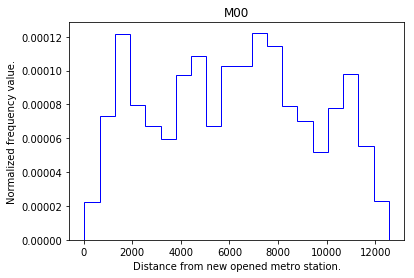

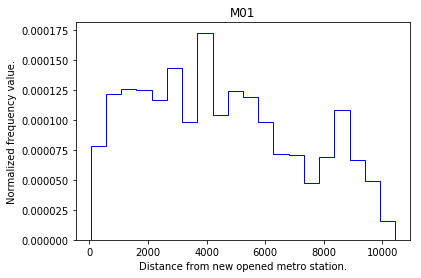

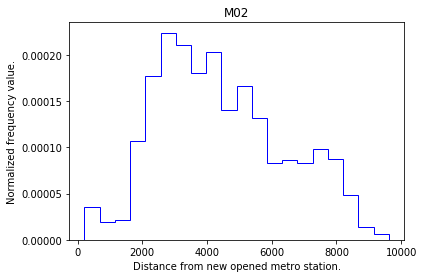

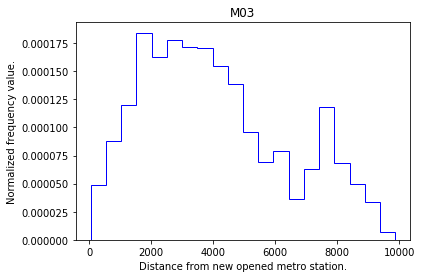

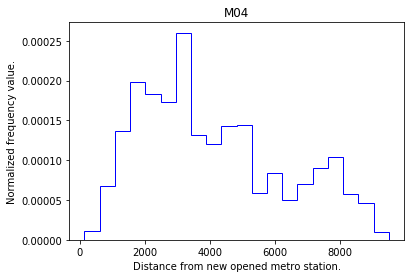

...

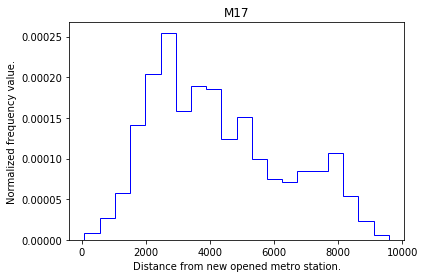

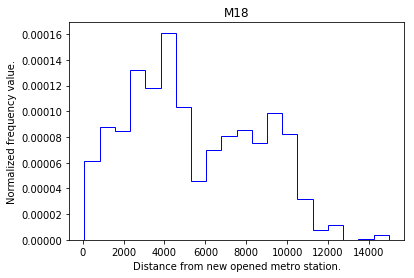

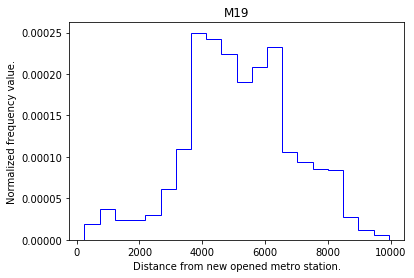

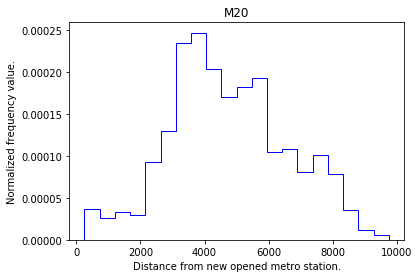

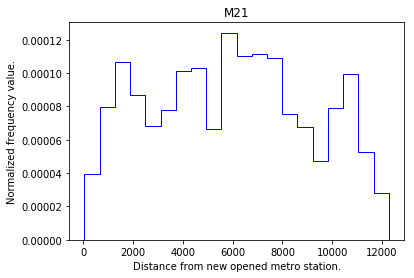

In [66]:
for plot_id in range(0, len(dm.columns), 1):
    plt.hist(dm[dm.columns[plot_id]], bins = 20, color = "b", normed = True, histtype = 'step')
    plt.title(dm.columns[plot_id])
    plt.xlabel("Distance from new opened metro station.")
    plt.ylabel("Normalized frequency value.")
    plt.show()

<h2>#03-4| Filtering values from DM</h2>

<p>Here we will filter the Distance Matrix dataset by leaving only those which are in less than <strong>550</strong> meters from any new opened metro station.</p>


In [29]:
dm_f = dm
threshold_distance = 550

for this_transaction in range(0, len(ds_w), 1):
    for this_station in range(0, m, 1):
        if dm_f.iat[this_transaction, this_station] > threshold_distance:
            dm_f.iat[this_transaction, this_station] = 0

In [33]:
print("Filtered Distance Matrix (dm_f) has {} columns.".format(len(dm_f.columns)))

Filtered Distance Matrix (dm_f) has 22 columns.


<h2>#03-5| Checking amounts of time series data</h2>

<p>Check how many properties are less than 550 meters away from new opened metro stations per each one.</p>

In [216]:
m_counts = []
m_d = {}

for station in range(0, m, 1):
    print("Metro station M{} has {} that are less than {} m away.".format(dm.columns[station],
                                                                        dm_f[dm.columns[station]][dm_f[dm.columns[station]] > 0].count(),
                                                                        threshold_distance))
    m_d[dm.columns[station]] = dm_f[dm.columns[station]][dm_f[dm.columns[station]] > 0].count()
    
m_counts.append(dict(m_d))
    
print("")
print(m_counts)

m_counts_df = pd.DataFrame(m_counts).fillna(0)

Metro station MM00 has 1762 that are less than 550 m away.
Metro station MM01 has 7555 that are less than 550 m away.
Metro station MM02 has 2340 that are less than 550 m away.
Metro station MM03 has 4876 that are less than 550 m away.
Metro station MM04 has 798 that are less than 550 m away.
Metro station MM05 has 5205 that are less than 550 m away.
Metro station MM06 has 822 that are less than 550 m away.
Metro station MM07 has 2850 that are less than 550 m away.
Metro station MM08 has 6269 that are less than 550 m away.
Metro station MM09 has 7852 that are less than 550 m away.
Metro station MM10 has 2057 that are less than 550 m away.
Metro station MM11 has 2207 that are less than 550 m away.
Metro station MM12 has 4059 that are less than 550 m away.
Metro station MM13 has 8910 that are less than 550 m away.
Metro station MM14 has 3731 that are less than 550 m away.
Metro station MM15 has 960 that are less than 550 m away.
Metro station MM16 has 4697 that are less than 550 m away.


In [112]:
m_counts_df = m_counts_df.T.reset_index()
m_counts_df

,index,0
0,M00,1762
1,M01,7555
2,M02,2340
3,M03,4876
4,M04,798
5,M05,5205
6,M06,822
7,M07,2850
8,M08,6269
9,M09,7852


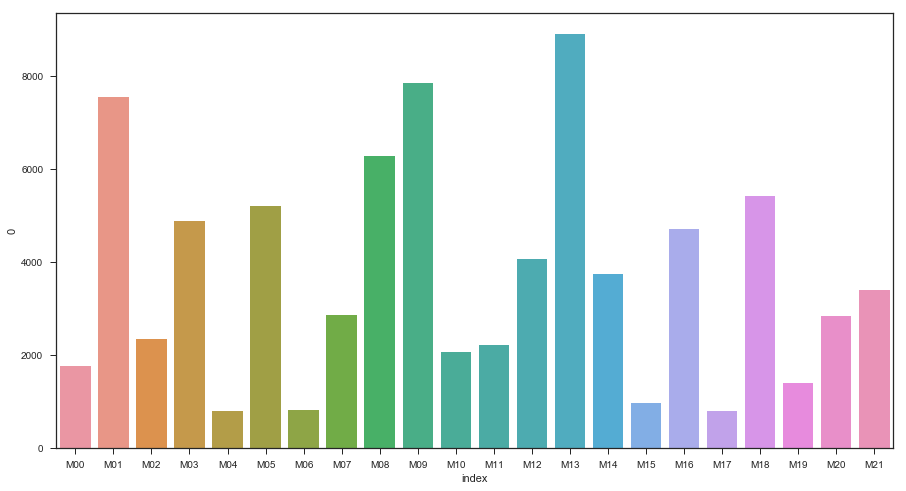

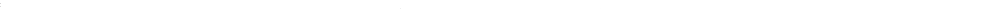

In [177]:
import seaborn as sns
from matplotlib import pyplot
%matplotlib inline
sns.set(style = "ticks")
fig, ax = plt.subplots()
fig.set_size_inches(15, 8)

g.set_axis_labels("Metro station", "Number of transactions < 500 m away from metro station")
g.despine(offset = 10, trim = True)
g = sns.factorplot(x ="index", y = 0, data = m_counts_df, kind="bar", size = 6.5, ax=ax, aspect = 100)

<h2>#03-6| Building Time-series data lines for each filtered property</h2>

<p>Let's try to building-up structure like this: <strong>[distance, [date_01 : price_01, date_02 : price_02, date_N : price_N]]</strong>.</p>

In [195]:
print("Our datasets should be equal: {} and {}".format(len(ds_w), len(dm_f)))

Our datasets should be equal: 196659 and 196659


In [265]:
dss = ds_w[["ID", "residentialArea", "address", "saleDate", "salePrice", "bbrLink", "lat", "lng", "bbrejd", "saleType"]].reset_index()

In [266]:
dm_f.head(400)

,M00,M01,M02,M03,M04,M05,M06,M07,M08,M09,...,M12,M13,M14,M15,M16,M17,M18,M19,M20,M21
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [267]:
dss.head(10)

,index,ID,residentialArea,address,saleDate,salePrice,bbrLink,lat,lng,bbrejd,saleType
0,92,0,128,Restrupvej 28,23-04-1996,905000,~/boligen/185-141527/bbr,55.609,12.580117,141527,Fri handel
1,93,1,96,Høgildvej 11,3/2/2016,3020000,~/boligen/185-54845/bbr,55.612,12.600170,54845,Fri handel
2,94,2,96,Høgildvej 11,24-07-2007,2450000,~/boligen/185-54845/bbr,55.612,12.600170,54845,Fri handel
3,95,3,96,Høgildvej 11,17-11-1998,1116600,~/boligen/185-54845/bbr,55.612,12.600170,54845,Fri handel
4,96,4,96,Høgildvej 11,22-03-1995,440000,~/boligen/185-54845/bbr,55.612,12.600170,54845,Fri handel
5,97,5,96,Høgildvej 11,16-08-1993,440000,~/boligen/185-54845/bbr,55.612,12.600170,54845,Fri handel
6,99,6,168,Munkebjergvej 25,16-07-2015,2660000,~/boligen/185-80978/bbr,55.619,12.597888,80978,Fri handel
7,100,7,168,Munkebjergvej 25,13-02-1995,690000,~/boligen/185-80978/bbr,55.619,12.597888,80978,Fri handel
8,101,8,168,Munkebjergvej 25,18-09-1993,669340,~/boligen/185-80978/bbr,55.619,12.597888,80978,Fri handel
9,102,9,168,Munkebjergvej 25,2/7/1993,270000,~/boligen/185-80978/bbr,55.619,12.597888,80978,Fri handel


<h3>#03-6.1 Build dataframe for build time series data arrays</h3>

<p>Construct whole database for time series analysis:</p>
<p><strong>list_db</strong> : <strong>this_list_of_dicts</strong> : <strong>Data of property</strong></p>

In [292]:
dss_dict = dss.to_dict(orient = 'record')   # convert 

full_db_l = [] # Full dataset for data visualization

for station in range(0, m, 1):
    
    this_list_of_dicts = []
    
    print("----------------------------")
    print("STATION:", station)
    print(dm_f)
    
    for row in range(0, len(dss), 1):
        if dm_f.iat[row, 0] != 0:
            this_list_of_dicts.append(dss_dict[row])
            
            full_db_l.append(dict(dss_dict[row]))
            
            #print(row, ":", dm_f.iat[row, station], ":", dss.iat[row, dss.columns.get_loc("address")])
            
    list_db.append(this_list_of_dicts)    

----------------------------
STATION: 0
----------------------------
STATION: 1
----------------------------
STATION: 2
----------------------------
STATION: 3
----------------------------
STATION: 4
----------------------------
STATION: 5
----------------------------
STATION: 6
----------------------------
STATION: 7
----------------------------
STATION: 8
----------------------------
STATION: 9
----------------------------
STATION: 10
----------------------------
STATION: 11
----------------------------
STATION: 12
----------------------------
STATION: 13
----------------------------
STATION: 14
----------------------------
STATION: 15
----------------------------
STATION: 16
----------------------------
STATION: 17
----------------------------
STATION: 18
----------------------------
STATION: 19
----------------------------
STATION: 20
----------------------------
STATION: 21


In [298]:
list_db[21]

[{'ID': 28,
  'address': 'Roselillevej 82',
  'bbrLink': '~/boligen/101-463885/bbr',
  'bbrejd': 463885,
  'index': 139,
  'lat': 55.652,
  'lng': 12.633852000000001,
  'residentialArea': 151,
  'saleDate': datetime.datetime(1993, 12, 20, 0, 0),
  'salePrice': 985640,
  'saleType': 'Fri handel'},
 {'ID': 29,
  'address': 'Roselillevej 82',
  'bbrLink': '~/boligen/101-463885/bbr',
  'bbrejd': 463885,
  'index': 140,
  'lat': 55.652,
  'lng': 12.633852000000001,
  'residentialArea': 151,
  'saleDate': datetime.datetime(1993, 10, 18, 0, 0),
  'salePrice': 354000,
  'saleType': 'Auktion'},
 {'ID': 358,
  'address': 'Engvej 124',
  'bbrLink': '~/boligen/101-128504/bbr',
  'bbrejd': 128504,
  'index': 1324,
  'lat': 55.6495,
  'lng': 12.633271,
  'residentialArea': 88,
  'saleDate': datetime.datetime(2015, 1, 4, 0, 0),
  'salePrice': 3388000,
  'saleType': 'Fri handel'},
 {'ID': 359,
  'address': 'Engvej 124',
  'bbrLink': '~/boligen/101-128504/bbr',
  'bbrejd': 128504,
  'index': 1325,
  'l

In [297]:
list_db_df = pd.DataFrame(list_db)

<h3>#03-6.2 Parse datetime</h3>

In [288]:
from datetime import datetime, date, time

for station in range(0, m, 1):
    for i in range(0, len(list_db[station]), 1):

        # Parse date format from dd-mm-yyy to mm-dd-yyyy
        try:
            if "-" in list_db[station][i]["saleDate"]:

                current_date = list_db[0][i]["saleDate"]
                year  = current_date.split("-")[2]
                month = current_date.split("-")[1]
                day   = current_date.split("-")[0]

                new_date = month + "/" + day + "/" + year
                list_db[station][i]["saleDate"] = new_date

                print(current_date, ":", new_date)
        except:
            None

        try:
            list_db[0][i]["saleDate"] = datetime.strptime(list_db[station][i]["saleDate"], '%m/%d/%Y')
        except:
            None

        print(list_db[0][i]["saleDate"], ":", list_db[station][i]["saleDate"].year, "|", 
              list_db[0][i]["saleDate"].month, "|", 
              list_db[0][i]["saleDate"].day)

1993-12-20 00:00:00 : 1993 | 12 | 20
1993-10-18 00:00:00 : 1993 | 10 | 18
2015-01-04 00:00:00 : 2015 | 1 | 4
2014-03-17 00:00:00 : 2014 | 3 | 17
2008-07-17 00:00:00 : 2008 | 7 | 17
1992-04-22 00:00:00 : 1992 | 4 | 22
2014-12-15 00:00:00 : 2014 | 12 | 15
2006-11-07 00:00:00 : 2006 | 11 | 7
1999-11-22 00:00:00 : 1999 | 11 | 22
2007-06-05 00:00:00 : 2007 | 6 | 5
1996-03-20 00:00:00 : 1996 | 3 | 20
2002-08-10 00:00:00 : 2002 | 8 | 10
2010-05-27 00:00:00 : 2010 | 5 | 27
2010-12-05 00:00:00 : 2010 | 12 | 5
1996-04-09 00:00:00 : 1996 | 4 | 9
2013-04-01 00:00:00 : 2013 | 4 | 1
2012-01-05 00:00:00 : 2012 | 1 | 5
2013-01-21 00:00:00 : 2013 | 1 | 21
2014-06-01 00:00:00 : 2014 | 6 | 1
2006-11-17 00:00:00 : 2006 | 11 | 17
2004-10-27 00:00:00 : 2004 | 10 | 27
1997-05-02 00:00:00 : 1997 | 5 | 2
1994-05-30 00:00:00 : 1994 | 5 | 30
2000-12-13 00:00:00 : 2000 | 12 | 13
2014-03-16 00:00:00 : 2014 | 3 | 16
2007-04-26 00:00:00 : 2007 | 4 | 26
2004-09-11 00:00:00 : 2004 | 9 | 11
2012-03-25 00:00:00 : 2012 |

2004-10-13 00:00:00 : 2004 | 10 | 13
1997-07-06 00:00:00 : 1997 | 7 | 6
1994-04-26 00:00:00 : 1994 | 4 | 26
2014-07-28 00:00:00 : 2014 | 7 | 28
2015-02-22 00:00:00 : 2015 | 2 | 22
2012-12-13 00:00:00 : 2012 | 12 | 13
1995-08-31 00:00:00 : 1995 | 8 | 31
2013-02-05 00:00:00 : 2013 | 2 | 5
2007-09-15 00:00:00 : 2007 | 9 | 15
2003-11-09 00:00:00 : 2003 | 11 | 9
2014-08-14 00:00:00 : 2014 | 8 | 14
2007-07-29 00:00:00 : 2007 | 7 | 29
2001-03-19 00:00:00 : 2001 | 3 | 19
2015-03-19 00:00:00 : 2015 | 3 | 19
1998-10-20 00:00:00 : 1998 | 10 | 20
2012-12-04 00:00:00 : 2012 | 12 | 4
1996-06-30 00:00:00 : 1996 | 6 | 30
2012-01-23 00:00:00 : 2012 | 1 | 23
1998-04-17 00:00:00 : 1998 | 4 | 17
2017-06-20 00:00:00 : 2017 | 6 | 20
1995-03-15 00:00:00 : 1995 | 3 | 15
1994-12-21 00:00:00 : 1994 | 12 | 21
2012-11-14 00:00:00 : 2012 | 11 | 14
1996-02-05 00:00:00 : 1996 | 2 | 5
1992-05-05 00:00:00 : 1992 | 5 | 5
2003-09-18 00:00:00 : 2003 | 9 | 18
1997-02-20 00:00:00 : 1997 | 2 | 20
2013-06-02 00:00:00 : 2013 

1998-01-08 00:00:00 : 1998 | 1 | 8
1999-04-26 00:00:00 : 1999 | 4 | 26
2002-01-13 00:00:00 : 2002 | 1 | 13
1997-12-16 00:00:00 : 1997 | 12 | 16
1995-08-28 00:00:00 : 1995 | 8 | 28
2009-03-12 00:00:00 : 2009 | 3 | 12
2015-06-10 00:00:00 : 2015 | 6 | 10
2015-08-09 00:00:00 : 2015 | 8 | 9
1994-02-05 00:00:00 : 1994 | 2 | 5
2015-12-20 00:00:00 : 2015 | 12 | 20
2014-11-18 00:00:00 : 2014 | 11 | 18
2013-08-27 00:00:00 : 2013 | 8 | 27
2013-07-25 00:00:00 : 2013 | 7 | 25
2013-03-24 00:00:00 : 2013 | 3 | 24
2004-03-02 00:00:00 : 2004 | 3 | 2
1995-12-14 00:00:00 : 1995 | 12 | 14
2002-08-18 00:00:00 : 2002 | 8 | 18
2002-03-22 00:00:00 : 2002 | 3 | 22
2014-12-11 00:00:00 : 2014 | 12 | 11
2016-06-06 00:00:00 : 2016 | 6 | 6
2014-08-19 00:00:00 : 2014 | 8 | 19
2016-01-20 00:00:00 : 2016 | 1 | 20
2014-06-24 00:00:00 : 2014 | 6 | 24
2013-11-18 00:00:00 : 2013 | 11 | 18
2017-05-22 00:00:00 : 2017 | 5 | 22
2013-02-12 00:00:00 : 2013 | 2 | 12
2013-08-28 00:00:00 : 2013 | 8 | 28
2018-12-03 00:00:00 : 2018 

2004-12-20 00:00:00 : 2004 | 12 | 20
2011-02-03 00:00:00 : 2011 | 2 | 3
2005-06-29 00:00:00 : 2005 | 6 | 29
2004-11-23 00:00:00 : 2004 | 11 | 23
2007-02-27 00:00:00 : 2007 | 2 | 27
2005-05-01 00:00:00 : 2005 | 5 | 1
2005-01-29 00:00:00 : 2005 | 1 | 29
2015-06-18 00:00:00 : 2015 | 6 | 18
2010-12-10 00:00:00 : 2010 | 12 | 10
2005-02-06 00:00:00 : 2005 | 2 | 6
2005-12-21 00:00:00 : 2005 | 12 | 21
2004-12-16 00:00:00 : 2004 | 12 | 16
2009-09-11 00:00:00 : 2009 | 9 | 11
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-10-06 00:00:00 : 2005 | 10 | 6
2007-05-11 00:00:00 : 2007 | 5 | 11
2005-05-30 00:00:00 : 2005 | 5 | 30
2005-06-13 00:00:00 : 2005 | 6 | 13
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-10-06 00:00:00 : 2005 | 10 | 6
2014-12-03 00:00:00 : 2014 | 12 | 3
2014-02-24 00:00:00 : 2014 | 2 | 24
2014-03-31 00:00:00 : 2014 | 3 | 31
2014-10-03 00:00:00 : 2014 | 10 | 3
2014-03-17 00:00:00 : 2014 | 3 | 17
2014-02-25 00:00:00 : 2014 | 2 | 25
2016-04-02 00:00:00 : 2016 | 4 | 2
2016-01-22 00:00:00 : 2016 | 

2007-09-11 00:00:00 : 2007 | 9 | 11
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-10-19 00:00:00 : 2012 | 10 | 19
2009-03-20 00:00:00 : 2009 | 3 | 20
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-02-18 00:00:00 : 2015 | 2 | 18
2007-12-01 00:00:00 : 2007 | 12 | 1
2010-08-15 00:00:00 : 2010 | 8 | 15
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-02-09 00:00:00 : 2013 | 2 | 9
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-10-31 00:00:00 : 2007 | 10 | 31
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-04-22 00:00:00 : 2015 | 4 | 22
2007-02-19 00:00:00 : 2007 | 2 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2008-08-04 00:00:00 : 2008 | 8 | 4
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-11-24 00:00:00 : 2017 | 11 | 24
2009-07-29 00:00:00 : 2009 | 7 | 29
2011-12-01 00:00:00 : 2011 | 12 | 1
2008-11-28 00:00:00 : 2008 | 11 | 28
2010-11-27 00:00:00 : 2010 | 11 | 27
2007-04-02 00:00:00 : 2007 | 4 | 2
2009-06-23 00:00:00 : 2009 | 6 | 23
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-05-31 00:00:00 : 2017 | 5 | 31
2007-12-01 00:00:00 : 2007

2007-04-18 00:00:00 : 2007 | 4 | 18
2014-12-23 00:00:00 : 2014 | 12 | 23
1997-03-18 00:00:00 : 1997 | 3 | 18
1995-06-27 00:00:00 : 1995 | 6 | 27
1994-08-08 00:00:00 : 1994 | 8 | 8
1992-09-29 00:00:00 : 1992 | 9 | 29
2003-07-01 00:00:00 : 2003 | 7 | 1
2001-12-06 00:00:00 : 2001 | 12 | 6
1997-08-17 00:00:00 : 1997 | 8 | 17
2000-08-30 00:00:00 : 2000 | 8 | 30
1998-11-06 00:00:00 : 1998 | 11 | 6
2007-02-21 00:00:00 : 2007 | 2 | 21
1995-09-12 00:00:00 : 1995 | 9 | 12
1995-06-19 00:00:00 : 1995 | 6 | 19
2014-02-26 00:00:00 : 2014 | 2 | 26
2004-01-02 00:00:00 : 2004 | 1 | 2
2016-03-23 00:00:00 : 2016 | 3 | 23
2008-08-09 00:00:00 : 2008 | 8 | 9
2007-08-17 00:00:00 : 2007 | 8 | 17
2014-03-03 00:00:00 : 2014 | 3 | 3
2008-04-15 00:00:00 : 2008 | 4 | 15
1995-06-06 00:00:00 : 1995 | 6 | 6
2011-03-21 00:00:00 : 2011 | 3 | 21
1996-09-08 00:00:00 : 1996 | 9 | 8
2006-07-26 00:00:00 : 2006 | 7 | 26
2000-08-31 00:00:00 : 2000 | 8 | 31
1993-04-10 00:00:00 : 1993 | 4 | 10
2013-01-03 00:00:00 : 2013 | 1 | 3

2010-12-03 00:00:00 : 2010 | 12 | 3
2009-08-24 00:00:00 : 2009 | 8 | 24
1996-03-04 00:00:00 : 1996 | 3 | 4
1995-04-29 00:00:00 : 1995 | 4 | 29
2015-03-06 00:00:00 : 2015 | 3 | 6
2000-11-08 00:00:00 : 2000 | 11 | 8
1994-06-26 00:00:00 : 1994 | 6 | 26
2009-04-23 00:00:00 : 2009 | 4 | 23
1992-12-05 00:00:00 : 1992 | 12 | 5
1995-10-20 00:00:00 : 1995 | 10 | 20
2009-04-16 00:00:00 : 2009 | 4 | 16
2002-08-17 00:00:00 : 2002 | 8 | 17
1993-09-08 00:00:00 : 1993 | 9 | 8
2016-03-15 00:00:00 : 2016 | 3 | 15
2013-04-02 00:00:00 : 2013 | 4 | 2
2011-04-17 00:00:00 : 2011 | 4 | 17
2014-04-28 00:00:00 : 2014 | 4 | 28
1993-05-01 00:00:00 : 1993 | 5 | 1
2016-08-03 00:00:00 : 2016 | 8 | 3
1996-12-16 00:00:00 : 1996 | 12 | 16
2017-03-27 00:00:00 : 2017 | 3 | 27
2015-05-05 00:00:00 : 2015 | 5 | 5
2011-07-14 00:00:00 : 2011 | 7 | 14
2007-12-07 00:00:00 : 2007 | 12 | 7
1992-06-22 00:00:00 : 1992 | 6 | 22
2015-12-21 00:00:00 : 2015 | 12 | 21
1999-09-27 00:00:00 : 1999 | 9 | 27
2005-02-13 00:00:00 : 2005 | 2 |

2005-06-23 00:00:00 : 2005 | 6 | 23
2013-01-29 00:00:00 : 2013 | 1 | 29
2007-03-17 00:00:00 : 2007 | 3 | 17
2005-06-16 00:00:00 : 2005 | 6 | 16
2012-12-04 00:00:00 : 2012 | 12 | 4
2005-11-08 00:00:00 : 2005 | 11 | 8
2016-03-24 00:00:00 : 2016 | 3 | 24
2011-01-03 00:00:00 : 2011 | 1 | 3
2005-06-06 00:00:00 : 2005 | 6 | 6
2015-04-03 00:00:00 : 2015 | 4 | 3
2006-07-21 00:00:00 : 2006 | 7 | 21
2005-10-06 00:00:00 : 2005 | 10 | 6
2003-11-26 00:00:00 : 2003 | 11 | 26
2007-03-06 00:00:00 : 2007 | 3 | 6
2003-08-12 00:00:00 : 2003 | 8 | 12
2013-05-11 00:00:00 : 2013 | 5 | 11
2005-05-10 00:00:00 : 2005 | 5 | 10
2003-08-12 00:00:00 : 2003 | 8 | 12
2017-09-13 00:00:00 : 2017 | 9 | 13
2005-06-02 00:00:00 : 2005 | 6 | 2
2003-09-12 00:00:00 : 2003 | 9 | 12
2015-04-16 00:00:00 : 2015 | 4 | 16
2011-05-07 00:00:00 : 2011 | 5 | 7
2005-03-06 00:00:00 : 2005 | 3 | 6
2016-04-11 00:00:00 : 2016 | 4 | 11
2012-04-29 00:00:00 : 2012 | 4 | 29
2007-09-25 00:00:00 : 2007 | 9 | 25
2005-03-06 00:00:00 : 2005 | 3 | 6

2007-12-01 00:00:00 : 2007 | 12 | 1
2010-12-14 00:00:00 : 2010 | 12 | 14
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-07-20 00:00:00 : 2012 | 7 | 20
2007-06-19 00:00:00 : 2007 | 6 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-01-13 00:00:00 : 2013 | 1 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-10-26 00:00:00 : 2007 | 10 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-02-08 00:00:00 : 2016 | 2 | 8
2007-05-22 00:00:00 : 2007 | 5 | 22
2016-03-15 00:00:00 : 2016 | 3 | 15
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-09-03 00:00:00 : 2016 | 9 | 3
2008-03-13 00:00:00 : 2008 | 3 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-08-24 00:00:00 : 2007 | 8 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2011-12-10 00:00:00 : 2011 | 12 | 10
2007-04-30 00:00:00 : 2007 | 4 | 30
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-08-04 00:00:00 : 2015 | 8 | 4
2007-10-10 00:00:00 : 2007 | 10 | 10
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 

1998-02-25 00:00:00 : 1998 | 2 | 25
2017-10-13 00:00:00 : 2017 | 10 | 13
1994-07-24 00:00:00 : 1994 | 7 | 24
2018-02-15 00:00:00 : 2018 | 2 | 15
2013-12-04 00:00:00 : 2013 | 12 | 4
2010-05-20 00:00:00 : 2010 | 5 | 20
2007-01-01 00:00:00 : 2007 | 1 | 1
1992-08-19 00:00:00 : 1992 | 8 | 19
1994-10-10 00:00:00 : 1994 | 10 | 10
2010-03-11 00:00:00 : 2010 | 3 | 11
2000-12-17 00:00:00 : 2000 | 12 | 17
2000-01-04 00:00:00 : 2000 | 1 | 4
1999-06-05 00:00:00 : 1999 | 6 | 5
1993-10-31 00:00:00 : 1993 | 10 | 31
1997-10-26 00:00:00 : 1997 | 10 | 26
2006-03-05 00:00:00 : 2006 | 3 | 5
2004-12-01 00:00:00 : 2004 | 12 | 1
1998-03-21 00:00:00 : 1998 | 3 | 21
2007-10-09 00:00:00 : 2007 | 10 | 9
1993-02-13 00:00:00 : 1993 | 2 | 13
2009-02-26 00:00:00 : 2009 | 2 | 26
2002-04-20 00:00:00 : 2002 | 4 | 20
2015-11-09 00:00:00 : 2015 | 11 | 9
2013-07-08 00:00:00 : 2013 | 7 | 8
2010-08-11 00:00:00 : 2010 | 8 | 11
2010-05-11 00:00:00 : 2010 | 5 | 11
1993-12-05 00:00:00 : 1993 | 12 | 5
2009-03-22 00:00:00 : 2009 |

1996-12-12 00:00:00 : 1996 | 12 | 12
2015-03-18 00:00:00 : 2015 | 3 | 18
2012-02-24 00:00:00 : 2012 | 2 | 24
2016-05-30 00:00:00 : 2016 | 5 | 30
2008-02-09 00:00:00 : 2008 | 2 | 9
2002-05-21 00:00:00 : 2002 | 5 | 21
2017-06-30 00:00:00 : 2017 | 6 | 30
2001-11-20 00:00:00 : 2001 | 11 | 20
1998-04-15 00:00:00 : 1998 | 4 | 15
2012-10-08 00:00:00 : 2012 | 10 | 8
2002-02-07 00:00:00 : 2002 | 2 | 7
1993-10-13 00:00:00 : 1993 | 10 | 13
2017-08-08 00:00:00 : 2017 | 8 | 8
2016-09-07 00:00:00 : 2016 | 9 | 7
2017-05-17 00:00:00 : 2017 | 5 | 17
2006-03-31 00:00:00 : 2006 | 3 | 31
2014-07-15 00:00:00 : 2014 | 7 | 15
1998-05-02 00:00:00 : 1998 | 5 | 2
1992-12-06 00:00:00 : 1992 | 12 | 6
1998-02-19 00:00:00 : 1998 | 2 | 19
1993-03-16 00:00:00 : 1993 | 3 | 16
1997-06-24 00:00:00 : 1997 | 6 | 24
2009-06-01 00:00:00 : 2009 | 6 | 1
2017-11-17 00:00:00 : 2017 | 11 | 17
2012-12-17 00:00:00 : 2012 | 12 | 17
2001-12-14 00:00:00 : 2001 | 12 | 14
2000-08-02 00:00:00 : 2000 | 8 | 2
2012-06-06 00:00:00 : 2012 | 

2013-04-10 00:00:00 : 2013 | 4 | 10
2013-09-10 00:00:00 : 2013 | 9 | 10
2018-03-01 00:00:00 : 2018 | 3 | 1
2011-11-15 00:00:00 : 2011 | 11 | 15
1997-10-03 00:00:00 : 1997 | 10 | 3
1995-10-15 00:00:00 : 1995 | 10 | 15
2009-05-08 00:00:00 : 2009 | 5 | 8
2014-09-30 00:00:00 : 2014 | 9 | 30
2013-09-10 00:00:00 : 2013 | 9 | 10
2014-02-19 00:00:00 : 2014 | 2 | 19
2013-09-09 00:00:00 : 2013 | 9 | 9
2013-08-28 00:00:00 : 2013 | 8 | 28
2013-09-19 00:00:00 : 2013 | 9 | 19
2014-01-14 00:00:00 : 2014 | 1 | 14
2013-08-30 00:00:00 : 2013 | 8 | 30
2015-06-23 00:00:00 : 2015 | 6 | 23
2010-07-28 00:00:00 : 2010 | 7 | 28
2006-01-27 00:00:00 : 2006 | 1 | 27
1992-12-02 00:00:00 : 1992 | 12 | 2
2013-04-30 00:00:00 : 2013 | 4 | 30
2013-01-21 00:00:00 : 2013 | 1 | 21
2013-03-05 00:00:00 : 2013 | 3 | 5
2014-03-04 00:00:00 : 2014 | 3 | 4
2012-09-19 00:00:00 : 2012 | 9 | 19
2014-05-13 00:00:00 : 2014 | 5 | 13
2012-06-11 00:00:00 : 2012 | 6 | 11
2013-03-06 00:00:00 : 2013 | 3 | 6
2012-11-19 00:00:00 : 2012 | 11 

2012-06-26 00:00:00 : 2012 | 6 | 26
2012-03-05 00:00:00 : 2012 | 3 | 5
2011-11-07 00:00:00 : 2011 | 11 | 7
2011-06-04 00:00:00 : 2011 | 6 | 4
2012-04-30 00:00:00 : 2012 | 4 | 30
2013-06-18 00:00:00 : 2013 | 6 | 18
2016-03-05 00:00:00 : 2016 | 3 | 5
2013-04-17 00:00:00 : 2013 | 4 | 17
2011-06-04 00:00:00 : 2011 | 6 | 4
2013-08-02 00:00:00 : 2013 | 8 | 2
2012-03-04 00:00:00 : 2012 | 3 | 4
2014-10-14 00:00:00 : 2014 | 10 | 14
2012-03-20 00:00:00 : 2012 | 3 | 20
2012-07-08 00:00:00 : 2012 | 7 | 8
2016-05-31 00:00:00 : 2016 | 5 | 31
2011-06-04 00:00:00 : 2011 | 6 | 4
2014-10-01 00:00:00 : 2014 | 10 | 1
2011-08-19 00:00:00 : 2011 | 8 | 19
2016-09-11 00:00:00 : 2016 | 9 | 11
2011-03-05 00:00:00 : 2011 | 3 | 5
2011-06-04 00:00:00 : 2011 | 6 | 4
2012-07-20 00:00:00 : 2012 | 7 | 20
2011-06-04 00:00:00 : 2011 | 6 | 4
2011-06-04 00:00:00 : 2011 | 6 | 4
2016-05-10 00:00:00 : 2016 | 5 | 10
2016-06-09 00:00:00 : 2016 | 6 | 9
2012-05-03 00:00:00 : 2012 | 5 | 3
2011-11-04 00:00:00 : 2011 | 11 | 4
2012-

2006-11-17 00:00:00 : 2006 | 11 | 17
2004-10-27 00:00:00 : 2004 | 10 | 27
1997-05-02 00:00:00 : 1997 | 5 | 2
1994-05-30 00:00:00 : 1994 | 5 | 30
2000-12-13 00:00:00 : 2000 | 12 | 13
2014-03-16 00:00:00 : 2014 | 3 | 16
2007-04-26 00:00:00 : 2007 | 4 | 26
2004-09-11 00:00:00 : 2004 | 9 | 11
2012-03-25 00:00:00 : 2012 | 3 | 25
2001-03-30 00:00:00 : 2001 | 3 | 30
1994-11-15 00:00:00 : 1994 | 11 | 15
2011-07-02 00:00:00 : 2011 | 7 | 2
2004-12-05 00:00:00 : 2004 | 12 | 5
2004-01-14 00:00:00 : 2004 | 1 | 14
2000-06-30 00:00:00 : 2000 | 6 | 30
1997-05-21 00:00:00 : 1997 | 5 | 21
2011-01-19 00:00:00 : 2011 | 1 | 19
1998-03-27 00:00:00 : 1998 | 3 | 27
1996-07-18 00:00:00 : 1996 | 7 | 18
1992-01-16 00:00:00 : 1992 | 1 | 16
2007-12-01 00:00:00 : 2007 | 12 | 1
2004-10-31 00:00:00 : 2004 | 10 | 31
2001-09-25 00:00:00 : 2001 | 9 | 25
1999-06-06 00:00:00 : 1999 | 6 | 6
1995-07-19 00:00:00 : 1995 | 7 | 19
1994-02-08 00:00:00 : 1994 | 2 | 8
2008-04-14 00:00:00 : 2008 | 4 | 14
2010-10-02 00:00:00 : 2010 

2000-08-30 00:00:00 : 2000 | 8 | 30
2004-10-13 00:00:00 : 2004 | 10 | 13
1997-07-06 00:00:00 : 1997 | 7 | 6
1994-04-26 00:00:00 : 1994 | 4 | 26
2014-07-28 00:00:00 : 2014 | 7 | 28
2015-02-22 00:00:00 : 2015 | 2 | 22
2012-12-13 00:00:00 : 2012 | 12 | 13
1995-08-31 00:00:00 : 1995 | 8 | 31
2013-02-05 00:00:00 : 2013 | 2 | 5
2007-09-15 00:00:00 : 2007 | 9 | 15
2003-11-09 00:00:00 : 2003 | 11 | 9
2014-08-14 00:00:00 : 2014 | 8 | 14
2007-07-29 00:00:00 : 2007 | 7 | 29
2001-03-19 00:00:00 : 2001 | 3 | 19
2015-03-19 00:00:00 : 2015 | 3 | 19
1998-10-20 00:00:00 : 1998 | 10 | 20
2012-12-04 00:00:00 : 2012 | 12 | 4
1996-06-30 00:00:00 : 1996 | 6 | 30
2012-01-23 00:00:00 : 2012 | 1 | 23
1998-04-17 00:00:00 : 1998 | 4 | 17
2017-06-20 00:00:00 : 2017 | 6 | 20
1995-03-15 00:00:00 : 1995 | 3 | 15
1994-12-21 00:00:00 : 1994 | 12 | 21
2012-11-14 00:00:00 : 2012 | 11 | 14
1996-02-05 00:00:00 : 1996 | 2 | 5
1992-05-05 00:00:00 : 1992 | 5 | 5
2003-09-18 00:00:00 : 2003 | 9 | 18
1997-02-20 00:00:00 : 1997 

2005-02-13 00:00:00 : 2005 | 2 | 13
2017-03-23 00:00:00 : 2017 | 3 | 23
1993-02-23 00:00:00 : 1993 | 2 | 23
2007-11-06 00:00:00 : 2007 | 11 | 6
2006-05-04 00:00:00 : 2006 | 5 | 4
1996-02-20 00:00:00 : 1996 | 2 | 20
2011-02-28 00:00:00 : 2011 | 2 | 28
2005-11-06 00:00:00 : 2005 | 11 | 6
2013-04-24 00:00:00 : 2013 | 4 | 24
2004-01-25 00:00:00 : 2004 | 1 | 25
2008-05-18 00:00:00 : 2008 | 5 | 18
2016-06-16 00:00:00 : 2016 | 6 | 16
2016-06-16 00:00:00 : 2016 | 6 | 16
2006-05-25 00:00:00 : 2006 | 5 | 25
2004-07-01 00:00:00 : 2004 | 7 | 1
1997-09-24 00:00:00 : 1997 | 9 | 24
2013-08-19 00:00:00 : 2013 | 8 | 19
2002-04-20 00:00:00 : 2002 | 4 | 20
2013-02-08 00:00:00 : 2013 | 2 | 8
2014-05-28 00:00:00 : 2014 | 5 | 28
2017-10-16 00:00:00 : 2017 | 10 | 16
1998-01-08 00:00:00 : 1998 | 1 | 8
1999-04-26 00:00:00 : 1999 | 4 | 26
2002-01-13 00:00:00 : 2002 | 1 | 13
1997-12-16 00:00:00 : 1997 | 12 | 16
1995-08-28 00:00:00 : 1995 | 8 | 28
2009-03-12 00:00:00 : 2009 | 3 | 12
2015-06-10 00:00:00 : 2015 | 6

2005-06-06 00:00:00 : 2005 | 6 | 6
2014-09-16 00:00:00 : 2014 | 9 | 16
2005-06-23 00:00:00 : 2005 | 6 | 23
2014-01-29 00:00:00 : 2014 | 1 | 29
2008-08-06 00:00:00 : 2008 | 8 | 6
2005-06-06 00:00:00 : 2005 | 6 | 6
2005-05-30 00:00:00 : 2005 | 5 | 30
2017-11-04 00:00:00 : 2017 | 11 | 4
2009-11-05 00:00:00 : 2009 | 11 | 5
2005-10-06 00:00:00 : 2005 | 10 | 6
2005-10-06 00:00:00 : 2005 | 10 | 6
2014-10-27 00:00:00 : 2014 | 10 | 27
2005-10-24 00:00:00 : 2005 | 10 | 24
2005-06-06 00:00:00 : 2005 | 6 | 6
2011-02-16 00:00:00 : 2011 | 2 | 16
2005-06-13 00:00:00 : 2005 | 6 | 13
2016-08-04 00:00:00 : 2016 | 8 | 4
2013-01-31 00:00:00 : 2013 | 1 | 31
2005-12-07 00:00:00 : 2005 | 12 | 7
2013-06-13 00:00:00 : 2013 | 6 | 13
2011-03-28 00:00:00 : 2011 | 3 | 28
2005-06-06 00:00:00 : 2005 | 6 | 6
2015-12-15 00:00:00 : 2015 | 12 | 15
2005-05-29 00:00:00 : 2005 | 5 | 29
2010-10-09 00:00:00 : 2010 | 10 | 9
2005-06-23 00:00:00 : 2005 | 6 | 23
2013-01-29 00:00:00 : 2013 | 1 | 29
2007-03-17 00:00:00 : 2007 | 3 

2007-12-01 00:00:00 : 2007 | 12 | 1
2016-12-19 00:00:00 : 2016 | 12 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-08-11 00:00:00 : 2013 | 8 | 11
2012-10-09 00:00:00 : 2012 | 10 | 9
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-05-15 00:00:00 : 2017 | 5 | 15
2014-02-07 00:00:00 : 2014 | 2 | 7
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-11-04 00:00:00 : 2012 | 11 | 4
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-10-24 00:00:00 : 2012 | 10 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2010-04-19 00:00:00 : 2010 | 4 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-12-06 00:00:00 : 2012 | 12 | 6
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-04-26 00:00:00 : 2016 | 4 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-08-03 00:00:00 : 2012 | 8 | 3
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-10-01 00:00:00 : 2017 | 10 | 1
2008-07-15 00:00:00 : 2008 | 7 | 15
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-08-21 00:00:00 : 2015 | 8 | 21
2010-09-08 00:00:00 : 2010 |

2003-05-27 00:00:00 : 2003 | 5 | 27
2016-05-02 00:00:00 : 2016 | 5 | 2
2012-09-13 00:00:00 : 2012 | 9 | 13
2013-08-22 00:00:00 : 2013 | 8 | 22
2001-08-20 00:00:00 : 2001 | 8 | 20
1996-02-20 00:00:00 : 1996 | 2 | 20
1992-05-05 00:00:00 : 1992 | 5 | 5
1996-04-02 00:00:00 : 1996 | 4 | 2
1992-09-11 00:00:00 : 1992 | 9 | 11
2004-04-06 00:00:00 : 2004 | 4 | 6
2005-10-18 00:00:00 : 2005 | 10 | 18
2005-01-14 00:00:00 : 2005 | 1 | 14
2004-11-27 00:00:00 : 2004 | 11 | 27
2017-05-30 00:00:00 : 2017 | 5 | 30
1998-04-13 00:00:00 : 1998 | 4 | 13
2015-07-20 00:00:00 : 2015 | 7 | 20
2000-08-10 00:00:00 : 2000 | 8 | 10
2015-02-24 00:00:00 : 2015 | 2 | 24
2017-07-17 00:00:00 : 2017 | 7 | 17
2007-12-16 00:00:00 : 2007 | 12 | 16
2012-02-21 00:00:00 : 2012 | 2 | 21
2008-11-03 00:00:00 : 2008 | 11 | 3
1999-05-20 00:00:00 : 1999 | 5 | 20
2002-07-17 00:00:00 : 2002 | 7 | 17
1993-06-16 00:00:00 : 1993 | 6 | 16
2013-08-02 00:00:00 : 2013 | 8 | 2
2006-08-25 00:00:00 : 2006 | 8 | 25
2003-09-16 00:00:00 : 2003 | 9

2007-08-23 00:00:00 : 2007 | 8 | 23
2001-05-30 00:00:00 : 2001 | 5 | 30
1992-01-11 00:00:00 : 1992 | 1 | 11
2002-08-26 00:00:00 : 2002 | 8 | 26
1997-01-25 00:00:00 : 1997 | 1 | 25
2003-03-11 00:00:00 : 2003 | 3 | 11
1999-08-08 00:00:00 : 1999 | 8 | 8
2010-10-27 00:00:00 : 2010 | 10 | 27
2007-08-11 00:00:00 : 2007 | 8 | 11
2001-02-20 00:00:00 : 2001 | 2 | 20
1998-10-09 00:00:00 : 1998 | 10 | 9
2017-01-02 00:00:00 : 2017 | 1 | 2
2004-03-31 00:00:00 : 2004 | 3 | 31
1992-08-25 00:00:00 : 1992 | 8 | 25
2005-01-26 00:00:00 : 2005 | 1 | 26
1997-05-31 00:00:00 : 1997 | 5 | 31
2015-06-08 00:00:00 : 2015 | 6 | 8
2012-01-04 00:00:00 : 2012 | 1 | 4
2015-03-27 00:00:00 : 2015 | 3 | 27
2004-12-05 00:00:00 : 2004 | 12 | 5
2010-10-06 00:00:00 : 2010 | 10 | 6
2001-08-08 00:00:00 : 2001 | 8 | 8
2010-06-10 00:00:00 : 2010 | 6 | 10
2015-03-04 00:00:00 : 2015 | 3 | 4
2009-02-08 00:00:00 : 2009 | 2 | 8
2003-10-19 00:00:00 : 2003 | 10 | 19
1997-06-22 00:00:00 : 1997 | 6 | 22
2014-03-31 00:00:00 : 2014 | 3 | 

2007-02-23 00:00:00 : 2007 | 2 | 23
2001-08-29 00:00:00 : 2001 | 8 | 29
2008-11-20 00:00:00 : 2008 | 11 | 20
2001-12-09 00:00:00 : 2001 | 12 | 9
2002-01-17 00:00:00 : 2002 | 1 | 17
2017-08-12 00:00:00 : 2017 | 8 | 12
2001-10-22 00:00:00 : 2001 | 10 | 22
2006-09-04 00:00:00 : 2006 | 9 | 4
2001-01-17 00:00:00 : 2001 | 1 | 17
2015-07-04 00:00:00 : 2015 | 7 | 4
2011-04-27 00:00:00 : 2011 | 4 | 27
2002-11-27 00:00:00 : 2002 | 11 | 27
2006-06-10 00:00:00 : 2006 | 6 | 10
2001-08-29 00:00:00 : 2001 | 8 | 29
2016-10-23 00:00:00 : 2016 | 10 | 23
2001-11-30 00:00:00 : 2001 | 11 | 30
2014-01-12 00:00:00 : 2014 | 1 | 12
2010-10-25 00:00:00 : 2010 | 10 | 25
2003-08-12 00:00:00 : 2003 | 8 | 12
2017-09-05 00:00:00 : 2017 | 9 | 5
2014-08-15 00:00:00 : 2014 | 8 | 15
2003-12-30 00:00:00 : 2003 | 12 | 30
2015-05-05 00:00:00 : 2015 | 5 | 5
2009-04-11 00:00:00 : 2009 | 4 | 11
2003-12-30 00:00:00 : 2003 | 12 | 30
2010-01-25 00:00:00 : 2010 | 1 | 25
2003-09-12 00:00:00 : 2003 | 9 | 12
2009-11-06 00:00:00 : 20

2015-02-26 00:00:00 : 2015 | 2 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2010-12-14 00:00:00 : 2010 | 12 | 14
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-07-20 00:00:00 : 2012 | 7 | 20
2007-06-19 00:00:00 : 2007 | 6 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-01-13 00:00:00 : 2013 | 1 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-10-26 00:00:00 : 2007 | 10 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-02-08 00:00:00 : 2016 | 2 | 8
2007-05-22 00:00:00 : 2007 | 5 | 22
2016-03-15 00:00:00 : 2016 | 3 | 15
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-09-03 00:00:00 : 2016 | 9 | 3
2008-03-13 00:00:00 : 2008 | 3 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-08-24 00:00:00 : 2007 | 8 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2011-12-10 00:00:00 : 2011 | 12 | 10
2007-04-30 00:00:00 : 2007 | 4 | 30
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-08-04 00:00:00 : 2015 | 8 | 4
2007-10-10 00:00:00 : 2007 | 10 | 10
2007-12-01 00:00:00 : 2007 

2011-10-19 00:00:00 : 2011 | 10 | 19
1993-10-09 00:00:00 : 1993 | 10 | 9
1993-06-08 00:00:00 : 1993 | 6 | 8
1993-05-25 00:00:00 : 1993 | 5 | 25
2008-03-11 00:00:00 : 2008 | 3 | 11
1997-06-01 00:00:00 : 1997 | 6 | 1
2018-02-25 00:00:00 : 2018 | 2 | 25
2003-04-23 00:00:00 : 2003 | 4 | 23
2017-02-14 00:00:00 : 2017 | 2 | 14
2017-04-27 00:00:00 : 2017 | 4 | 27
2002-03-01 00:00:00 : 2002 | 3 | 1
2015-10-29 00:00:00 : 2015 | 10 | 29
2015-03-02 00:00:00 : 2015 | 3 | 2
2015-01-29 00:00:00 : 2015 | 1 | 29
1999-04-14 00:00:00 : 1999 | 4 | 14
1992-05-26 00:00:00 : 1992 | 5 | 26
2005-12-28 00:00:00 : 2005 | 12 | 28
1993-01-27 00:00:00 : 1993 | 1 | 27
2004-03-12 00:00:00 : 2004 | 3 | 12
2001-06-25 00:00:00 : 2001 | 6 | 25
2017-02-23 00:00:00 : 2017 | 2 | 23
1999-02-11 00:00:00 : 1999 | 2 | 11
1992-03-31 00:00:00 : 1992 | 3 | 31
1994-05-06 00:00:00 : 1994 | 5 | 6
1992-06-02 00:00:00 : 1992 | 6 | 2
2012-05-16 00:00:00 : 2012 | 5 | 16
1993-05-25 00:00:00 : 1993 | 5 | 25
2016-02-08 00:00:00 : 2016 | 2 

1997-12-03 00:00:00 : 1997 | 12 | 3
1996-05-12 00:00:00 : 1996 | 5 | 12
2009-12-06 00:00:00 : 2009 | 12 | 6
1993-09-02 00:00:00 : 1993 | 9 | 2
2014-09-09 00:00:00 : 2014 | 9 | 9
1998-05-04 00:00:00 : 1998 | 5 | 4
2014-12-14 00:00:00 : 2014 | 12 | 14
2013-08-22 00:00:00 : 2013 | 8 | 22
1992-05-11 00:00:00 : 1992 | 5 | 11
2017-01-27 00:00:00 : 2017 | 1 | 27
2001-11-10 00:00:00 : 2001 | 11 | 10
1994-08-09 00:00:00 : 1994 | 8 | 9
2015-12-15 00:00:00 : 2015 | 12 | 15
1992-09-25 00:00:00 : 1992 | 9 | 25
2008-06-17 00:00:00 : 2008 | 6 | 17
1997-09-24 00:00:00 : 1997 | 9 | 24
1999-09-13 00:00:00 : 1999 | 9 | 13
2017-12-20 00:00:00 : 2017 | 12 | 20
2014-04-15 00:00:00 : 2014 | 4 | 15
2012-01-31 00:00:00 : 2012 | 1 | 31
2000-12-04 00:00:00 : 2000 | 12 | 4
1996-08-28 00:00:00 : 1996 | 8 | 28
2005-05-24 00:00:00 : 2005 | 5 | 24
2012-07-02 00:00:00 : 2012 | 7 | 2
1997-05-30 00:00:00 : 1997 | 5 | 30
2002-01-15 00:00:00 : 2002 | 1 | 15
1999-08-14 00:00:00 : 1999 | 8 | 14
2017-05-24 00:00:00 : 2017 | 

2005-08-06 00:00:00 : 2005 | 8 | 6
2005-06-06 00:00:00 : 2005 | 6 | 6
2005-03-06 00:00:00 : 2005 | 3 | 6
2007-10-07 00:00:00 : 2007 | 10 | 7
2005-03-06 00:00:00 : 2005 | 3 | 6
2009-01-11 00:00:00 : 2009 | 1 | 11
2005-06-06 00:00:00 : 2005 | 6 | 6
2016-07-13 00:00:00 : 2016 | 7 | 13
2013-03-24 00:00:00 : 2013 | 3 | 24
2007-12-13 00:00:00 : 2007 | 12 | 13
2005-03-06 00:00:00 : 2005 | 3 | 6
2017-02-14 00:00:00 : 2017 | 2 | 14
2012-06-07 00:00:00 : 2012 | 6 | 7
2012-06-07 00:00:00 : 2012 | 6 | 7
2013-07-05 00:00:00 : 2013 | 7 | 5
2013-12-02 00:00:00 : 2013 | 12 | 2
2013-07-18 00:00:00 : 2013 | 7 | 18
2013-03-18 00:00:00 : 2013 | 3 | 18
2012-12-14 00:00:00 : 2012 | 12 | 14
2013-03-20 00:00:00 : 2013 | 3 | 20
2015-08-04 00:00:00 : 2015 | 8 | 4
2013-05-13 00:00:00 : 2013 | 5 | 13
2013-01-29 00:00:00 : 2013 | 1 | 29
2014-09-12 00:00:00 : 2014 | 9 | 12
2014-01-27 00:00:00 : 2014 | 1 | 27
2012-06-07 00:00:00 : 2012 | 6 | 7
2017-09-26 00:00:00 : 2017 | 9 | 26
2012-08-22 00:00:00 : 2012 | 8 | 22
2

2007-06-07 00:00:00 : 2007 | 6 | 7
2016-07-31 00:00:00 : 2016 | 7 | 31
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-01-08 00:00:00 : 2015 | 1 | 8
2007-12-12 00:00:00 : 2007 | 12 | 12
2008-01-31 00:00:00 : 2008 | 1 | 31
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-08-27 00:00:00 : 2007 | 8 | 27
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-07-29 00:00:00 : 2015 | 7 | 29
2012-12-20 00:00:00 : 2012 | 12 | 20
2007-06-18 00:00:00 : 2007 | 6 | 18
2016-06-09 00:00:00 : 2016 | 6 | 9
2011-03-29 00:00:00 : 2011 | 3 | 29
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-06-01 00:00:00 : 2015 | 6 | 1
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2010-07-13 00:00:00 : 2010 | 7 | 13
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-07-27 00:00:00 : 2015 | 7 | 27
2015-05-26 00:00:00 : 2015 | 5 | 26
2010-02-27 00:00:00 : 2010 | 2 | 27
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2009-01-07 00:00:00 : 2009 | 1 | 7
2007-12-01 00:00:00 : 2007 | 12

2009-02-26 00:00:00 : 2009 | 2 | 26
2002-04-20 00:00:00 : 2002 | 4 | 20
2015-11-09 00:00:00 : 2015 | 11 | 9
2013-07-08 00:00:00 : 2013 | 7 | 8
2010-08-11 00:00:00 : 2010 | 8 | 11
2010-05-11 00:00:00 : 2010 | 5 | 11
1993-12-05 00:00:00 : 1993 | 12 | 5
2009-03-22 00:00:00 : 2009 | 3 | 22
2012-08-16 00:00:00 : 2012 | 8 | 16
1995-07-25 00:00:00 : 1995 | 7 | 25
2010-12-30 00:00:00 : 2010 | 12 | 30
2005-09-22 00:00:00 : 2005 | 9 | 22
2011-12-22 00:00:00 : 2011 | 12 | 22
2016-09-05 00:00:00 : 2016 | 9 | 5
2002-03-22 00:00:00 : 2002 | 3 | 22
2017-08-08 00:00:00 : 2017 | 8 | 8
2007-06-28 00:00:00 : 2007 | 6 | 28
2015-10-29 00:00:00 : 2015 | 10 | 29
2002-07-09 00:00:00 : 2002 | 7 | 9
1999-03-18 00:00:00 : 1999 | 3 | 18
1996-12-08 00:00:00 : 1996 | 12 | 8
1994-06-27 00:00:00 : 1994 | 6 | 27
2016-07-01 00:00:00 : 2016 | 7 | 1
2015-08-10 00:00:00 : 2015 | 8 | 10
1999-08-23 00:00:00 : 1999 | 8 | 23
2012-07-26 00:00:00 : 2012 | 7 | 26
2001-12-20 00:00:00 : 2001 | 12 | 20
1999-01-10 00:00:00 : 1999 | 

2006-11-15 00:00:00 : 2006 | 11 | 15
2002-05-27 00:00:00 : 2002 | 5 | 27
1995-11-04 00:00:00 : 1995 | 11 | 4
2001-04-02 00:00:00 : 2001 | 4 | 2
1995-03-07 00:00:00 : 1995 | 3 | 7
2014-12-17 00:00:00 : 2014 | 12 | 17
2005-12-12 00:00:00 : 2005 | 12 | 12
1995-03-04 00:00:00 : 1995 | 3 | 4
2015-01-27 00:00:00 : 2015 | 1 | 27
2001-02-01 00:00:00 : 2001 | 2 | 1
2000-07-26 00:00:00 : 2000 | 7 | 26
2016-06-06 00:00:00 : 2016 | 6 | 6
1997-05-29 00:00:00 : 1997 | 5 | 29
1994-03-11 00:00:00 : 1994 | 3 | 11
2009-07-07 00:00:00 : 2009 | 7 | 7
2010-04-15 00:00:00 : 2010 | 4 | 15
1998-09-17 00:00:00 : 1998 | 9 | 17
1998-04-19 00:00:00 : 1998 | 4 | 19
1994-08-08 00:00:00 : 1994 | 8 | 8
1993-04-26 00:00:00 : 1993 | 4 | 26
2013-09-15 00:00:00 : 2013 | 9 | 15
2000-03-03 00:00:00 : 2000 | 3 | 3
1999-05-17 00:00:00 : 1999 | 5 | 17
1992-05-10 00:00:00 : 1992 | 5 | 10
2016-08-19 00:00:00 : 2016 | 8 | 19
2000-03-30 00:00:00 : 2000 | 3 | 30
1995-10-27 00:00:00 : 1995 | 10 | 27
2014-12-17 00:00:00 : 2014 | 12 

2012-02-05 00:00:00 : 2012 | 2 | 5
2008-10-15 00:00:00 : 2008 | 10 | 15
1996-08-05 00:00:00 : 1996 | 8 | 5
2016-08-16 00:00:00 : 2016 | 8 | 16
2002-02-22 00:00:00 : 2002 | 2 | 22
1992-08-07 00:00:00 : 1992 | 8 | 7
2006-08-02 00:00:00 : 2006 | 8 | 2
2001-07-15 00:00:00 : 2001 | 7 | 15
2015-11-06 00:00:00 : 2015 | 11 | 6
2000-06-16 00:00:00 : 2000 | 6 | 16
2003-12-16 00:00:00 : 2003 | 12 | 16
1997-12-01 00:00:00 : 1997 | 12 | 1
1993-08-06 00:00:00 : 1993 | 8 | 6
2014-10-20 00:00:00 : 2014 | 10 | 20
1992-02-11 00:00:00 : 1992 | 2 | 11
2009-04-20 00:00:00 : 2009 | 4 | 20
1997-09-29 00:00:00 : 1997 | 9 | 29
1995-05-18 00:00:00 : 1995 | 5 | 18
2006-01-07 00:00:00 : 2006 | 1 | 7
2017-09-26 00:00:00 : 2017 | 9 | 26
2009-04-17 00:00:00 : 2009 | 4 | 17
1995-09-19 00:00:00 : 1995 | 9 | 19
1992-07-23 00:00:00 : 1992 | 7 | 23
2011-03-25 00:00:00 : 2011 | 3 | 25
2010-08-13 00:00:00 : 2010 | 8 | 13
2013-04-08 00:00:00 : 2013 | 4 | 8
2016-06-14 00:00:00 : 2016 | 6 | 14
1992-11-02 00:00:00 : 1992 | 11 

2007-06-18 00:00:00 : 2007 | 6 | 18
2017-04-23 00:00:00 : 2017 | 4 | 23
2016-07-12 00:00:00 : 2016 | 7 | 12
2015-02-16 00:00:00 : 2015 | 2 | 16
2008-07-02 00:00:00 : 2008 | 7 | 2
2007-06-18 00:00:00 : 2007 | 6 | 18
2014-02-02 00:00:00 : 2014 | 2 | 2
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-04-04 00:00:00 : 2017 | 4 | 4
2016-01-07 00:00:00 : 2016 | 1 | 7
2015-03-20 00:00:00 : 2015 | 3 | 20
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-02-06 00:00:00 : 2017 | 2 | 6
2015-07-04 00:00:00 : 2015 | 7 | 4
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-07-19 00:00:00 : 2017 | 7 | 19
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-02-08 00:00:00 : 2017 | 2 | 8
2007-11-11 00:00:00 : 2007 | 11 | 11
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-12-27 00:00:00 : 2017 | 12 | 27
2018-07-03 00:00:00 : 2018 | 7 | 3
2014-10-22 00:00:00 : 2014 | 10 | 22
2007-06-11 00:00:00 : 2007 | 6 | 11
2015-01-20 00:00:00 : 2015 | 1 | 20
2011-11-22 00:00:00 : 2011 | 11 | 22
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 |

2010-09-06 00:00:00 : 2010 | 9 | 6
1995-05-24 00:00:00 : 1995 | 5 | 24
1994-11-16 00:00:00 : 1994 | 11 | 16
1992-06-25 00:00:00 : 1992 | 6 | 25
2012-01-10 00:00:00 : 2012 | 1 | 10
2017-06-14 00:00:00 : 2017 | 6 | 14
2015-08-18 00:00:00 : 2015 | 8 | 18
2015-02-07 00:00:00 : 2015 | 2 | 7
2015-08-07 00:00:00 : 2015 | 8 | 7
2016-03-22 00:00:00 : 2016 | 3 | 22
2015-11-24 00:00:00 : 2015 | 11 | 24
2016-04-19 00:00:00 : 2016 | 4 | 19
2016-01-07 00:00:00 : 2016 | 1 | 7
2016-04-14 00:00:00 : 2016 | 4 | 14
2015-06-15 00:00:00 : 2015 | 6 | 15
2015-03-06 00:00:00 : 2015 | 3 | 6
2007-06-07 00:00:00 : 2007 | 6 | 7
2007-06-07 00:00:00 : 2007 | 6 | 7
2007-06-18 00:00:00 : 2007 | 6 | 18
2010-05-28 00:00:00 : 2010 | 5 | 28
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-10-23 00:00:00 : 2011 | 10 | 23
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2008-10-02 00:00:00 : 2008 | 10 | 2
2007-06-18 00:00:00 : 2007 | 6 |

1998-06-19 00:00:00 : 1998 | 6 | 19
1992-10-03 00:00:00 : 1992 | 10 | 3
2015-07-04 00:00:00 : 2015 | 7 | 4
2001-08-12 00:00:00 : 2001 | 8 | 12
2013-05-23 00:00:00 : 2013 | 5 | 23
2017-03-01 00:00:00 : 2017 | 3 | 1
2014-10-30 00:00:00 : 2014 | 10 | 30
2007-03-22 00:00:00 : 2007 | 3 | 22
2002-01-12 00:00:00 : 2002 | 1 | 12
2001-08-14 00:00:00 : 2001 | 8 | 14
2009-01-04 00:00:00 : 2009 | 1 | 4
2001-01-07 00:00:00 : 2001 | 1 | 7
1993-02-18 00:00:00 : 1993 | 2 | 18
1995-12-14 00:00:00 : 1995 | 12 | 14
2006-09-08 00:00:00 : 2006 | 9 | 8
2004-05-26 00:00:00 : 2004 | 5 | 26
2010-03-22 00:00:00 : 2010 | 3 | 22
2007-04-07 00:00:00 : 2007 | 4 | 7
2012-11-27 00:00:00 : 2012 | 11 | 27
2008-10-05 00:00:00 : 2008 | 10 | 5
2007-04-26 00:00:00 : 2007 | 4 | 26
2010-05-14 00:00:00 : 2010 | 5 | 14
2009-03-07 00:00:00 : 2009 | 3 | 7
2003-06-23 00:00:00 : 2003 | 6 | 23
2014-12-14 00:00:00 : 2014 | 12 | 14
2000-09-08 00:00:00 : 2000 | 9 | 8
2003-02-06 00:00:00 : 2003 | 2 | 6
1998-03-18 00:00:00 : 1998 | 3 | 

2009-05-08 00:00:00 : 2009 | 5 | 8
2014-09-30 00:00:00 : 2014 | 9 | 30
2013-09-10 00:00:00 : 2013 | 9 | 10
2014-02-19 00:00:00 : 2014 | 2 | 19
2013-09-09 00:00:00 : 2013 | 9 | 9
2013-08-28 00:00:00 : 2013 | 8 | 28
2013-09-19 00:00:00 : 2013 | 9 | 19
2014-01-14 00:00:00 : 2014 | 1 | 14
2013-08-30 00:00:00 : 2013 | 8 | 30
2015-06-23 00:00:00 : 2015 | 6 | 23
2010-07-28 00:00:00 : 2010 | 7 | 28
2006-01-27 00:00:00 : 2006 | 1 | 27
1992-12-02 00:00:00 : 1992 | 12 | 2
2013-04-30 00:00:00 : 2013 | 4 | 30
2013-01-21 00:00:00 : 2013 | 1 | 21
2013-03-05 00:00:00 : 2013 | 3 | 5
2014-03-04 00:00:00 : 2014 | 3 | 4
2012-09-19 00:00:00 : 2012 | 9 | 19
2014-05-13 00:00:00 : 2014 | 5 | 13
2012-06-11 00:00:00 : 2012 | 6 | 11
2013-03-06 00:00:00 : 2013 | 3 | 6
2012-11-19 00:00:00 : 2012 | 11 | 19
2014-07-05 00:00:00 : 2014 | 7 | 5
2015-06-24 00:00:00 : 2015 | 6 | 24
2013-03-14 00:00:00 : 2013 | 3 | 14
2013-07-01 00:00:00 : 2013 | 7 | 1
2013-09-06 00:00:00 : 2013 | 9 | 6
2012-08-29 00:00:00 : 2012 | 8 | 29

2010-12-21 00:00:00 : 2010 | 12 | 21
2014-10-26 00:00:00 : 2014 | 10 | 26
2010-12-22 00:00:00 : 2010 | 12 | 22
2013-01-15 00:00:00 : 2013 | 1 | 15
2010-12-21 00:00:00 : 2010 | 12 | 21
2015-07-06 00:00:00 : 2015 | 7 | 6
2011-08-19 00:00:00 : 2011 | 8 | 19
2013-02-27 00:00:00 : 2013 | 2 | 27
2011-09-19 00:00:00 : 2011 | 9 | 19
2013-04-19 00:00:00 : 2013 | 4 | 19
2010-12-21 00:00:00 : 2010 | 12 | 21
2014-04-25 00:00:00 : 2014 | 4 | 25
2011-08-31 00:00:00 : 2011 | 8 | 31
2011-02-02 00:00:00 : 2011 | 2 | 2
2010-12-21 00:00:00 : 2010 | 12 | 21
2016-11-24 00:00:00 : 2016 | 11 | 24
2015-09-04 00:00:00 : 2015 | 9 | 4
2010-12-21 00:00:00 : 2010 | 12 | 21
2010-12-21 00:00:00 : 2010 | 12 | 21
2013-03-14 00:00:00 : 2013 | 3 | 14
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-04-12 00:00:00 : 2007 | 4 | 12
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-04-14 00:00:00 : 2011 | 4 | 14
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-06-03 00:00:00 : 2017 | 6 | 3
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2

2008-09-01 00:00:00 : 2008 | 9 | 1
2017-05-31 00:00:00 : 2017 | 5 | 31
2008-11-01 00:00:00 : 2008 | 11 | 1
2004-02-06 00:00:00 : 2004 | 2 | 6
2009-07-28 00:00:00 : 2009 | 7 | 28
1992-06-19 00:00:00 : 1992 | 6 | 19
2013-10-12 00:00:00 : 2013 | 10 | 12
2002-10-21 00:00:00 : 2002 | 10 | 21
2000-06-20 00:00:00 : 2000 | 6 | 20
1998-10-17 00:00:00 : 1998 | 10 | 17
2003-01-27 00:00:00 : 2003 | 1 | 27
2014-03-11 00:00:00 : 2014 | 3 | 11
2003-01-10 00:00:00 : 2003 | 1 | 10
2012-04-25 00:00:00 : 2012 | 4 | 25
1997-12-16 00:00:00 : 1997 | 12 | 16
2017-02-26 00:00:00 : 2017 | 2 | 26
1992-01-23 00:00:00 : 1992 | 1 | 23
2010-05-24 00:00:00 : 2010 | 5 | 24
2009-04-27 00:00:00 : 2009 | 4 | 27
2004-04-15 00:00:00 : 2004 | 4 | 15
1999-03-30 00:00:00 : 1999 | 3 | 30
2004-08-30 00:00:00 : 2004 | 8 | 30
1994-05-07 00:00:00 : 1994 | 5 | 7
2004-08-01 00:00:00 : 2004 | 8 | 1
1995-05-30 00:00:00 : 1995 | 5 | 30
2003-04-07 00:00:00 : 2003 | 4 | 7
1996-11-06 00:00:00 : 1996 | 11 | 6
1993-11-16 00:00:00 : 1993 | 

1993-10-07 00:00:00 : 1993 | 10 | 7
1992-02-24 00:00:00 : 1992 | 2 | 24
2001-07-23 00:00:00 : 2001 | 7 | 23
2001-10-10 00:00:00 : 2001 | 10 | 10
2004-03-21 00:00:00 : 2004 | 3 | 21
1992-05-19 00:00:00 : 1992 | 5 | 19
1998-04-30 00:00:00 : 1998 | 4 | 30
2007-12-10 00:00:00 : 2007 | 12 | 10
2002-01-20 00:00:00 : 2002 | 1 | 20
1993-11-24 00:00:00 : 1993 | 11 | 24
2014-11-12 00:00:00 : 2014 | 11 | 12
1998-09-03 00:00:00 : 1998 | 9 | 3
2014-02-19 00:00:00 : 2014 | 2 | 19
1995-01-04 00:00:00 : 1995 | 1 | 4
2004-06-28 00:00:00 : 2004 | 6 | 28
1995-06-14 00:00:00 : 1995 | 6 | 14
2016-03-30 00:00:00 : 2016 | 3 | 30
1999-04-26 00:00:00 : 1999 | 4 | 26
2010-12-11 00:00:00 : 2010 | 12 | 11
1998-04-28 00:00:00 : 1998 | 4 | 28
1999-06-28 00:00:00 : 1999 | 6 | 28
2010-06-06 00:00:00 : 2010 | 6 | 6
2012-09-03 00:00:00 : 2012 | 9 | 3
2010-01-04 00:00:00 : 2010 | 1 | 4
2008-01-01 00:00:00 : 2008 | 1 | 1
2005-01-04 00:00:00 : 2005 | 1 | 4
2015-01-28 00:00:00 : 2015 | 1 | 28
2009-03-21 00:00:00 : 2009 | 3

2013-04-01 00:00:00 : 2013 | 4 | 1
2013-04-01 00:00:00 : 2013 | 4 | 1
2013-07-01 00:00:00 : 2013 | 7 | 1
1994-07-28 00:00:00 : 1994 | 7 | 28
1995-10-14 00:00:00 : 1995 | 10 | 14
1995-03-27 00:00:00 : 1995 | 3 | 27
1994-03-02 00:00:00 : 1994 | 3 | 2
2014-08-19 00:00:00 : 2014 | 8 | 19
2013-03-09 00:00:00 : 2013 | 3 | 9
2013-04-12 00:00:00 : 2013 | 4 | 12
2013-09-09 00:00:00 : 2013 | 9 | 9
2015-06-17 00:00:00 : 2015 | 6 | 17
2013-08-28 00:00:00 : 2013 | 8 | 28
2018-02-23 00:00:00 : 2018 | 2 | 23
2011-05-18 00:00:00 : 2011 | 5 | 18
2006-12-21 00:00:00 : 2006 | 12 | 21
1993-05-21 00:00:00 : 1993 | 5 | 21
2001-05-18 00:00:00 : 2001 | 5 | 18
2013-04-01 00:00:00 : 2013 | 4 | 1
2013-04-23 00:00:00 : 2013 | 4 | 23
2017-08-31 00:00:00 : 2017 | 8 | 31
2013-04-01 00:00:00 : 2013 | 4 | 1
2013-01-25 00:00:00 : 2013 | 1 | 25
2013-02-22 00:00:00 : 2013 | 2 | 22
2013-07-04 00:00:00 : 2013 | 7 | 4
2013-01-21 00:00:00 : 2013 | 1 | 21
2017-09-04 00:00:00 : 2017 | 9 | 4
2013-08-05 00:00:00 : 2013 | 8 | 5
2

2013-11-19 00:00:00 : 2013 | 11 | 19
2011-06-04 00:00:00 : 2011 | 6 | 4
2012-06-04 00:00:00 : 2012 | 6 | 4
2012-06-26 00:00:00 : 2012 | 6 | 26
2012-03-05 00:00:00 : 2012 | 3 | 5
2011-11-07 00:00:00 : 2011 | 11 | 7
2011-06-04 00:00:00 : 2011 | 6 | 4
2012-04-30 00:00:00 : 2012 | 4 | 30
2013-06-18 00:00:00 : 2013 | 6 | 18
2016-03-05 00:00:00 : 2016 | 3 | 5
2013-04-17 00:00:00 : 2013 | 4 | 17
2011-06-04 00:00:00 : 2011 | 6 | 4
2013-08-02 00:00:00 : 2013 | 8 | 2
2012-03-04 00:00:00 : 2012 | 3 | 4
2014-10-14 00:00:00 : 2014 | 10 | 14
2012-03-20 00:00:00 : 2012 | 3 | 20
2012-07-08 00:00:00 : 2012 | 7 | 8
2016-05-31 00:00:00 : 2016 | 5 | 31
2011-06-04 00:00:00 : 2011 | 6 | 4
2014-10-01 00:00:00 : 2014 | 10 | 1
2011-08-19 00:00:00 : 2011 | 8 | 19
2016-09-11 00:00:00 : 2016 | 9 | 11
2011-03-05 00:00:00 : 2011 | 3 | 5
2011-06-04 00:00:00 : 2011 | 6 | 4
2012-07-20 00:00:00 : 2012 | 7 | 20
2011-06-04 00:00:00 : 2011 | 6 | 4
2011-06-04 00:00:00 : 2011 | 6 | 4
2016-05-10 00:00:00 : 2016 | 5 | 10
2016

2013-01-21 00:00:00 : 2013 | 1 | 21
2014-06-01 00:00:00 : 2014 | 6 | 1
2006-11-17 00:00:00 : 2006 | 11 | 17
2004-10-27 00:00:00 : 2004 | 10 | 27
1997-05-02 00:00:00 : 1997 | 5 | 2
1994-05-30 00:00:00 : 1994 | 5 | 30
2000-12-13 00:00:00 : 2000 | 12 | 13
2014-03-16 00:00:00 : 2014 | 3 | 16
2007-04-26 00:00:00 : 2007 | 4 | 26
2004-09-11 00:00:00 : 2004 | 9 | 11
2012-03-25 00:00:00 : 2012 | 3 | 25
2001-03-30 00:00:00 : 2001 | 3 | 30
1994-11-15 00:00:00 : 1994 | 11 | 15
2011-07-02 00:00:00 : 2011 | 7 | 2
2004-12-05 00:00:00 : 2004 | 12 | 5
2004-01-14 00:00:00 : 2004 | 1 | 14
2000-06-30 00:00:00 : 2000 | 6 | 30
1997-05-21 00:00:00 : 1997 | 5 | 21
2011-01-19 00:00:00 : 2011 | 1 | 19
1998-03-27 00:00:00 : 1998 | 3 | 27
1996-07-18 00:00:00 : 1996 | 7 | 18
1992-01-16 00:00:00 : 1992 | 1 | 16
2007-12-01 00:00:00 : 2007 | 12 | 1
2004-10-31 00:00:00 : 2004 | 10 | 31
2001-09-25 00:00:00 : 2001 | 9 | 25
1999-06-06 00:00:00 : 1999 | 6 | 6
1995-07-19 00:00:00 : 1995 | 7 | 19
1994-02-08 00:00:00 : 1994 

1999-10-06 00:00:00 : 1999 | 10 | 6
2006-08-29 00:00:00 : 2006 | 8 | 29
2003-08-19 00:00:00 : 2003 | 8 | 19
2000-08-30 00:00:00 : 2000 | 8 | 30
2004-10-13 00:00:00 : 2004 | 10 | 13
1997-07-06 00:00:00 : 1997 | 7 | 6
1994-04-26 00:00:00 : 1994 | 4 | 26
2014-07-28 00:00:00 : 2014 | 7 | 28
2015-02-22 00:00:00 : 2015 | 2 | 22
2012-12-13 00:00:00 : 2012 | 12 | 13
1995-08-31 00:00:00 : 1995 | 8 | 31
2013-02-05 00:00:00 : 2013 | 2 | 5
2007-09-15 00:00:00 : 2007 | 9 | 15
2003-11-09 00:00:00 : 2003 | 11 | 9
2014-08-14 00:00:00 : 2014 | 8 | 14
2007-07-29 00:00:00 : 2007 | 7 | 29
2001-03-19 00:00:00 : 2001 | 3 | 19
2015-03-19 00:00:00 : 2015 | 3 | 19
1998-10-20 00:00:00 : 1998 | 10 | 20
2012-12-04 00:00:00 : 2012 | 12 | 4
1996-06-30 00:00:00 : 1996 | 6 | 30
2012-01-23 00:00:00 : 2012 | 1 | 23
1998-04-17 00:00:00 : 1998 | 4 | 17
2017-06-20 00:00:00 : 2017 | 6 | 20
1995-03-15 00:00:00 : 1995 | 3 | 15
1994-12-21 00:00:00 : 1994 | 12 | 21
2012-11-14 00:00:00 : 2012 | 11 | 14
1996-02-05 00:00:00 : 199

2013-02-08 00:00:00 : 2013 | 2 | 8
2014-05-28 00:00:00 : 2014 | 5 | 28
2017-10-16 00:00:00 : 2017 | 10 | 16
1998-01-08 00:00:00 : 1998 | 1 | 8
1999-04-26 00:00:00 : 1999 | 4 | 26
2002-01-13 00:00:00 : 2002 | 1 | 13
1997-12-16 00:00:00 : 1997 | 12 | 16
1995-08-28 00:00:00 : 1995 | 8 | 28
2009-03-12 00:00:00 : 2009 | 3 | 12
2015-06-10 00:00:00 : 2015 | 6 | 10
2015-08-09 00:00:00 : 2015 | 8 | 9
1994-02-05 00:00:00 : 1994 | 2 | 5
2015-12-20 00:00:00 : 2015 | 12 | 20
2014-11-18 00:00:00 : 2014 | 11 | 18
2013-08-27 00:00:00 : 2013 | 8 | 27
2013-07-25 00:00:00 : 2013 | 7 | 25
2013-03-24 00:00:00 : 2013 | 3 | 24
2004-03-02 00:00:00 : 2004 | 3 | 2
1995-12-14 00:00:00 : 1995 | 12 | 14
2002-08-18 00:00:00 : 2002 | 8 | 18
2002-03-22 00:00:00 : 2002 | 3 | 22
2014-12-11 00:00:00 : 2014 | 12 | 11
2016-06-06 00:00:00 : 2016 | 6 | 6
2014-08-19 00:00:00 : 2014 | 8 | 19
2016-01-20 00:00:00 : 2016 | 1 | 20
2014-06-24 00:00:00 : 2014 | 6 | 24
2013-11-18 00:00:00 : 2013 | 11 | 18
2017-05-22 00:00:00 : 2017 

2012-03-27 00:00:00 : 2012 | 3 | 27
2005-01-12 00:00:00 : 2005 | 1 | 12
2005-06-30 00:00:00 : 2005 | 6 | 30
2016-01-19 00:00:00 : 2016 | 1 | 19
2012-07-31 00:00:00 : 2012 | 7 | 31
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-08-24 00:00:00 : 2005 | 8 | 24
2012-12-09 00:00:00 : 2012 | 12 | 9
2005-12-28 00:00:00 : 2005 | 12 | 28
2014-10-29 00:00:00 : 2014 | 10 | 29
2005-03-06 00:00:00 : 2005 | 3 | 6
2010-03-16 00:00:00 : 2010 | 3 | 16
2005-03-01 00:00:00 : 2005 | 3 | 1
2013-01-16 00:00:00 : 2013 | 1 | 16
2005-04-07 00:00:00 : 2005 | 4 | 7
2015-09-29 00:00:00 : 2015 | 9 | 29
2009-02-07 00:00:00 : 2009 | 2 | 7
2004-12-20 00:00:00 : 2004 | 12 | 20
2011-02-03 00:00:00 : 2011 | 2 | 3
2005-06-29 00:00:00 : 2005 | 6 | 29
2004-11-23 00:00:00 : 2004 | 11 | 23
2007-02-27 00:00:00 : 2007 | 2 | 27
2005-05-01 00:00:00 : 2005 | 5 | 1
2005-01-29 00:00:00 : 2005 | 1 | 29
2015-06-18 00:00:00 : 2015 | 6 | 18
2010-12-10 00:00:00 : 2010 | 12 | 10
2005-02-06 00:00:00 : 2005 | 2 | 6
2005-12-21 00:00:00 : 2005 | 12

2007-12-01 00:00:00 : 2007 | 12 | 1
2013-02-05 00:00:00 : 2013 | 2 | 5
2007-08-11 00:00:00 : 2007 | 8 | 11
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-12-19 00:00:00 : 2016 | 12 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-08-11 00:00:00 : 2013 | 8 | 11
2012-10-09 00:00:00 : 2012 | 10 | 9
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-05-15 00:00:00 : 2017 | 5 | 15
2014-02-07 00:00:00 : 2014 | 2 | 7
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-11-04 00:00:00 : 2012 | 11 | 4
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-10-24 00:00:00 : 2012 | 10 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2010-04-19 00:00:00 : 2010 | 4 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-12-06 00:00:00 : 2012 | 12 | 6
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-04-26 00:00:00 : 2016 | 4 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-08-03 00:00:00 : 2012 | 8 | 3
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-10-01 00:00:00 : 2017 | 10 | 1
2008-07-15 00:00:00 : 2008 | 

1995-10-26 00:00:00 : 1995 | 10 | 26
1994-06-29 00:00:00 : 1994 | 6 | 29
2003-05-27 00:00:00 : 2003 | 5 | 27
2016-05-02 00:00:00 : 2016 | 5 | 2
2012-09-13 00:00:00 : 2012 | 9 | 13
2013-08-22 00:00:00 : 2013 | 8 | 22
2001-08-20 00:00:00 : 2001 | 8 | 20
1996-02-20 00:00:00 : 1996 | 2 | 20
1992-05-05 00:00:00 : 1992 | 5 | 5
1996-04-02 00:00:00 : 1996 | 4 | 2
1992-09-11 00:00:00 : 1992 | 9 | 11
2004-04-06 00:00:00 : 2004 | 4 | 6
2005-10-18 00:00:00 : 2005 | 10 | 18
2005-01-14 00:00:00 : 2005 | 1 | 14
2004-11-27 00:00:00 : 2004 | 11 | 27
2017-05-30 00:00:00 : 2017 | 5 | 30
1998-04-13 00:00:00 : 1998 | 4 | 13
2015-07-20 00:00:00 : 2015 | 7 | 20
2000-08-10 00:00:00 : 2000 | 8 | 10
2015-02-24 00:00:00 : 2015 | 2 | 24
2017-07-17 00:00:00 : 2017 | 7 | 17
2007-12-16 00:00:00 : 2007 | 12 | 16
2012-02-21 00:00:00 : 2012 | 2 | 21
2008-11-03 00:00:00 : 2008 | 11 | 3
1999-05-20 00:00:00 : 1999 | 5 | 20
2002-07-17 00:00:00 : 2002 | 7 | 17
1993-06-16 00:00:00 : 1993 | 6 | 16
2013-08-02 00:00:00 : 2013 |

2010-10-05 00:00:00 : 2010 | 10 | 5
2006-08-31 00:00:00 : 2006 | 8 | 31
2006-03-21 00:00:00 : 2006 | 3 | 21
2007-08-23 00:00:00 : 2007 | 8 | 23
2001-05-30 00:00:00 : 2001 | 5 | 30
1992-01-11 00:00:00 : 1992 | 1 | 11
2002-08-26 00:00:00 : 2002 | 8 | 26
1997-01-25 00:00:00 : 1997 | 1 | 25
2003-03-11 00:00:00 : 2003 | 3 | 11
1999-08-08 00:00:00 : 1999 | 8 | 8
2010-10-27 00:00:00 : 2010 | 10 | 27
2007-08-11 00:00:00 : 2007 | 8 | 11
2001-02-20 00:00:00 : 2001 | 2 | 20
1998-10-09 00:00:00 : 1998 | 10 | 9
2017-01-02 00:00:00 : 2017 | 1 | 2
2004-03-31 00:00:00 : 2004 | 3 | 31
1992-08-25 00:00:00 : 1992 | 8 | 25
2005-01-26 00:00:00 : 2005 | 1 | 26
1997-05-31 00:00:00 : 1997 | 5 | 31
2015-06-08 00:00:00 : 2015 | 6 | 8
2012-01-04 00:00:00 : 2012 | 1 | 4
2015-03-27 00:00:00 : 2015 | 3 | 27
2004-12-05 00:00:00 : 2004 | 12 | 5
2010-10-06 00:00:00 : 2010 | 10 | 6
2001-08-08 00:00:00 : 2001 | 8 | 8
2010-06-10 00:00:00 : 2010 | 6 | 10
2015-03-04 00:00:00 : 2015 | 3 | 4
2009-02-08 00:00:00 : 2009 | 2 | 

2018-05-02 00:00:00 : 2018 | 5 | 2
2010-09-07 00:00:00 : 2010 | 9 | 7
2007-02-23 00:00:00 : 2007 | 2 | 23
2001-08-29 00:00:00 : 2001 | 8 | 29
2008-11-20 00:00:00 : 2008 | 11 | 20
2001-12-09 00:00:00 : 2001 | 12 | 9
2002-01-17 00:00:00 : 2002 | 1 | 17
2017-08-12 00:00:00 : 2017 | 8 | 12
2001-10-22 00:00:00 : 2001 | 10 | 22
2006-09-04 00:00:00 : 2006 | 9 | 4
2001-01-17 00:00:00 : 2001 | 1 | 17
2015-07-04 00:00:00 : 2015 | 7 | 4
2011-04-27 00:00:00 : 2011 | 4 | 27
2002-11-27 00:00:00 : 2002 | 11 | 27
2006-06-10 00:00:00 : 2006 | 6 | 10
2001-08-29 00:00:00 : 2001 | 8 | 29
2016-10-23 00:00:00 : 2016 | 10 | 23
2001-11-30 00:00:00 : 2001 | 11 | 30
2014-01-12 00:00:00 : 2014 | 1 | 12
2010-10-25 00:00:00 : 2010 | 10 | 25
2003-08-12 00:00:00 : 2003 | 8 | 12
2017-09-05 00:00:00 : 2017 | 9 | 5
2014-08-15 00:00:00 : 2014 | 8 | 15
2003-12-30 00:00:00 : 2003 | 12 | 30
2015-05-05 00:00:00 : 2015 | 5 | 5
2009-04-11 00:00:00 : 2009 | 4 | 11
2003-12-30 00:00:00 : 2003 | 12 | 30
2010-01-25 00:00:00 : 2010

2013-08-19 00:00:00 : 2013 | 8 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-02-26 00:00:00 : 2015 | 2 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2010-12-14 00:00:00 : 2010 | 12 | 14
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-07-20 00:00:00 : 2012 | 7 | 20
2007-06-19 00:00:00 : 2007 | 6 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-01-13 00:00:00 : 2013 | 1 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-10-26 00:00:00 : 2007 | 10 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-02-08 00:00:00 : 2016 | 2 | 8
2007-05-22 00:00:00 : 2007 | 5 | 22
2016-03-15 00:00:00 : 2016 | 3 | 15
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-09-03 00:00:00 : 2016 | 9 | 3
2008-03-13 00:00:00 : 2008 | 3 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-08-24 00:00:00 : 2007 | 8 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2011-12-10 00:00:00 : 2011 | 12 | 10
2007-04-30 00:00:00 : 2007 | 4 | 30
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 

2010-10-03 00:00:00 : 2010 | 10 | 3
2008-06-21 00:00:00 : 2008 | 6 | 21
2011-10-19 00:00:00 : 2011 | 10 | 19
1993-10-09 00:00:00 : 1993 | 10 | 9
1993-06-08 00:00:00 : 1993 | 6 | 8
1993-05-25 00:00:00 : 1993 | 5 | 25
2008-03-11 00:00:00 : 2008 | 3 | 11
1997-06-01 00:00:00 : 1997 | 6 | 1
2018-02-25 00:00:00 : 2018 | 2 | 25
2003-04-23 00:00:00 : 2003 | 4 | 23
2017-02-14 00:00:00 : 2017 | 2 | 14
2017-04-27 00:00:00 : 2017 | 4 | 27
2002-03-01 00:00:00 : 2002 | 3 | 1
2015-10-29 00:00:00 : 2015 | 10 | 29
2015-03-02 00:00:00 : 2015 | 3 | 2
2015-01-29 00:00:00 : 2015 | 1 | 29
1999-04-14 00:00:00 : 1999 | 4 | 14
1992-05-26 00:00:00 : 1992 | 5 | 26
2005-12-28 00:00:00 : 2005 | 12 | 28
1993-01-27 00:00:00 : 1993 | 1 | 27
2004-03-12 00:00:00 : 2004 | 3 | 12
2001-06-25 00:00:00 : 2001 | 6 | 25
2017-02-23 00:00:00 : 2017 | 2 | 23
1999-02-11 00:00:00 : 1999 | 2 | 11
1992-03-31 00:00:00 : 1992 | 3 | 31
1994-05-06 00:00:00 : 1994 | 5 | 6
1992-06-02 00:00:00 : 1992 | 6 | 2
2012-05-16 00:00:00 : 2012 | 5 

2003-01-20 00:00:00 : 2003 | 1 | 20
2012-10-27 00:00:00 : 2012 | 10 | 27
2010-04-05 00:00:00 : 2010 | 4 | 5
1997-12-03 00:00:00 : 1997 | 12 | 3
1996-05-12 00:00:00 : 1996 | 5 | 12
2009-12-06 00:00:00 : 2009 | 12 | 6
1993-09-02 00:00:00 : 1993 | 9 | 2
2014-09-09 00:00:00 : 2014 | 9 | 9
1998-05-04 00:00:00 : 1998 | 5 | 4
2014-12-14 00:00:00 : 2014 | 12 | 14
2013-08-22 00:00:00 : 2013 | 8 | 22
1992-05-11 00:00:00 : 1992 | 5 | 11
2017-01-27 00:00:00 : 2017 | 1 | 27
2001-11-10 00:00:00 : 2001 | 11 | 10
1994-08-09 00:00:00 : 1994 | 8 | 9
2015-12-15 00:00:00 : 2015 | 12 | 15
1992-09-25 00:00:00 : 1992 | 9 | 25
2008-06-17 00:00:00 : 2008 | 6 | 17
1997-09-24 00:00:00 : 1997 | 9 | 24
1999-09-13 00:00:00 : 1999 | 9 | 13
2017-12-20 00:00:00 : 2017 | 12 | 20
2014-04-15 00:00:00 : 2014 | 4 | 15
2012-01-31 00:00:00 : 2012 | 1 | 31
2000-12-04 00:00:00 : 2000 | 12 | 4
1996-08-28 00:00:00 : 1996 | 8 | 28
2005-05-24 00:00:00 : 2005 | 5 | 24
2012-07-02 00:00:00 : 2012 | 7 | 2
1997-05-30 00:00:00 : 1997 | 

2005-03-06 00:00:00 : 2005 | 3 | 6
2013-03-19 00:00:00 : 2013 | 3 | 19
2005-08-06 00:00:00 : 2005 | 8 | 6
2005-06-06 00:00:00 : 2005 | 6 | 6
2005-03-06 00:00:00 : 2005 | 3 | 6
2007-10-07 00:00:00 : 2007 | 10 | 7
2005-03-06 00:00:00 : 2005 | 3 | 6
2009-01-11 00:00:00 : 2009 | 1 | 11
2005-06-06 00:00:00 : 2005 | 6 | 6
2016-07-13 00:00:00 : 2016 | 7 | 13
2013-03-24 00:00:00 : 2013 | 3 | 24
2007-12-13 00:00:00 : 2007 | 12 | 13
2005-03-06 00:00:00 : 2005 | 3 | 6
2017-02-14 00:00:00 : 2017 | 2 | 14
2012-06-07 00:00:00 : 2012 | 6 | 7
2012-06-07 00:00:00 : 2012 | 6 | 7
2013-07-05 00:00:00 : 2013 | 7 | 5
2013-12-02 00:00:00 : 2013 | 12 | 2
2013-07-18 00:00:00 : 2013 | 7 | 18
2013-03-18 00:00:00 : 2013 | 3 | 18
2012-12-14 00:00:00 : 2012 | 12 | 14
2013-03-20 00:00:00 : 2013 | 3 | 20
2015-08-04 00:00:00 : 2015 | 8 | 4
2013-05-13 00:00:00 : 2013 | 5 | 13
2013-01-29 00:00:00 : 2013 | 1 | 29
2014-09-12 00:00:00 : 2014 | 9 | 12
2014-01-27 00:00:00 : 2014 | 1 | 27
2012-06-07 00:00:00 : 2012 | 6 | 7
20

2007-06-18 00:00:00 : 2007 | 6 | 18
2009-03-23 00:00:00 : 2009 | 3 | 23
2008-04-16 00:00:00 : 2008 | 4 | 16
2007-06-07 00:00:00 : 2007 | 6 | 7
2016-07-31 00:00:00 : 2016 | 7 | 31
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-01-08 00:00:00 : 2015 | 1 | 8
2007-12-12 00:00:00 : 2007 | 12 | 12
2008-01-31 00:00:00 : 2008 | 1 | 31
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-08-27 00:00:00 : 2007 | 8 | 27
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-07-29 00:00:00 : 2015 | 7 | 29
2012-12-20 00:00:00 : 2012 | 12 | 20
2007-06-18 00:00:00 : 2007 | 6 | 18
2016-06-09 00:00:00 : 2016 | 6 | 9
2011-03-29 00:00:00 : 2011 | 3 | 29
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-06-01 00:00:00 : 2015 | 6 | 1
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2010-07-13 00:00:00 : 2010 | 7 | 13
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-07-27 00:00:00 : 2015 | 7 | 27
2015-05-26 00:00:00 : 2015 | 5 | 26
2010-02-27 00:00:00 : 2010 | 2 | 27
2007-12-01 00:00:00 : 2007 | 1

2007-10-09 00:00:00 : 2007 | 10 | 9
1993-02-13 00:00:00 : 1993 | 2 | 13
2009-02-26 00:00:00 : 2009 | 2 | 26
2002-04-20 00:00:00 : 2002 | 4 | 20
2015-11-09 00:00:00 : 2015 | 11 | 9
2013-07-08 00:00:00 : 2013 | 7 | 8
2010-08-11 00:00:00 : 2010 | 8 | 11
2010-05-11 00:00:00 : 2010 | 5 | 11
1993-12-05 00:00:00 : 1993 | 12 | 5
2009-03-22 00:00:00 : 2009 | 3 | 22
2012-08-16 00:00:00 : 2012 | 8 | 16
1995-07-25 00:00:00 : 1995 | 7 | 25
2010-12-30 00:00:00 : 2010 | 12 | 30
2005-09-22 00:00:00 : 2005 | 9 | 22
2011-12-22 00:00:00 : 2011 | 12 | 22
2016-09-05 00:00:00 : 2016 | 9 | 5
2002-03-22 00:00:00 : 2002 | 3 | 22
2017-08-08 00:00:00 : 2017 | 8 | 8
2007-06-28 00:00:00 : 2007 | 6 | 28
2015-10-29 00:00:00 : 2015 | 10 | 29
2002-07-09 00:00:00 : 2002 | 7 | 9
1999-03-18 00:00:00 : 1999 | 3 | 18
1996-12-08 00:00:00 : 1996 | 12 | 8
1994-06-27 00:00:00 : 1994 | 6 | 27
2016-07-01 00:00:00 : 2016 | 7 | 1
2015-08-10 00:00:00 : 2015 | 8 | 10
1999-08-23 00:00:00 : 1999 | 8 | 23
2012-07-26 00:00:00 : 2012 | 7

2012-12-12 00:00:00 : 2012 | 12 | 12
2014-11-17 00:00:00 : 2014 | 11 | 17
1992-05-21 00:00:00 : 1992 | 5 | 21
2006-11-15 00:00:00 : 2006 | 11 | 15
2002-05-27 00:00:00 : 2002 | 5 | 27
1995-11-04 00:00:00 : 1995 | 11 | 4
2001-04-02 00:00:00 : 2001 | 4 | 2
1995-03-07 00:00:00 : 1995 | 3 | 7
2014-12-17 00:00:00 : 2014 | 12 | 17
2005-12-12 00:00:00 : 2005 | 12 | 12
1995-03-04 00:00:00 : 1995 | 3 | 4
2015-01-27 00:00:00 : 2015 | 1 | 27
2001-02-01 00:00:00 : 2001 | 2 | 1
2000-07-26 00:00:00 : 2000 | 7 | 26
2016-06-06 00:00:00 : 2016 | 6 | 6
1997-05-29 00:00:00 : 1997 | 5 | 29
1994-03-11 00:00:00 : 1994 | 3 | 11
2009-07-07 00:00:00 : 2009 | 7 | 7
2010-04-15 00:00:00 : 2010 | 4 | 15
1998-09-17 00:00:00 : 1998 | 9 | 17
1998-04-19 00:00:00 : 1998 | 4 | 19
1994-08-08 00:00:00 : 1994 | 8 | 8
1993-04-26 00:00:00 : 1993 | 4 | 26
2013-09-15 00:00:00 : 2013 | 9 | 15
2000-03-03 00:00:00 : 2000 | 3 | 3
1999-05-17 00:00:00 : 1999 | 5 | 17
1992-05-10 00:00:00 : 1992 | 5 | 10
2016-08-19 00:00:00 : 2016 | 8 

2012-08-23 00:00:00 : 2012 | 8 | 23
2010-12-14 00:00:00 : 2010 | 12 | 14
2006-09-27 00:00:00 : 2006 | 9 | 27
2012-02-05 00:00:00 : 2012 | 2 | 5
2008-10-15 00:00:00 : 2008 | 10 | 15
1996-08-05 00:00:00 : 1996 | 8 | 5
2016-08-16 00:00:00 : 2016 | 8 | 16
2002-02-22 00:00:00 : 2002 | 2 | 22
1992-08-07 00:00:00 : 1992 | 8 | 7
2006-08-02 00:00:00 : 2006 | 8 | 2
2001-07-15 00:00:00 : 2001 | 7 | 15
2015-11-06 00:00:00 : 2015 | 11 | 6
2000-06-16 00:00:00 : 2000 | 6 | 16
2003-12-16 00:00:00 : 2003 | 12 | 16
1997-12-01 00:00:00 : 1997 | 12 | 1
1993-08-06 00:00:00 : 1993 | 8 | 6
2014-10-20 00:00:00 : 2014 | 10 | 20
1992-02-11 00:00:00 : 1992 | 2 | 11
2009-04-20 00:00:00 : 2009 | 4 | 20
1997-09-29 00:00:00 : 1997 | 9 | 29
1995-05-18 00:00:00 : 1995 | 5 | 18
2006-01-07 00:00:00 : 2006 | 1 | 7
2017-09-26 00:00:00 : 2017 | 9 | 26
2009-04-17 00:00:00 : 2009 | 4 | 17
1995-09-19 00:00:00 : 1995 | 9 | 19
1992-07-23 00:00:00 : 1992 | 7 | 23
2011-03-25 00:00:00 : 2011 | 3 | 25
2010-08-13 00:00:00 : 2010 | 8

2007-06-18 00:00:00 : 2007 | 6 | 18
2015-06-12 00:00:00 : 2015 | 6 | 12
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-04-23 00:00:00 : 2017 | 4 | 23
2016-07-12 00:00:00 : 2016 | 7 | 12
2015-02-16 00:00:00 : 2015 | 2 | 16
2008-07-02 00:00:00 : 2008 | 7 | 2
2007-06-18 00:00:00 : 2007 | 6 | 18
2014-02-02 00:00:00 : 2014 | 2 | 2
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-04-04 00:00:00 : 2017 | 4 | 4
2016-01-07 00:00:00 : 2016 | 1 | 7
2015-03-20 00:00:00 : 2015 | 3 | 20
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-02-06 00:00:00 : 2017 | 2 | 6
2015-07-04 00:00:00 : 2015 | 7 | 4
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-07-19 00:00:00 : 2017 | 7 | 19
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-02-08 00:00:00 : 2017 | 2 | 8
2007-11-11 00:00:00 : 2007 | 11 | 11
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-12-27 00:00:00 : 2017 | 12 | 27
2018-07-03 00:00:00 : 2018 | 7 | 3
2014-10-22 00:00:00 : 2014 | 10 | 22
2007-06-11 00:00:00 : 2007 | 6 | 11
2015-01-20 00:00:00 : 2015 | 1 | 20
2011-11-22 00:00:00 : 2011 | 11 |

2011-05-31 00:00:00 : 2011 | 5 | 31
2004-11-26 00:00:00 : 2004 | 11 | 26
2001-08-13 00:00:00 : 2001 | 8 | 13
2010-09-06 00:00:00 : 2010 | 9 | 6
1995-05-24 00:00:00 : 1995 | 5 | 24
1994-11-16 00:00:00 : 1994 | 11 | 16
1992-06-25 00:00:00 : 1992 | 6 | 25
2012-01-10 00:00:00 : 2012 | 1 | 10
2017-06-14 00:00:00 : 2017 | 6 | 14
2015-08-18 00:00:00 : 2015 | 8 | 18
2015-02-07 00:00:00 : 2015 | 2 | 7
2015-08-07 00:00:00 : 2015 | 8 | 7
2016-03-22 00:00:00 : 2016 | 3 | 22
2015-11-24 00:00:00 : 2015 | 11 | 24
2016-04-19 00:00:00 : 2016 | 4 | 19
2016-01-07 00:00:00 : 2016 | 1 | 7
2016-04-14 00:00:00 : 2016 | 4 | 14
2015-06-15 00:00:00 : 2015 | 6 | 15
2015-03-06 00:00:00 : 2015 | 3 | 6
2007-06-07 00:00:00 : 2007 | 6 | 7
2007-06-07 00:00:00 : 2007 | 6 | 7
2007-06-18 00:00:00 : 2007 | 6 | 18
2010-05-28 00:00:00 : 2010 | 5 | 28
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-10-23 00:00:00 : 2011 | 10 | 23
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 

2011-02-10 00:00:00 : 2011 | 2 | 10
2004-11-18 00:00:00 : 2004 | 11 | 18
1998-06-19 00:00:00 : 1998 | 6 | 19
1992-10-03 00:00:00 : 1992 | 10 | 3
2015-07-04 00:00:00 : 2015 | 7 | 4
2001-08-12 00:00:00 : 2001 | 8 | 12
2013-05-23 00:00:00 : 2013 | 5 | 23
2017-03-01 00:00:00 : 2017 | 3 | 1
2014-10-30 00:00:00 : 2014 | 10 | 30
2007-03-22 00:00:00 : 2007 | 3 | 22
2002-01-12 00:00:00 : 2002 | 1 | 12
2001-08-14 00:00:00 : 2001 | 8 | 14
2009-01-04 00:00:00 : 2009 | 1 | 4
2001-01-07 00:00:00 : 2001 | 1 | 7
1993-02-18 00:00:00 : 1993 | 2 | 18
1995-12-14 00:00:00 : 1995 | 12 | 14
2006-09-08 00:00:00 : 2006 | 9 | 8
2004-05-26 00:00:00 : 2004 | 5 | 26
2010-03-22 00:00:00 : 2010 | 3 | 22
2007-04-07 00:00:00 : 2007 | 4 | 7
2012-11-27 00:00:00 : 2012 | 11 | 27
2008-10-05 00:00:00 : 2008 | 10 | 5
2007-04-26 00:00:00 : 2007 | 4 | 26
2010-05-14 00:00:00 : 2010 | 5 | 14
2009-03-07 00:00:00 : 2009 | 3 | 7
2003-06-23 00:00:00 : 2003 | 6 | 23
2014-12-14 00:00:00 : 2014 | 12 | 14
2000-09-08 00:00:00 : 2000 | 9

2011-11-15 00:00:00 : 2011 | 11 | 15
1997-10-03 00:00:00 : 1997 | 10 | 3
1995-10-15 00:00:00 : 1995 | 10 | 15
2009-05-08 00:00:00 : 2009 | 5 | 8
2014-09-30 00:00:00 : 2014 | 9 | 30
2013-09-10 00:00:00 : 2013 | 9 | 10
2014-02-19 00:00:00 : 2014 | 2 | 19
2013-09-09 00:00:00 : 2013 | 9 | 9
2013-08-28 00:00:00 : 2013 | 8 | 28
2013-09-19 00:00:00 : 2013 | 9 | 19
2014-01-14 00:00:00 : 2014 | 1 | 14
2013-08-30 00:00:00 : 2013 | 8 | 30
2015-06-23 00:00:00 : 2015 | 6 | 23
2010-07-28 00:00:00 : 2010 | 7 | 28
2006-01-27 00:00:00 : 2006 | 1 | 27
1992-12-02 00:00:00 : 1992 | 12 | 2
2013-04-30 00:00:00 : 2013 | 4 | 30
2013-01-21 00:00:00 : 2013 | 1 | 21
2013-03-05 00:00:00 : 2013 | 3 | 5
2014-03-04 00:00:00 : 2014 | 3 | 4
2012-09-19 00:00:00 : 2012 | 9 | 19
2014-05-13 00:00:00 : 2014 | 5 | 13
2012-06-11 00:00:00 : 2012 | 6 | 11
2013-03-06 00:00:00 : 2013 | 3 | 6
2012-11-19 00:00:00 : 2012 | 11 | 19
2014-07-05 00:00:00 : 2014 | 7 | 5
2015-06-24 00:00:00 : 2015 | 6 | 24
2013-03-14 00:00:00 : 2013 | 3 

2012-06-08 00:00:00 : 2012 | 6 | 8
2017-08-21 00:00:00 : 2017 | 8 | 21
2010-12-21 00:00:00 : 2010 | 12 | 21
2014-10-26 00:00:00 : 2014 | 10 | 26
2010-12-22 00:00:00 : 2010 | 12 | 22
2013-01-15 00:00:00 : 2013 | 1 | 15
2010-12-21 00:00:00 : 2010 | 12 | 21
2015-07-06 00:00:00 : 2015 | 7 | 6
2011-08-19 00:00:00 : 2011 | 8 | 19
2013-02-27 00:00:00 : 2013 | 2 | 27
2011-09-19 00:00:00 : 2011 | 9 | 19
2013-04-19 00:00:00 : 2013 | 4 | 19
2010-12-21 00:00:00 : 2010 | 12 | 21
2014-04-25 00:00:00 : 2014 | 4 | 25
2011-08-31 00:00:00 : 2011 | 8 | 31
2011-02-02 00:00:00 : 2011 | 2 | 2
2010-12-21 00:00:00 : 2010 | 12 | 21
2016-11-24 00:00:00 : 2016 | 11 | 24
2015-09-04 00:00:00 : 2015 | 9 | 4
2010-12-21 00:00:00 : 2010 | 12 | 21
2010-12-21 00:00:00 : 2010 | 12 | 21
2013-03-14 00:00:00 : 2013 | 3 | 14
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-04-12 00:00:00 : 2007 | 4 | 12
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-04-14 00:00:00 : 2011 | 4 | 14
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-06-03 00:00:00 : 2

2008-11-28 00:00:00 : 2008 | 11 | 28
2010-11-27 00:00:00 : 2010 | 11 | 27
2007-04-02 00:00:00 : 2007 | 4 | 2
2009-06-23 00:00:00 : 2009 | 6 | 23
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-05-31 00:00:00 : 2017 | 5 | 31
2007-12-01 00:00:00 : 2007 | 12 | 1
1993-12-20 00:00:00 : 1993 | 12 | 20
1993-10-18 00:00:00 : 1993 | 10 | 18
2015-01-04 00:00:00 : 2015 | 1 | 4
2014-03-17 00:00:00 : 2014 | 3 | 17
2008-07-17 00:00:00 : 2008 | 7 | 17
1992-04-22 00:00:00 : 1992 | 4 | 22
2014-12-15 00:00:00 : 2014 | 12 | 15
2006-11-07 00:00:00 : 2006 | 11 | 7
1999-11-22 00:00:00 : 1999 | 11 | 22
2007-06-05 00:00:00 : 2007 | 6 | 5
1996-03-20 00:00:00 : 1996 | 3 | 20
2002-08-10 00:00:00 : 2002 | 8 | 10
2010-05-27 00:00:00 : 2010 | 5 | 27
2010-12-05 00:00:00 : 2010 | 12 | 5
1996-04-09 00:00:00 : 1996 | 4 | 9
2013-04-01 00:00:00 : 2013 | 4 | 1
2012-01-05 00:00:00 : 2012 | 1 | 5
2013-01-21 00:00:00 : 2013 | 1 | 21
2014-06-01 00:00:00 : 2014 | 6 | 1
2006-11-17 00:00:00 : 2006 | 11 | 17
2004-10-27 00:00:00 : 2004 |

2007-08-17 00:00:00 : 2007 | 8 | 17
2014-03-03 00:00:00 : 2014 | 3 | 3
2008-04-15 00:00:00 : 2008 | 4 | 15
1995-06-06 00:00:00 : 1995 | 6 | 6
2011-03-21 00:00:00 : 2011 | 3 | 21
1996-09-08 00:00:00 : 1996 | 9 | 8
2006-07-26 00:00:00 : 2006 | 7 | 26
2000-08-31 00:00:00 : 2000 | 8 | 31
1993-04-10 00:00:00 : 1993 | 4 | 10
2013-01-03 00:00:00 : 2013 | 1 | 3
2017-01-07 00:00:00 : 2017 | 1 | 7
2007-10-22 00:00:00 : 2007 | 10 | 22
2006-10-23 00:00:00 : 2006 | 10 | 23
2005-05-04 00:00:00 : 2005 | 5 | 4
1998-01-22 00:00:00 : 1998 | 1 | 22
2016-09-21 00:00:00 : 2016 | 9 | 21
2016-04-04 00:00:00 : 2016 | 4 | 4
2015-01-14 00:00:00 : 2015 | 1 | 14
2014-01-30 00:00:00 : 2014 | 1 | 30
2002-11-28 00:00:00 : 2002 | 11 | 28
2017-02-21 00:00:00 : 2017 | 2 | 21
2005-04-17 00:00:00 : 2005 | 4 | 17
2002-11-28 00:00:00 : 2002 | 11 | 28
2018-01-22 00:00:00 : 2018 | 1 | 22
2015-05-01 00:00:00 : 2015 | 5 | 1
2012-11-13 00:00:00 : 2012 | 11 | 13
1999-10-06 00:00:00 : 1999 | 10 | 6
2006-08-29 00:00:00 : 2006 | 8 

1996-12-16 00:00:00 : 1996 | 12 | 16
2017-03-27 00:00:00 : 2017 | 3 | 27
2015-05-05 00:00:00 : 2015 | 5 | 5
2011-07-14 00:00:00 : 2011 | 7 | 14
2007-12-07 00:00:00 : 2007 | 12 | 7
1992-06-22 00:00:00 : 1992 | 6 | 22
2015-12-21 00:00:00 : 2015 | 12 | 21
1999-09-27 00:00:00 : 1999 | 9 | 27
2005-02-13 00:00:00 : 2005 | 2 | 13
2017-03-23 00:00:00 : 2017 | 3 | 23
1993-02-23 00:00:00 : 1993 | 2 | 23
2007-11-06 00:00:00 : 2007 | 11 | 6
2006-05-04 00:00:00 : 2006 | 5 | 4
1996-02-20 00:00:00 : 1996 | 2 | 20
2011-02-28 00:00:00 : 2011 | 2 | 28
2005-11-06 00:00:00 : 2005 | 11 | 6
2013-04-24 00:00:00 : 2013 | 4 | 24
2004-01-25 00:00:00 : 2004 | 1 | 25
2008-05-18 00:00:00 : 2008 | 5 | 18
2016-06-16 00:00:00 : 2016 | 6 | 16
2016-06-16 00:00:00 : 2016 | 6 | 16
2006-05-25 00:00:00 : 2006 | 5 | 25
2004-07-01 00:00:00 : 2004 | 7 | 1
1997-09-24 00:00:00 : 1997 | 9 | 24
2013-08-19 00:00:00 : 2013 | 8 | 19
2002-04-20 00:00:00 : 2002 | 4 | 20
2013-02-08 00:00:00 : 2013 | 2 | 8
2014-05-28 00:00:00 : 2014 | 5

2017-09-13 00:00:00 : 2017 | 9 | 13
2005-06-02 00:00:00 : 2005 | 6 | 2
2003-09-12 00:00:00 : 2003 | 9 | 12
2015-04-16 00:00:00 : 2015 | 4 | 16
2011-05-07 00:00:00 : 2011 | 5 | 7
2005-03-06 00:00:00 : 2005 | 3 | 6
2016-04-11 00:00:00 : 2016 | 4 | 11
2012-04-29 00:00:00 : 2012 | 4 | 29
2007-09-25 00:00:00 : 2007 | 9 | 25
2005-03-06 00:00:00 : 2005 | 3 | 6
2014-10-07 00:00:00 : 2014 | 10 | 7
2008-03-24 00:00:00 : 2008 | 3 | 24
2005-05-30 00:00:00 : 2005 | 5 | 30
2012-03-27 00:00:00 : 2012 | 3 | 27
2005-01-12 00:00:00 : 2005 | 1 | 12
2005-06-30 00:00:00 : 2005 | 6 | 30
2016-01-19 00:00:00 : 2016 | 1 | 19
2012-07-31 00:00:00 : 2012 | 7 | 31
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-08-24 00:00:00 : 2005 | 8 | 24
2012-12-09 00:00:00 : 2012 | 12 | 9
2005-12-28 00:00:00 : 2005 | 12 | 28
2014-10-29 00:00:00 : 2014 | 10 | 29
2005-03-06 00:00:00 : 2005 | 3 | 6
2010-03-16 00:00:00 : 2010 | 3 | 16
2005-03-01 00:00:00 : 2005 | 3 | 1
2013-01-16 00:00:00 : 2013 | 1 | 16
2005-04-07 00:00:00 : 2005 | 4 | 

2014-12-18 00:00:00 : 2014 | 12 | 18
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-04-08 00:00:00 : 2015 | 4 | 8
2015-07-04 00:00:00 : 2015 | 7 | 4
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-12-29 00:00:00 : 2015 | 12 | 29
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-02-07 00:00:00 : 2015 | 2 | 7
2007-12-01 00:00:00 : 2007 | 12 | 1
2011-10-07 00:00:00 : 2011 | 10 | 7
2007-12-01 00:00:00 : 2007 | 12 | 1
2011-04-11 00:00:00 : 2011 | 4 | 11
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-10-13 00:00:00 : 2015 | 10 | 13
2014-06-13 00:00:00 : 2014 | 6 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-08-28 00:00:00 : 2017 | 8 | 28
2014-06-20 00:00:00 : 2014 | 6 | 20
2007-06-02 00:00:00 : 2007 | 6 | 2
2015-07-16 00:00:00 : 2015 | 7 | 16
2012-08-13 00:00:00 : 2012 | 8 | 13
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-09-20 00:00:00 : 2012 | 9 | 20
2007-03-08 00:00:00 : 2007 | 3 | 8
2007-12-01 00:00:00 : 2007 | 1

2017-03-16 00:00:00 : 2017 | 3 | 16
1998-01-05 00:00:00 : 1998 | 1 | 5
1992-03-23 00:00:00 : 1992 | 3 | 23
2013-04-01 00:00:00 : 2013 | 4 | 1
2006-09-10 00:00:00 : 2006 | 9 | 10
2001-09-08 00:00:00 : 2001 | 9 | 8
2015-01-14 00:00:00 : 2015 | 1 | 14
2013-08-27 00:00:00 : 2013 | 8 | 27
2006-03-07 00:00:00 : 2006 | 3 | 7
1992-11-19 00:00:00 : 1992 | 11 | 19
2016-10-28 00:00:00 : 2016 | 10 | 28
2001-05-11 00:00:00 : 2001 | 5 | 11
2002-09-20 00:00:00 : 2002 | 9 | 20
2011-10-18 00:00:00 : 2011 | 10 | 18
2013-03-10 00:00:00 : 2013 | 3 | 10
2003-02-07 00:00:00 : 2003 | 2 | 7
1996-04-20 00:00:00 : 1996 | 4 | 20
2010-08-10 00:00:00 : 2010 | 8 | 10
2015-12-14 00:00:00 : 2015 | 12 | 14
2009-07-27 00:00:00 : 2009 | 7 | 27
1997-06-06 00:00:00 : 1997 | 6 | 6
1993-06-09 00:00:00 : 1993 | 6 | 9
2010-07-15 00:00:00 : 2010 | 7 | 15
1993-03-05 00:00:00 : 1993 | 3 | 5
2004-05-19 00:00:00 : 2004 | 5 | 19
2001-07-20 00:00:00 : 2001 | 7 | 20
1996-12-27 00:00:00 : 1996 | 12 | 27
1993-07-10 00:00:00 : 1993 | 7 

1992-09-13 00:00:00 : 1992 | 9 | 13
2008-10-02 00:00:00 : 2008 | 10 | 2
1994-02-02 00:00:00 : 1994 | 2 | 2
1993-03-24 00:00:00 : 1993 | 3 | 24
2009-04-15 00:00:00 : 2009 | 4 | 15
2002-11-20 00:00:00 : 2002 | 11 | 20
2001-06-28 00:00:00 : 2001 | 6 | 28
2005-01-27 00:00:00 : 2005 | 1 | 27
1998-05-04 00:00:00 : 1998 | 5 | 4
2006-03-08 00:00:00 : 2006 | 3 | 8
1999-08-13 00:00:00 : 1999 | 8 | 13
2008-08-04 00:00:00 : 2008 | 8 | 4
2000-03-08 00:00:00 : 2000 | 3 | 8
2009-02-24 00:00:00 : 2009 | 2 | 24
1994-11-14 00:00:00 : 1994 | 11 | 14
2004-03-13 00:00:00 : 2004 | 3 | 13
2003-01-02 00:00:00 : 2003 | 1 | 2
2012-07-16 00:00:00 : 2012 | 7 | 16
1997-10-20 00:00:00 : 1997 | 10 | 20
2004-10-12 00:00:00 : 2004 | 10 | 12
2004-04-02 00:00:00 : 2004 | 4 | 2
1995-10-20 00:00:00 : 1995 | 10 | 20
2009-08-10 00:00:00 : 2009 | 8 | 10
1995-01-17 00:00:00 : 1995 | 1 | 17
1994-05-05 00:00:00 : 1994 | 5 | 5
1999-04-06 00:00:00 : 1999 | 4 | 6
2002-09-26 00:00:00 : 2002 | 9 | 26
1995-06-27 00:00:00 : 1995 | 6 |

2015-03-17 00:00:00 : 2015 | 3 | 17
2009-12-11 00:00:00 : 2009 | 12 | 11
2008-06-18 00:00:00 : 2008 | 6 | 18
2005-02-28 00:00:00 : 2005 | 2 | 28
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-06-06 00:00:00 : 2005 | 6 | 6
2014-09-16 00:00:00 : 2014 | 9 | 16
2005-06-23 00:00:00 : 2005 | 6 | 23
2014-01-29 00:00:00 : 2014 | 1 | 29
2008-08-06 00:00:00 : 2008 | 8 | 6
2005-06-06 00:00:00 : 2005 | 6 | 6
2005-05-30 00:00:00 : 2005 | 5 | 30
2017-11-04 00:00:00 : 2017 | 11 | 4
2009-11-05 00:00:00 : 2009 | 11 | 5
2005-10-06 00:00:00 : 2005 | 10 | 6
2005-10-06 00:00:00 : 2005 | 10 | 6
2014-10-27 00:00:00 : 2014 | 10 | 27
2005-10-24 00:00:00 : 2005 | 10 | 24
2005-06-06 00:00:00 : 2005 | 6 | 6
2011-02-16 00:00:00 : 2011 | 2 | 16
2005-06-13 00:00:00 : 2005 | 6 | 13
2016-08-04 00:00:00 : 2016 | 8 | 4
2013-01-31 00:00:00 : 2013 | 1 | 31
2005-12-07 00:00:00 : 2005 | 12 | 7
2013-06-13 00:00:00 : 2013 | 6 | 13
2011-03-28 00:00:00 : 2011 | 3 | 28
2005-06-06 00:00:00 : 2005 | 6 | 6
2015-12-15 00:00:00 : 2015 | 12 

2007-10-14 00:00:00 : 2007 | 10 | 14
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-02-05 00:00:00 : 2013 | 2 | 5
2007-08-11 00:00:00 : 2007 | 8 | 11
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-12-19 00:00:00 : 2016 | 12 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2013-08-11 00:00:00 : 2013 | 8 | 11
2012-10-09 00:00:00 : 2012 | 10 | 9
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-05-15 00:00:00 : 2017 | 5 | 15
2014-02-07 00:00:00 : 2014 | 2 | 7
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-11-04 00:00:00 : 2012 | 11 | 4
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-10-24 00:00:00 : 2012 | 10 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2010-04-19 00:00:00 : 2010 | 4 | 19
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-12-06 00:00:00 : 2012 | 12 | 6
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-04-26 00:00:00 : 2016 | 4 | 26
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-08-03 00:00:00 : 2012 | 8 | 3
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 |

2012-01-06 00:00:00 : 2012 | 1 | 6
2004-04-20 00:00:00 : 2004 | 4 | 20
2003-09-24 00:00:00 : 2003 | 9 | 24
1995-10-26 00:00:00 : 1995 | 10 | 26
1994-06-29 00:00:00 : 1994 | 6 | 29
2003-05-27 00:00:00 : 2003 | 5 | 27
2016-05-02 00:00:00 : 2016 | 5 | 2
2012-09-13 00:00:00 : 2012 | 9 | 13
2013-08-22 00:00:00 : 2013 | 8 | 22
2001-08-20 00:00:00 : 2001 | 8 | 20
1996-02-20 00:00:00 : 1996 | 2 | 20
1992-05-05 00:00:00 : 1992 | 5 | 5
1996-04-02 00:00:00 : 1996 | 4 | 2
1992-09-11 00:00:00 : 1992 | 9 | 11
2004-04-06 00:00:00 : 2004 | 4 | 6
2005-10-18 00:00:00 : 2005 | 10 | 18
2005-01-14 00:00:00 : 2005 | 1 | 14
2004-11-27 00:00:00 : 2004 | 11 | 27
2017-05-30 00:00:00 : 2017 | 5 | 30
1998-04-13 00:00:00 : 1998 | 4 | 13
2015-07-20 00:00:00 : 2015 | 7 | 20
2000-08-10 00:00:00 : 2000 | 8 | 10
2015-02-24 00:00:00 : 2015 | 2 | 24
2017-07-17 00:00:00 : 2017 | 7 | 17
2007-12-16 00:00:00 : 2007 | 12 | 16
2012-02-21 00:00:00 : 2012 | 2 | 21
2008-11-03 00:00:00 : 2008 | 11 | 3
1999-05-20 00:00:00 : 1999 | 

2009-12-06 00:00:00 : 2009 | 12 | 6
1993-09-02 00:00:00 : 1993 | 9 | 2
2014-09-09 00:00:00 : 2014 | 9 | 9
1998-05-04 00:00:00 : 1998 | 5 | 4
2014-12-14 00:00:00 : 2014 | 12 | 14
2013-08-22 00:00:00 : 2013 | 8 | 22
1992-05-11 00:00:00 : 1992 | 5 | 11
2017-01-27 00:00:00 : 2017 | 1 | 27
2001-11-10 00:00:00 : 2001 | 11 | 10
1994-08-09 00:00:00 : 1994 | 8 | 9
2015-12-15 00:00:00 : 2015 | 12 | 15
1992-09-25 00:00:00 : 1992 | 9 | 25
2008-06-17 00:00:00 : 2008 | 6 | 17
1997-09-24 00:00:00 : 1997 | 9 | 24
1999-09-13 00:00:00 : 1999 | 9 | 13
2017-12-20 00:00:00 : 2017 | 12 | 20
2014-04-15 00:00:00 : 2014 | 4 | 15
2012-01-31 00:00:00 : 2012 | 1 | 31
2000-12-04 00:00:00 : 2000 | 12 | 4
1996-08-28 00:00:00 : 1996 | 8 | 28
2005-05-24 00:00:00 : 2005 | 5 | 24
2012-07-02 00:00:00 : 2012 | 7 | 2
1997-05-30 00:00:00 : 1997 | 5 | 30
2002-01-15 00:00:00 : 2002 | 1 | 15
1999-08-14 00:00:00 : 1999 | 8 | 14
2017-05-24 00:00:00 : 2017 | 5 | 24
2014-05-21 00:00:00 : 2014 | 5 | 21
1999-02-05 00:00:00 : 1999 | 

2008-03-03 00:00:00 : 2008 | 3 | 3
1993-11-24 00:00:00 : 1993 | 11 | 24
2012-06-07 00:00:00 : 2012 | 6 | 7
2012-09-08 00:00:00 : 2012 | 9 | 8
2012-06-07 00:00:00 : 2012 | 6 | 7
2012-07-30 00:00:00 : 2012 | 7 | 30
2012-11-09 00:00:00 : 2012 | 11 | 9
2012-09-26 00:00:00 : 2012 | 9 | 26
2012-08-13 00:00:00 : 2012 | 8 | 13
2012-08-21 00:00:00 : 2012 | 8 | 21
2012-06-07 00:00:00 : 2012 | 6 | 7
2012-07-08 00:00:00 : 2012 | 7 | 8
2012-08-16 00:00:00 : 2012 | 8 | 16
2012-09-13 00:00:00 : 2012 | 9 | 13
2012-02-10 00:00:00 : 2012 | 2 | 10
2016-07-20 00:00:00 : 2016 | 7 | 20
2012-08-16 00:00:00 : 2012 | 8 | 16
2012-07-08 00:00:00 : 2012 | 7 | 8
2012-10-16 00:00:00 : 2012 | 10 | 16
2018-01-14 00:00:00 : 2018 | 1 | 14
2014-10-27 00:00:00 : 2014 | 10 | 27
2007-02-22 00:00:00 : 2007 | 2 | 22
2005-03-06 00:00:00 : 2005 | 3 | 6
2016-01-26 00:00:00 : 2016 | 1 | 26
2011-06-23 00:00:00 : 2011 | 6 | 23
2006-04-28 00:00:00 : 2006 | 4 | 28
2005-03-06 00:00:00 : 2005 | 3 | 6
2013-03-19 00:00:00 : 2013 | 3 | 1

2007-06-18 00:00:00 : 2007 | 6 | 18
2011-08-29 00:00:00 : 2011 | 8 | 29
2009-11-23 00:00:00 : 2009 | 11 | 23
2009-04-28 00:00:00 : 2009 | 4 | 28
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2013-01-17 00:00:00 : 2013 | 1 | 17
2009-04-09 00:00:00 : 2009 | 4 | 9
2016-04-25 00:00:00 : 2016 | 4 | 25
2008-09-03 00:00:00 : 2008 | 9 | 3
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-08-14 00:00:00 : 2017 | 8 | 14
2008-03-30 00:00:00 : 2008 | 3 | 30
2007-09-17 00:00:00 : 2007 | 9 | 17
2010-09-04 00:00:00 : 2010 | 9 | 4
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2013-04-12 00:00:00 : 2013 | 4 | 12
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-06-17 00:00:00 : 2015 | 6 | 17
2007-06-18 00:00:00 : 2007 | 6 | 18
2010-07-15 00:00:00 : 2010 | 7 | 15
2007-06-18 00:00:00 : 2007 | 6 | 18
2013-10-03 00:00:00 : 2013 | 10 | 3
2009-03-28 00:00:00 : 2009 | 3 | 28
2007-06-18 00:00:00 : 2007 | 6 | 18
2009-03-23 00:00:00 : 2009 | 3

1998-10-19 00:00:00 : 1998 | 10 | 19
2018-01-25 00:00:00 : 2018 | 1 | 25
1998-04-27 00:00:00 : 1998 | 4 | 27
2014-06-18 00:00:00 : 2014 | 6 | 18
1992-11-07 00:00:00 : 1992 | 11 | 7
2011-09-15 00:00:00 : 2011 | 9 | 15
2006-06-11 00:00:00 : 2006 | 6 | 11
2002-12-20 00:00:00 : 2002 | 12 | 20
1998-02-25 00:00:00 : 1998 | 2 | 25
2017-10-13 00:00:00 : 2017 | 10 | 13
1994-07-24 00:00:00 : 1994 | 7 | 24
2018-02-15 00:00:00 : 2018 | 2 | 15
2013-12-04 00:00:00 : 2013 | 12 | 4
2010-05-20 00:00:00 : 2010 | 5 | 20
2007-01-01 00:00:00 : 2007 | 1 | 1
1992-08-19 00:00:00 : 1992 | 8 | 19
1994-10-10 00:00:00 : 1994 | 10 | 10
2010-03-11 00:00:00 : 2010 | 3 | 11
2000-12-17 00:00:00 : 2000 | 12 | 17
2000-01-04 00:00:00 : 2000 | 1 | 4
1999-06-05 00:00:00 : 1999 | 6 | 5
1993-10-31 00:00:00 : 1993 | 10 | 31
1997-10-26 00:00:00 : 1997 | 10 | 26
2006-03-05 00:00:00 : 2006 | 3 | 5
2004-12-01 00:00:00 : 2004 | 12 | 1
1998-03-21 00:00:00 : 1998 | 3 | 21
2007-10-09 00:00:00 : 2007 | 10 | 9
1993-02-13 00:00:00 : 199

2016-01-12 00:00:00 : 2016 | 1 | 12
2001-12-08 00:00:00 : 2001 | 12 | 8
1998-11-03 00:00:00 : 1998 | 11 | 3
2016-12-13 00:00:00 : 2016 | 12 | 13
2015-02-12 00:00:00 : 2015 | 2 | 12
2002-08-05 00:00:00 : 2002 | 8 | 5
1992-12-02 00:00:00 : 1992 | 12 | 2
2005-02-02 00:00:00 : 2005 | 2 | 2
2017-03-31 00:00:00 : 2017 | 3 | 31
1994-06-15 00:00:00 : 1994 | 6 | 15
2000-12-17 00:00:00 : 2000 | 12 | 17
2016-05-04 00:00:00 : 2016 | 5 | 4
2003-09-24 00:00:00 : 2003 | 9 | 24
1997-03-26 00:00:00 : 1997 | 3 | 26
2005-03-10 00:00:00 : 2005 | 3 | 10
2017-07-12 00:00:00 : 2017 | 7 | 12
2013-09-30 00:00:00 : 2013 | 9 | 30
1995-05-22 00:00:00 : 1995 | 5 | 22
2000-11-16 00:00:00 : 2000 | 11 | 16
1992-12-02 00:00:00 : 1992 | 12 | 2
2013-12-13 00:00:00 : 2013 | 12 | 13
2000-09-21 00:00:00 : 2000 | 9 | 21
2016-03-09 00:00:00 : 2016 | 3 | 9
1998-07-22 00:00:00 : 1998 | 7 | 22
2009-05-19 00:00:00 : 2009 | 5 | 19
2006-08-11 00:00:00 : 2006 | 8 | 11
2012-12-12 00:00:00 : 2012 | 12 | 12
2014-11-17 00:00:00 : 2014 

2014-05-26 00:00:00 : 2014 | 5 | 26
2014-11-06 00:00:00 : 2014 | 11 | 6
2014-06-30 00:00:00 : 2014 | 6 | 30
2014-12-06 00:00:00 : 2014 | 12 | 6
2014-03-16 00:00:00 : 2014 | 3 | 16
2017-10-02 00:00:00 : 2017 | 10 | 2
2014-04-08 00:00:00 : 2014 | 4 | 8
2013-10-15 00:00:00 : 2013 | 10 | 15
2014-02-21 00:00:00 : 2014 | 2 | 21
2014-04-08 00:00:00 : 2014 | 4 | 8
2014-06-24 00:00:00 : 2014 | 6 | 24
2014-06-24 00:00:00 : 2014 | 6 | 24
2013-11-18 00:00:00 : 2013 | 11 | 18
2013-10-21 00:00:00 : 2013 | 10 | 21
2016-02-19 00:00:00 : 2016 | 2 | 19
2016-02-18 00:00:00 : 2016 | 2 | 18
2013-06-11 00:00:00 : 2013 | 6 | 11
2014-06-25 00:00:00 : 2014 | 6 | 25
2016-02-20 00:00:00 : 2016 | 2 | 20
2013-10-22 00:00:00 : 2013 | 10 | 22
2014-05-14 00:00:00 : 2014 | 5 | 14
2017-11-16 00:00:00 : 2017 | 11 | 16
2014-08-01 00:00:00 : 2014 | 8 | 1
2016-02-22 00:00:00 : 2016 | 2 | 22
2017-06-09 00:00:00 : 2017 | 6 | 9
2016-02-18 00:00:00 : 2016 | 2 | 18
2014-10-01 00:00:00 : 2014 | 10 | 1
2017-09-07 00:00:00 : 2017 

2010-08-04 00:00:00 : 2010 | 8 | 4
2007-02-10 00:00:00 : 2007 | 2 | 10
2013-06-01 00:00:00 : 2013 | 6 | 1
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-09-08 00:00:00 : 2011 | 9 | 8
2007-06-18 00:00:00 : 2007 | 6 | 18
2009-02-11 00:00:00 : 2009 | 2 | 11
2007-06-18 00:00:00 : 2007 | 6 | 18
2008-03-03 00:00:00 : 2008 | 3 | 3
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2015-09-25 00:00:00 : 2015 | 9 | 25
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-12-04 00:00:00 : 2017 | 12 | 4
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-10-10 00:00:00 : 2011 | 10 | 10
2007-06-18 00:00:00 : 2007 | 6 | 18
2016-09-10 00:00:00 : 2016 | 9 | 10
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2016-05-13 00:00:00 : 2016 | 5 | 13
2014-02-24 00:00:00 : 2014 | 2 | 24
2007-06-18 00:00:00 : 2007 | 6 | 18
2013-09-12 00:00:00 : 2013 | 9 | 12
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-09-16 00:00:00 : 2011 | 9 

2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2008-10-02 00:00:00 : 2008 | 10 | 2
2007-06-18 00:00:00 : 2007 | 6 | 18
2012-07-09 00:00:00 : 2012 | 7 | 9
2007-06-18 00:00:00 : 2007 | 6 | 18
2012-07-03 00:00:00 : 2012 | 7 | 3
2009-05-22 00:00:00 : 2009 | 5 | 22
2005-04-18 00:00:00 : 2005 | 4 | 18
2016-02-03 00:00:00 : 2016 | 2 | 3
2013-10-12 00:00:00 : 2013 | 10 | 12
2006-06-20 00:00:00 : 2006 | 6 | 20
1992-12-09 00:00:00 : 1992 | 12 | 9
2017-08-18 00:00:00 : 2017 | 8 | 18
2003-06-24 00:00:00 : 2003 | 6 | 24
2017-05-05 00:00:00 : 2017 | 5 | 5
1995-12-21 00:00:00 : 1995 | 12 | 21
1998-01-04 00:00:00 : 1998 | 1 | 4
1996-08-17 00:00:00 : 1996 | 8 | 17
1994-02-24 00:00:00 : 1994 | 2 | 24
1993-09-30 00:00:00 : 1993 | 9 | 30
2014-12-10 00:00:00 : 2014 | 12 | 10
2009-11-24 00:00:00 : 2009 | 11 | 24
2006-04-20 00:00:00 : 2006 | 4 | 20
2010-08-19 00:00:00 : 2010 | 8 | 19
2018-01-18 00:00:00 : 2018 | 

1999-06-28 00:00:00 : 1999 | 6 | 28
2010-06-06 00:00:00 : 2010 | 6 | 6
2012-09-03 00:00:00 : 2012 | 9 | 3
2010-01-04 00:00:00 : 2010 | 1 | 4
2008-01-01 00:00:00 : 2008 | 1 | 1
2005-01-04 00:00:00 : 2005 | 1 | 4
2015-01-28 00:00:00 : 2015 | 1 | 28
2009-03-21 00:00:00 : 2009 | 3 | 21
2018-02-20 00:00:00 : 2018 | 2 | 20
2007-06-18 00:00:00 : 2007 | 6 | 18
2017-03-01 00:00:00 : 2017 | 3 | 1
2012-06-09 00:00:00 : 2012 | 6 | 9
2010-04-27 00:00:00 : 2010 | 4 | 27
1998-03-18 00:00:00 : 1998 | 3 | 18
1993-05-24 00:00:00 : 1993 | 5 | 24
1992-09-28 00:00:00 : 1992 | 9 | 28
2010-01-09 00:00:00 : 2010 | 1 | 9
2007-08-06 00:00:00 : 2007 | 8 | 6
2004-02-23 00:00:00 : 2004 | 2 | 23
1999-04-13 00:00:00 : 1999 | 4 | 13
1997-12-17 00:00:00 : 1997 | 12 | 17
2007-12-04 00:00:00 : 2007 | 12 | 4
2002-03-13 00:00:00 : 2002 | 3 | 13
2004-03-15 00:00:00 : 2004 | 3 | 15
2002-10-23 00:00:00 : 2002 | 10 | 23
2015-08-07 00:00:00 : 2015 | 8 | 7
2011-02-10 00:00:00 : 2011 | 2 | 10
2004-11-18 00:00:00 : 2004 | 11 | 18

2017-08-31 00:00:00 : 2017 | 8 | 31
2013-04-01 00:00:00 : 2013 | 4 | 1
2013-01-25 00:00:00 : 2013 | 1 | 25
2013-02-22 00:00:00 : 2013 | 2 | 22
2013-07-04 00:00:00 : 2013 | 7 | 4
2013-01-21 00:00:00 : 2013 | 1 | 21
2017-09-04 00:00:00 : 2017 | 9 | 4
2013-08-05 00:00:00 : 2013 | 8 | 5
2017-02-05 00:00:00 : 2017 | 2 | 5
2013-01-28 00:00:00 : 2013 | 1 | 28
2016-07-13 00:00:00 : 2016 | 7 | 13
2018-10-03 00:00:00 : 2018 | 10 | 3
2013-05-28 00:00:00 : 2013 | 5 | 28
2016-05-29 00:00:00 : 2016 | 5 | 29
2015-08-30 00:00:00 : 2015 | 8 | 30
2015-10-26 00:00:00 : 2015 | 10 | 26
2014-05-14 00:00:00 : 2014 | 5 | 14
2013-11-19 00:00:00 : 2013 | 11 | 19
2013-09-09 00:00:00 : 2013 | 9 | 9
2013-08-09 00:00:00 : 2013 | 8 | 9
2013-09-09 00:00:00 : 2013 | 9 | 9
2013-03-09 00:00:00 : 2013 | 3 | 9
2013-04-10 00:00:00 : 2013 | 4 | 10
2013-09-10 00:00:00 : 2013 | 9 | 10
2018-03-01 00:00:00 : 2018 | 3 | 1
2011-11-15 00:00:00 : 2011 | 11 | 15
1997-10-03 00:00:00 : 1997 | 10 | 3
1995-10-15 00:00:00 : 1995 | 10 | 1

2011-08-19 00:00:00 : 2011 | 8 | 19
2016-09-11 00:00:00 : 2016 | 9 | 11
2011-03-05 00:00:00 : 2011 | 3 | 5
2011-06-04 00:00:00 : 2011 | 6 | 4
2012-07-20 00:00:00 : 2012 | 7 | 20
2011-06-04 00:00:00 : 2011 | 6 | 4
2011-06-04 00:00:00 : 2011 | 6 | 4
2016-05-10 00:00:00 : 2016 | 5 | 10
2016-06-09 00:00:00 : 2016 | 6 | 9
2012-05-03 00:00:00 : 2012 | 5 | 3
2011-11-04 00:00:00 : 2011 | 11 | 4
2012-01-10 00:00:00 : 2012 | 1 | 10
2015-07-13 00:00:00 : 2015 | 7 | 13
2012-05-12 00:00:00 : 2012 | 5 | 12
2017-04-21 00:00:00 : 2017 | 4 | 21
2010-12-21 00:00:00 : 2010 | 12 | 21
2010-12-21 00:00:00 : 2010 | 12 | 21
2012-03-07 00:00:00 : 2012 | 3 | 7
2015-04-19 00:00:00 : 2015 | 4 | 19
2010-12-21 00:00:00 : 2010 | 12 | 21
2010-12-21 00:00:00 : 2010 | 12 | 21
2016-02-12 00:00:00 : 2016 | 2 | 12
2012-03-07 00:00:00 : 2012 | 3 | 7
2010-12-21 00:00:00 : 2010 | 12 | 21
2015-06-28 00:00:00 : 2015 | 6 | 28
2010-12-21 00:00:00 : 2010 | 12 | 21
2012-06-08 00:00:00 : 2012 | 6 | 8
2017-08-21 00:00:00 : 2017 | 8 

1996-07-18 00:00:00 : 1996 | 7 | 18
1992-01-16 00:00:00 : 1992 | 1 | 16
2007-12-01 00:00:00 : 2007 | 12 | 1
2004-10-31 00:00:00 : 2004 | 10 | 31
2001-09-25 00:00:00 : 2001 | 9 | 25
1999-06-06 00:00:00 : 1999 | 6 | 6
1995-07-19 00:00:00 : 1995 | 7 | 19
1994-02-08 00:00:00 : 1994 | 2 | 8
2008-04-14 00:00:00 : 2008 | 4 | 14
2010-10-02 00:00:00 : 2010 | 10 | 2
2000-04-18 00:00:00 : 2000 | 4 | 18
1992-07-02 00:00:00 : 1992 | 7 | 2
2014-10-22 00:00:00 : 2014 | 10 | 22
2010-12-11 00:00:00 : 2010 | 12 | 11
1992-01-17 00:00:00 : 1992 | 1 | 17
2006-05-28 00:00:00 : 2006 | 5 | 28
2002-10-18 00:00:00 : 2002 | 10 | 18
2003-10-04 00:00:00 : 2003 | 10 | 4
1996-09-17 00:00:00 : 1996 | 9 | 17
1996-08-15 00:00:00 : 1996 | 8 | 15
1993-10-31 00:00:00 : 1993 | 10 | 31
2001-05-05 00:00:00 : 2001 | 5 | 5
2015-01-30 00:00:00 : 2015 | 1 | 30
2006-03-16 00:00:00 : 2006 | 3 | 16
1995-09-08 00:00:00 : 1995 | 9 | 8
2016-08-02 00:00:00 : 2016 | 8 | 2
2016-05-05 00:00:00 : 2016 | 5 | 5
1993-04-20 00:00:00 : 1993 | 4

1996-06-30 00:00:00 : 1996 | 6 | 30
2012-01-23 00:00:00 : 2012 | 1 | 23
1998-04-17 00:00:00 : 1998 | 4 | 17
2017-06-20 00:00:00 : 2017 | 6 | 20
1995-03-15 00:00:00 : 1995 | 3 | 15
1994-12-21 00:00:00 : 1994 | 12 | 21
2012-11-14 00:00:00 : 2012 | 11 | 14
1996-02-05 00:00:00 : 1996 | 2 | 5
1992-05-05 00:00:00 : 1992 | 5 | 5
2003-09-18 00:00:00 : 2003 | 9 | 18
1997-02-20 00:00:00 : 1997 | 2 | 20
2013-06-02 00:00:00 : 2013 | 6 | 2
2016-05-26 00:00:00 : 2016 | 5 | 26
2008-04-13 00:00:00 : 2008 | 4 | 13
2016-06-10 00:00:00 : 2016 | 6 | 10
1995-09-22 00:00:00 : 1995 | 9 | 22
1992-02-27 00:00:00 : 1992 | 2 | 27
2017-11-08 00:00:00 : 2017 | 11 | 8
2002-09-21 00:00:00 : 2002 | 9 | 21
2008-05-17 00:00:00 : 2008 | 5 | 17
1997-01-29 00:00:00 : 1997 | 1 | 29
2010-12-21 00:00:00 : 2010 | 12 | 21
2017-10-14 00:00:00 : 2017 | 10 | 14
2003-07-24 00:00:00 : 2003 | 7 | 24
2002-07-29 00:00:00 : 2002 | 7 | 29
1998-03-16 00:00:00 : 1998 | 3 | 16
2017-08-05 00:00:00 : 2017 | 8 | 5
2010-12-17 00:00:00 : 2010 |

2002-03-22 00:00:00 : 2002 | 3 | 22
2014-12-11 00:00:00 : 2014 | 12 | 11
2016-06-06 00:00:00 : 2016 | 6 | 6
2014-08-19 00:00:00 : 2014 | 8 | 19
2016-01-20 00:00:00 : 2016 | 1 | 20
2014-06-24 00:00:00 : 2014 | 6 | 24
2013-11-18 00:00:00 : 2013 | 11 | 18
2017-05-22 00:00:00 : 2017 | 5 | 22
2013-02-12 00:00:00 : 2013 | 2 | 12
2013-08-28 00:00:00 : 2013 | 8 | 28
2018-12-03 00:00:00 : 2018 | 12 | 3
2015-12-07 00:00:00 : 2015 | 12 | 7
2012-12-11 00:00:00 : 2012 | 12 | 11
1993-12-23 00:00:00 : 1993 | 12 | 23
2017-09-26 00:00:00 : 2017 | 9 | 26
2011-05-25 00:00:00 : 2011 | 5 | 25
1999-12-16 00:00:00 : 1999 | 12 | 16
2016-11-04 00:00:00 : 2016 | 11 | 4
2013-03-20 00:00:00 : 2013 | 3 | 20
2013-02-14 00:00:00 : 2013 | 2 | 14
2013-02-13 00:00:00 : 2013 | 2 | 13
2013-11-02 00:00:00 : 2013 | 11 | 2
2012-12-15 00:00:00 : 2012 | 12 | 15
2015-06-30 00:00:00 : 2015 | 6 | 30
2012-08-10 00:00:00 : 2012 | 8 | 10
2013-04-01 00:00:00 : 2013 | 4 | 1
2017-07-26 00:00:00 : 2017 | 7 | 26
2013-04-01 00:00:00 : 20

2005-05-30 00:00:00 : 2005 | 5 | 30
2005-06-13 00:00:00 : 2005 | 6 | 13
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-10-06 00:00:00 : 2005 | 10 | 6
2014-12-03 00:00:00 : 2014 | 12 | 3
2014-02-24 00:00:00 : 2014 | 2 | 24
2014-03-31 00:00:00 : 2014 | 3 | 31
2014-10-03 00:00:00 : 2014 | 10 | 3
2014-03-17 00:00:00 : 2014 | 3 | 17
2014-02-25 00:00:00 : 2014 | 2 | 25
2016-04-02 00:00:00 : 2016 | 4 | 2
2016-01-22 00:00:00 : 2016 | 1 | 22
2017-02-19 00:00:00 : 2017 | 2 | 19
2016-03-29 00:00:00 : 2016 | 3 | 29
2016-03-21 00:00:00 : 2016 | 3 | 21
2015-02-07 00:00:00 : 2015 | 2 | 7
2015-10-06 00:00:00 : 2015 | 10 | 6
2015-10-19 00:00:00 : 2015 | 10 | 19
2015-01-06 00:00:00 : 2015 | 1 | 6
2015-12-08 00:00:00 : 2015 | 12 | 8
2015-08-17 00:00:00 : 2015 | 8 | 17
2016-07-03 00:00:00 : 2016 | 7 | 3
2016-04-27 00:00:00 : 2016 | 4 | 27
2016-05-02 00:00:00 : 2016 | 5 | 2
2015-03-08 00:00:00 : 2015 | 3 | 8
2015-08-14 00:00:00 : 2015 | 8 | 14
2012-08-16 00:00:00 : 2012 | 8 | 16
2013-07-31 00:00:00 : 2013 | 7 | 3

2007-12-01 00:00:00 : 2007 | 12 | 1
2017-11-24 00:00:00 : 2017 | 11 | 24
2009-07-29 00:00:00 : 2009 | 7 | 29
2011-12-01 00:00:00 : 2011 | 12 | 1
2008-11-28 00:00:00 : 2008 | 11 | 28
2010-11-27 00:00:00 : 2010 | 11 | 27
2007-04-02 00:00:00 : 2007 | 4 | 2
2009-06-23 00:00:00 : 2009 | 6 | 23
2007-12-01 00:00:00 : 2007 | 12 | 1
2017-05-31 00:00:00 : 2017 | 5 | 31
2007-12-01 00:00:00 : 2007 | 12 | 1
1993-12-20 00:00:00 : 1993 | 12 | 20
1993-10-18 00:00:00 : 1993 | 10 | 18
2015-01-04 00:00:00 : 2015 | 1 | 4
2014-03-17 00:00:00 : 2014 | 3 | 17
2008-07-17 00:00:00 : 2008 | 7 | 17
1992-04-22 00:00:00 : 1992 | 4 | 22
2014-12-15 00:00:00 : 2014 | 12 | 15
2006-11-07 00:00:00 : 2006 | 11 | 7
1999-11-22 00:00:00 : 1999 | 11 | 22
2007-06-05 00:00:00 : 2007 | 6 | 5
1996-03-20 00:00:00 : 1996 | 3 | 20
2002-08-10 00:00:00 : 2002 | 8 | 10
2010-05-27 00:00:00 : 2010 | 5 | 27
2010-12-05 00:00:00 : 2010 | 12 | 5
1996-04-09 00:00:00 : 1996 | 4 | 9
2013-04-01 00:00:00 : 2013 | 4 | 1
2012-01-05 00:00:00 : 2012

2016-03-23 00:00:00 : 2016 | 3 | 23
2008-08-09 00:00:00 : 2008 | 8 | 9
2007-08-17 00:00:00 : 2007 | 8 | 17
2014-03-03 00:00:00 : 2014 | 3 | 3
2008-04-15 00:00:00 : 2008 | 4 | 15
1995-06-06 00:00:00 : 1995 | 6 | 6
2011-03-21 00:00:00 : 2011 | 3 | 21
1996-09-08 00:00:00 : 1996 | 9 | 8
2006-07-26 00:00:00 : 2006 | 7 | 26
2000-08-31 00:00:00 : 2000 | 8 | 31
1993-04-10 00:00:00 : 1993 | 4 | 10
2013-01-03 00:00:00 : 2013 | 1 | 3
2017-01-07 00:00:00 : 2017 | 1 | 7
2007-10-22 00:00:00 : 2007 | 10 | 22
2006-10-23 00:00:00 : 2006 | 10 | 23
2005-05-04 00:00:00 : 2005 | 5 | 4
1998-01-22 00:00:00 : 1998 | 1 | 22
2016-09-21 00:00:00 : 2016 | 9 | 21
2016-04-04 00:00:00 : 2016 | 4 | 4
2015-01-14 00:00:00 : 2015 | 1 | 14
2014-01-30 00:00:00 : 2014 | 1 | 30
2002-11-28 00:00:00 : 2002 | 11 | 28
2017-02-21 00:00:00 : 2017 | 2 | 21
2005-04-17 00:00:00 : 2005 | 4 | 17
2002-11-28 00:00:00 : 2002 | 11 | 28
2018-01-22 00:00:00 : 2018 | 1 | 22
2015-05-01 00:00:00 : 2015 | 5 | 1
2012-11-13 00:00:00 : 2012 | 11 |

1993-05-01 00:00:00 : 1993 | 5 | 1
2016-08-03 00:00:00 : 2016 | 8 | 3
1996-12-16 00:00:00 : 1996 | 12 | 16
2017-03-27 00:00:00 : 2017 | 3 | 27
2015-05-05 00:00:00 : 2015 | 5 | 5
2011-07-14 00:00:00 : 2011 | 7 | 14
2007-12-07 00:00:00 : 2007 | 12 | 7
1992-06-22 00:00:00 : 1992 | 6 | 22
2015-12-21 00:00:00 : 2015 | 12 | 21
1999-09-27 00:00:00 : 1999 | 9 | 27
2005-02-13 00:00:00 : 2005 | 2 | 13
2017-03-23 00:00:00 : 2017 | 3 | 23
1993-02-23 00:00:00 : 1993 | 2 | 23
2007-11-06 00:00:00 : 2007 | 11 | 6
2006-05-04 00:00:00 : 2006 | 5 | 4
1996-02-20 00:00:00 : 1996 | 2 | 20
2011-02-28 00:00:00 : 2011 | 2 | 28
2005-11-06 00:00:00 : 2005 | 11 | 6
2013-04-24 00:00:00 : 2013 | 4 | 24
2004-01-25 00:00:00 : 2004 | 1 | 25
2008-05-18 00:00:00 : 2008 | 5 | 18
2016-06-16 00:00:00 : 2016 | 6 | 16
2016-06-16 00:00:00 : 2016 | 6 | 16
2006-05-25 00:00:00 : 2006 | 5 | 25
2004-07-01 00:00:00 : 2004 | 7 | 1
1997-09-24 00:00:00 : 1997 | 9 | 24
2013-08-19 00:00:00 : 2013 | 8 | 19
2002-04-20 00:00:00 : 2002 | 4 

2003-11-26 00:00:00 : 2003 | 11 | 26
2007-03-06 00:00:00 : 2007 | 3 | 6
2003-08-12 00:00:00 : 2003 | 8 | 12
2013-05-11 00:00:00 : 2013 | 5 | 11
2005-05-10 00:00:00 : 2005 | 5 | 10
2003-08-12 00:00:00 : 2003 | 8 | 12
2017-09-13 00:00:00 : 2017 | 9 | 13
2005-06-02 00:00:00 : 2005 | 6 | 2
2003-09-12 00:00:00 : 2003 | 9 | 12
2015-04-16 00:00:00 : 2015 | 4 | 16
2011-05-07 00:00:00 : 2011 | 5 | 7
2005-03-06 00:00:00 : 2005 | 3 | 6
2016-04-11 00:00:00 : 2016 | 4 | 11
2012-04-29 00:00:00 : 2012 | 4 | 29
2007-09-25 00:00:00 : 2007 | 9 | 25
2005-03-06 00:00:00 : 2005 | 3 | 6
2014-10-07 00:00:00 : 2014 | 10 | 7
2008-03-24 00:00:00 : 2008 | 3 | 24
2005-05-30 00:00:00 : 2005 | 5 | 30
2012-03-27 00:00:00 : 2012 | 3 | 27
2005-01-12 00:00:00 : 2005 | 1 | 12
2005-06-30 00:00:00 : 2005 | 6 | 30
2016-01-19 00:00:00 : 2016 | 1 | 19
2012-07-31 00:00:00 : 2012 | 7 | 31
2005-03-06 00:00:00 : 2005 | 3 | 6
2005-08-24 00:00:00 : 2005 | 8 | 24
2012-12-09 00:00:00 : 2012 | 12 | 9
2005-12-28 00:00:00 : 2005 | 12 |

2007-12-01 00:00:00 : 2007 | 12 | 1
2007-08-24 00:00:00 : 2007 | 8 | 24
2007-12-01 00:00:00 : 2007 | 12 | 1
2011-12-10 00:00:00 : 2011 | 12 | 10
2007-04-30 00:00:00 : 2007 | 4 | 30
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2015-08-04 00:00:00 : 2015 | 8 | 4
2007-10-10 00:00:00 : 2007 | 10 | 10
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-05-07 00:00:00 : 2016 | 5 | 7
2012-04-11 00:00:00 : 2012 | 4 | 11
2007-12-01 00:00:00 : 2007 | 12 | 1
2009-04-22 00:00:00 : 2009 | 4 | 22
2007-12-01 00:00:00 : 2007 | 12 | 1
2012-01-13 00:00:00 : 2012 | 1 | 13
2010-01-11 00:00:00 : 2010 | 1 | 11
2007-05-08 00:00:00 : 2007 | 5 | 8
2007-04-08 00:00:00 : 2007 | 4 | 8
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2007-12-01 00:00:00 : 2007 | 12 | 1
2016-04-01 00:00:00 : 2016 | 4 | 1
2007-10-14 00:00:00 : 2007 | 10 | 14
2007-12-01 00:00:00 : 2007 | 1

2010-10-03 00:00:00 : 2010 | 10 | 3
2008-06-21 00:00:00 : 2008 | 6 | 21
2011-10-19 00:00:00 : 2011 | 10 | 19
1993-10-09 00:00:00 : 1993 | 10 | 9
1993-06-08 00:00:00 : 1993 | 6 | 8
1993-05-25 00:00:00 : 1993 | 5 | 25
2008-03-11 00:00:00 : 2008 | 3 | 11
1997-06-01 00:00:00 : 1997 | 6 | 1
2018-02-25 00:00:00 : 2018 | 2 | 25
2003-04-23 00:00:00 : 2003 | 4 | 23
2017-02-14 00:00:00 : 2017 | 2 | 14
2017-04-27 00:00:00 : 2017 | 4 | 27
2002-03-01 00:00:00 : 2002 | 3 | 1
2015-10-29 00:00:00 : 2015 | 10 | 29
2015-03-02 00:00:00 : 2015 | 3 | 2
2015-01-29 00:00:00 : 2015 | 1 | 29
1999-04-14 00:00:00 : 1999 | 4 | 14
1992-05-26 00:00:00 : 1992 | 5 | 26
2005-12-28 00:00:00 : 2005 | 12 | 28
1993-01-27 00:00:00 : 1993 | 1 | 27
2004-03-12 00:00:00 : 2004 | 3 | 12
2001-06-25 00:00:00 : 2001 | 6 | 25
2017-02-23 00:00:00 : 2017 | 2 | 23
1999-02-11 00:00:00 : 1999 | 2 | 11
1992-03-31 00:00:00 : 1992 | 3 | 31
1994-05-06 00:00:00 : 1994 | 5 | 6
1992-06-02 00:00:00 : 1992 | 6 | 2
2012-05-16 00:00:00 : 2012 | 5 

1998-07-22 00:00:00 : 1998 | 7 | 22
2009-05-19 00:00:00 : 2009 | 5 | 19
2006-08-11 00:00:00 : 2006 | 8 | 11
2012-12-12 00:00:00 : 2012 | 12 | 12
2014-11-17 00:00:00 : 2014 | 11 | 17
1992-05-21 00:00:00 : 1992 | 5 | 21
2006-11-15 00:00:00 : 2006 | 11 | 15
2002-05-27 00:00:00 : 2002 | 5 | 27
1995-11-04 00:00:00 : 1995 | 11 | 4
2001-04-02 00:00:00 : 2001 | 4 | 2
1995-03-07 00:00:00 : 1995 | 3 | 7
2014-12-17 00:00:00 : 2014 | 12 | 17
2005-12-12 00:00:00 : 2005 | 12 | 12
1995-03-04 00:00:00 : 1995 | 3 | 4
2015-01-27 00:00:00 : 2015 | 1 | 27
2001-02-01 00:00:00 : 2001 | 2 | 1
2000-07-26 00:00:00 : 2000 | 7 | 26
2016-06-06 00:00:00 : 2016 | 6 | 6
1997-05-29 00:00:00 : 1997 | 5 | 29
1994-03-11 00:00:00 : 1994 | 3 | 11
2009-07-07 00:00:00 : 2009 | 7 | 7
2010-04-15 00:00:00 : 2010 | 4 | 15
1998-09-17 00:00:00 : 1998 | 9 | 17
1998-04-19 00:00:00 : 1998 | 4 | 19
1994-08-08 00:00:00 : 1994 | 8 | 8
1993-04-26 00:00:00 : 1993 | 4 | 26
2013-09-15 00:00:00 : 2013 | 9 | 15
2000-03-03 00:00:00 : 2000 | 3

2014-08-01 00:00:00 : 2014 | 8 | 1
2016-02-22 00:00:00 : 2016 | 2 | 22
2017-06-09 00:00:00 : 2017 | 6 | 9
2016-02-18 00:00:00 : 2016 | 2 | 18
2014-10-01 00:00:00 : 2014 | 10 | 1
2017-09-07 00:00:00 : 2017 | 9 | 7
2013-12-13 00:00:00 : 2013 | 12 | 13
2014-03-08 00:00:00 : 2014 | 3 | 8
2014-01-29 00:00:00 : 2014 | 1 | 29
2014-02-07 00:00:00 : 2014 | 2 | 7
2014-04-08 00:00:00 : 2014 | 4 | 8
2014-09-30 00:00:00 : 2014 | 9 | 30
2013-01-11 00:00:00 : 2013 | 1 | 11
2016-04-05 00:00:00 : 2016 | 4 | 5
2016-02-17 00:00:00 : 2016 | 2 | 17
2014-10-04 00:00:00 : 2014 | 10 | 4
2014-02-07 00:00:00 : 2014 | 2 | 7
2014-06-23 00:00:00 : 2014 | 6 | 23
2001-01-03 00:00:00 : 2001 | 1 | 3
2017-07-19 00:00:00 : 2017 | 7 | 19
2014-07-29 00:00:00 : 2014 | 7 | 29
2017-06-13 00:00:00 : 2017 | 6 | 13
2013-03-22 00:00:00 : 2013 | 3 | 22
2012-02-10 00:00:00 : 2012 | 2 | 10
2012-03-27 00:00:00 : 2012 | 3 | 27
2009-09-16 00:00:00 : 2009 | 9 | 16
2008-03-03 00:00:00 : 2008 | 3 | 3
1993-11-24 00:00:00 : 1993 | 11 | 24


2014-02-24 00:00:00 : 2014 | 2 | 24
2007-06-18 00:00:00 : 2007 | 6 | 18
2013-09-12 00:00:00 : 2013 | 9 | 12
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-09-16 00:00:00 : 2011 | 9 | 16
2008-08-04 00:00:00 : 2008 | 8 | 4
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2014-05-15 00:00:00 : 2014 | 5 | 15
2011-08-25 00:00:00 : 2011 | 8 | 25
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2012-07-26 00:00:00 : 2012 | 7 | 26
2007-06-07 00:00:00 : 2007 | 6 | 7
2010-03-18 00:00:00 : 2010 | 3 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2014-10-06 00:00:00 : 2014 | 10 | 6
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2013-07-23 00:00:00 : 2013 | 7 | 23
2007-06-18 00:00:00 : 2007 | 6 | 18
2007-06-18 00:00:00 : 2007 | 6 | 18
2012-08-06 00:00:00 : 2012 | 8 | 6
2008-11-17 00:00:00 : 2008 | 11 | 17
2007-06-18 00:00:00 : 2007 | 6 | 18
2011-08-29 00:00:00 : 2011 | 8 | 29
2009-11-23 00:00:00 : 2009 | 1

In [289]:
list_db[0]

[{'ID': 28,
  'address': 'Roselillevej 82',
  'bbrLink': '~/boligen/101-463885/bbr',
  'bbrejd': 463885,
  'index': 139,
  'lat': 55.652,
  'lng': 12.633852000000001,
  'residentialArea': 151,
  'saleDate': datetime.datetime(1993, 12, 20, 0, 0),
  'salePrice': 985640,
  'saleType': 'Fri handel'},
 {'ID': 29,
  'address': 'Roselillevej 82',
  'bbrLink': '~/boligen/101-463885/bbr',
  'bbrejd': 463885,
  'index': 140,
  'lat': 55.652,
  'lng': 12.633852000000001,
  'residentialArea': 151,
  'saleDate': datetime.datetime(1993, 10, 18, 0, 0),
  'salePrice': 354000,
  'saleType': 'Auktion'},
 {'ID': 358,
  'address': 'Engvej 124',
  'bbrLink': '~/boligen/101-128504/bbr',
  'bbrejd': 128504,
  'index': 1324,
  'lat': 55.6495,
  'lng': 12.633271,
  'residentialArea': 88,
  'saleDate': datetime.datetime(2015, 1, 4, 0, 0),
  'salePrice': 3388000,
  'saleType': 'Fri handel'},
 {'ID': 359,
  'address': 'Engvej 124',
  'bbrLink': '~/boligen/101-128504/bbr',
  'bbrejd': 128504,
  'index': 1325,
  'l

<h3>#03-6.3 Build new combines map</h3>

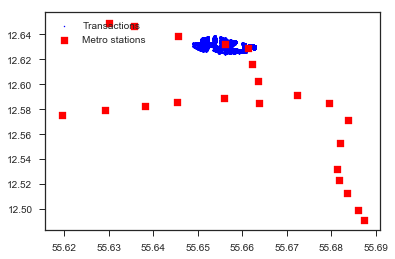

In [290]:
# Build a combined scatter
full_db_l_data = pd.DataFrame(full_db_l) # DataFrame for visualization


fig = plt.figure()
ax1 = fig.add_subplot(111)

ax1.scatter(full_db_l_data["lat"], full_db_l_data["lng"], c='b', marker='s', label = "Transactions", s=1)
ax1.scatter(metro_active["LAT"], metro_active["LON"], c='red', marker='s', label = "Metro stations")

plt.legend(loc='upper left')
plt.show()